In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm
from dynamics import SatelliteDynamics
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Process noise
q_chief_pos = 1e-1  # [m]
q_chief_vel = 1e-2 # [m / s]
Q_chief = (
    np.diag(np.concatenate([q_chief_pos * np.ones(3), q_chief_vel * np.ones(3)]))
    ** 2
)
q_deputy_pos = 1e0  # [m]
q_deputy_vel = 1e-2  # [m / s]
Q_deputy = (
    np.diag(np.concatenate([q_deputy_pos * np.ones(3), q_deputy_vel * np.ones(3)]))
    ** 2
)
Q_deputies = block_diag(Q_deputy, Q_deputy, Q_deputy)
Q = block_diag(Q_chief, Q_deputies)

# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [4]:
def h_function_chief(x_vec):
    """
    Computes the measurement vector based on the current state vector.
    The measurement vector includes position components.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).
    """
    return x_vec[0:3]

def h_function_deputy(x_vec):
    """
    Computes the measurement vector based on the current state vector.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).

    Returns:
    y (np.array): The measurement vector of the satellite (range [km]).
    """
    r_chief = x_vec[:3]
    r_deputy1 = x_vec[6:9]
    r_deputy2 = x_vec[12:15]
    r_deputy3 = x_vec[18:21]

    range_deputy1_chief = np.linalg.norm(r_deputy1 - r_chief)
    range_deputy1_deputy2 = np.linalg.norm(r_deputy1 - r_deputy2)
    range_deputy1_deputy3 = np.linalg.norm(r_deputy1 - r_deputy3)
    range_deputy2_chief = np.linalg.norm(r_deputy2 - r_chief)
    range_deputy2_deputy3 = np.linalg.norm(r_deputy2 - r_deputy3)
    range_deputy3_chief = np.linalg.norm(r_deputy3 - r_chief)

    return np.array(
        [
            [range_deputy1_chief],
            [range_deputy1_deputy2],
            [range_deputy1_deputy3],
            [range_deputy2_chief],
            [range_deputy2_deputy3],
            [range_deputy3_chief],
        ]
    )

def h(x_vec):
    return np.concatenate([h_function_chief(x_vec), h_function_deputy(x_vec)])

In [5]:
# Simulation setup
np.random.seed(42)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [6]:
def surrogate_function(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the surrogate function Φ_ij.
    
    Args:
        x_i, x_j: Current position vectors for agents i and j
        z_i, z_j: Previous iteration position vectors (denoted as bar_x in the equation)
        d_ij: True measurement between agents i and j
        sigma: Standard deviation parameter
    """
    # Compute the norm of the difference between previous positions
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    
    # Term 1: ||x_i - bar_x_i||^2 / sigma^2
    term1 = np.linalg.norm(P @ x_i - P @ z_i)**2 / sigma**2
    
    # Term 2: (||bar_x_i - bar_x_j|| - d_ij) * (x_i - bar_x_i)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term2 = ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_i - P @ z_i).T @ (P @ z_i - P @ z_j)
    
    # Term 3: ||x_j - bar_x_j||^2 / sigma^2
    term3 = np.linalg.norm(P @ x_j - P @ z_j)**2 / sigma**2
    
    # Term 4: -(||bar_x_i - bar_x_j|| - d_ij) * (x_j - bar_x_j)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term4 = -((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_j - P @ z_j).T @ (P @ z_i - P @ z_j)
    
    # Term 5: ||bar_x_i - bar_x_j||^2 / (2*sigma^2)
    term5 = z_ij_norm**2 / (2 * sigma**2)
    
    # Term 6: -d_ij * ||bar_x_i - bar_x_j|| / sigma^2
    term6 = -(d_ij * z_ij_norm) / sigma**2
    
    # Term 7: d_ij^2 / (2*sigma^2)
    term7 = d_ij**2 / (2 * sigma**2)
    
    return term1 + term2 + term3 + term4 + term5 + term6 + term7

def surrogate_gradient(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the gradient of the surrogate function Φ_ij.
    """
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    z_ij = P @ z_i - P @ z_j
    
    # Gradient with respect to x_i
    grad_i = (2/sigma**2) * P.T @ (P @ x_i - P @ z_i) + ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    # Gradient with respect to x_j
    grad_j = (2/sigma**2) * P.T @ (P @ x_j - P @ z_j) - ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    return grad_i, grad_j

def surrogate_hessian(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the Hessian of the surrogate function Φ_ij.
    """
    n = len(x_i)
    
    # The Hessian is constant with respect to x_i and x_j
    H_ii = (2/sigma**2) * P.T @ P
    H_ij = P.T @ np.zeros((n, n)) @ P
    H_ji = P.T @ np.zeros((n, n)) @ P
    H_jj = (2/sigma**2) * P.T @ P
    
    return H_ii, H_ij, H_ji, H_jj

In [7]:
def f(x_0, y, z_0=None):
    """
    Cost function combining direct measurements and surrogate terms.
    """
    f_x_0 = 0
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions for each satellite
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    for k in range(W):    
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1/2 * residual.T @ np.linalg.inv(R_chief) @ residual

        # Deputy-to-chief measurements
        y_21_k = y_rel_k[0]  # Deputy 1 to chief
        y_31_k = y_rel_k[3]  # Deputy 2 to chief
        y_41_k = y_rel_k[5]  # Deputy 3 to chief

        # Process direct measurements (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_21_k),
            (3, 1, x_3_k, x_1_k, y_31_k),
            (4, 1, x_4_k, x_1_k, y_41_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * r_deputy_pos**2)

        # 2. Surrogate terms for residual edges (between deputies)
        pairs_surrogate = [
            (x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1]),  # Deputies 1-2
            (x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2]),  # Deputies 1-3
            (x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4]),  # Deputies 2-3
        ]

        for x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k in pairs_surrogate:
            f_x_0 += surrogate_function(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)

        if k < W - 1:
            # Propagate states
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return f_x_0

def grad_f(x_0, y, z_0=None):
    """
    Gradient of cost function.
    """
    grad_f_x_0 = np.zeros_like(x_0)
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements gradient
        grad_f_x_0[:n_x, :] -= F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ (y_1_k - P @ x_1_k)

        # Process direct measurements gradients (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            grad_i = -(y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_j = (y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += grad_j

        # 2. Surrogate terms gradients (between deputies)
        pairs_surrogate = [
            (2, 3, x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            grad_i, grad_j = surrogate_gradient(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += STM_t0_i.T @ grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += STM_t0_j.T @ grad_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return grad_f_x_0

def hessian_f(x_0, y, z_0=None):
    """
    Hessian of cost function combining direct measurements and surrogate terms.
    """
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements Hessian
        hessian_f_x_0[:n_x, :n_x] += F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ P @ F_1_k

        # Process direct measurements Hessian (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            # Compute Hessian blocks for direct measurements
            H_term = 1/r_deputy_pos**2 * (
                ((y_ij_k - d_ij_k)/d_ij_k) * P.T @ P -
                (y_ij_k/d_ij_k**3) * P.T @ (d_ij_k_vec @ d_ij_k_vec.T) @ P
            )
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] -= STM_t0_i.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_term @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] -= STM_t0_j.T @ H_term @ STM_t0_j

        # 2. Surrogate terms Hessian (between deputies)
        pairs_surrogate = [
            (2, 3, P @ x_2_k, P @ x_3_k, P @ z_2_k, P @ z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, P @ x_2_k, P @ x_4_k, P @ z_2_k, P @ z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, P @ x_3_k, P @ x_4_k, P @ z_3_k, P @ z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            H_ii, H_ij, H_ji, H_jj = surrogate_hessian(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks with surrogate terms
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] += STM_t0_i.T @ H_ii @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_ij @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_ji @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] += STM_t0_j.T @ H_jj @ STM_t0_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return hessian_f_x_0

# def numerical_gradient(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical gradient of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         STM (numpy.ndarray): State transition matrix.
#         y (numpy.ndarray): Observed data.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical gradient of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     grad = np.zeros_like(x_0)
#     for i in range(x_0.size):
#         # Create perturbed versions of x_0
#         x_0_plus = x_0.copy()
#         x_0_minus = x_0.copy()
        
#         # Add and subtract epsilon to the i-th component
#         x_0_plus[i] += epsilon
#         x_0_minus[i] -= epsilon
        
#         # Compute the function value for perturbed inputs
#         f_plus = f(x_0_plus, y, z_0)
#         f_minus = f(x_0_minus, y, z_0)
        
#         # Central difference approximation
#         grad[i] = (f_plus - f_minus) / (2 * epsilon)
    
#     return grad

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 0
# W = 100
# numerical_grad = numerical_gradient(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# analytical_grad = grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# print("Numerical Gradient:", numerical_grad)
# print("Analytical Gradient:", analytical_grad)
# print("Gradient Difference:", numerical_grad - analytical_grad)
# -np.linalg.inv(hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])) @ grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# def numerical_hessian(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical Hessian of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         y (numpy.ndarray): Observed data.
#         z_0 (numpy.ndarray, optional): Previous iteration state vector.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical Hessian of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     n = x_0.size
#     H = np.zeros((n, n))
    
#     for i in range(n):
#         for j in range(n):
#             # Create perturbed versions of x_0
#             x_pp = x_0.copy()  # x plus-plus
#             x_pm = x_0.copy()  # x plus-minus
#             x_mp = x_0.copy()  # x minus-plus
#             x_mm = x_0.copy()  # x minus-minus
            
#             # Add/subtract epsilon to the i,j components
#             x_pp[i] += epsilon
#             x_pp[j] += epsilon
            
#             x_pm[i] += epsilon
#             x_pm[j] -= epsilon
            
#             x_mp[i] -= epsilon
#             x_mp[j] += epsilon
            
#             x_mm[i] -= epsilon
#             x_mm[j] -= epsilon
            
#             # Compute function values and ensure they're scalar
#             f_pp = f(x_pp, y, z_0).item()
#             f_pm = f(x_pm, y, z_0).item()
#             f_mp = f(x_mp, y, z_0).item()
#             f_mm = f(x_mm, y, z_0).item()
            
#             # Central difference approximation for second derivative
#             H[i, j] = (f_pp - f_pm - f_mp + f_mm) / (4 * epsilon * epsilon)
    
#     return H

# # Example usage to test:
# n = 0  # time index
# m = 0  # previous iteration time index
# W = 1  # window size

# numerical_H = numerical_hessian(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])
# analytical_H = hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# print("Numerical Hessian:", numerical_H)
# print("Analytical Hessian:", analytical_H)
# print("Hessian Difference:", np.linalg.norm(numerical_H - analytical_H))

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 10
# W = 10
# Y = np.zeros((9, 1, T))
# for t in range(T):
#     Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
# x_init = np.zeros((4 * n_x, 1))
# x_init[:4*n_x, :] = X_est[:, :, 0]
# f(x_init, Y[:, :, n:n + W]), f(x_init, Y[:, :, n:n + W], X_true[:, :, m]), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W])), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W], X_true[:, :, m]))

In [8]:
def L(x_0, y, z_0=None):
    """
    Lagrangian wrapper for the cost function.
    """
    return f(x_0, y, z_0)
    
def grad_L(x_0, y, z_0=None):
    """
    Gradient of Lagrangian wrapper.
    """
    return grad_f(x_0, y, z_0)

def hessian_L(x_0, y, z_0=None):
    """
    Hessian of Lagrangian wrapper.
    """
    return hessian_f(x_0, y, z_0)

In [9]:

class MM_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20, mm_tol=1e-6, mm_max_iter=20):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        self.mm_tol = mm_tol
        self.mm_max_iter = mm_max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
        z = x_init.copy()  # Initialize z as current iterate
        
        for mm_iter in range(self.mm_max_iter):
            print(f"\nMajorization-Minimization Iteration {mm_iter + 1}")
            
            prev_cost_function_value = None
            prev_grad_norm_value = None
            prev_global_error = None
            
            # Solve the surrogate problem
            for iteration in range(self.max_iter):
                # Compute the cost function, gradient and Hessian using current z
                L_x = L(x, Y, z)
                grad_L_x = grad_L(x, Y, z)
                hessian_L_x = hessian_L(x, Y, z)

                # Convergence tracking
                cost_function_value = L_x[0][0]
                grad_norm_value = np.linalg.norm(grad_L_x)

                # Store the norms
                self.cost_function_values.append(cost_function_value)
                self.grad_norm_values.append(grad_norm_value)
                
                if prev_cost_function_value is not None:
                    cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                    grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                    global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
                prev_cost_function_value = cost_function_value
                prev_grad_norm_value = grad_norm_value
                prev_global_error = np.linalg.norm(x - X_true)

                # Check convergence and print metrics
                if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                    print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                    break
                else:
                    if iteration == 0:
                        print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                    else:
                        print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                        
                # Print relative errors 
                print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                
                # Solve for the Newton step
                delta_x = solve(hessian_L_x, -grad_L_x)
                x += delta_x
            
            # Update z for next majorization step
            if np.linalg.norm(x - z) < self.mm_tol:
                print(f"Majorization-Minimization converged after {mm_iter + 1} iterations")
                break
            
            # Update z for next majorization step
            z = x.copy()

        return x

In [10]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2766688490.2623305
Gradient norm: 75893974050.39305
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: 317007114.51137036 (-88.54%)
Gradient norm: 33238918.67160553 (-99.96%)
Global relative error = 385.3114196441972 (-2.60%)
Position relative errors: 2.236142993082619 m, 182.70183835791485 m, 236.67640649981826 m, 243.0307304335651 m

Iteration 2
Cost function: 316999421.7379867 (-0.00%)
Gradient norm: 1854.6931064241583 (-99.99%)
Global relative error = 386.60885604081085 (0.34%)
Position relative errors: 2.188321676285373 m, 183.49280494724403 m, 237.33162312200494 m, 243.85535947485292 m

Iteration 3
Cost function: 316999421.7378237 (-0.00%)
Gradient norm: 2.9403892986235944 (-99.84%)
Global relative error = 386.6088866702108 (0.00%)
Position relative errors: 2.18832289615

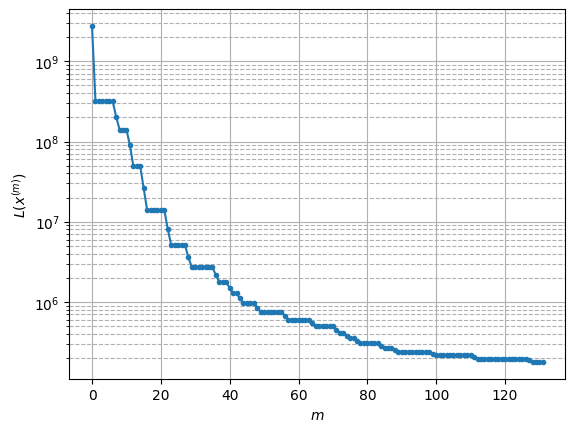

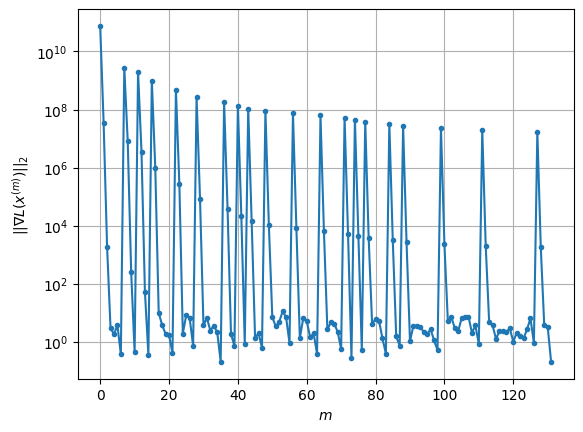

Windows:   0%|          | 1/296 [04:57<24:22:53, 297.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 154771.30819671202
Gradient norm: 14789335.392368862
Global relative error: 215.513749135671
Position relative errors: 0.12719238799403856 m, 62.79882569791364 m, 159.60644897804366 m, 130.49203146964078 m

Iteration 1
Cost function: 147825.8271374201 (-4.49%)
Gradient norm: 1584.5218409546128 (-99.99%)
Global relative error = 216.7168803675556 (0.56%)
Position relative errors: 0.12341197028139007 m, 64.26079217086935 m, 157.87716527424357 m, 133.83372506988755 m

Iteration 2
Cost function: 147825.8269906708 (-0.00%)
Gradient norm: 4.999284648906896 (-99.68%)
Global relative error = 216.71702308877073 (0.00%)
Position relative errors: 0.12346930640408765 m, 64.26071549459925 m, 157.87714444703084 m, 133.83401751135975 m

Iteration 3
Cost function: 147825.8269857118 (-0.00%)
Gradient norm: 3.9720387470062284 (-20.55%)
Global relative error = 216.71702308607982 (-0.00%)
Position relative errors: 0.1234693

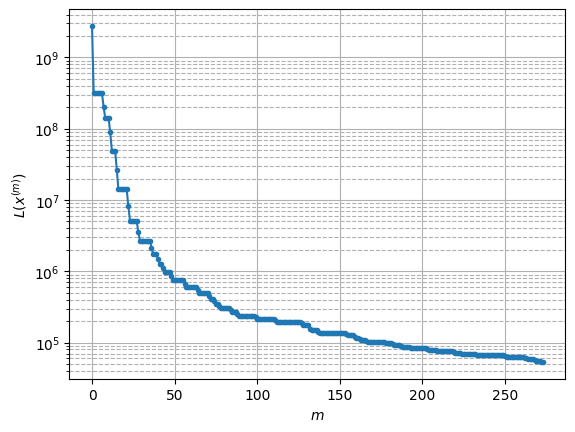

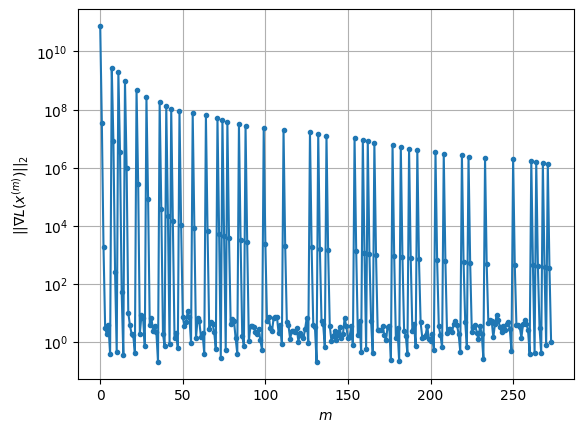

Windows:   1%|          | 2/296 [09:53<24:12:28, 296.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 48101.353254434
Gradient norm: 1375483.8322241968
Global relative error: 200.47456139495014
Position relative errors: 0.020723015241181298 m, 75.52379816059589 m, 125.82934264761357 m, 136.57650777385976 m

Iteration 1
Cost function: 47148.634271788214 (-1.98%)
Gradient norm: 334.33079209030285 (-99.98%)
Global relative error = 199.99857543192127 (-0.24%)
Position relative errors: 0.017717357201840374 m, 76.23947391936213 m, 124.7906090574701 m, 136.43400632069535 m

Iteration 2
Cost function: 47148.63426524393 (-0.00%)
Gradient norm: 2.371282572446624 (-99.29%)
Global relative error = 199.99856613849076 (-0.00%)
Position relative errors: 0.017719519243989824 m, 76.23946314154058 m, 124.7905988763488 m, 136.43400803216426 m

Iteration 3
Cost function: 47148.63426399551 (-0.00%)
Gradient norm: 3.9301373540552156 (65.74%)
Global relative error = 199.99856614168422 (0.00%)
Position relative errors: 0.01771

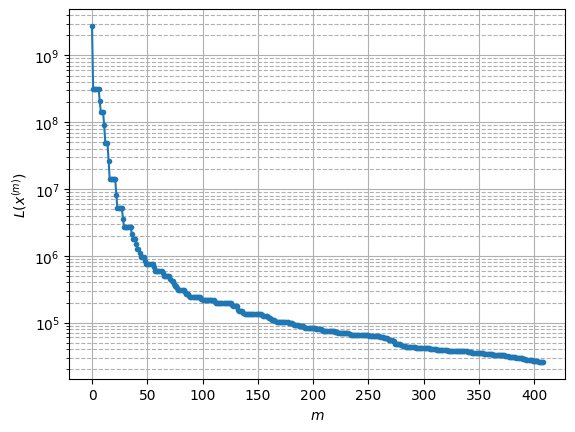

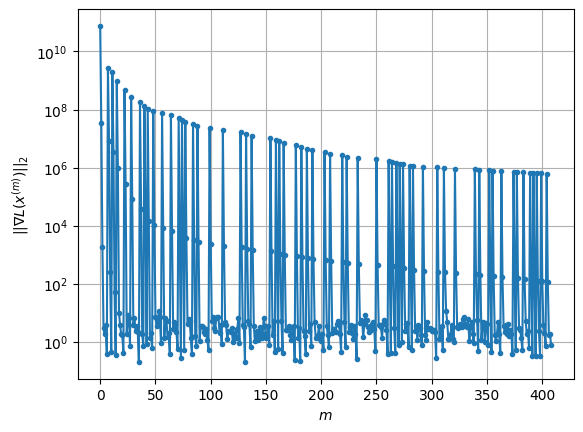

Windows:   1%|          | 3/296 [14:25<23:14:46, 285.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 25055.786880737574
Gradient norm: 1213229.605616832
Global relative error: 182.58448646690454
Position relative errors: 0.027541017262574654 m, 78.5001835131831 m, 109.27422191759325 m, 123.42583652385039 m

Iteration 1
Cost function: 24708.419090560634 (-1.39%)
Gradient norm: 114.73134725898593 (-99.99%)
Global relative error = 181.68377043547943 (-0.49%)
Position relative errors: 0.04692278923519093 m, 78.77622116415128 m, 108.61332032461323 m, 122.50070213808549 m

STOP on Iteration 2
Cost function = 24708.41908997518 (-0.00%)
Gradient norm = 0.9159080765311476 (-99.20%)
Global relative error = 181.6837714237591 (0.00%)
Final position relative errors: 0.04692076716751979 m, 78.77622041808178 m, 108.61331719546698 m, 122.5007068587909 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 24386.508917009807
Gradient norm: 466311.3392924379
Global relative error: 181.683

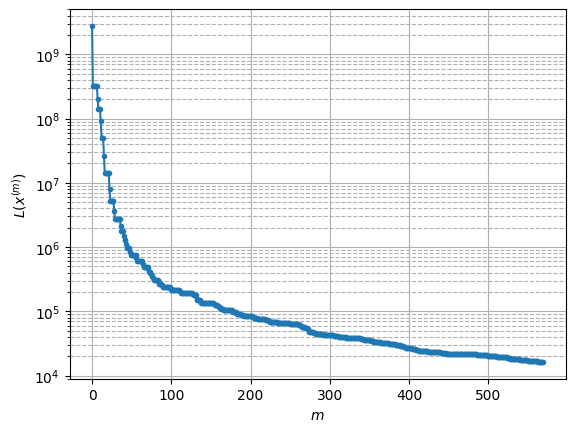

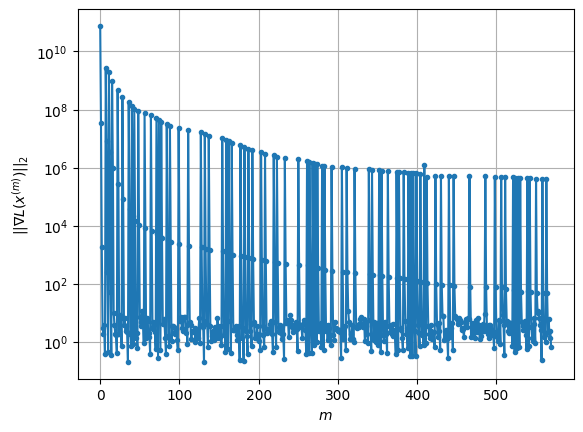

Windows:   1%|▏         | 4/296 [19:49<24:23:28, 300.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 16681.340120457688
Gradient norm: 964887.9218678133
Global relative error: 164.4506458908621
Position relative errors: 0.04367270194082947 m, 76.43617243362345 m, 98.24300700438681 m, 107.47010029110618 m

Iteration 1
Cost function: 16496.487327372313 (-1.11%)
Gradient norm: 51.391521092761906 (-99.99%)
Global relative error = 163.4962650988098 (-0.58%)
Position relative errors: 0.06800823731219358 m, 76.4944367174193 m, 97.70242902930859 m, 106.46054325808889 m

Iteration 2
Cost function: 16496.487330794993 (0.00%)
Gradient norm: 1.324959091727285 (-97.42%)
Global relative error = 163.4962668905616 (0.00%)
Position relative errors: 0.06800742487457276 m, 76.49443647115233 m, 97.70242724994553 m, 106.46054782021095 m

STOP on Iteration 3
Cost function = 16496.48733299633 (0.00%)
Gradient norm = 0.3862405781221252 (-70.85%)
Global relative error = 163.496266884469 (-0.00%)
Final position relative errors:

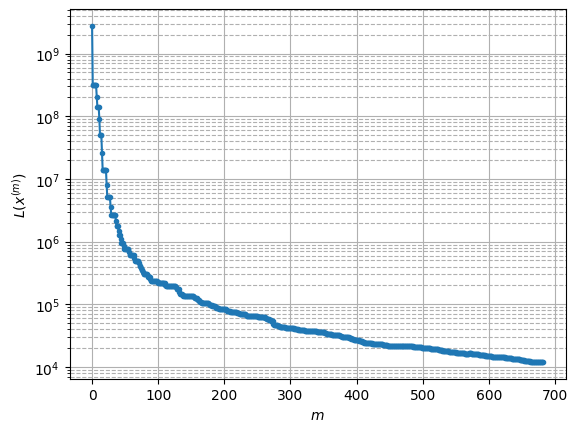

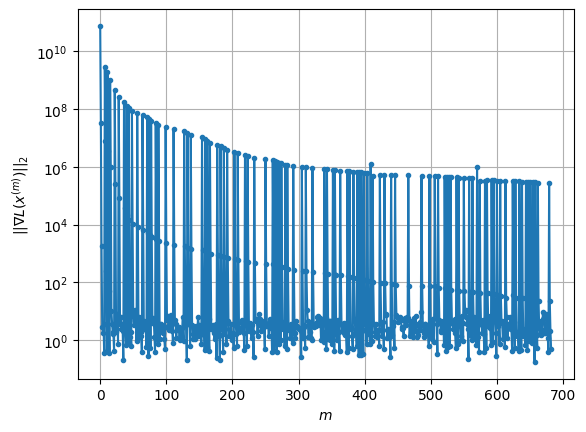

Windows:   2%|▏         | 5/296 [23:31<21:59:25, 272.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12464.440357555404
Gradient norm: 729736.8177006862
Global relative error: 147.19895442152082
Position relative errors: 0.05667237345227874 m, 72.0528557119575 m, 88.71716916805772 m, 92.7640559224389 m

Iteration 1
Cost function: 12347.458656426723 (-0.94%)
Gradient norm: 26.293140175918705 (-100.00%)
Global relative error = 146.32045687246563 (-0.60%)
Position relative errors: 0.06470297094624863 m, 72.0069805690274 m, 88.22436125436653 m, 91.87556912090473 m

Iteration 2
Cost function: 12347.45865715235 (0.00%)
Gradient norm: 9.224220827468288 (-64.92%)
Global relative error = 146.32045796418015 (0.00%)
Position relative errors: 0.06470255315474947 m, 72.00698079035381 m, 88.22436004213135 m, 91.87557185045226 m

Iteration 3
Cost function: 12347.458659233811 (0.00%)
Gradient norm: 5.337163129814975 (-42.14%)
Global relative error = 146.32045796461887 (0.00%)
Position relative errors: 0.06470255436846

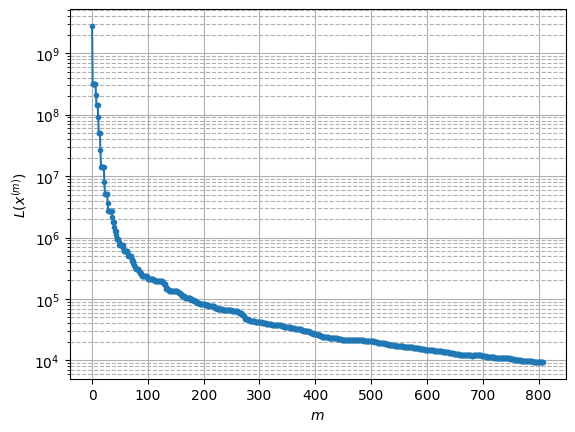

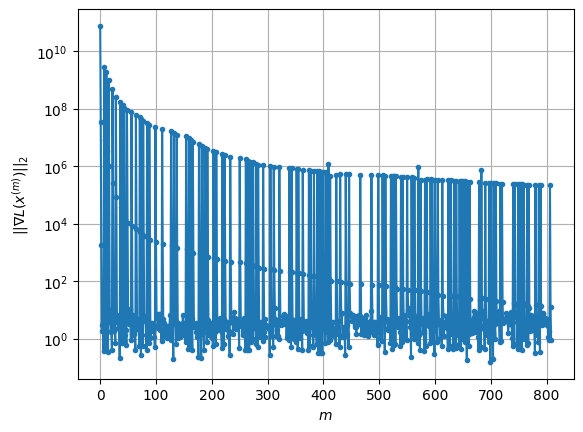

Windows:   2%|▏         | 6/296 [27:39<21:16:10, 264.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9724.550633812212
Gradient norm: 939827.3972648444
Global relative error: 131.29365398211453
Position relative errors: 0.053707973851918944 m, 66.74774745732522 m, 79.6686953757198 m, 80.22251497031945 m

Iteration 1
Cost function: 9640.744813822273 (-0.86%)
Gradient norm: 16.167287602831305 (-100.00%)
Global relative error = 130.51723369698908 (-0.59%)
Position relative errors: 0.07100023758716477 m, 66.66442642001991 m, 79.21633141209783 m, 79.46926779548613 m

Iteration 2
Cost function: 9640.74481593657 (0.00%)
Gradient norm: 1.1546010923289614 (-92.86%)
Global relative error = 130.51723410196476 (0.00%)
Position relative errors: 0.07099995208840679 m, 66.66442654250123 m, 79.2163307075128 m, 79.46926906045346 m

Iteration 3
Cost function: 9640.744815584381 (-0.00%)
Gradient norm: 1.3947200073411588 (20.80%)
Global relative error = 130.5172341006179 (-0.00%)
Position relative errors: 0.07099995661902

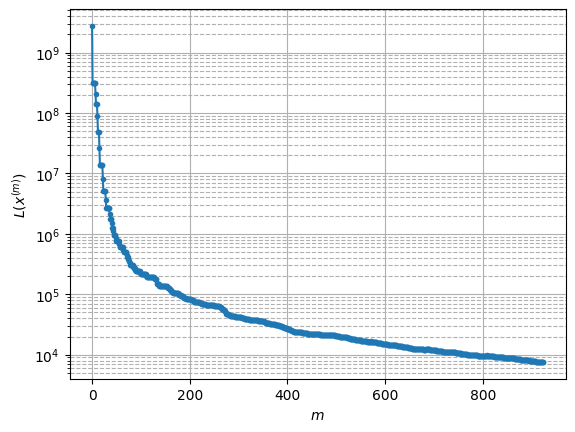

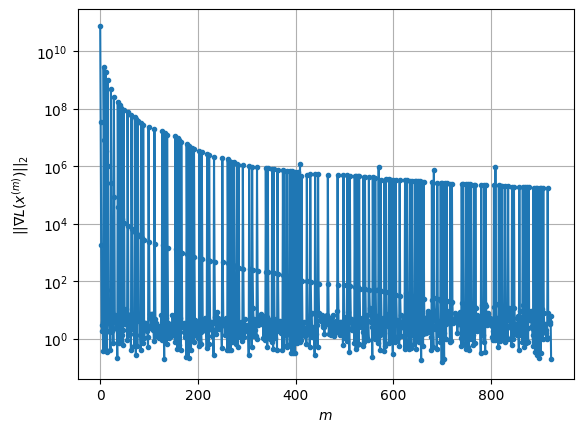

Windows:   2%|▏         | 7/296 [31:32<20:23:00, 253.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7700.816880951237
Gradient norm: 562852.4330889977
Global relative error: 116.77738888279944
Position relative errors: 0.05932626165600442 m, 61.31633612189268 m, 71.01218733691292 m, 69.5307616583333 m

Iteration 1
Cost function: 7640.935631178221 (-0.78%)
Gradient norm: 12.385118871037424 (-100.00%)
Global relative error = 116.10977760809168 (-0.57%)
Position relative errors: 0.06527663281410404 m, 61.21905898880145 m, 70.59688131220561 m, 68.91864095566682 m

Iteration 2
Cost function: 7640.935626891577 (-0.00%)
Gradient norm: 5.614942261458893 (-54.66%)
Global relative error = 116.1097775271021 (-0.00%)
Position relative errors: 0.06527644149827276 m, 61.2190590935931 m, 70.59688073073927 m, 68.91864132194335 m

Iteration 3
Cost function: 7640.9356332934785 (0.00%)
Gradient norm: 2.488492050992621 (-55.68%)
Global relative error = 116.10977753177116 (0.00%)
Position relative errors: 0.06527643174463

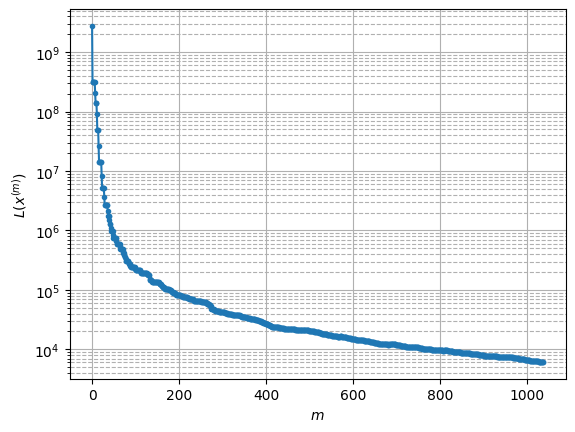

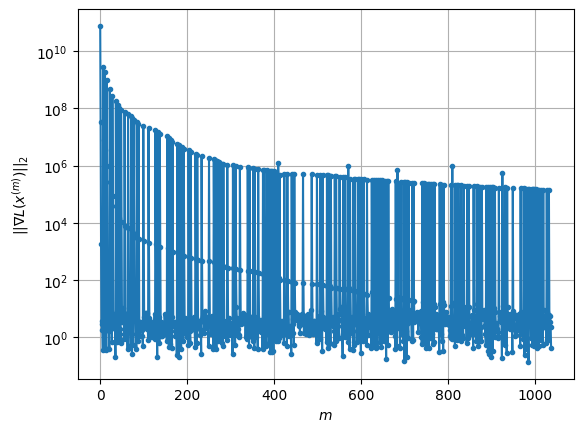

Windows:   3%|▎         | 8/296 [35:13<19:28:54, 243.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6129.673714506977
Gradient norm: 354452.56112591235
Global relative error: 103.60783354791452
Position relative errors: 0.05487726934064094 m, 56.010886676192506 m, 62.80603047738874 m, 60.43806505818541 m

Iteration 1
Cost function: 6086.5859958205665 (-0.70%)
Gradient norm: 6.663100918549229 (-100.00%)
Global relative error = 103.0446956192271 (-0.54%)
Position relative errors: 0.06175500622927165 m, 55.914714382796745 m, 62.43168367808637 m, 59.95024249913478 m

Iteration 2
Cost function: 6086.585995681584 (-0.00%)
Gradient norm: 7.78310319685911 (16.81%)
Global relative error = 103.04469552165943 (-0.00%)
Position relative errors: 0.06175486577500623 m, 55.914714530735885 m, 62.431683379026865 m, 59.950242505034346 m

Iteration 3
Cost function: 6086.585994232624 (-0.00%)
Gradient norm: 6.560009476905845 (-15.71%)
Global relative error = 103.04469552294 (0.00%)
Position relative errors: 0.06175487680

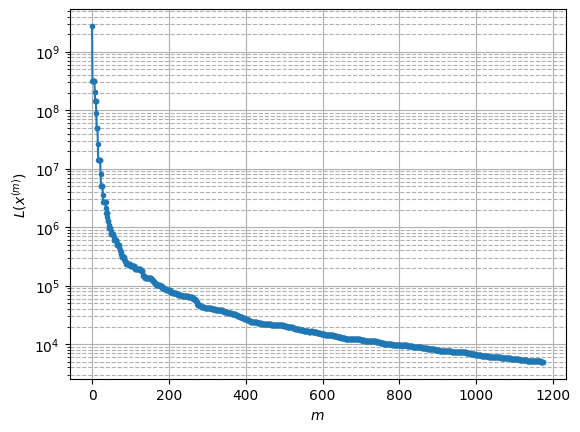

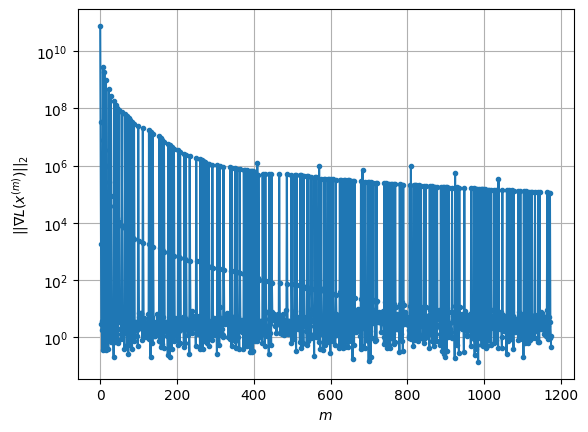

Windows:   3%|▎         | 9/296 [39:47<20:10:07, 252.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4981.497768997063
Gradient norm: 552513.701130476
Global relative error: 91.70490121566203
Position relative errors: 0.052865584880318686 m, 50.97177261818686 m, 55.14645451680769 m, 52.63582313178219 m

Iteration 1
Cost function: 4949.095424174912 (-0.65%)
Gradient norm: 4.365392962292998 (-100.00%)
Global relative error = 91.22991638793691 (-0.52%)
Position relative errors: 0.06966618924286923 m, 50.88061339481482 m, 54.81820720295651 m, 52.239994170434514 m

Iteration 2
Cost function: 4949.095424145443 (-0.00%)
Gradient norm: 2.0400665035652206 (-53.27%)
Global relative error = 91.2299163246057 (-0.00%)
Position relative errors: 0.0696661005548262 m, 50.8806134869904 m, 54.818207197990034 m, 52.23999397538852 m

Iteration 3
Cost function: 4949.095425774511 (0.00%)
Gradient norm: 1.003503669515583 (-50.81%)
Global relative error = 91.22991632516799 (0.00%)
Position relative errors: 0.06966609536874625

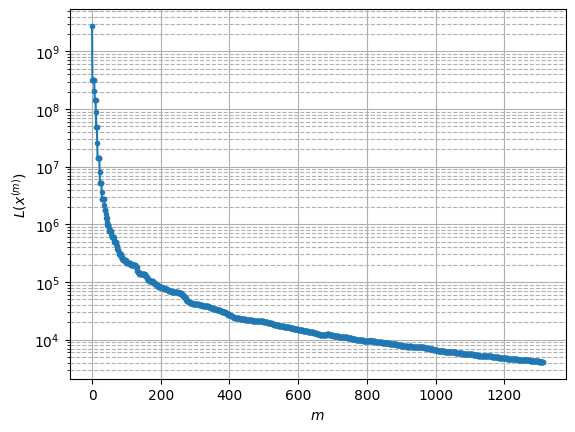

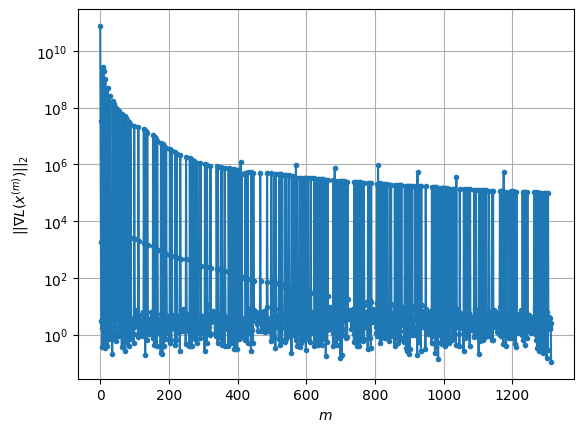

Windows:   3%|▎         | 10/296 [44:20<20:34:27, 258.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4058.664159877749
Gradient norm: 254228.7082798074
Global relative error: 80.87408077913403
Position relative errors: 0.061159523019210744 m, 46.1768908411505 m, 48.08726498681346 m, 45.78121704755014 m

Iteration 1
Cost function: 4035.00070950634 (-0.58%)
Gradient norm: 3.0456163130364757 (-100.00%)
Global relative error = 80.46822315573884 (-0.50%)
Position relative errors: 0.05855565537018479 m, 46.0873810010602 m, 47.791637425181044 m, 45.464724603904955 m

Iteration 2
Cost function: 4035.0007099057743 (0.00%)
Gradient norm: 1.265858298881177 (-58.44%)
Global relative error = 80.4682231039589 (-0.00%)
Position relative errors: 0.05855558647383238 m, 46.08738107571265 m, 47.7916373900395 m, 45.464724473613785 m

STOP on Iteration 3
Cost function = 4035.000709567805 (-0.00%)
Gradient norm = 0.5307208804020535 (-58.07%)
Global relative error = 80.46822310098672 (-0.00%)
Final position relative errors: 

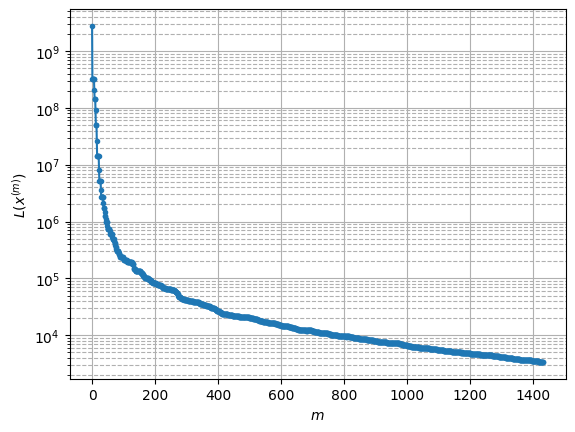

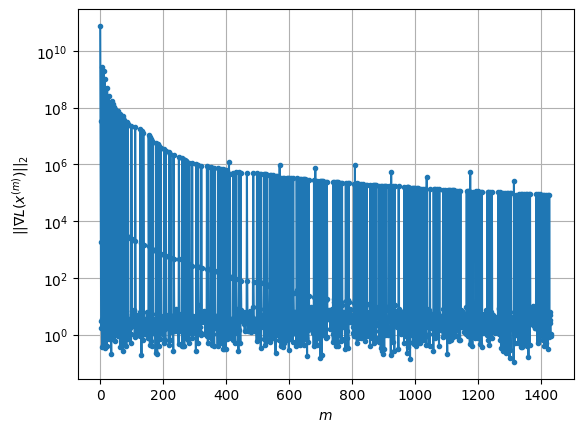

Windows:   4%|▎         | 11/296 [48:22<20:05:44, 253.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3327.433807231556
Gradient norm: 194460.6261666317
Global relative error: 70.98259524573734
Position relative errors: 0.05205658377653695 m, 41.589565754439725 m, 41.570409275561786 m, 39.758422367347485 m

Iteration 1
Cost function: 3310.1446746767224 (-0.52%)
Gradient norm: 2.5889059439116076 (-100.00%)
Global relative error = 70.6442740761412 (-0.48%)
Position relative errors: 0.05473264399361421 m, 41.50929482978506 m, 41.30932772032536 m, 39.51107838628144 m

Iteration 2
Cost function: 3310.1446734096344 (-0.00%)
Gradient norm: 1.3289017148765059 (-48.67%)
Global relative error = 70.6442740516064 (-0.00%)
Position relative errors: 0.05473259369380331 m, 41.50929489085691 m, 41.30932774790535 m, 39.511078249488484 m

Iteration 3
Cost function: 3310.1446742346798 (0.00%)
Gradient norm: 2.012665120137652 (51.45%)
Global relative error = 70.64427405360543 (0.00%)
Position relative errors: 0.05473259639

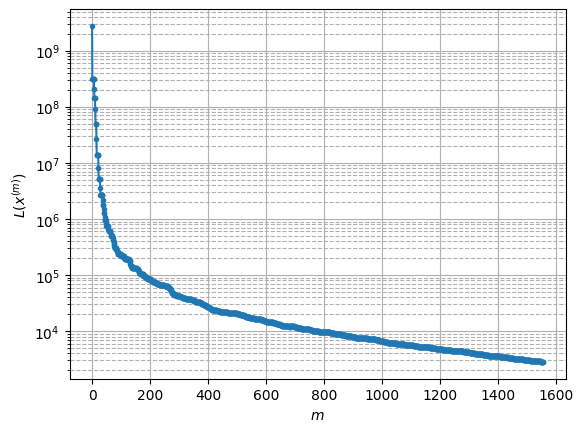

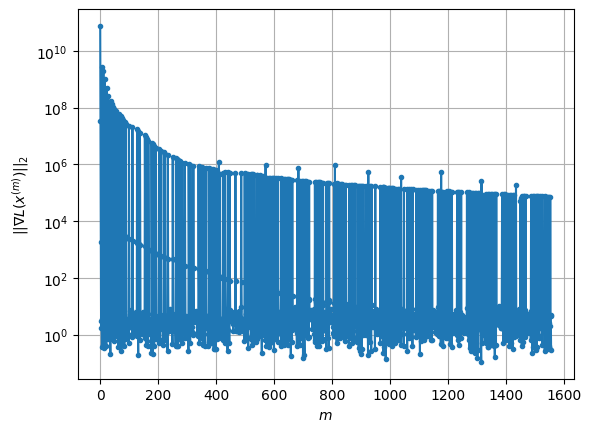

Windows:   4%|▍         | 12/296 [52:38<20:05:00, 254.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2766.781354663006
Gradient norm: 79582.08422765542
Global relative error: 61.98195950579779
Position relative errors: 0.04939463826433159 m, 37.27397288773174 m, 35.60255193148174 m, 34.421897036848314 m

Iteration 1
Cost function: 2754.6160517101907 (-0.44%)
Gradient norm: 2.0008708159724446 (-100.00%)
Global relative error = 61.702135508156964 (-0.45%)
Position relative errors: 0.06162458483215627 m, 37.20464499302732 m, 35.369676026299345 m, 34.233712171389556 m

STOP on Iteration 2
Cost function = 2754.616051908007 (0.00%)
Gradient norm = 0.9385828603063459 (-53.09%)
Global relative error = 61.70213556483731 (0.00%)
Final position relative errors: 0.061624568679022856 m, 37.20464503714791 m, 35.36967616468898 m, 34.233712082647024 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 2743.0147207327027
Gradient norm: 45057.0192991153
Global relative error: 61.7021355

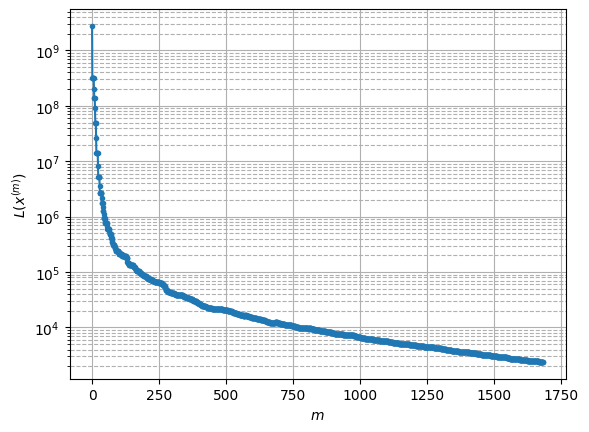

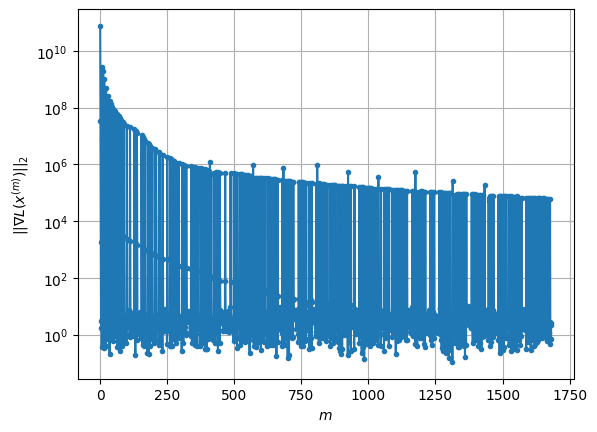

Windows:   4%|▍         | 13/296 [56:48<19:54:08, 253.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2305.4881725643277
Gradient norm: 227754.44986746807
Global relative error: 53.75122589523856
Position relative errors: 0.057888193826021735 m, 33.217481123267845 m, 30.128290311582298 m, 29.63229390063991 m

Iteration 1
Cost function: 2296.035061501355 (-0.41%)
Gradient norm: 3.311018973419402 (-100.00%)
Global relative error = 53.51471266988236 (-0.44%)
Position relative errors: 0.06753300829122388 m, 33.1536361926916 m, 29.93395573957989 m, 29.472215208489075 m

STOP on Iteration 2
Cost function = 2296.0350605956705 (-0.00%)
Gradient norm = 0.3577911727878676 (-89.19%)
Global relative error = 53.51471268172299 (0.00%)
Final position relative errors: 0.06753299479698363 m, 33.153636205601764 m, 29.933955831917576 m, 29.472215121712946 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 2287.1255924030634
Gradient norm: 48239.41182008792
Global relative error: 53.5147

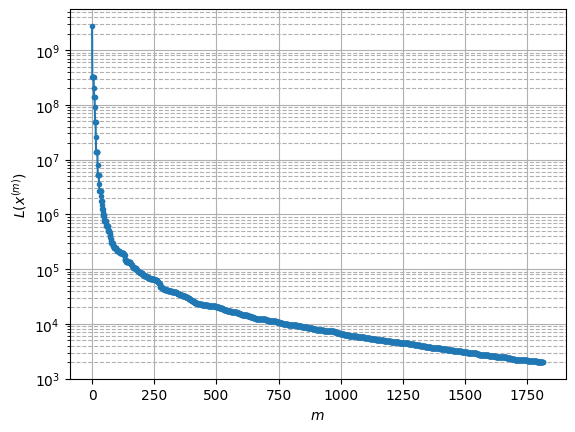

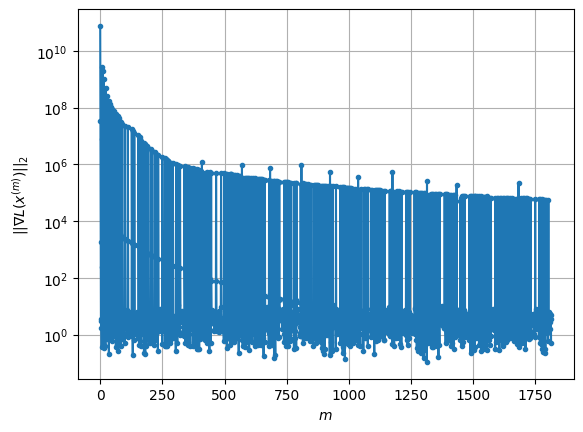

Windows:   5%|▍         | 14/296 [1:01:10<20:02:08, 255.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2001.4033620933994
Gradient norm: 135524.73077197603
Global relative error: 46.243953086677365
Position relative errors: 0.0643941929615889 m, 29.37111187350956 m, 25.253281817217225 m, 25.260748361227332 m

Iteration 1
Cost function: 1994.1058729351762 (-0.36%)
Gradient norm: 2.67612094484311 (-100.00%)
Global relative error = 46.04440728735525 (-0.43%)
Position relative errors: 0.059412185837477774 m, 29.31359749288319 m, 25.074207070720348 m, 25.14115918482575 m

Iteration 2
Cost function: 1994.1058737162707 (0.00%)
Gradient norm: 4.488925489460137 (67.74%)
Global relative error = 46.044407364558616 (0.00%)
Position relative errors: 0.05941217135720363 m, 29.313597522116954 m, 25.074207217098945 m, 25.14115914617894 m

Iteration 3
Cost function: 1994.1058722947537 (-0.00%)
Gradient norm: 8.0555234449609 (79.45%)
Global relative error = 46.04440736335945 (-0.00%)
Position relative errors: 0.0594121689

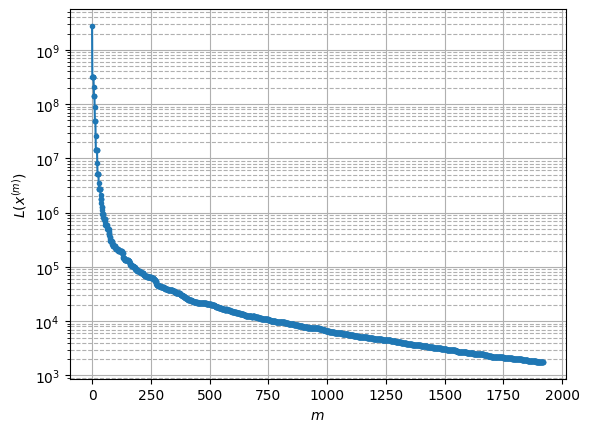

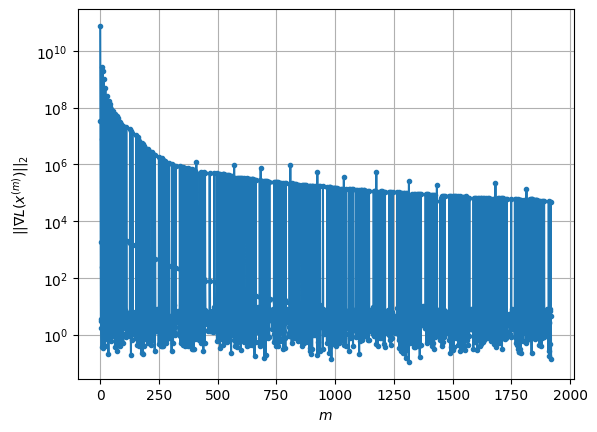

Windows:   5%|▌         | 15/296 [1:04:40<18:53:47, 242.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1724.38055719394
Gradient norm: 178721.7288484168
Global relative error: 39.311337817404116
Position relative errors: 0.05702388616266589 m, 25.68658279105899 m, 20.763277159167885 m, 21.31808241131021 m

Iteration 1
Cost function: 1718.728404753435 (-0.33%)
Gradient norm: 4.373398977578283 (-100.00%)
Global relative error = 39.14699747363094 (-0.42%)
Position relative errors: 0.05375547358459712 m, 25.624445929199318 m, 20.624049388118085 m, 21.225402681906495 m

Iteration 2
Cost function: 1718.7284040088143 (-0.00%)
Gradient norm: 2.042576994342692 (-53.30%)
Global relative error = 39.14699753583233 (0.00%)
Position relative errors: 0.05375546698458734 m, 25.62444594497151 m, 20.624049498442236 m, 21.22540267040473 m

Iteration 3
Cost function: 1718.728404704447 (0.00%)
Gradient norm: 1.3508908095231338 (-33.86%)
Global relative error = 39.146997536176784 (0.00%)
Position relative errors: 0.0537554672

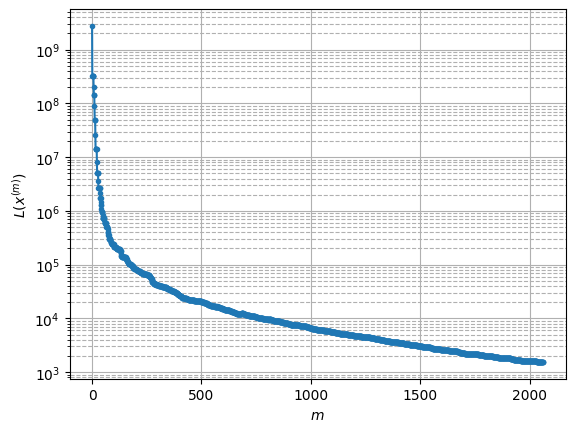

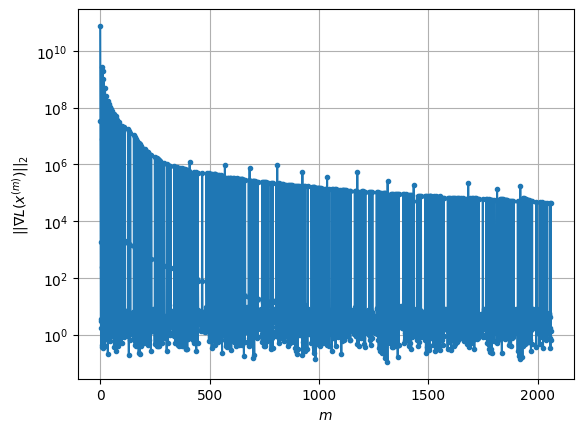

Windows:   5%|▌         | 16/296 [1:09:26<19:50:52, 255.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1493.6097461250881
Gradient norm: 86629.15616483004
Global relative error: 33.01061049715985
Position relative errors: 0.051551104913260475 m, 22.094312075083874 m, 16.884506685096582 m, 17.789025528500954 m

Iteration 1
Cost function: 1489.2994022531052 (-0.29%)
Gradient norm: 1.9732360720676323 (-100.00%)
Global relative error = 32.8781704268442 (-0.40%)
Position relative errors: 0.04345807402401537 m, 22.041807140090537 m, 16.77463288712939 m, 17.712693800601283 m

Iteration 2
Cost function: 1489.299402952591 (0.00%)
Gradient norm: 1.6078318836041885 (-18.52%)
Global relative error = 32.87817045694068 (0.00%)
Position relative errors: 0.04345807075156773 m, 22.041807127983247 m, 16.7746329724475 m, 17.712693790741085 m

Iteration 3
Cost function: 1489.2994024709149 (-0.00%)
Gradient norm: 3.0772629109802336 (91.39%)
Global relative error = 32.878170457619255 (0.00%)
Position relative errors: 0.043458

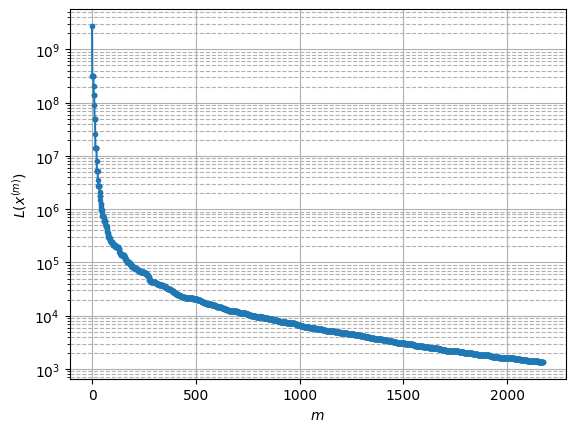

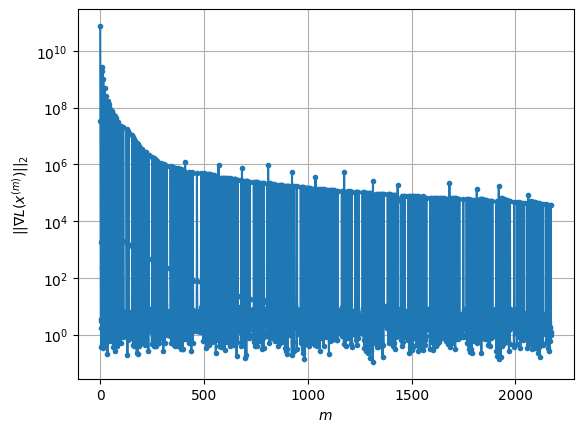

Windows:   6%|▌         | 17/296 [1:13:12<19:05:50, 246.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1347.6460782515474
Gradient norm: 84218.40544403419
Global relative error: 27.310660179324184
Position relative errors: 0.04241307882716179 m, 18.734016504661888 m, 13.528297207591018 m, 14.556411748760171 m

Iteration 1
Cost function: 1344.066493207858 (-0.27%)
Gradient norm: 3.0421923789608973 (-100.00%)
Global relative error = 27.20298433632896 (-0.39%)
Position relative errors: 0.03603578338060937 m, 18.683468911117114 m, 13.441222527892771 m, 14.50032974715407 m

Iteration 2
Cost function: 1344.066492773598 (-0.00%)
Gradient norm: 1.391930850638731 (-54.25%)
Global relative error = 27.20298436612279 (0.00%)
Position relative errors: 0.03603577970511078 m, 18.683468915118507 m, 13.441222596626108 m, 14.50032973418851 m

STOP on Iteration 3
Cost function = 1344.066492778076 (0.00%)
Gradient norm = 0.9194616191952205 (-33.94%)
Global relative error = 27.202984366460694 (0.00%)
Final position relative 

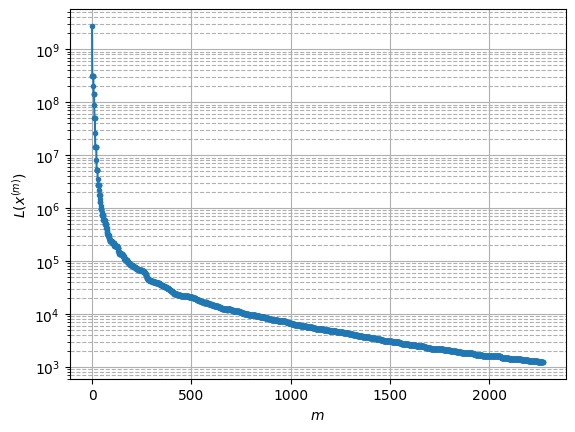

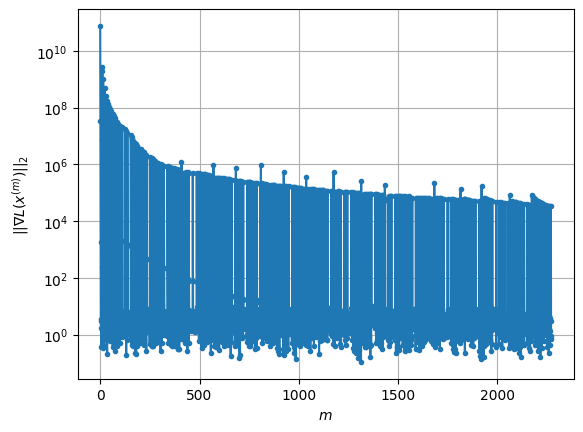

Windows:   6%|▌         | 18/296 [1:16:26<17:49:18, 230.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1213.6927872788535
Gradient norm: 83855.80192914781
Global relative error: 22.08863108173194
Position relative errors: 0.03468441751980858 m, 15.497473909877767 m, 10.567268005471226 m, 11.66467548062353 m

Iteration 1
Cost function: 1210.6905141070852 (-0.25%)
Gradient norm: 2.672597380048012 (-100.00%)
Global relative error = 22.009206686713775 (-0.36%)
Position relative errors: 0.02071676604500435 m, 15.456401148922133 m, 10.498088914929083 m, 11.631493565558705 m

STOP on Iteration 2
Cost function = 1210.6905142634785 (0.00%)
Gradient norm = 0.9595837036127637 (-64.10%)
Global relative error = 22.00920671948791 (0.00%)
Final position relative errors: 0.020716765890937554 m, 15.456401166585595 m, 10.498088969694235 m, 11.631493554673943 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 1207.943429329214
Gradient norm: 60813.36675158417
Global relative error: 22.00

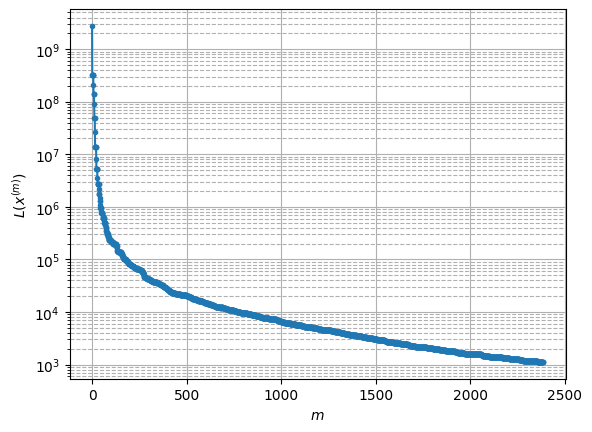

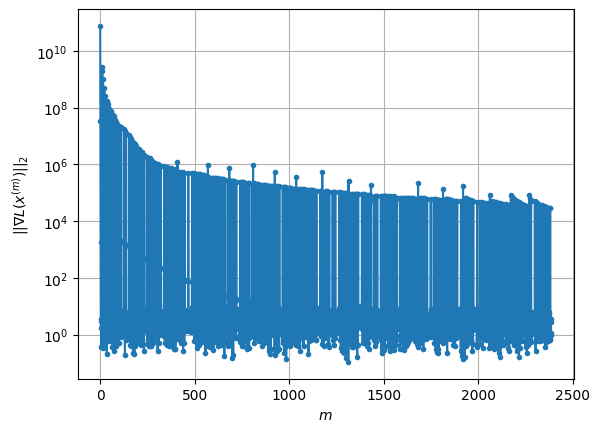

Windows:   6%|▋         | 19/296 [1:20:10<17:35:13, 228.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1111.4714417890518
Gradient norm: 156830.9962342371
Global relative error: 17.461924850002312
Position relative errors: 0.020104584706169985 m, 12.526287730751411 m, 7.9958587186278915 m, 9.169188159230837 m

Iteration 1
Cost function: 1108.8112294080245 (-0.24%)
Gradient norm: 3.4454773755461687 (-100.00%)
Global relative error = 17.404724443625984 (-0.33%)
Position relative errors: 0.025748136302329236 m, 12.487315126572414 m, 7.952650080000228 m, 9.151138701149877 m

Iteration 2
Cost function: 1108.811228998322 (-0.00%)
Gradient norm: 6.603236881924917 (91.65%)
Global relative error = 17.404724497834195 (0.00%)
Position relative errors: 0.025748139156602862 m, 12.487315187909394 m, 7.952650114980431 m, 9.151138690144188 m

Iteration 3
Cost function: 1108.8112294167718 (0.00%)
Gradient norm: 1.0167287218956824 (-84.60%)
Global relative error = 17.404724496395023 (-0.00%)
Position relative errors: 0.02

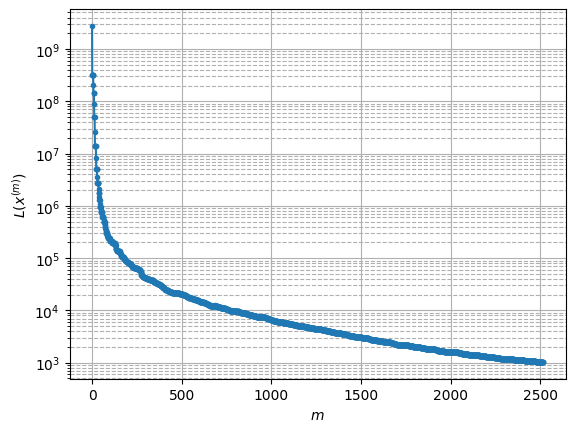

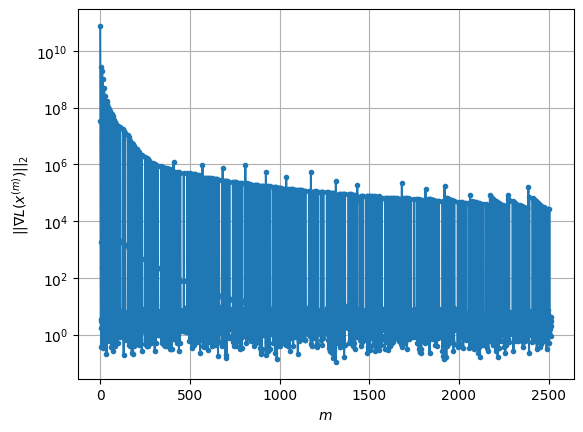

Windows:   7%|▋         | 20/296 [1:24:15<17:55:23, 233.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1032.465775702178
Gradient norm: 192049.8016421195
Global relative error: 13.32882017241323
Position relative errors: 0.025694979068715013 m, 9.740187295666807 m, 5.87613893961667 m, 6.946505665734671 m

Iteration 1
Cost function: 1030.3916272249242 (-0.20%)
Gradient norm: 5.774200241030942 (-100.00%)
Global relative error = 13.286174931137719 (-0.32%)
Position relative errors: 0.016253706884358544 m, 9.707512833781104 m, 5.855766375034348 m, 6.9277557850931935 m

STOP on Iteration 2
Cost function = 1030.3916268682267 (-0.00%)
Gradient norm = 0.6367536720478844 (-88.97%)
Global relative error = 13.286174961970232 (0.00%)
Final position relative errors: 0.016253712763590743 m, 9.707512859410791 m, 5.855766393123696 m, 6.927755793006531 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 1028.5201267793932
Gradient norm: 64453.882581947815
Global relative error: 13.28617

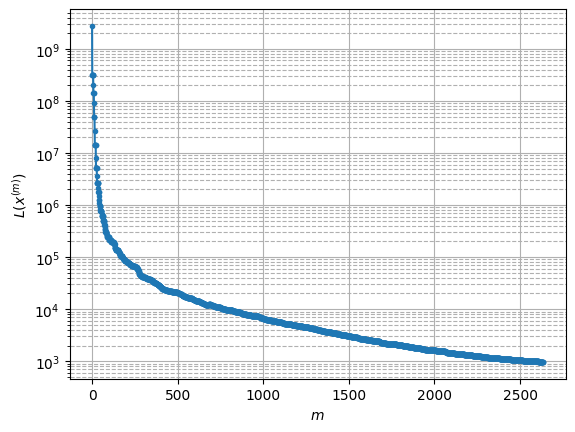

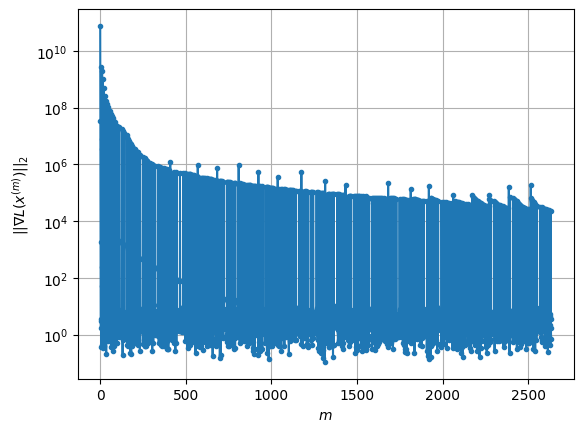

Windows:   7%|▋         | 21/296 [1:28:12<17:54:52, 234.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 972.2832259153741
Gradient norm: 269339.9135038001
Global relative error: 9.620028236856664
Position relative errors: 0.01683145867736281 m, 7.150281372558352 m, 4.159379896503047 m, 4.910732794899001 m

Iteration 1
Cost function: 970.4034528849077 (-0.19%)
Gradient norm: 1.7841362086473438 (-100.00%)
Global relative error = 9.590040551440298 (-0.31%)
Position relative errors: 0.012010151327914893 m, 7.1267153488085535 m, 4.147715473872426 m, 4.896195746666514 m

Iteration 2
Cost function: 970.4034531645684 (0.00%)
Gradient norm: 1.1619040590446756 (-34.88%)
Global relative error = 9.590040574951072 (0.00%)
Position relative errors: 0.01201016063043679 m, 7.126715365510855 m, 4.1477154891870605 m, 4.896195755409023 m

Iteration 3
Cost function: 970.4034528761542 (-0.00%)
Gradient norm: 1.5857134274583085 (36.48%)
Global relative error = 9.590040573405172 (-0.00%)
Position relative errors: 0.012010152815

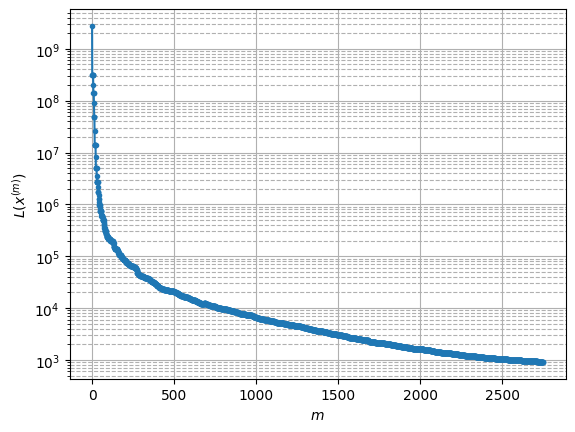

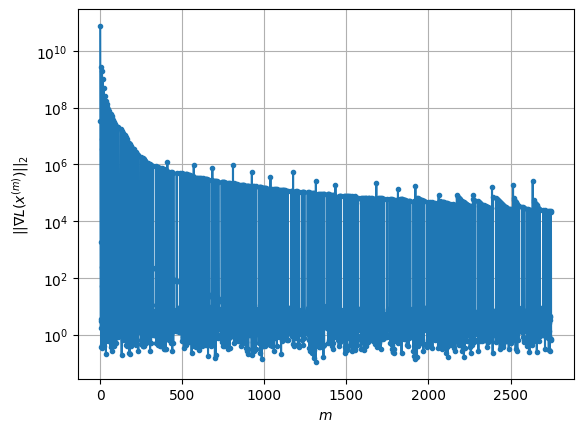

Windows:   7%|▋         | 22/296 [1:31:50<17:29:25, 229.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 911.4547392917956
Gradient norm: 199006.74782418038
Global relative error: 6.327038162571268
Position relative errors: 0.01337567983576714 m, 4.762612307482351 m, 2.7216922242087946 m, 3.152609993335186 m

Iteration 1
Cost function: 909.9104927555568 (-0.17%)
Gradient norm: 1.760260800118153 (-100.00%)
Global relative error = 6.315283072047602 (-0.19%)
Position relative errors: 0.015346802805402748 m, 4.743866380770356 m, 2.7122446834543696 m, 3.1654128734277873 m

Iteration 2
Cost function: 909.9104929059572 (0.00%)
Gradient norm: 4.149723022994861 (135.74%)
Global relative error = 6.315283084613411 (0.00%)
Position relative errors: 0.015346809404161004 m, 4.743866399153425 m, 2.7122446912492992 m, 3.165412864236771 m

Iteration 3
Cost function: 909.910493138941 (0.00%)
Gradient norm: 4.4034624079901805 (6.11%)
Global relative error = 6.315283082383816 (-0.00%)
Position relative errors: 0.0153468104902

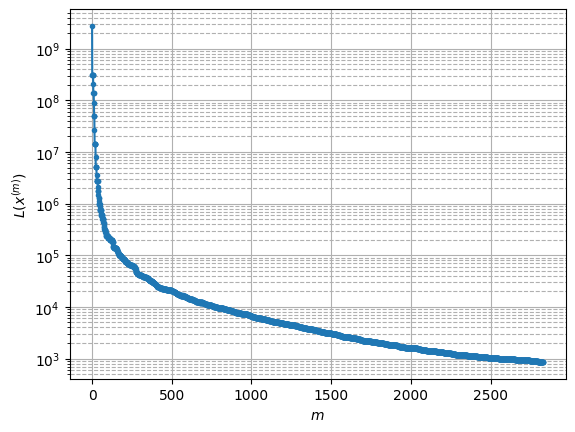

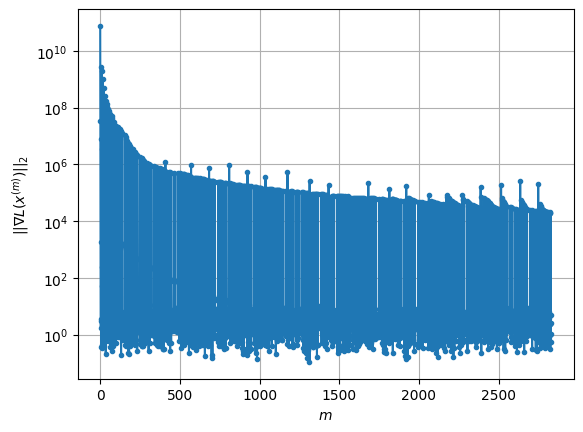

Windows:   8%|▊         | 23/296 [1:34:26<15:44:08, 207.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 864.4700370979715
Gradient norm: 155614.3499569359
Global relative error: 3.5754907809474807
Position relative errors: 0.014666176876084286 m, 2.6494026917074227 m, 1.5462832791069139 m, 1.8361903956833086 m

Iteration 1
Cost function: 862.9011461322831 (-0.18%)
Gradient norm: 4.414015439706493 (-100.00%)
Global relative error = 3.564955394731256 (-0.29%)
Position relative errors: 0.01096405978385701 m, 2.6353985764758097 m, 1.5392635836217843 m, 1.8417769523704568 m

STOP on Iteration 2
Cost function = 862.9011460558082 (-0.00%)
Gradient norm = 0.29123733034973887 (-93.40%)
Global relative error = 3.5649553968984895 (0.00%)
Final position relative errors: 0.010964076372105837 m, 2.6353985835065936 m, 1.5392635932815926 m, 1.8417769383328397 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 861.5792422794308
Gradient norm: 42650.1720204574
Global relative error: 3.56

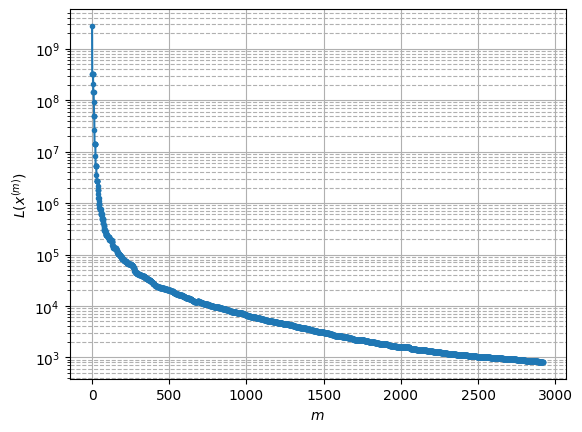

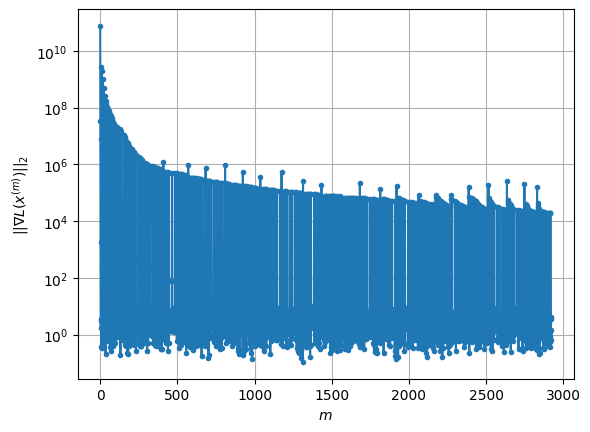

Windows:   8%|▊         | 24/296 [1:37:22<14:58:11, 198.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 820.379524806902
Gradient norm: 259980.42859721804
Global relative error: 1.7050757121588114
Position relative errors: 0.010335992339889011 m, 0.8086636512731695 m, 0.9115242863267571 m, 1.191874685636847 m

Iteration 1
Cost function: 818.977039607863 (-0.17%)
Gradient norm: 4.6967917952303395 (-100.00%)
Global relative error = 1.710027830163144 (0.29%)
Position relative errors: 0.00718010353486134 m, 0.8112137596516193 m, 0.9276476319462628 m, 1.1848029510541103 m

STOP on Iteration 2
Cost function = 818.9770398510982 (0.00%)
Gradient norm = 0.639549278172153 (-86.38%)
Global relative error = 1.7100278427137008 (0.00%)
Final position relative errors: 0.0071801056861160095 m, 0.8112138045926274 m, 0.9276476343043083 m, 1.1848029365397001 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 817.7848703999434
Gradient norm: 37042.32531677841
Global relative error: 1.71002

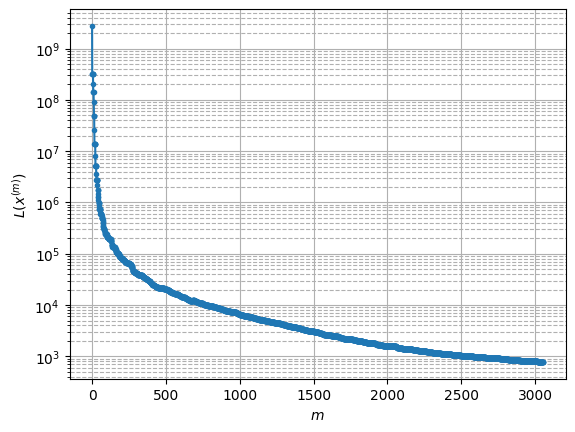

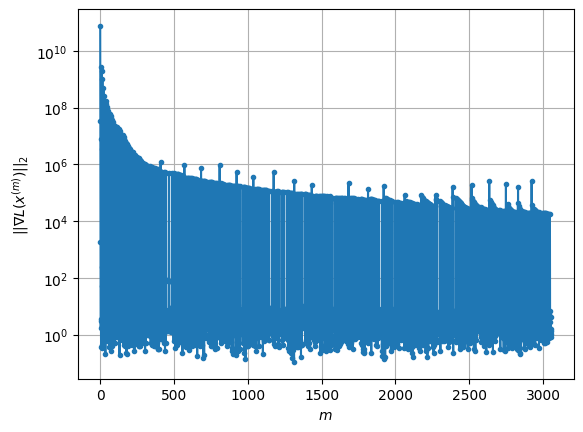

Windows:   8%|▊         | 25/296 [1:41:40<16:15:40, 216.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 789.7392711314113
Gradient norm: 110892.38421223238
Global relative error: 2.4029261290855453
Position relative errors: 0.007037568108344167 m, 1.157003512531475 m, 1.2949643165102747 m, 1.6603646281459383 m

Iteration 1
Cost function: 788.2129002896592 (-0.19%)
Gradient norm: 2.8279393411813887 (-100.00%)
Global relative error = 2.3672155140316664 (-1.49%)
Position relative errors: 0.009006204267740263 m, 1.1369815081466765 m, 1.2605840466311151 m, 1.649313233892687 m

Iteration 2
Cost function: 788.2129007073488 (0.00%)
Gradient norm: 2.7251721155043187 (-3.63%)
Global relative error = 2.3672155340519616 (0.00%)
Position relative errors: 0.009006205020402086 m, 1.136981576091826 m, 1.260584029669776 m, 1.6493132287469832 m

Iteration 3
Cost function: 788.2129007762306 (0.00%)
Gradient norm: 2.6543501626450063 (-2.60%)
Global relative error = 2.3672155298251543 (-0.00%)
Position relative errors: 0.0090

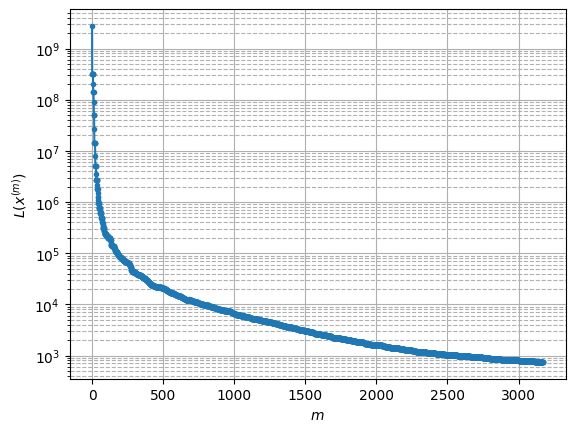

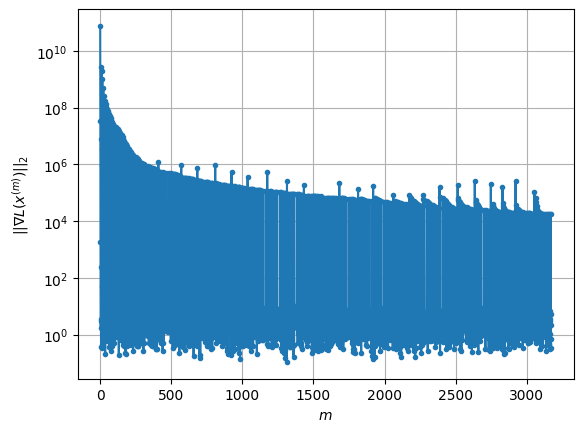

Windows:   9%|▉         | 26/296 [1:45:30<16:31:04, 220.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 755.9704260731404
Gradient norm: 178962.1703151977
Global relative error: 4.092309348473943
Position relative errors: 0.008636466780247242 m, 2.5894743556314603 m, 1.9723224887138493 m, 2.479933528572486 m

Iteration 1
Cost function: 754.8096765629841 (-0.15%)
Gradient norm: 1.9787510086452045 (-100.00%)
Global relative error = 4.066589133918131 (-0.63%)
Position relative errors: 0.008019425440425604 m, 2.578002084391958 m, 1.959785763328493 m, 2.4594345859069056 m

STOP on Iteration 2
Cost function = 754.8096765987406 (0.00%)
Gradient norm = 0.31340087899532676 (-84.16%)
Global relative error = 4.066589133487604 (-0.00%)
Final position relative errors: 0.008019423496611415 m, 2.5780020921557276 m, 1.9597857549053486 m, 2.459434583775114 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 753.7919155321846
Gradient norm: 34848.52424297593
Global relative error: 4.06658

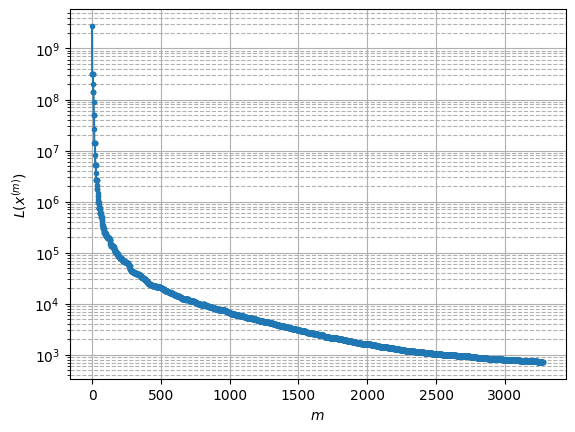

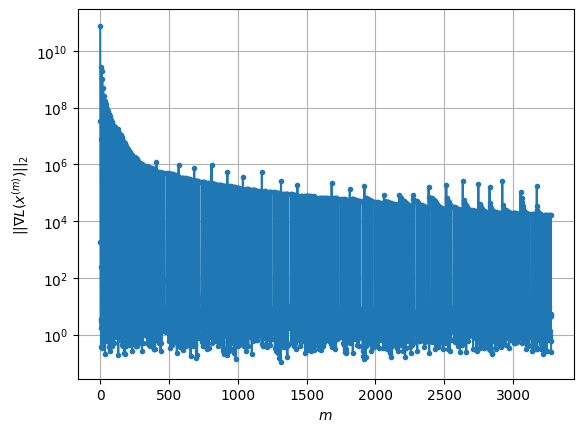

Windows:   9%|▉         | 27/296 [1:48:52<16:02:53, 214.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 731.1349535634922
Gradient norm: 106819.74606859844
Global relative error: 5.74312360105564
Position relative errors: 0.007829811739713541 m, 3.8200135718245845 m, 2.6824230069644033 m, 3.34578377786107 m

Iteration 1
Cost function: 729.9836398768218 (-0.16%)
Gradient norm: 2.474361905659673 (-100.00%)
Global relative error = 5.712405448295624 (-0.53%)
Position relative errors: 0.011296435016454403 m, 3.8014322933490696 m, 2.6721760828858625 m, 3.322469206061943 m

STOP on Iteration 2
Cost function = 729.9836399683165 (0.00%)
Gradient norm = 0.6687695784522897 (-72.97%)
Global relative error = 5.712405452550873 (0.00%)
Final position relative errors: 0.011296432141129673 m, 3.801432304476922 m, 2.672176078724585 m, 3.3224692040025405 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 728.977846569139
Gradient norm: 51383.414423079485
Global relative error: 5.712405452

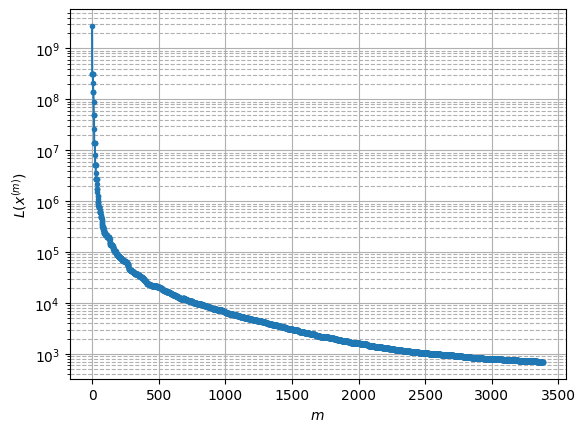

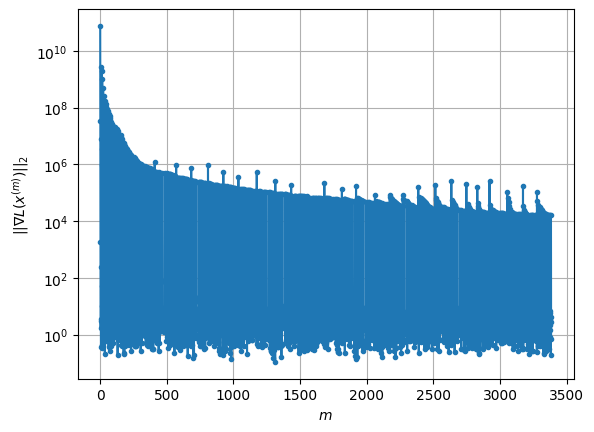

Windows:   9%|▉         | 28/296 [1:52:16<15:44:31, 211.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 698.8180320656995
Gradient norm: 35890.41346929281
Global relative error: 7.198591772718541
Position relative errors: 0.011367476738965907 m, 4.8416763962838685 m, 3.364587581591675 m, 4.129919806968923 m

Iteration 1
Cost function: 697.9850981725367 (-0.12%)
Gradient norm: 1.1145118913434604 (-100.00%)
Global relative error = 7.169390455698892 (-0.41%)
Position relative errors: 0.011192511546141249 m, 4.818370136209036 m, 3.3510751898230793 m, 4.117349623382746 m

STOP on Iteration 2
Cost function = 697.9850983035964 (0.00%)
Gradient norm = 0.42708642335218056 (-61.68%)
Global relative error = 7.169390443023021 (-0.00%)
Final position relative errors: 0.011192519730448073 m, 4.818370122670459 m, 3.3510751828584513 m, 4.117349622800637 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 697.1730384764475
Gradient norm: 22152.39980562346
Global relative error: 7.1693904

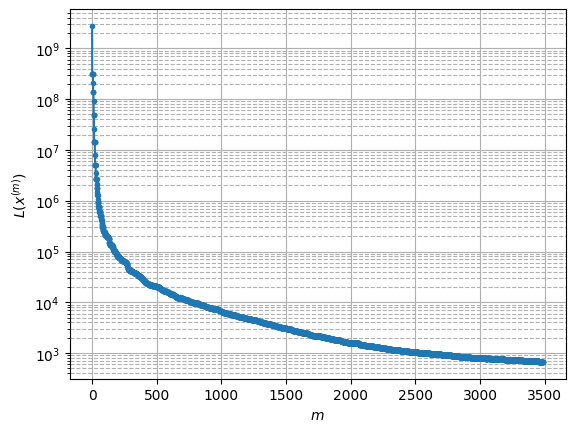

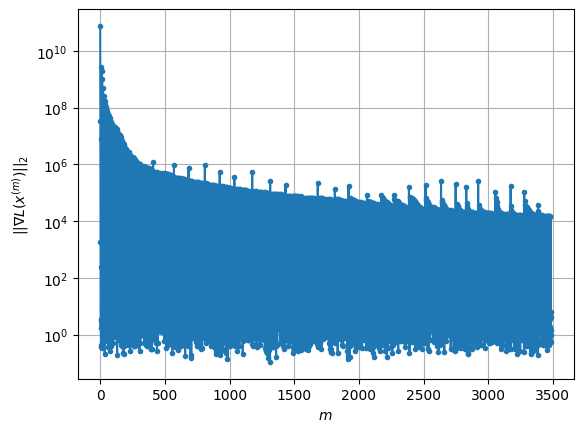

Windows:  10%|▉         | 29/296 [1:55:31<15:18:48, 206.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 674.7947254800719
Gradient norm: 32929.201043450645
Global relative error: 8.468880427753252
Position relative errors: 0.01052957938992233 m, 5.687676011913837 m, 3.931322564121131 m, 4.89039286534942 m

Iteration 1
Cost function: 673.9893337429186 (-0.12%)
Gradient norm: 1.9558242067687408 (-99.99%)
Global relative error = 8.434702499132998 (-0.40%)
Position relative errors: 0.008310442859084952 m, 5.659561463224079 m, 3.9194515833749075 m, 4.873446304600831 m

STOP on Iteration 2
Cost function = 673.9893335279278 (-0.00%)
Gradient norm = 0.9744987727865595 (-50.17%)
Global relative error = 8.434702500945761 (0.00%)
Final position relative errors: 0.00831044257905118 m, 5.659561471115173 m, 3.9194515787835664 m, 4.8734463022673316 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 673.2385682312972
Gradient norm: 25574.087498711313
Global relative error: 8.4347025009

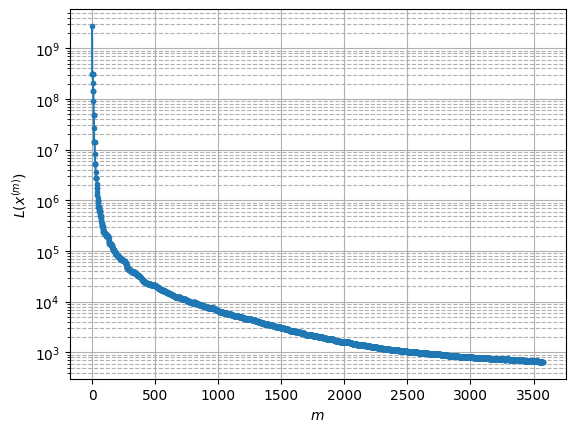

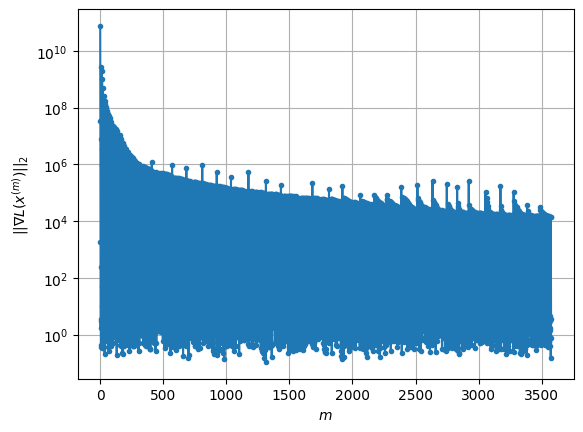

Windows:  10%|█         | 30/296 [1:58:22<14:27:59, 195.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 647.4439652306626
Gradient norm: 29205.13083459624
Global relative error: 9.507510593747012
Position relative errors: 0.008559381538900417 m, 6.355625584358542 m, 4.437776189142621 m, 5.504912302551757 m

STOP on Iteration 1
Cost function = 646.6376676441419 (-0.12%)
Gradient norm = 0.710929744817829 (-100.00%)
Global relative error = 9.472577814913643 (-0.37%)
Final position relative errors: 0.00997187949842596 m, 6.325658771044842 m, 4.4261982058193095 m, 5.4885020860144085 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 645.9189358002754
Gradient norm: 15567.586633577177
Global relative error: 9.472577814913643
Position relative errors: 0.00997187949842596 m, 6.325658771044842 m, 4.4261982058193095 m, 5.4885020860144085 m

STOP on Iteration 1
Cost function = 645.2215799117276 (-0.11%)
Gradient norm = 0.6618936005655367 (-100.00%)
Global relative error = 9.436773

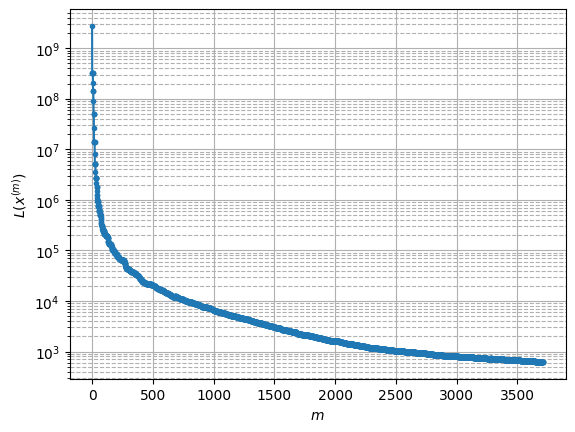

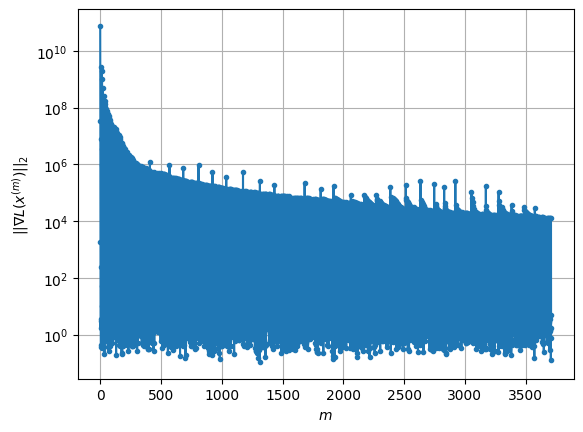

Windows:  10%|█         | 31/296 [2:02:41<15:49:04, 214.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 624.9450132015427
Gradient norm: 99673.36974704343
Global relative error: 10.354972640796644
Position relative errors: 0.009532679510687325 m, 6.8935886178233705 m, 4.835645336985031 m, 6.0265801411161775 m

Iteration 1
Cost function: 624.1511139980585 (-0.13%)
Gradient norm: 3.238425611628986 (-100.00%)
Global relative error = 10.314230364305475 (-0.39%)
Position relative errors: 0.01881536867472607 m, 6.864465238067432 m, 4.816734631543762 m, 6.005040618012257 m

Iteration 2
Cost function: 624.1511144485237 (0.00%)
Gradient norm: 2.2953867803940784 (-29.12%)
Global relative error = 10.314230375345629 (0.00%)
Position relative errors: 0.01881537355229414 m, 6.864465258035724 m, 4.816734626587089 m, 6.005040618109207 m

Iteration 3
Cost function: 624.1511144716837 (0.00%)
Gradient norm: 3.2743678803523464 (42.65%)
Global relative error = 10.314230375168192 (-0.00%)
Position relative errors: 0.0188153693

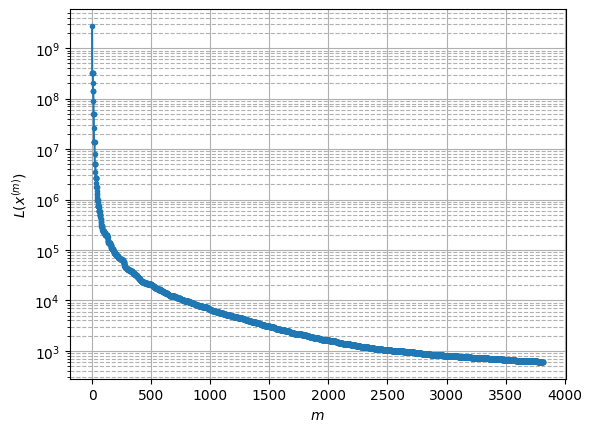

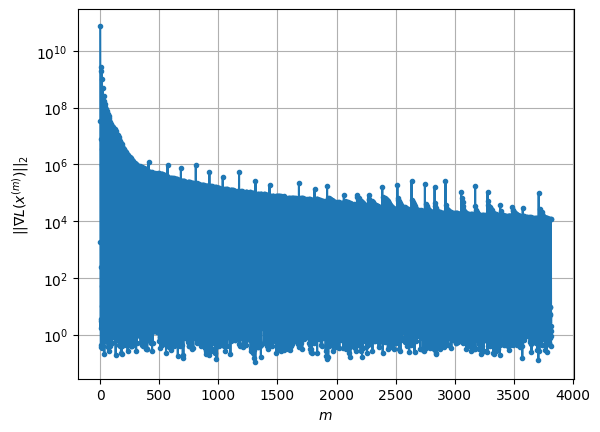

Windows:  11%|█         | 32/296 [2:06:03<15:28:33, 211.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 607.2619906316734
Gradient norm: 241584.93061594001
Global relative error: 11.02529319507427
Position relative errors: 0.018719022758817143 m, 7.329796146875726 m, 5.165541807518977 m, 6.414627382931215 m

Iteration 1
Cost function: 606.465514143235 (-0.13%)
Gradient norm: 4.2768145788606455 (-100.00%)
Global relative error = 10.983044148631718 (-0.38%)
Position relative errors: 0.030266058166222302 m, 7.299881308424258 m, 5.145070234996986 m, 6.3926340160240835 m

Iteration 2
Cost function: 606.465514639905 (0.00%)
Gradient norm: 3.1729215298638183 (-25.81%)
Global relative error = 10.98304416135835 (0.00%)
Position relative errors: 0.03026605589583561 m, 7.29988133252827 m, 5.145070228581647 m, 6.392634015538613 m

Iteration 3
Cost function: 606.4655148077375 (0.00%)
Gradient norm: 1.1696758527217115 (-63.14%)
Global relative error = 10.983044161840997 (0.00%)
Position relative errors: 0.0302660532836

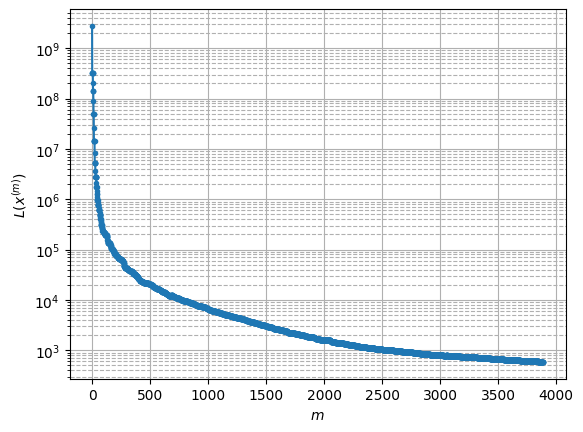

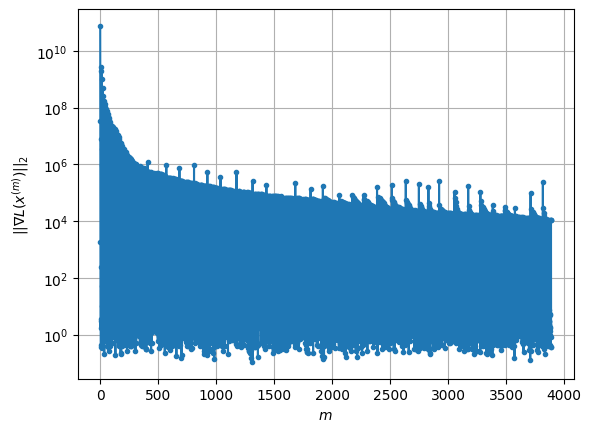

Windows:  11%|█         | 33/296 [2:08:25<13:53:54, 190.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 584.9816783802327
Gradient norm: 54973.05946933863
Global relative error: 11.553067311214493
Position relative errors: 0.029453334304146164 m, 7.654171520634926 m, 5.44024941359607 m, 6.729738134251149 m

Iteration 1
Cost function: 584.3171828414025 (-0.11%)
Gradient norm: 5.4727144741473 (-99.99%)
Global relative error = 11.512403661453435 (-0.35%)
Position relative errors: 0.018397227741883626 m, 7.626727335039469 m, 5.417861596065352 m, 6.7092802943115855 m

Iteration 2
Cost function: 584.3171831543557 (0.00%)
Gradient norm: 1.7970603796599582 (-67.16%)
Global relative error = 11.51240367647023 (0.00%)
Position relative errors: 0.018397220611413374 m, 7.6267273606710155 m, 5.417861591148357 m, 6.709280294932377 m

Iteration 3
Cost function: 584.3171827718086 (-0.00%)
Gradient norm: 1.6988248321209645 (-5.47%)
Global relative error = 11.512403676541673 (0.00%)
Position relative errors: 0.0183972215804

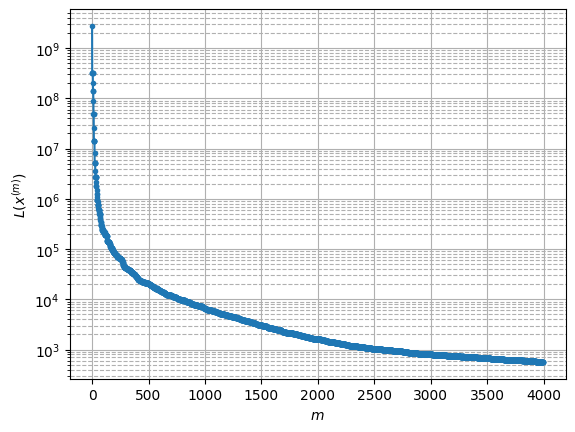

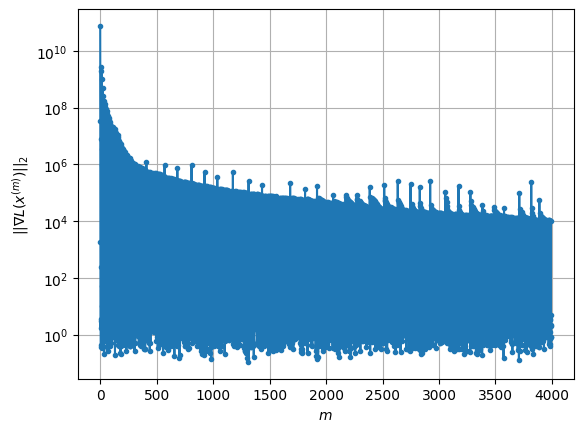

Windows:  11%|█▏        | 34/296 [2:11:48<14:07:46, 194.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 579.6056439581608
Gradient norm: 164771.1068984807
Global relative error: 11.972638912690522
Position relative errors: 0.017097550520815085 m, 7.939203119154186 m, 5.626202566383742 m, 6.975550564524653 m

Iteration 1
Cost function: 578.905804606199 (-0.12%)
Gradient norm: 6.223796493092255 (-100.00%)
Global relative error = 11.92941984038414 (-0.36%)
Position relative errors: 0.019237693952134767 m, 7.910022924056255 m, 5.603311985632681 m, 6.953038109750433 m

Iteration 2
Cost function: 578.9058047981699 (0.00%)
Gradient norm: 2.403932492120432 (-61.38%)
Global relative error = 11.929419815635239 (-0.00%)
Position relative errors: 0.019237686457503223 m, 7.910022889749241 m, 5.603311982061024 m, 6.953038109216371 m

Iteration 3
Cost function: 578.905804788982 (-0.00%)
Gradient norm: 2.7615734911080363 (14.88%)
Global relative error = 11.92941981635612 (0.00%)
Position relative errors: 0.01923769292673

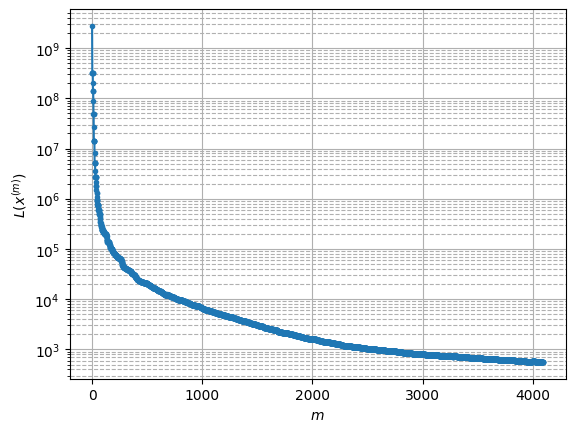

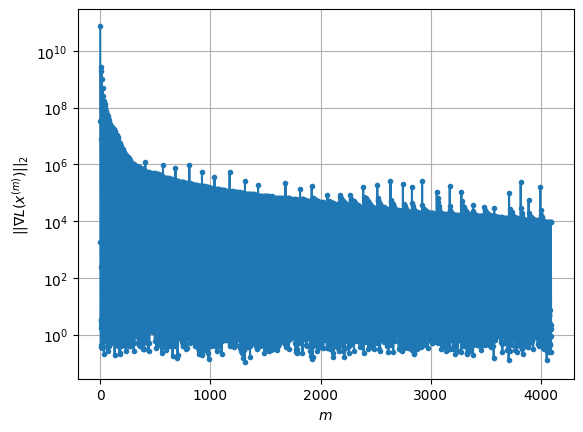

Windows:  12%|█▏        | 35/296 [2:15:00<14:01:27, 193.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 562.4940914920469
Gradient norm: 101941.31706662534
Global relative error: 12.260499816559193
Position relative errors: 0.019523299169733485 m, 8.129049297724057 m, 5.744709652717718 m, 7.157934930097254 m

Iteration 1
Cost function: 561.941019080332 (-0.10%)
Gradient norm: 4.210571210820841 (-100.00%)
Global relative error = 12.219154865287516 (-0.34%)
Position relative errors: 0.021813658563147525 m, 8.100240954569305 m, 5.724197386460076 m, 7.136289068576677 m

Iteration 2
Cost function: 561.941019431042 (0.00%)
Gradient norm: 4.352214864821736 (3.36%)
Global relative error = 12.219154837202524 (-0.00%)
Position relative errors: 0.021813657444062818 m, 8.10024091622909 m, 5.724197378301502 m, 7.136289070554757 m

Iteration 3
Cost function: 561.9410195042335 (0.00%)
Gradient norm: 4.954788128064791 (13.85%)
Global relative error = 12.219154837084961 (-0.00%)
Position relative errors: 0.021813656641263

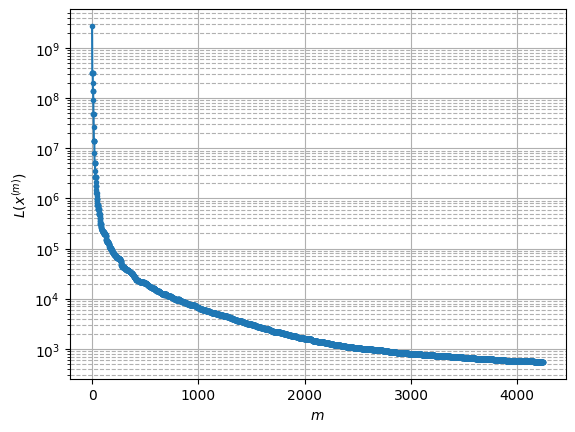

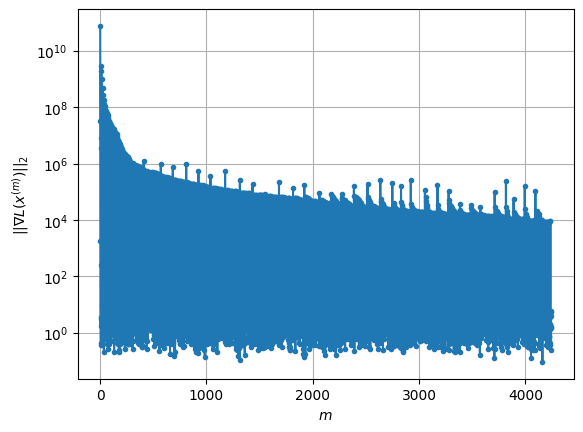

Windows:  12%|█▏        | 36/296 [2:19:45<15:57:27, 220.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 546.2938734526119
Gradient norm: 143671.12445005515
Global relative error: 12.432215175143504
Position relative errors: 0.02182588297588151 m, 8.248923013862377 m, 5.814676488506402 m, 7.259755884921799 m

STOP on Iteration 1
Cost function = 545.7505702951664 (-0.10%)
Gradient norm = 0.18704966832482323 (-100.00%)
Global relative error = 12.392269463372173 (-0.32%)
Final position relative errors: 0.01654825857099295 m, 8.222825127929793 m, 5.790606613557385 m, 7.240293038628102 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 545.3505367858077
Gradient norm: 26872.151242765704
Global relative error: 12.392269463372173
Position relative errors: 0.01654825857099295 m, 8.222825127929793 m, 5.790606613557385 m, 7.240293038628102 m

STOP on Iteration 1
Cost function = 544.9830499997059 (-0.07%)
Gradient norm = 0.6897347683455779 (-100.00%)
Global relative error = 12.3530

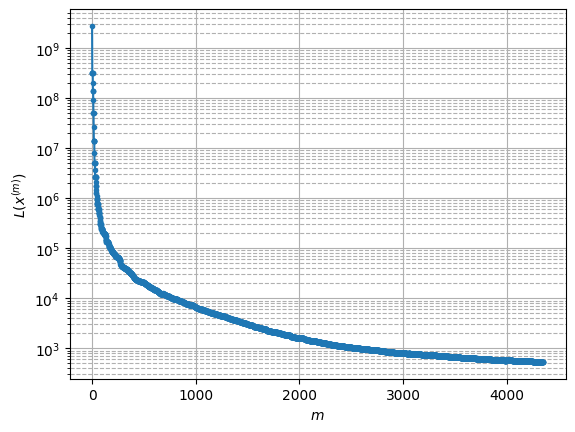

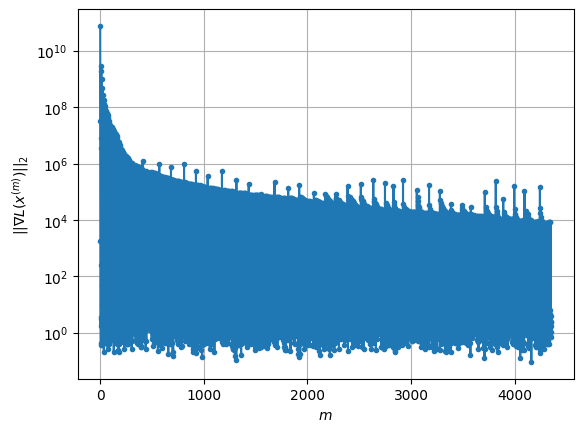

Windows:  12%|█▎        | 37/296 [2:23:13<15:37:33, 217.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 532.8849068867333
Gradient norm: 242090.00822044103
Global relative error: 12.542542152370453
Position relative errors: 0.01612604889491209 m, 8.328546655431303 m, 5.832942824591988 m, 7.343500251896709 m

Iteration 1
Cost function: 532.2912016412804 (-0.11%)
Gradient norm: 2.6612826618198024 (-100.00%)
Global relative error = 12.503663927761353 (-0.31%)
Position relative errors: 0.024700539600806527 m, 8.300698547303773 m, 5.81579524748977 m, 7.322276669790414 m

Iteration 2
Cost function: 532.2912016027979 (-0.00%)
Gradient norm: 2.05406623304895 (-22.82%)
Global relative error = 12.503663917593975 (-0.00%)
Position relative errors: 0.024700530395781944 m, 8.300698532976154 m, 5.8157952473559344 m, 7.322276668807869 m

Iteration 3
Cost function: 532.2912013420598 (-0.00%)
Gradient norm: 4.053500503911606 (97.34%)
Global relative error = 12.503663917284701 (-0.00%)
Position relative errors: 0.024700529

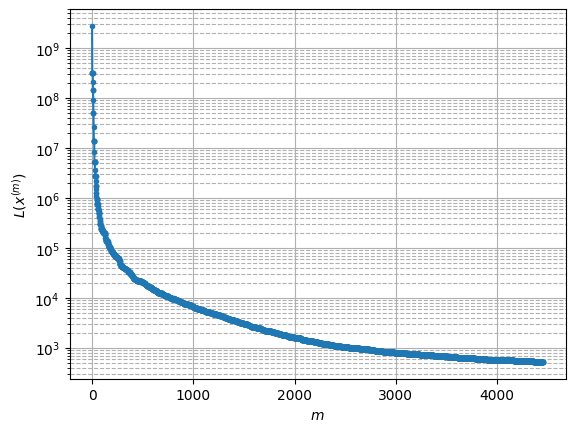

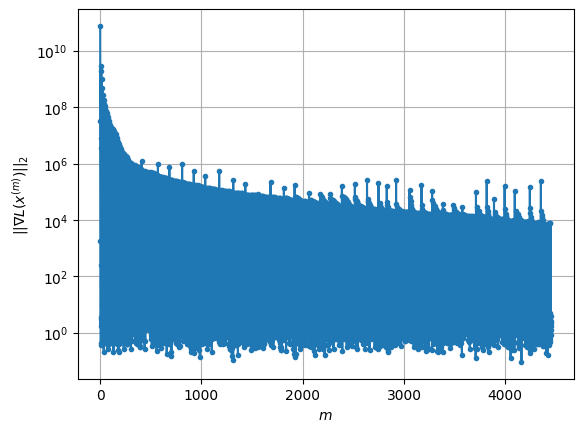

Windows:  13%|█▎        | 38/296 [2:26:29<15:05:34, 210.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 518.6554932714903
Gradient norm: 122281.32216593255
Global relative error: 12.564481722982029
Position relative errors: 0.02549213224931439 m, 8.332830288781865 m, 5.877918107164038 m, 7.340259995873284 m

Iteration 1
Cost function: 518.273363608426 (-0.07%)
Gradient norm: 3.366213387423759 (-100.00%)
Global relative error = 12.526600752004665 (-0.30%)
Position relative errors: 0.027871762022043174 m, 8.304527143753678 m, 5.859351496717559 m, 7.322405819676478 m

STOP on Iteration 2
Cost function = 518.2733634550293 (-0.00%)
Gradient norm = 0.6740635920194451 (-79.98%)
Global relative error = 12.526600749981629 (-0.00%)
Final position relative errors: 0.02787176370585593 m, 8.304527142419884 m, 5.859351496743042 m, 7.322405817701517 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 517.9807288887148
Gradient norm: 18068.84315306657
Global relative error: 12.526600749

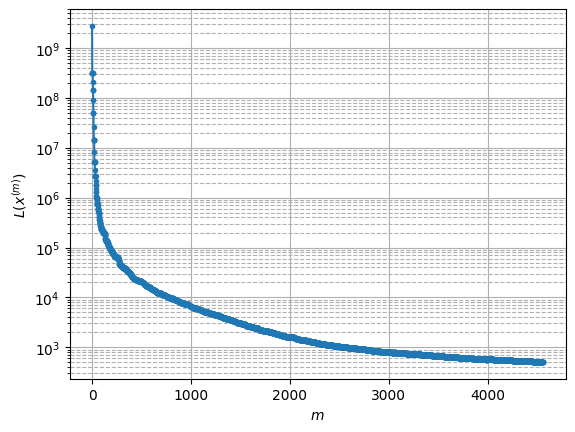

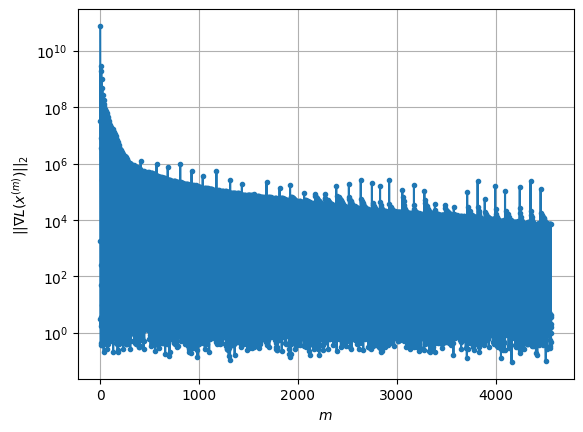

Windows:  13%|█▎        | 39/296 [2:29:57<14:59:20, 209.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 507.81867152544163
Gradient norm: 33048.264948962016
Global relative error: 12.499068682021681
Position relative errors: 0.02563602332562294 m, 8.270981127764667 m, 5.847441846808963 m, 7.322857328075594 m

Iteration 1
Cost function: 507.51779188427423 (-0.06%)
Gradient norm: 3.7734472754693686 (-99.99%)
Global relative error = 12.462025563337843 (-0.30%)
Position relative errors: 0.032969454064035064 m, 8.243304225528528 m, 5.831256913823293 m, 7.303783728650089 m

Iteration 2
Cost function: 507.5177922018938 (0.00%)
Gradient norm: 3.4313515268906873 (-9.07%)
Global relative error = 12.462025565949274 (0.00%)
Position relative errors: 0.03296945361011493 m, 8.243304233088487 m, 5.831256910941145 m, 7.303783726876516 m

Iteration 3
Cost function: 507.5177917308774 (-0.00%)
Gradient norm: 1.5438352376209328 (-55.01%)
Global relative error = 12.462025566960227 (0.00%)
Position relative errors: 0.032969452

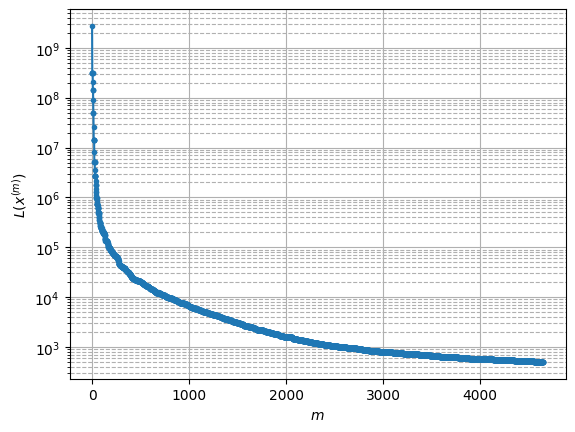

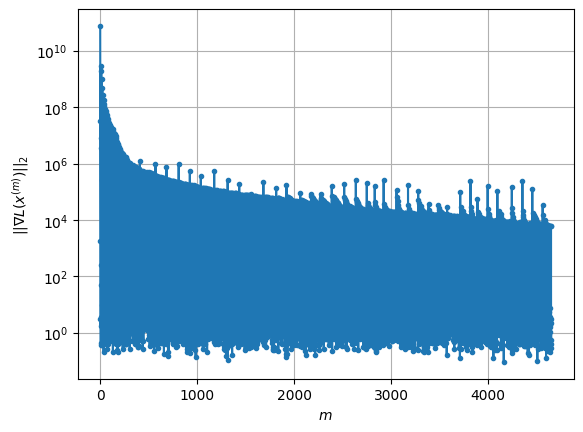

Windows:  14%|█▎        | 40/296 [2:32:51<14:09:17, 199.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 503.5338769166385
Gradient norm: 159923.1407391092
Global relative error: 12.358589097195189
Position relative errors: 0.03171346639546258 m, 8.149976034485984 m, 5.818991793995762 m, 7.242296370822923 m

Iteration 1
Cost function: 503.0898580577428 (-0.09%)
Gradient norm: 1.4618418543437484 (-100.00%)
Global relative error = 12.322052456897941 (-0.30%)
Position relative errors: 0.02613057900269344 m, 8.12397349687506 m, 5.802550644841933 m, 7.222441963158667 m

Iteration 2
Cost function: 503.0898584166335 (0.00%)
Gradient norm: 2.361820623783774 (61.56%)
Global relative error = 12.322052461913865 (0.00%)
Position relative errors: 0.026130576925213925 m, 8.123973505921107 m, 5.802550642723708 m, 7.222441963250332 m

STOP on Iteration 3
Cost function = 503.08985848051435 (0.00%)
Gradient norm = 0.7512661476724094 (-68.19%)
Global relative error = 12.322052462060544 (0.00%)
Final position relative errors:

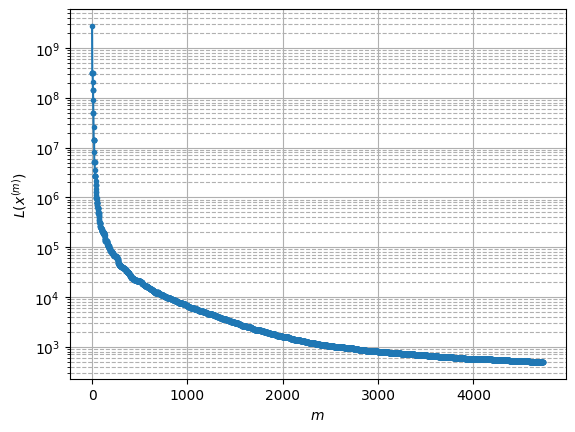

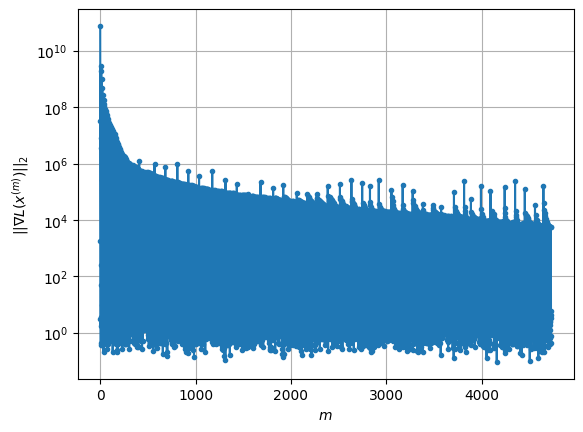

Windows:  14%|█▍        | 41/296 [2:35:30<13:15:42, 187.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 495.0376687179318
Gradient norm: 48802.46879184886
Global relative error: 12.143307386368496
Position relative errors: 0.025190829997335042 m, 7.987939814866785 m, 5.760890293688193 m, 7.10381421190719 m

Iteration 1
Cost function: 494.6869582519418 (-0.07%)
Gradient norm: 2.8257379431798872 (-99.99%)
Global relative error = 12.106862006501533 (-0.30%)
Position relative errors: 0.02462257057152481 m, 7.960455440211474 m, 5.742584167220302 m, 7.087264217652687 m

Iteration 2
Cost function: 494.686958194514 (-0.00%)
Gradient norm: 3.1100612028993324 (10.06%)
Global relative error = 12.106862037000484 (0.00%)
Position relative errors: 0.024622564989404516 m, 7.960455482878922 m, 5.742584173017744 m, 7.087264217150277 m

Iteration 3
Cost function: 494.68695815051575 (-0.00%)
Gradient norm: 1.1803137085488449 (-62.05%)
Global relative error = 12.106862036734451 (-0.00%)
Position relative errors: 0.0246225704

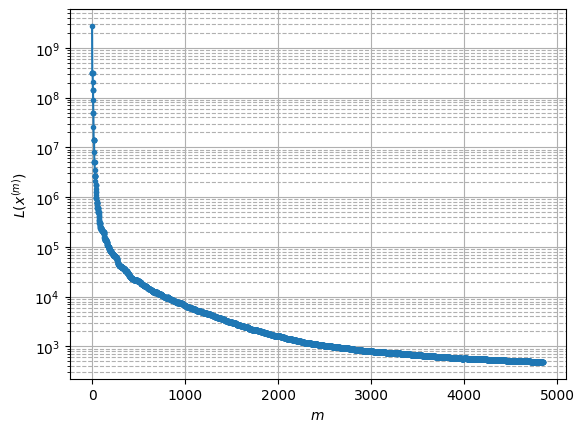

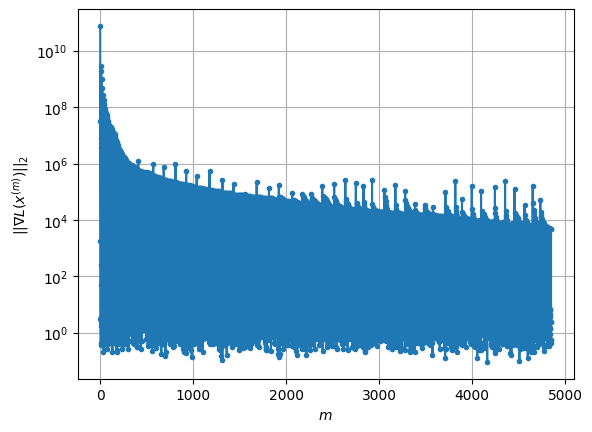

Windows:  14%|█▍        | 42/296 [2:39:16<14:00:53, 198.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 495.7431148696207
Gradient norm: 533849.7239991431
Global relative error: 11.86700065244494
Position relative errors: 0.02308835826062746 m, 7.803107795222489 m, 5.625177592768546 m, 6.9493892826305705 m

Iteration 1
Cost function: 495.0633020259263 (-0.14%)
Gradient norm: 5.621920173160732 (-100.00%)
Global relative error = 11.832972559691898 (-0.29%)
Position relative errors: 0.029089636370542214 m, 7.7788433505007895 m, 5.60835604240652 m, 6.932119909264134 m

Iteration 2
Cost function: 495.0633022027365 (0.00%)
Gradient norm: 5.063524823754368 (-9.93%)
Global relative error = 11.832972575403444 (0.00%)
Position relative errors: 0.029089637355622804 m, 7.778843375434578 m, 5.608356040389174 m, 6.932119909732054 m

Iteration 3
Cost function: 495.06330206848355 (-0.00%)
Gradient norm: 2.5409741491781666 (-49.82%)
Global relative error = 11.832972575412928 (0.00%)
Position relative errors: 0.02908962446

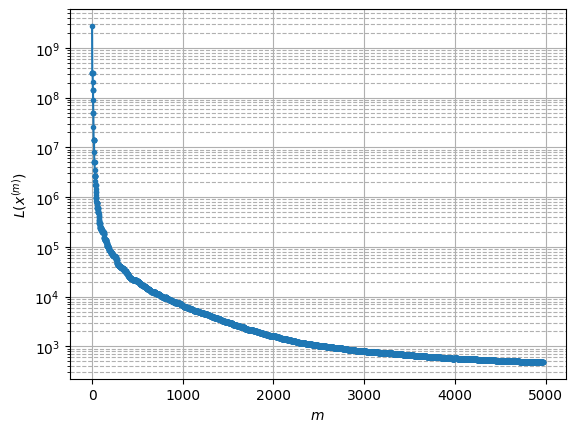

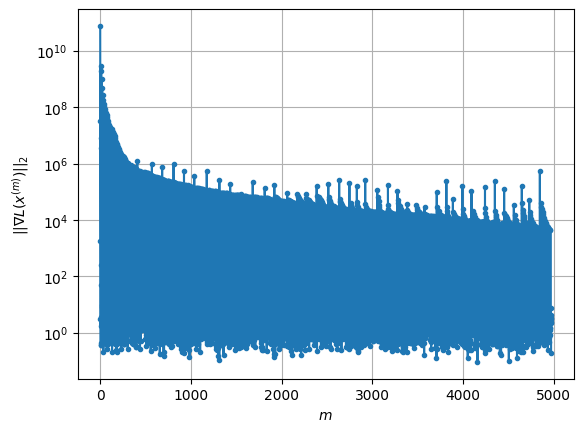

Windows:  15%|█▍        | 43/296 [2:43:37<15:17:10, 217.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 489.92564496591353
Gradient norm: 107913.1548901762
Global relative error: 11.555895426349435
Position relative errors: 0.026992095106127482 m, 7.579581501674206 m, 5.482708623673133 m, 6.784379777687901 m

STOP on Iteration 1
Cost function = 489.6112605722445 (-0.06%)
Gradient norm = 0.7776467513695763 (-100.00%)
Global relative error = 11.52293056605794 (-0.29%)
Final position relative errors: 0.0322646902243136 m, 7.55576180095987 m, 5.4667156826639225 m, 6.7677425513502145 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 489.42232178783144
Gradient norm: 33563.66101398933
Global relative error: 11.52293056605794
Position relative errors: 0.0322646902243136 m, 7.55576180095987 m, 5.4667156826639225 m, 6.7677425513502145 m

Iteration 1
Cost function: 489.2637027379775 (-0.03%)
Gradient norm: 3.1235236619358684 (-99.99%)
Global relative error = 11.489914599729724 (

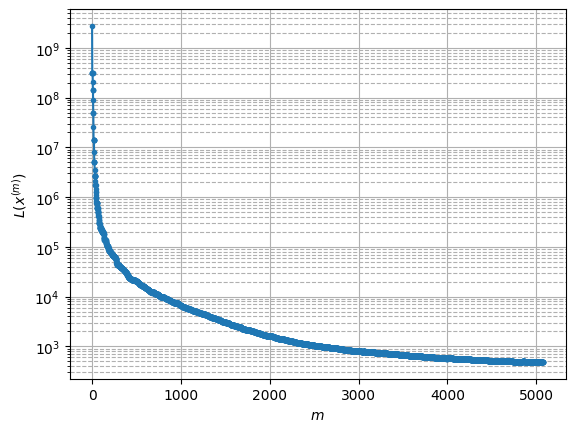

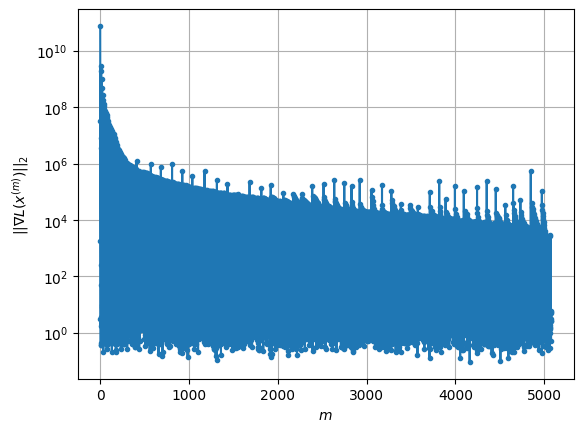

Windows:  15%|█▍        | 44/296 [2:47:35<15:39:34, 223.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 485.35087241251955
Gradient norm: 122931.87075639167
Global relative error: 11.20650376783181
Position relative errors: 0.030924486056306332 m, 7.339586377304651 m, 5.353658115466047 m, 6.561521589883817 m

Iteration 1
Cost function: 484.9680267146549 (-0.08%)
Gradient norm: 1.333563793166223 (-100.00%)
Global relative error = 11.17495367881987 (-0.28%)
Position relative errors: 0.01607329298071259 m, 7.316903943786094 m, 5.339127129622265 m, 6.544917740838334 m

STOP on Iteration 2
Cost function = 484.96802724013816 (0.00%)
Gradient norm = 0.7382782721836126 (-44.64%)
Global relative error = 11.174953650158097 (-0.00%)
Final position relative errors: 0.01607329189256208 m, 7.316903898570497 m, 5.339127131396878 m, 6.544917741004388 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 484.81771436380933
Gradient norm: 22836.013397489394
Global relative error: 11.1749536

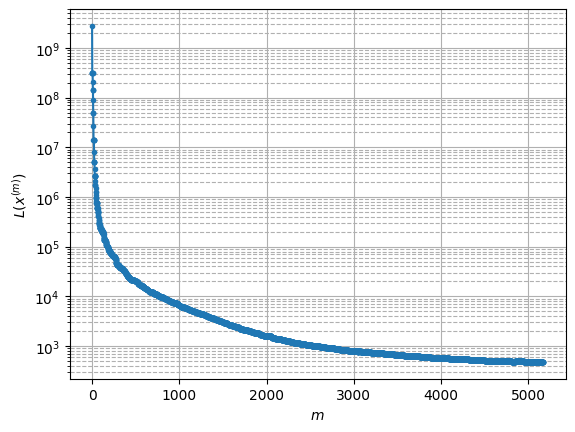

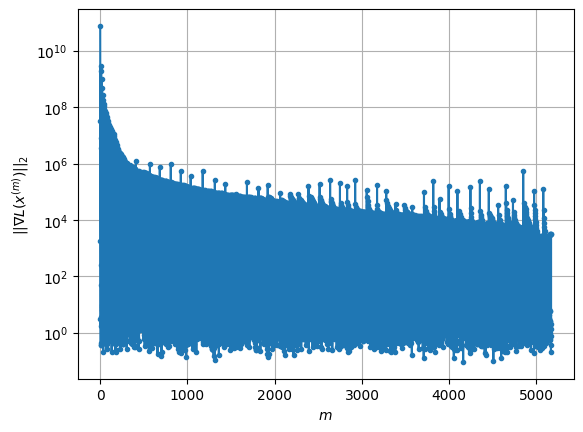

Windows:  15%|█▌        | 45/296 [2:51:03<15:16:15, 219.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 474.08721251461424
Gradient norm: 137426.849603442
Global relative error: 10.827907138568076
Position relative errors: 0.015930831847659865 m, 7.099906514354682 m, 5.181435996692947 m, 6.323555496249105 m

Iteration 1
Cost function: 473.6169374688813 (-0.10%)
Gradient norm: 2.8940065807300797 (-100.00%)
Global relative error = 10.798690347711707 (-0.27%)
Position relative errors: 0.008179371469029842 m, 7.078810247452765 m, 5.163668410208016 m, 6.311783169732963 m

Iteration 2
Cost function: 473.6169377387567 (0.00%)
Gradient norm: 6.239017769365516 (115.58%)
Global relative error = 10.798690334732079 (-0.00%)
Position relative errors: 0.008179370206946422 m, 7.078810223612582 m, 5.1636684158533415 m, 6.311783169646919 m

Iteration 3
Cost function: 473.61693781864744 (0.00%)
Gradient norm: 2.071350908759845 (-66.80%)
Global relative error = 10.798690334797705 (0.00%)
Position relative errors: 0.00817937

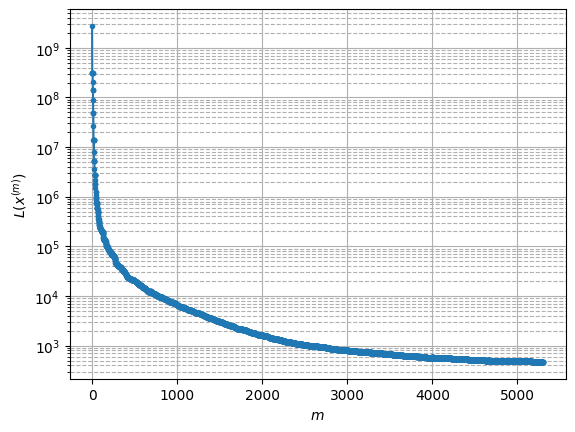

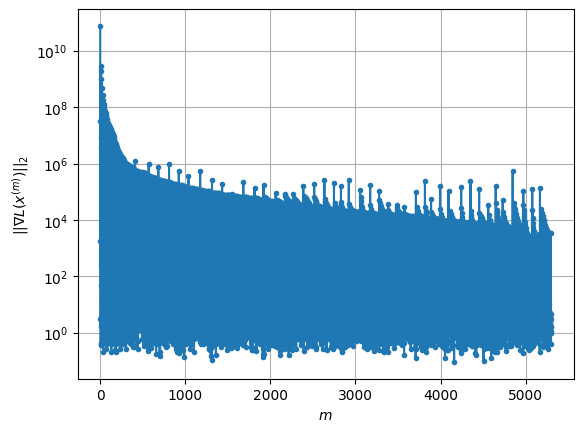

Windows:  16%|█▌        | 46/296 [2:55:40<16:24:15, 236.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 466.04197773687
Gradient norm: 132327.9954846895
Global relative error: 10.426701503752962
Position relative errors: 0.0088821105847328 m, 6.836342130390728 m, 4.928442945801775 m, 6.1392909670121 m

Iteration 1
Cost function: 465.7797606295969 (-0.06%)
Gradient norm: 1.0177716998671984 (-100.00%)
Global relative error = 10.396953834413761 (-0.29%)
Position relative errors: 0.006505453945211304 m, 6.816166495716838 m, 4.912613116926106 m, 6.12394523438567 m

Iteration 2
Cost function: 465.77976082130823 (0.00%)
Gradient norm: 3.813951692100184 (274.74%)
Global relative error = 10.396953842871334 (0.00%)
Position relative errors: 0.006505456236274854 m, 6.8161665070976545 m, 4.9126131178592125 m, 6.123945235326334 m

Iteration 3
Cost function: 465.7797610211505 (0.00%)
Gradient norm: 2.92190735100526 (-23.39%)
Global relative error = 10.396953842456359 (-0.00%)
Position relative errors: 0.006505458941151

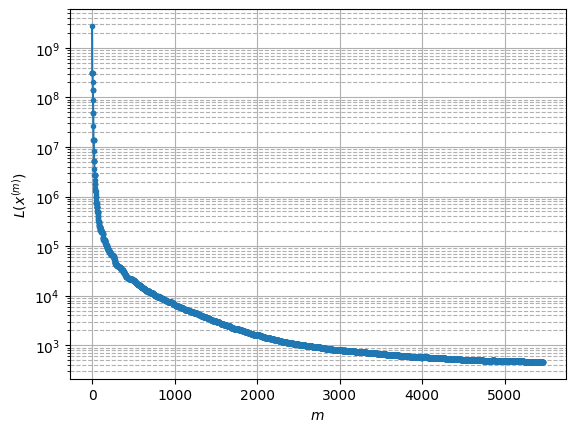

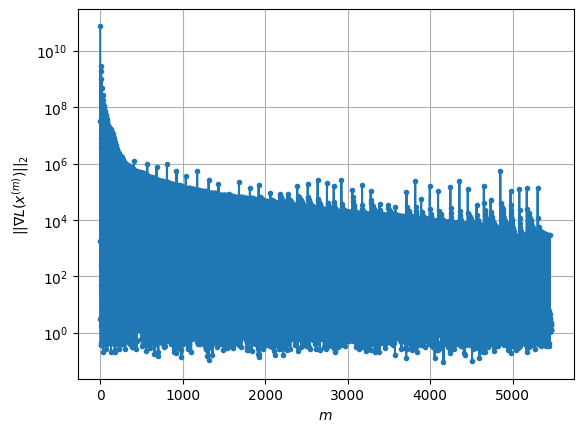

Windows:  16%|█▌        | 47/296 [3:01:03<18:08:35, 262.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.8368355568041
Gradient norm: 80528.26515742288
Global relative error: 9.99403770302227
Position relative errors: 0.00686198412979244 m, 6.576503926143606 m, 4.722145922945836 m, 5.859323508068257 m

Iteration 1
Cost function: 459.6936627668626 (-0.03%)
Gradient norm: 5.995142837961667 (-99.99%)
Global relative error = 9.966231750394618 (-0.28%)
Position relative errors: 0.00741056268128414 m, 6.557288387303502 m, 4.709291387681057 m, 5.843822334601875 m

Iteration 2
Cost function: 459.6936627139762 (-0.00%)
Gradient norm: 7.051062246307067 (17.61%)
Global relative error = 9.966231743900728 (-0.00%)
Position relative errors: 0.007410553065676357 m, 6.557288378804535 m, 4.709291386880342 m, 5.8438223337210475 m

STOP on Iteration 3
Cost function = 459.69366273107784 (0.00%)
Gradient norm = 0.7123487278622911 (-89.90%)
Global relative error = 9.96623174352341 (-0.00%)
Final position relative errors: 0.

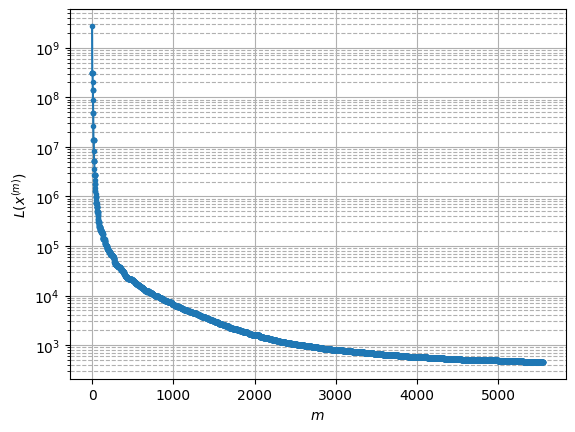

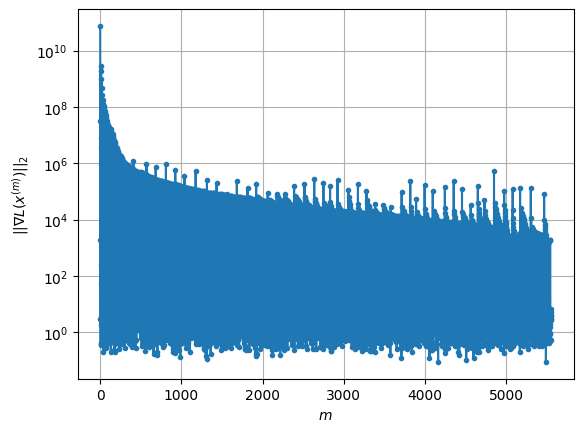

Windows:  16%|█▌        | 48/296 [3:03:54<16:11:13, 234.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.5761160922108
Gradient norm: 177776.34230782403
Global relative error: 9.541417419163064
Position relative errors: 0.008492471625533037 m, 6.287491040796629 m, 4.532508514015373 m, 5.564386303758014 m

Iteration 1
Cost function: 455.1237499133637 (-0.10%)
Gradient norm: 9.78619870528703 (-99.99%)
Global relative error = 9.514163421663143 (-0.29%)
Position relative errors: 0.0072355115092412195 m, 6.267943545352743 m, 4.521629021939732 m, 5.548603939950375 m

Iteration 2
Cost function: 455.1237501750638 (0.00%)
Gradient norm: 3.2591210575624507 (-66.70%)
Global relative error = 9.514163447348428 (0.00%)
Position relative errors: 0.007235523226788874 m, 6.267943584152991 m, 4.52162902302849 m, 5.548603939259841 m

Iteration 3
Cost function: 455.1237498272751 (-0.00%)
Gradient norm: 1.5132435900524774 (-53.57%)
Global relative error = 9.514163447080199 (-0.00%)
Position relative errors: 0.0072355209787

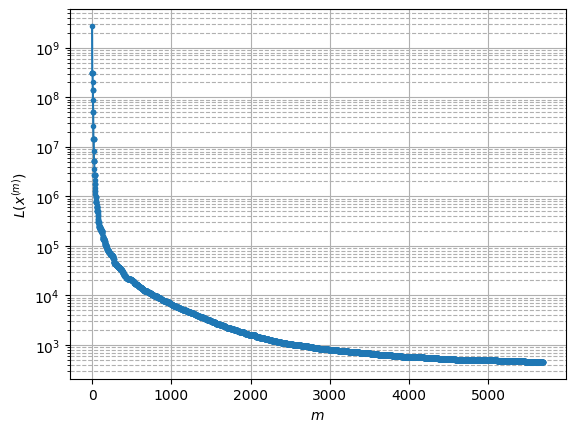

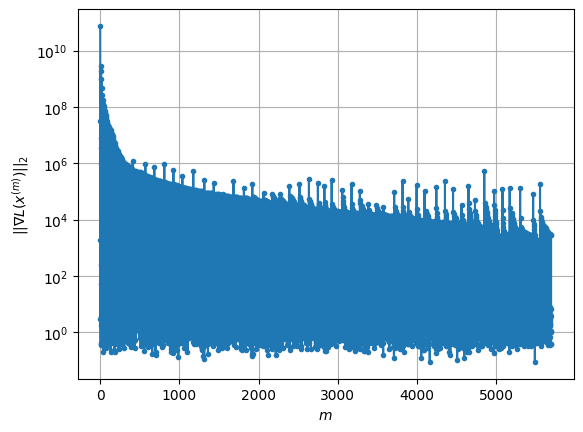

Windows:  17%|█▋        | 49/296 [3:08:31<16:59:42, 247.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.12035210855004
Gradient norm: 98345.91730073067
Global relative error: 9.07064800671948
Position relative errors: 0.008036299527496 m, 5.993745250788794 m, 4.346286177215761 m, 5.240362958022057 m

STOP on Iteration 1
Cost function = 453.8560441543831 (-0.06%)
Gradient norm = 0.6514977260078091 (-100.00%)
Global relative error = 9.045681122602318 (-0.28%)
Final position relative errors: 0.005469458878876796 m, 5.976341714433297 m, 4.334767416688089 m, 5.226609524965921 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 453.75124230771496
Gradient norm: 10435.454789955758
Global relative error: 9.045681122602318
Position relative errors: 0.005469458878876796 m, 5.976341714433297 m, 4.334767416688089 m, 5.226609524965921 m

STOP on Iteration 1
Cost function = 453.66944774164824 (-0.02%)
Gradient norm = 0.9077290140026038 (-99.99%)
Global relative error = 9.020789413

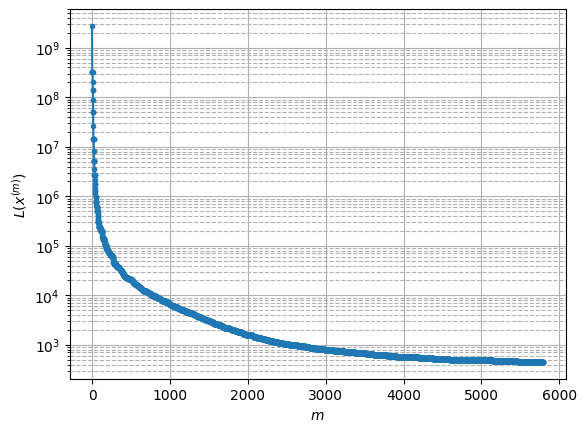

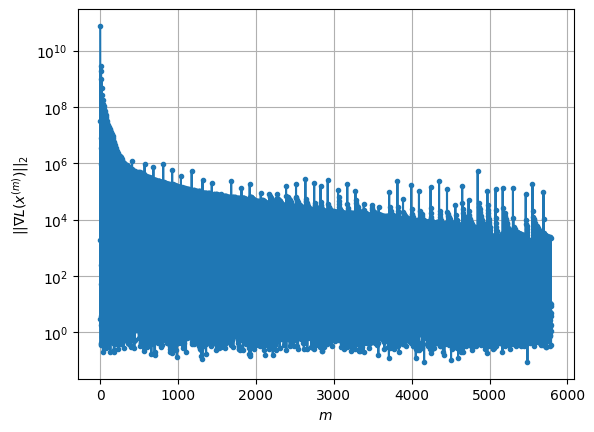

Windows:  17%|█▋        | 50/296 [3:11:46<15:49:59, 231.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.56138615900653
Gradient norm: 58005.96477555528
Global relative error: 8.602134437722473
Position relative errors: 0.0059350693330320415 m, 5.687115662624869 m, 4.134339651829575 m, 4.9558684414646255 m

STOP on Iteration 1
Cost function = 448.213987596831 (-0.08%)
Gradient norm = 0.9640024446803651 (-100.00%)
Global relative error = 8.57913137840736 (-0.27%)
Final position relative errors: 0.01726947576747527 m, 5.670771061102249 m, 4.124198641704297 m, 4.94313032064785 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 448.1073846123504
Gradient norm: 13657.97733587631
Global relative error: 8.57913137840736
Position relative errors: 0.01726947576747527 m, 5.670771061102249 m, 4.124198641704297 m, 4.94313032064785 m

Iteration 1
Cost function: 448.0247654469429 (-0.02%)
Gradient norm: 1.3955691016455003 (-99.99%)
Global relative error = 8.555808243275102 (-0.27%

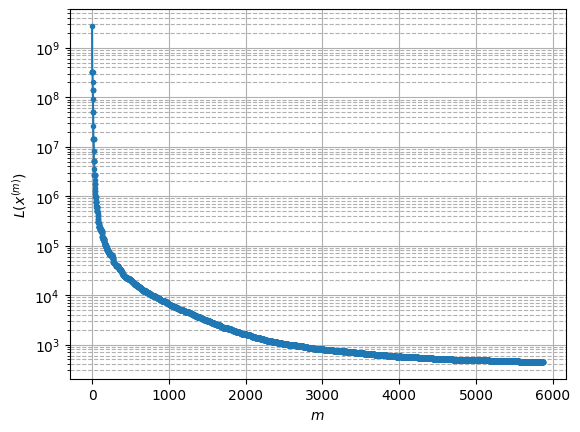

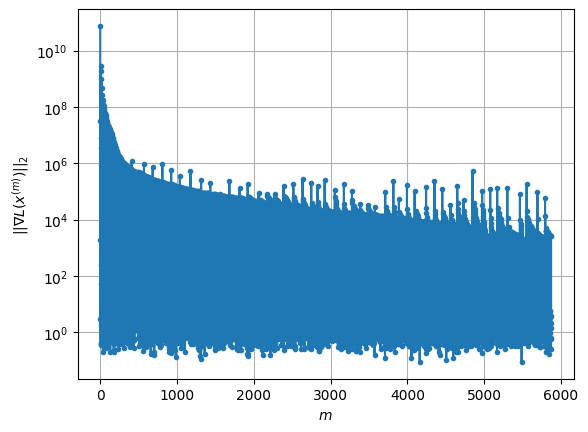

Windows:  17%|█▋        | 51/296 [3:14:24<14:16:01, 209.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 443.52809683111394
Gradient norm: 369516.60969785904
Global relative error: 8.131193649898245
Position relative errors: 0.017075595037546104 m, 5.392142291057225 m, 3.9150306176600833 m, 4.659759056793829 m

Iteration 1
Cost function: 442.7649591103953 (-0.17%)
Gradient norm: 2.3323228462565138 (-100.00%)
Global relative error = 8.111488796822389 (-0.24%)
Position relative errors: 0.03305407597894383 m, 5.379407328904179 m, 3.9063276545277117 m, 4.647336661010973 m

STOP on Iteration 2
Cost function = 442.7649592137067 (0.00%)
Gradient norm = 0.8007324278959389 (-65.67%)
Global relative error = 8.111488820690282 (0.00%)
Final position relative errors: 0.0330540670186176 m, 5.379407362529593 m, 3.9063276583276823 m, 4.647336660617554 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 442.5193957923083
Gradient norm: 26649.08038939509
Global relative error: 8.1114888206

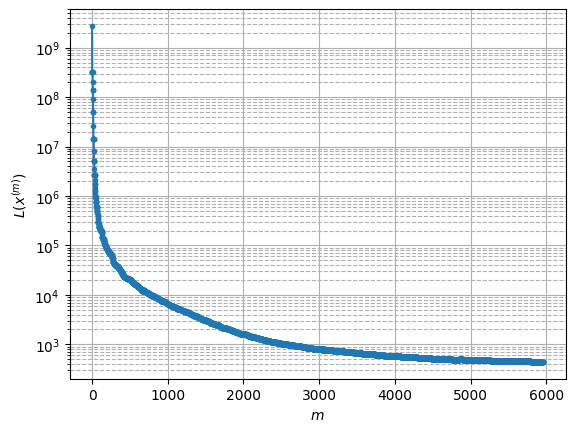

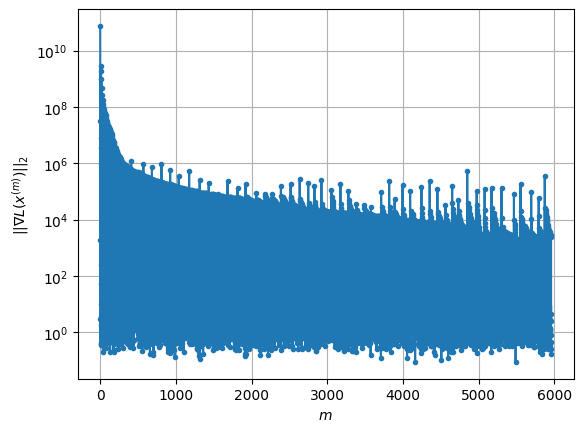

Windows:  18%|█▊        | 52/296 [3:17:12<13:22:15, 197.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.68014442896373
Gradient norm: 66038.80980756828
Global relative error: 7.6719915175014695
Position relative errors: 0.030375265924110172 m, 5.128561915250052 m, 3.675145562979495 m, 4.364594763861997 m

Iteration 1
Cost function: 442.5600000993027 (-0.03%)
Gradient norm: 3.6554931068056304 (-99.99%)
Global relative error = 7.6526688140571535 (-0.25%)
Position relative errors: 0.03273189861987082 m, 5.1174588036550706 m, 3.663335372583777 m, 4.353602694445629 m

Iteration 2
Cost function: 442.5599999834439 (-0.00%)
Gradient norm: 3.98489724873778 (9.01%)
Global relative error = 7.652668818397581 (0.00%)
Position relative errors: 0.032731900989783666 m, 5.117458809293064 m, 3.6633353739754444 m, 4.3536026942591075 m

STOP on Iteration 3
Cost function = 442.5599999681782 (-0.00%)
Gradient norm = 0.24322691253712833 (-93.90%)
Global relative error = 7.652668818194661 (-0.00%)
Final position relative err

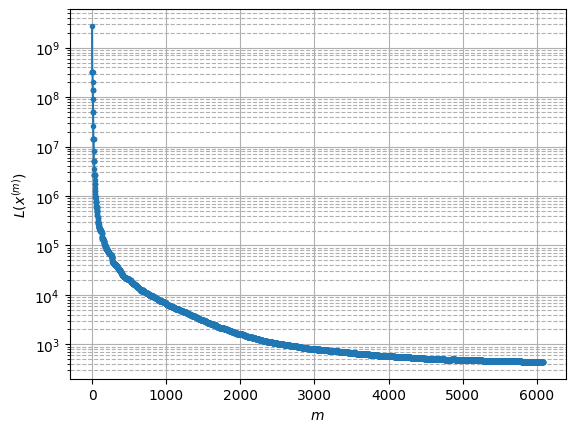

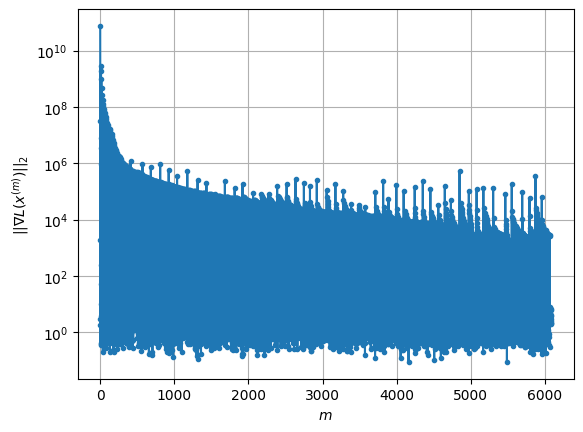

Windows:  18%|█▊        | 53/296 [3:21:25<14:26:03, 213.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 440.41933494356635
Gradient norm: 254746.19430019072
Global relative error: 7.202015299857002
Position relative errors: 0.0311551100617483 m, 4.860533155713567 m, 3.404463200936432 m, 4.080796396587873 m

Iteration 1
Cost function: 440.1498235346519 (-0.06%)
Gradient norm: 5.64001771422755 (-100.00%)
Global relative error = 7.182362570735535 (-0.27%)
Position relative errors: 0.026235339411825254 m, 4.8505768721852585 m, 3.3895495367956534 m, 4.070442174828702 m

Iteration 2
Cost function: 440.14982356996586 (0.00%)
Gradient norm: 1.2866487559926603 (-77.19%)
Global relative error = 7.182362569126946 (-0.00%)
Position relative errors: 0.026235342317443486 m, 4.850576869273438 m, 3.389549537382933 m, 4.070442174952449 m

Iteration 3
Cost function: 440.14982404500427 (0.00%)
Gradient norm: 3.008871289992777 (133.85%)
Global relative error = 7.182362569279617 (0.00%)
Position relative errors: 0.02623534166

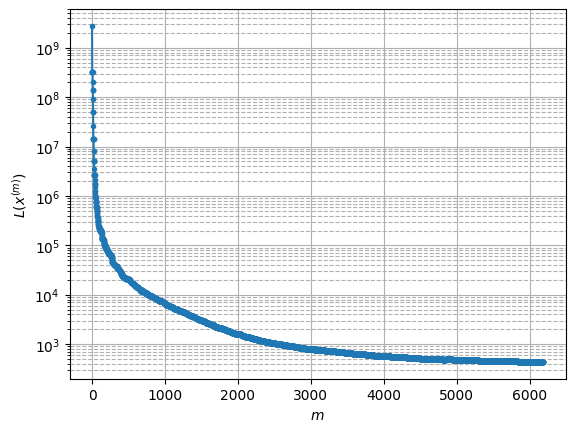

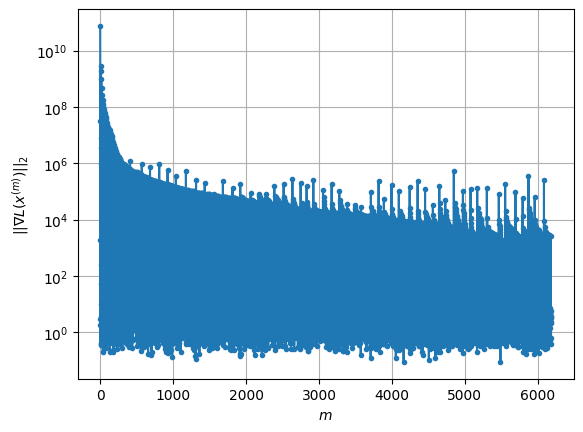

Windows:  18%|█▊        | 54/296 [3:24:42<14:01:47, 208.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 437.5186597865035
Gradient norm: 44745.50488612874
Global relative error: 6.7268638524203626
Position relative errors: 0.02537957227355225 m, 4.605656170394158 m, 3.1039916469723714 m, 3.795157066406491 m

STOP on Iteration 1
Cost function = 437.3758725646499 (-0.03%)
Gradient norm = 0.3735080565857791 (-100.00%)
Global relative error = 6.708392583378524 (-0.27%)
Final position relative errors: 0.019829296143312292 m, 4.5950677132554265 m, 3.094265109021817 m, 3.78325401148065 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 437.30396417450044
Gradient norm: 9178.739716336095
Global relative error: 6.708392583378524
Position relative errors: 0.019829296143312292 m, 4.5950677132554265 m, 3.094265109021817 m, 3.78325401148065 m

STOP on Iteration 1
Cost function = 437.24259123973815 (-0.01%)
Gradient norm = 0.4515651954804381 (-100.00%)
Global relative error = 6.68925

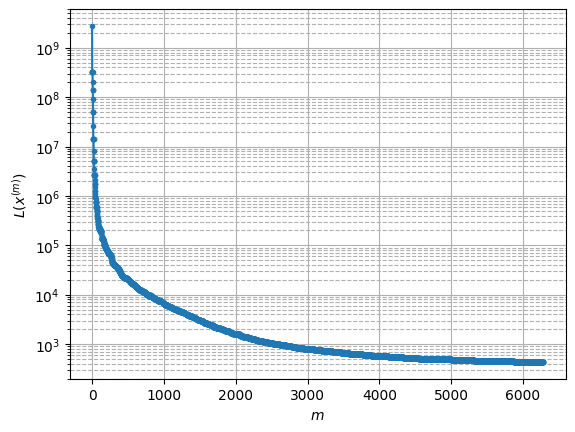

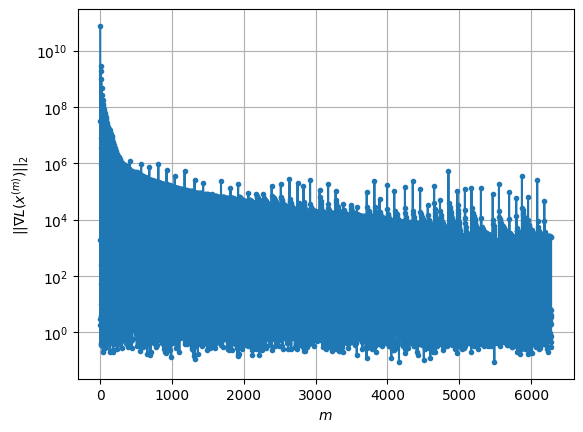

Windows:  19%|█▊        | 55/296 [3:27:52<13:35:54, 203.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 439.36432511943957
Gradient norm: 237032.6768044441
Global relative error: 6.254099182180109
Position relative errors: 0.020687241021265883 m, 4.33041434168021 m, 2.8670845268874894 m, 3.4843453749948226 m

Iteration 1
Cost function: 439.2094165445201 (-0.04%)
Gradient norm: 3.5058513763364108 (-100.00%)
Global relative error = 6.234509995814294 (-0.31%)
Position relative errors: 0.01846205352038282 m, 4.3201908573563115 m, 2.8538638386763866 m, 3.4727773283222545 m

Iteration 2
Cost function: 439.20941636904996 (-0.00%)
Gradient norm: 3.508474936710196 (0.07%)
Global relative error = 6.234509992855808 (-0.00%)
Position relative errors: 0.01846205445431988 m, 4.320190852776783 m, 2.85386383890499 m, 3.47277732851521 m

Iteration 3
Cost function: 439.20941625449564 (-0.00%)
Gradient norm: 4.171170562696769 (18.89%)
Global relative error = 6.234509993150012 (0.00%)
Position relative errors: 0.018462052299

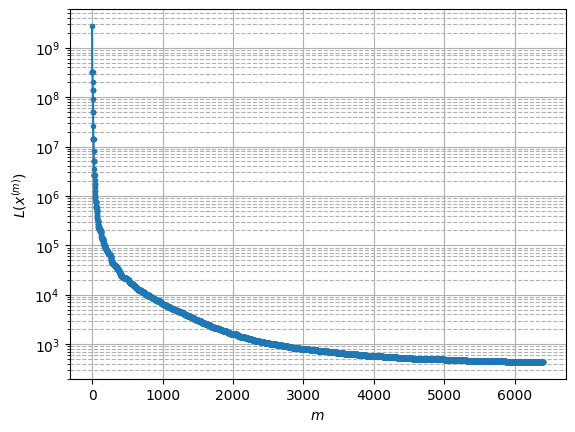

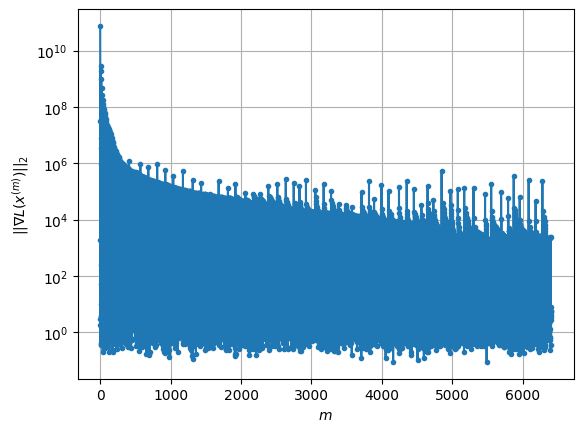

Windows:  19%|█▉        | 56/296 [3:31:59<14:25:09, 216.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 438.0700074168531
Gradient norm: 365688.1255645369
Global relative error: 5.782730144584801
Position relative errors: 0.019238019188341046 m, 4.072684357252447 m, 2.6093523694071123 m, 3.1692452704236787 m

Iteration 1
Cost function: 437.7247531560265 (-0.08%)
Gradient norm: 1.90070888939653 (-100.00%)
Global relative error = 5.7705471384701355 (-0.21%)
Position relative errors: 0.021367587154030393 m, 4.069439377649511 m, 2.5999767630366346 m, 3.158882255253005 m

STOP on Iteration 2
Cost function = 437.7247528258223 (-0.00%)
Gradient norm = 0.2556319855599507 (-86.55%)
Global relative error = 5.770547139491814 (0.00%)
Final position relative errors: 0.021367581978335482 m, 4.069439378971781 m, 2.5999767633333213 m, 3.1588822552067786 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 437.57882593585884
Gradient norm: 19836.42615711447
Global relative error: 5.770547

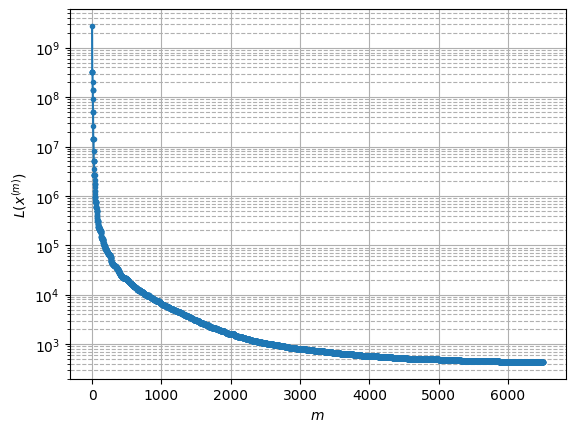

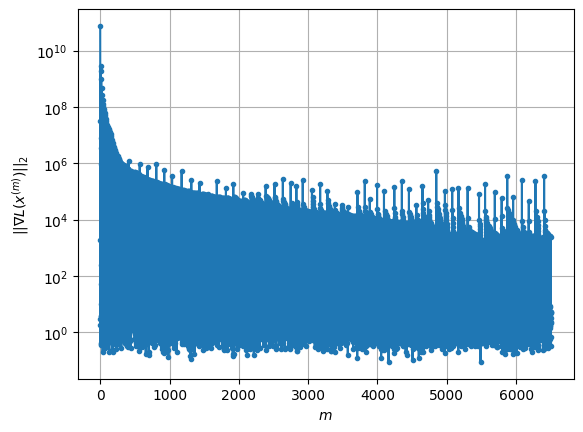

Windows:  19%|█▉        | 57/296 [3:35:21<14:05:01, 212.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 439.720781935129
Gradient norm: 157893.51717794756
Global relative error: 5.355854753455165
Position relative errors: 0.02033652985275382 m, 3.8502005364408536 m, 2.364927359275283 m, 2.87538442046949 m

Iteration 1
Cost function: 439.56211254488426 (-0.04%)
Gradient norm: 2.134332848461962 (-100.00%)
Global relative error = 5.33779598088268 (-0.34%)
Position relative errors: 0.020607457359841375 m, 3.8394986180452473 m, 2.351851308613613 m, 2.8668243235557225 m

STOP on Iteration 2
Cost function = 439.5621124707026 (-0.00%)
Gradient norm = 0.4269822401145849 (-79.99%)
Global relative error = 5.337795981375336 (0.00%)
Final position relative errors: 0.0206074565585295 m, 3.8394986150448487 m, 2.351851314951021 m, 2.86682432329815 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 439.4667509604109
Gradient norm: 30233.472661038657
Global relative error: 5.337795981375

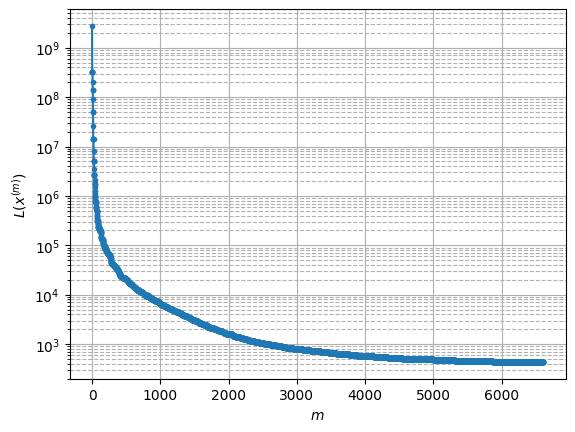

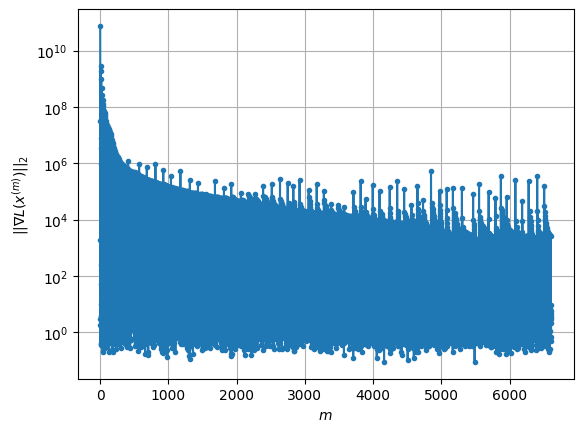

Windows:  20%|█▉        | 58/296 [3:39:10<14:20:54, 217.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.57909183312876
Gradient norm: 97626.89425099439
Global relative error: 4.901003944728273
Position relative errors: 0.020991684951757465 m, 3.589807068169402 m, 2.0890884621408192 m, 2.6016125250380546 m

Iteration 1
Cost function: 442.3816122573509 (-0.04%)
Gradient norm: 1.5170979799060371 (-100.00%)
Global relative error = 4.885092011135666 (-0.32%)
Position relative errors: 0.015381680367023986 m, 3.5807894032680516 m, 2.078942735264311 m, 2.5922626938576268 m

Iteration 2
Cost function: 442.38161257506624 (0.00%)
Gradient norm: 1.6921958181143992 (11.54%)
Global relative error = 4.885092007391439 (-0.00%)
Position relative errors: 0.015381679830883892 m, 3.580789395949945 m, 2.078942737894069 m, 2.5922626948046115 m

Iteration 3
Cost function: 442.3816122064836 (-0.00%)
Gradient norm: 5.1921040647963395 (206.83%)
Global relative error = 4.885092007374895 (-0.00%)
Position relative errors: 0.0153

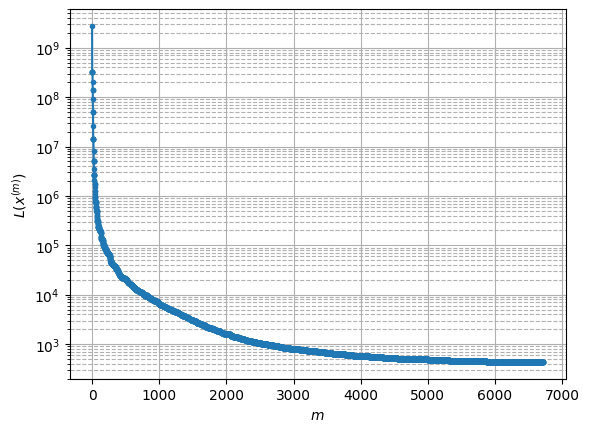

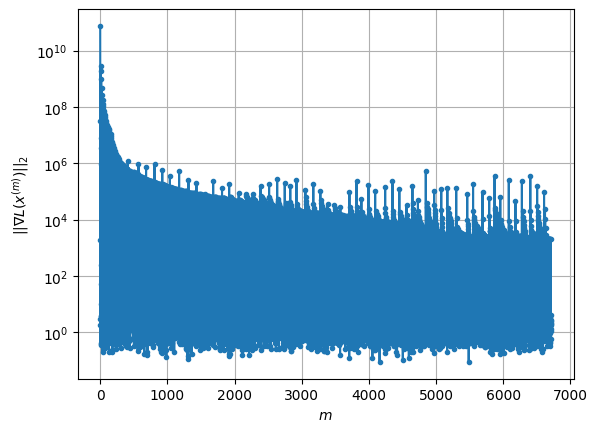

Windows:  20%|█▉        | 59/296 [3:42:50<14:20:49, 217.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.56257014353963
Gradient norm: 47386.99796243386
Global relative error: 4.454517991575409
Position relative errors: 0.016364309502337505 m, 3.2990606323386458 m, 1.867593966728898 m, 2.338963062750698 m

Iteration 1
Cost function: 442.3373667720964 (-0.05%)
Gradient norm: 4.339739822792481 (-99.99%)
Global relative error = 4.438336507468989 (-0.36%)
Position relative errors: 0.019661924084425894 m, 3.288103154207101 m, 1.857955112557496 m, 2.3312697433789404 m

STOP on Iteration 2
Cost function = 442.3373666631395 (-0.00%)
Gradient norm = 0.4401720824656046 (-89.86%)
Global relative error = 4.438336505241328 (-0.00%)
Final position relative errors: 0.019661925961766576 m, 3.2881031510485395 m, 1.857955114599676 m, 2.331269741949414 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 442.26287779140864
Gradient norm: 19775.129493874716
Global relative error: 4.438336

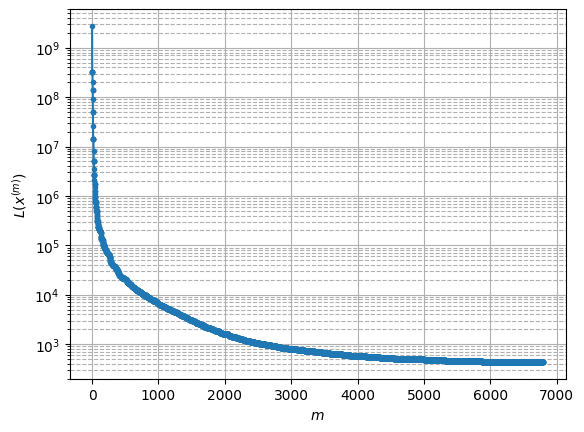

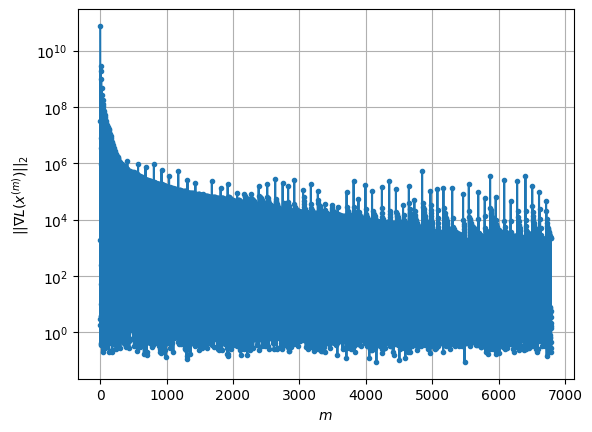

Windows:  20%|██        | 60/296 [3:45:26<13:04:31, 199.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 441.1035564347683
Gradient norm: 274366.3781392899
Global relative error: 4.029421011679169
Position relative errors: 0.020123225064536777 m, 3.011956268858843 m, 1.6701662258243113 m, 2.0915272744825675 m

Iteration 1
Cost function: 440.9076871437321 (-0.04%)
Gradient norm: 4.320693211172602 (-100.00%)
Global relative error = 4.01411705993841 (-0.38%)
Position relative errors: 0.017358336439027712 m, 3.001352947732015 m, 1.6603241344779038 m, 2.0851935565138504 m

Iteration 2
Cost function: 440.9076872178243 (0.00%)
Gradient norm: 2.7035673766347537 (-37.43%)
Global relative error = 4.014117059321255 (-0.00%)
Position relative errors: 0.017358338273028493 m, 3.0013529478917995 m, 1.660324131137078 m, 2.085193557740651 m

Iteration 3
Cost function: 440.9076873348778 (0.00%)
Gradient norm: 1.5939317052947728 (-41.04%)
Global relative error = 4.014117059164067 (-0.00%)
Position relative errors: 0.01735833

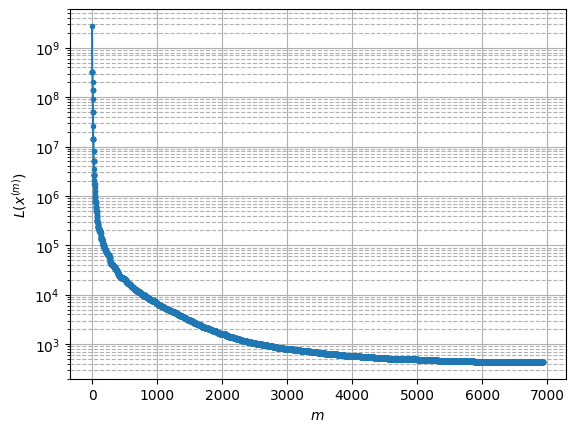

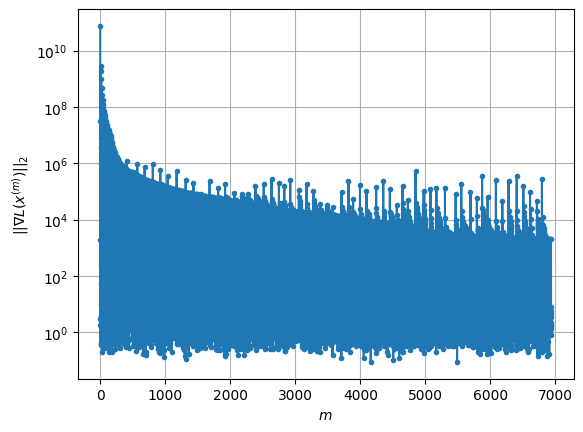

Windows:  21%|██        | 61/296 [3:50:06<14:36:04, 223.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.37677615666814
Gradient norm: 139914.58014027154
Global relative error: 3.6395543915013
Position relative errors: 0.017742740011428462 m, 2.7391224405021783 m, 1.4894156330615242 m, 1.8774674206491084 m

Iteration 1
Cost function: 442.12783219261354 (-0.06%)
Gradient norm: 2.284861398973596 (-100.00%)
Global relative error = 3.6256402051092977 (-0.38%)
Position relative errors: 0.016460801550977715 m, 2.723805488256251 m, 1.4852834910854105 m, 1.8761145629342288 m

Iteration 2
Cost function: 442.12783240619063 (0.00%)
Gradient norm: 6.519529521121791 (185.34%)
Global relative error = 3.625640196984183 (-0.00%)
Position relative errors: 0.01646080333701287 m, 2.723805476233576 m, 1.4852834929254095 m, 1.8761145632147962 m

Iteration 3
Cost function: 442.1278332972745 (0.00%)
Gradient norm: 5.4390517878113025 (-16.57%)
Global relative error = 3.6256401954640376 (-0.00%)
Position relative errors: 0.016

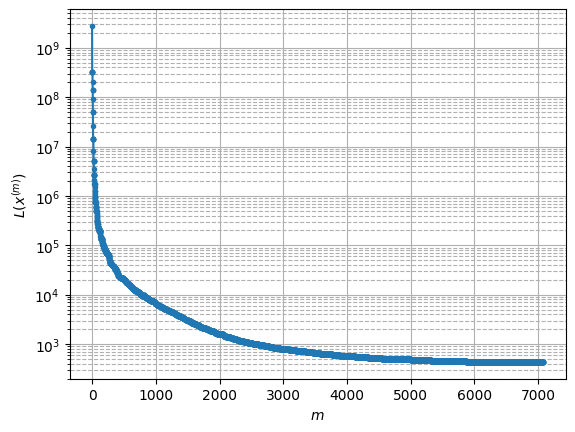

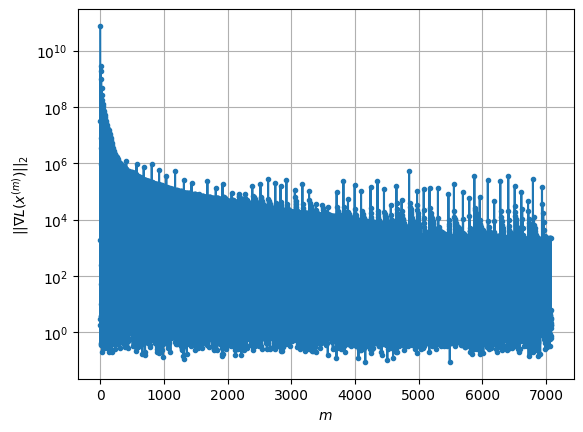

Windows:  21%|██        | 62/296 [3:54:53<15:45:53, 242.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.8285164976892
Gradient norm: 350705.52228680515
Global relative error: 3.2811666013813965
Position relative errors: 0.016733800451109764 m, 2.465139310910216 m, 1.3349112605142492 m, 1.7049538289919768 m

Iteration 1
Cost function: 446.3272696834391 (-0.11%)
Gradient norm: 1.6965720888099856 (-100.00%)
Global relative error = 3.2738402901611194 (-0.22%)
Position relative errors: 0.01954302444509067 m, 2.454669221560664 m, 1.324799231001792 m, 1.7138108348117296 m

STOP on Iteration 2
Cost function = 446.32726910920206 (-0.00%)
Gradient norm = 0.4386366339717143 (-74.15%)
Global relative error = 3.27384029482783 (0.00%)
Final position relative errors: 0.01954302512307439 m, 2.4546692256152345 m, 1.3247992329764011 m, 1.7138108363849567 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 446.1545004623509
Gradient norm: 31401.551146060086
Global relative error: 3.273

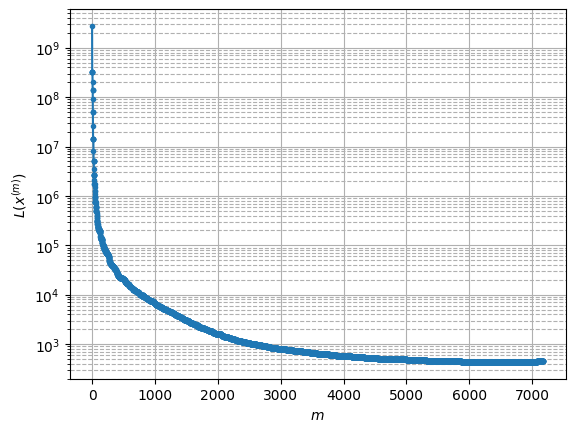

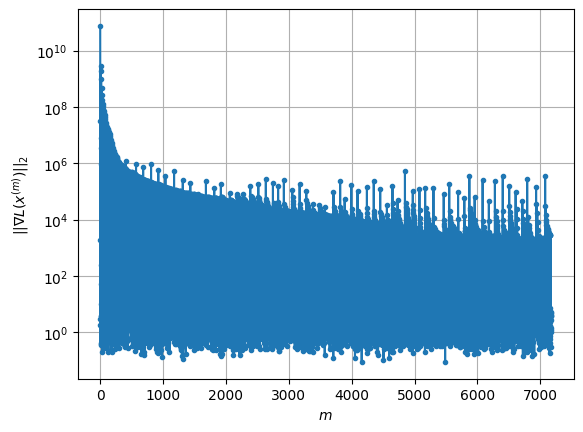

Windows:  21%|██▏       | 63/296 [3:58:06<14:44:48, 227.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 444.04356380872866
Gradient norm: 108414.31396566925
Global relative error: 2.9697799115176116
Position relative errors: 0.019785384011842617 m, 2.2081342166029407 m, 1.1588720314118803 m, 1.6125611545617287 m

STOP on Iteration 1
Cost function = 443.7958383364159 (-0.06%)
Gradient norm = 0.9718476286995273 (-100.00%)
Global relative error = 2.951792660681789 (-0.61%)
Final position relative errors: 0.018646063681348846 m, 2.191932566581502 m, 1.15517313951476 m, 1.6042856100274974 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 443.67514439760924
Gradient norm: 17541.474106615475
Global relative error: 2.951792660681789
Position relative errors: 0.018646063681348846 m, 2.191932566581502 m, 1.15517313951476 m, 1.6042856100274974 m

Iteration 1
Cost function: 443.6021795651238 (-0.02%)
Gradient norm: 2.2353428394495554 (-99.99%)
Global relative error = 2.93911427691

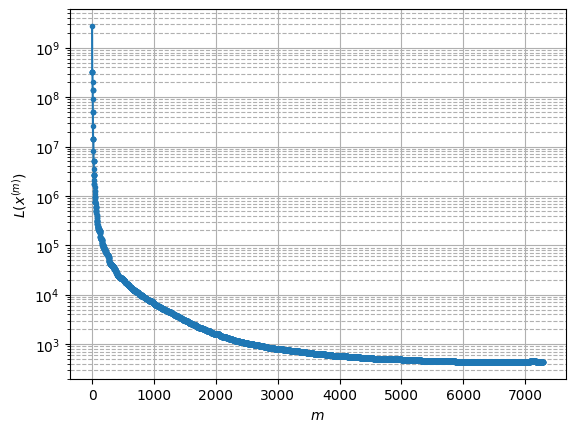

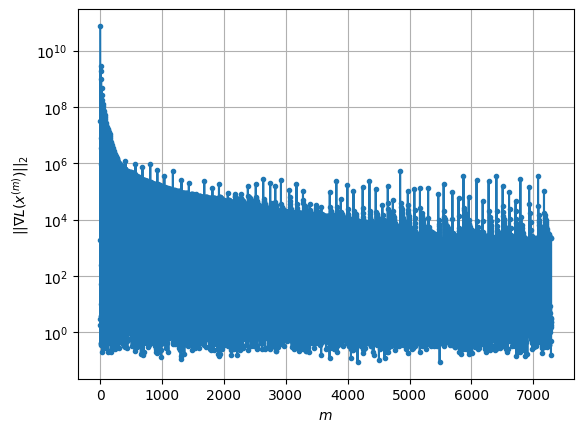

Windows:  22%|██▏       | 64/296 [4:01:57<14:44:12, 228.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 445.7431211825767
Gradient norm: 418161.7345791732
Global relative error: 2.6633454322511168
Position relative errors: 0.018797878372040795 m, 1.9690510091224194 m, 1.020618200385421 m, 1.474525610092167 m

STOP on Iteration 1
Cost function = 445.5294416151667 (-0.05%)
Gradient norm = 0.8198899822246591 (-100.00%)
Global relative error = 2.657902965825716 (-0.20%)
Final position relative errors: 0.019166246125004165 m, 1.9641222310760293 m, 1.0136892313554773 m, 1.4760530193565344 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 445.49596437492465
Gradient norm: 14625.945587860657
Global relative error: 2.657902965825716
Position relative errors: 0.019166246125004165 m, 1.9641222310760293 m, 1.0136892313554773 m, 1.4760530193565344 m

STOP on Iteration 1
Cost function = 445.46801358900336 (-0.01%)
Gradient norm = 0.6031738467273383 (-100.00%)
Global relative error =

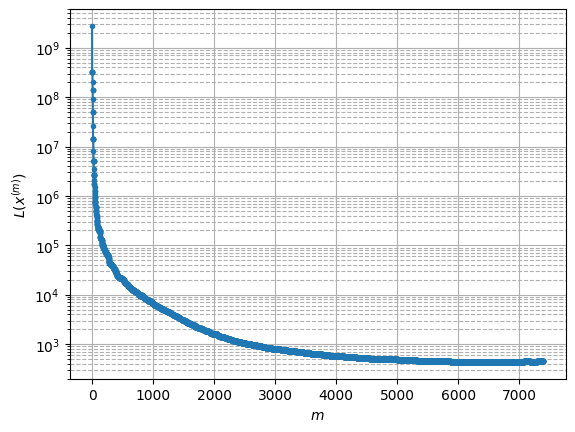

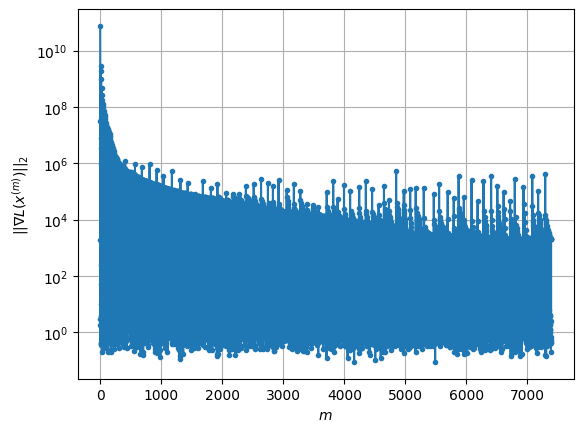

Windows:  22%|██▏       | 65/296 [4:05:32<14:24:34, 224.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.23417197029187
Gradient norm: 207812.49584111688
Global relative error: 2.4141373320318147
Position relative errors: 0.01912586185332156 m, 1.7935575266655237 m, 0.8869510344840631 m, 1.350613332226355 m

Iteration 1
Cost function: 446.0867002909748 (-0.03%)
Gradient norm: 3.335935005035228 (-100.00%)
Global relative error = 2.4027658629000075 (-0.47%)
Position relative errors: 0.018876099279671866 m, 1.7896865233941204 m, 0.8830047355648779 m, 1.338000823475866 m

Iteration 2
Cost function: 446.08669973018306 (-0.00%)
Gradient norm: 2.17966734779016 (-34.66%)
Global relative error = 2.4027658616985277 (-0.00%)
Position relative errors: 0.018876099130225223 m, 1.7896865213030595 m, 0.8830047367126467 m, 1.338000823359879 m

Iteration 3
Cost function: 446.0867005945934 (0.00%)
Gradient norm: 1.3233881794244478 (-39.28%)
Global relative error = 2.4027658629462074 (0.00%)
Position relative errors: 0.01

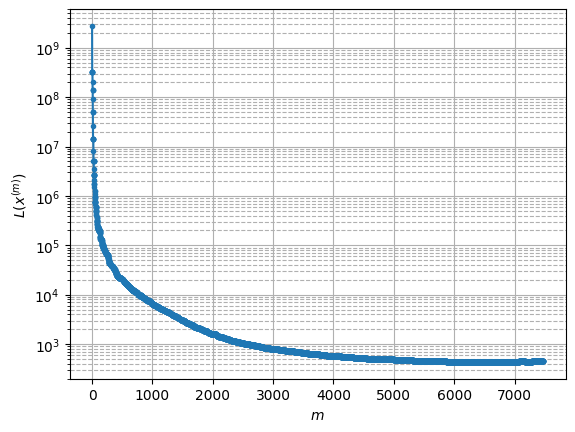

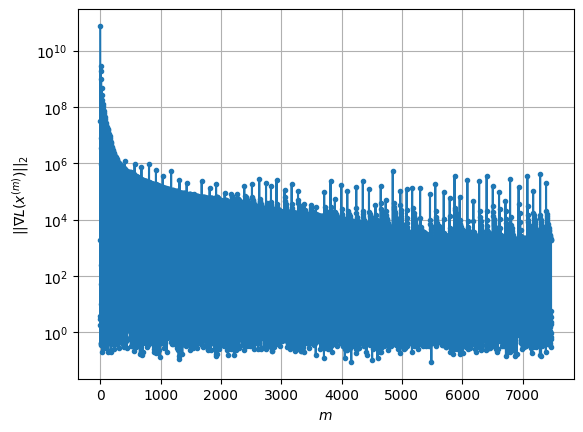

Windows:  22%|██▏       | 66/296 [4:08:39<13:37:33, 213.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 445.6835753133573
Gradient norm: 202055.43991462252
Global relative error: 2.1478646725183967
Position relative errors: 0.01886487712082957 m, 1.62519668606365 m, 0.7894092242914308 m, 1.1612621408509374 m

Iteration 1
Cost function: 445.5784833483583 (-0.02%)
Gradient norm: 4.1223149876631275 (-100.00%)
Global relative error = 2.142863570962269 (-0.23%)
Position relative errors: 0.020423377429284354 m, 1.623143356428415 m, 0.7873985648959805 m, 1.1562225311038987 m

Iteration 2
Cost function: 445.5784831108664 (-0.00%)
Gradient norm: 1.460840576435619 (-64.56%)
Global relative error = 2.142863574394268 (0.00%)
Position relative errors: 0.020423376615183647 m, 1.6231433588870705 m, 0.7873985667049455 m, 1.1562225327954372 m

Iteration 3
Cost function: 445.5784833752601 (0.00%)
Gradient norm: 1.5666168561641443 (7.24%)
Global relative error = 2.1428635740740187 (-0.00%)
Position relative errors: 0.020423

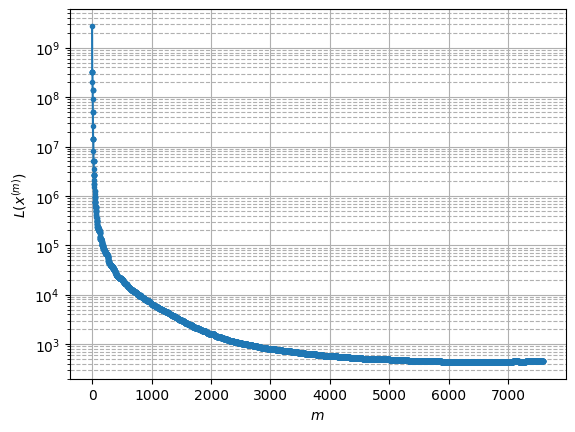

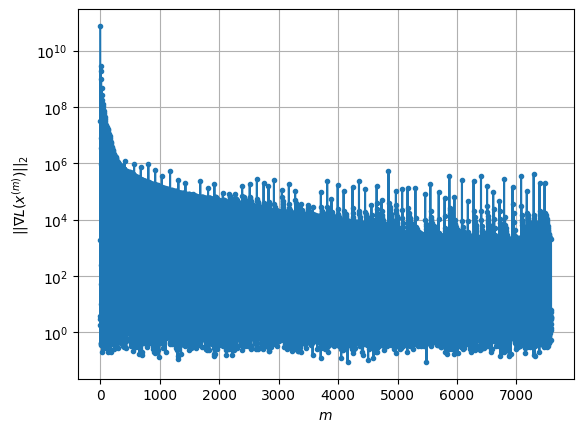

Windows:  23%|██▎       | 67/296 [4:12:27<13:50:30, 217.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.6391195563162
Gradient norm: 260567.44642177247
Global relative error: 1.9238932577199541
Position relative errors: 0.020411212655872816 m, 1.465928943627269 m, 0.728873164372814 m, 1.010316419917455 m

Iteration 1
Cost function: 446.3990837603551 (-0.05%)
Gradient norm: 1.0790112685614146 (-100.00%)
Global relative error = 1.9183798681812345 (-0.29%)
Position relative errors: 0.020274376755206002 m, 1.4614743984769156 m, 0.7241610003040995 m, 1.0096772359615178 m

Iteration 2
Cost function: 446.39908377606724 (0.00%)
Gradient norm: 2.7455688095570197 (154.45%)
Global relative error = 1.918379869819877 (0.00%)
Position relative errors: 0.02027437377200832 m, 1.4614744010827205 m, 0.7241610022200597 m, 1.0096772339888418 m

Iteration 3
Cost function: 446.3990838368529 (0.00%)
Gradient norm: 5.1997131047567375 (89.39%)
Global relative error = 1.9183798706749295 (0.00%)
Position relative errors: 0.0202

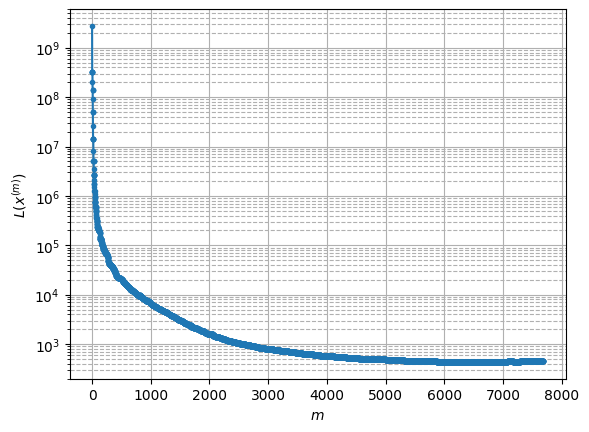

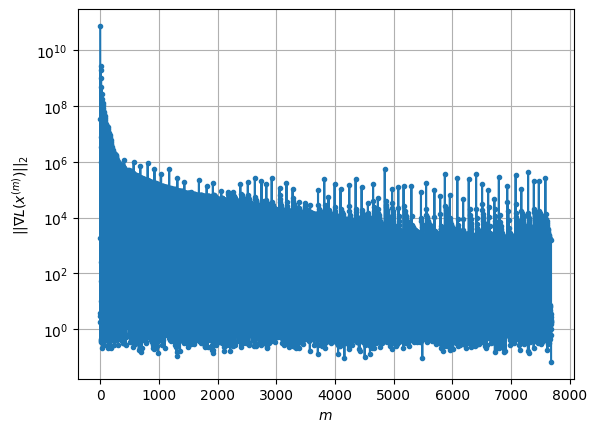

Windows:  23%|██▎       | 68/296 [4:15:47<13:26:48, 212.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.10440311964226
Gradient norm: 83997.2436810146
Global relative error: 1.7150904840461632
Position relative errors: 0.01948291204776768 m, 1.3220458288496424 m, 0.6755573324345384 m, 0.8584681689844427 m

Iteration 1
Cost function: 448.9996676072099 (-0.02%)
Gradient norm: 4.516474730006126 (-99.99%)
Global relative error = 1.70893949532466 (-0.36%)
Position relative errors: 0.01940367941451916 m, 1.3173728384248247 m, 0.6769000356512666 m, 0.8523072097092663 m

STOP on Iteration 2
Cost function = 448.9996673506413 (-0.00%)
Gradient norm = 0.9156106629610538 (-79.73%)
Global relative error = 1.7089394958837758 (0.00%)
Final position relative errors: 0.0194036826634719 m, 1.3173728397777427 m, 0.6769000356686055 m, 0.8523072086514558 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 448.9557518870298
Gradient norm: 13458.466311888173
Global relative error: 1.708939

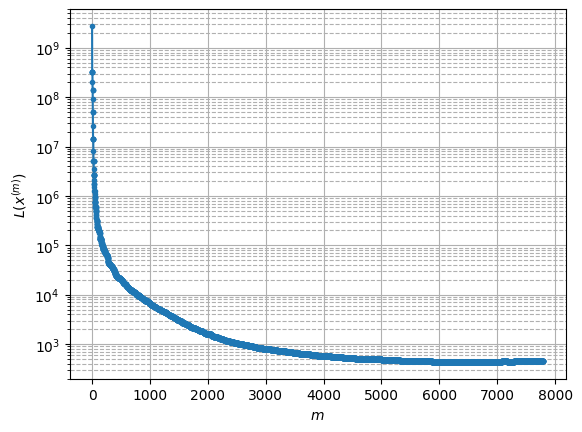

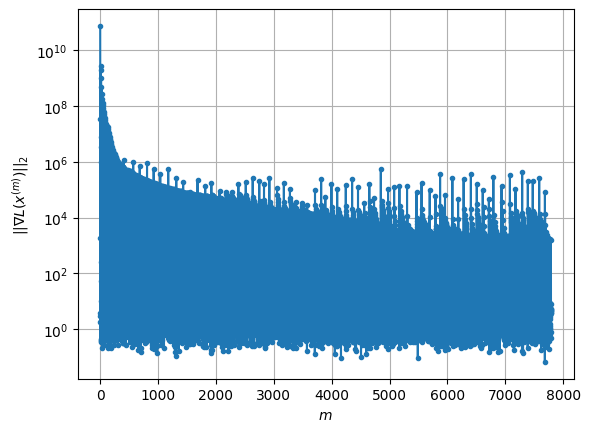

Windows:  23%|██▎       | 69/296 [4:19:31<13:36:26, 215.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 439.30790103172245
Gradient norm: 52360.79529616121
Global relative error: 1.4953259144344067
Position relative errors: 0.018826609224416813 m, 1.1489324232261866 m, 0.65135087919128 m, 0.7009539236326662 m

Iteration 1
Cost function: 438.98422811824685 (-0.07%)
Gradient norm: 3.3653604052360944 (-99.99%)
Global relative error = 1.4868119768089236 (-0.57%)
Position relative errors: 0.023954044162817448 m, 1.140036710983472 m, 0.6484262243250145 m, 0.6999219777999716 m

Iteration 2
Cost function: 438.9842276748038 (-0.00%)
Gradient norm: 3.230330292928312 (-4.01%)
Global relative error = 1.486811978472908 (0.00%)
Position relative errors: 0.02395404538960832 m, 1.1400367117563635 m, 0.6484262258965912 m, 0.6999219785778599 m

Iteration 3
Cost function: 438.98422833791057 (0.00%)
Gradient norm: 3.836821115254174 (18.77%)
Global relative error = 1.4868119774184425 (-0.00%)
Position relative errors: 0.02395

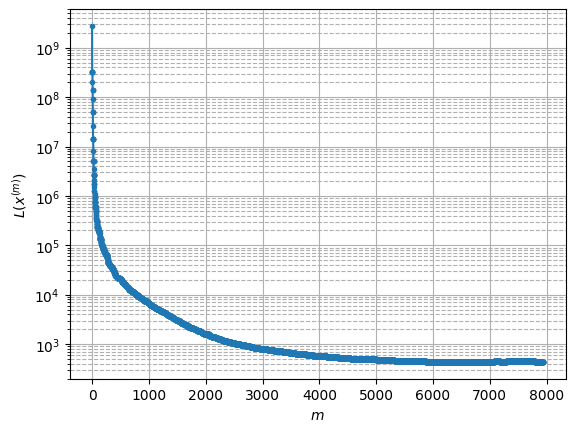

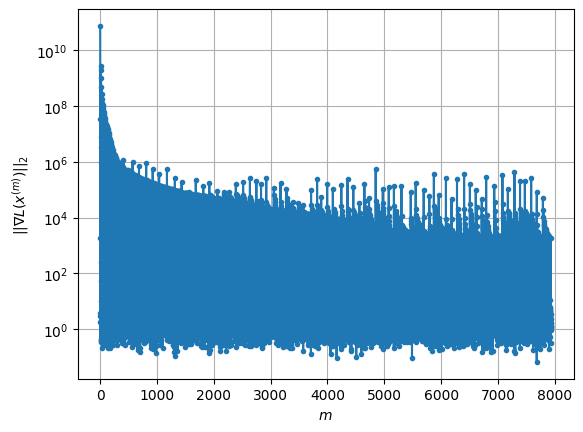

Windows:  24%|██▎       | 70/296 [4:24:26<15:03:12, 239.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 433.6026889624918
Gradient norm: 191545.0734349726
Global relative error: 1.2873559770563914
Position relative errors: 0.024052420932430044 m, 1.0071244473643524 m, 0.5337610449259851 m, 0.5979143068464203 m

Iteration 1
Cost function: 433.2170397493569 (-0.09%)
Gradient norm: 4.571962478759629 (-100.00%)
Global relative error = 1.2926808409893529 (0.41%)
Position relative errors: 0.026089485881092434 m, 1.004948382006816 m, 0.5452230684634458 m, 0.6026182789524861 m

Iteration 2
Cost function: 433.21703988264164 (0.00%)
Gradient norm: 2.5296204988100883 (-44.67%)
Global relative error = 1.2926808490750823 (0.00%)
Position relative errors: 0.026089484437873955 m, 1.0049483829932795 m, 0.5452230849286162 m, 0.6026182798176766 m

Iteration 3
Cost function: 433.2170395252086 (-0.00%)
Gradient norm: 1.1042531481638762 (-56.35%)
Global relative error = 1.2926808477543186 (-0.00%)
Position relative errors: 0.

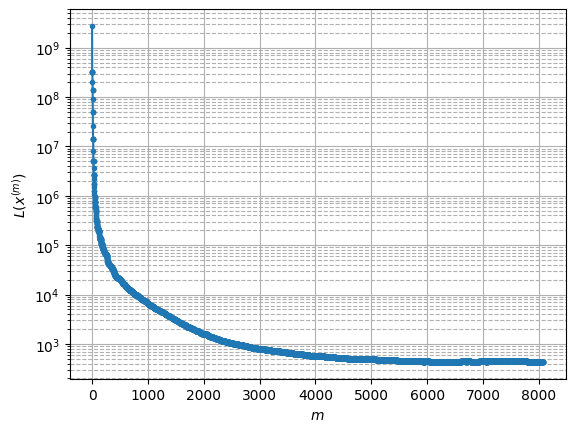

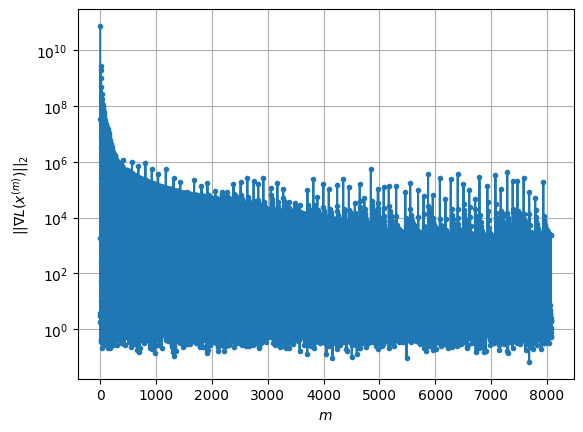

Windows:  24%|██▍       | 71/296 [4:29:18<15:57:49, 255.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 434.5024906036914
Gradient norm: 108114.07309077607
Global relative error: 1.1676779598694997
Position relative errors: 0.025742074229681642 m, 0.8920898252439886 m, 0.5240348678895812 m, 0.540710017354628 m

Iteration 1
Cost function: 434.35469302881694 (-0.03%)
Gradient norm: 3.1262946273242043 (-100.00%)
Global relative error = 1.1578413112366854 (-0.84%)
Position relative errors: 0.027209114253908026 m, 0.8925929057372709 m, 0.5031715850157918 m, 0.5384676541316767 m

Iteration 2
Cost function: 434.3546925619737 (-0.00%)
Gradient norm: 1.4278885822626115 (-54.33%)
Global relative error = 1.1578413158669765 (0.00%)
Position relative errors: 0.02720911924686479 m, 0.8925929057913505 m, 0.5031715940958089 m, 0.5384676552611865 m

Iteration 3
Cost function: 434.35469296065884 (0.00%)
Gradient norm: 1.5604044398534003 (9.28%)
Global relative error = 1.1578413169922714 (0.00%)
Position relative errors: 0.

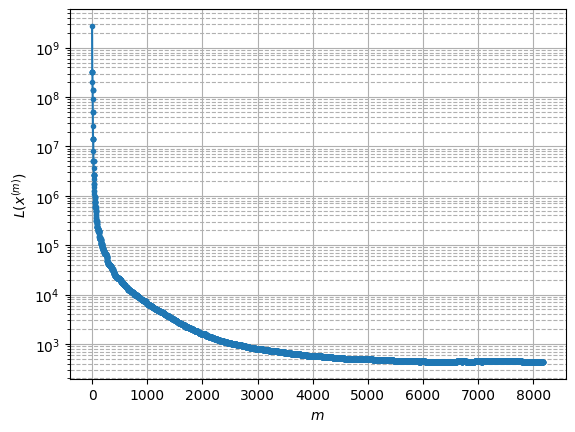

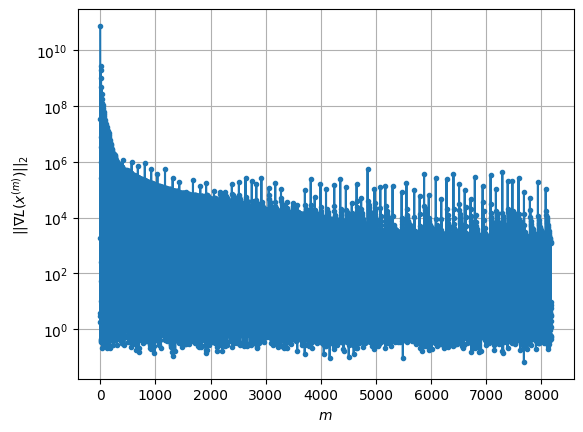

Windows:  24%|██▍       | 72/296 [4:32:29<14:41:21, 236.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.0776168855339
Gradient norm: 366401.12817661447
Global relative error: 1.0375931401415401
Position relative errors: 0.02620731772227735 m, 0.8136452681389597 m, 0.46660081181825414 m, 0.44291397948924915 m

Iteration 1
Cost function: 429.8066703949477 (-0.06%)
Gradient norm: 1.3308951632438584 (-100.00%)
Global relative error = 1.0314048106044689 (-0.60%)
Position relative errors: 0.024512590444953304 m, 0.815329370404413 m, 0.4553670145637378 m, 0.43711437541275244 m

STOP on Iteration 2
Cost function = 429.80667066628376 (0.00%)
Gradient norm = 0.1880071075336907 (-85.87%)
Global relative error = 1.0314048098446562 (-0.00%)
Final position relative errors: 0.024512595743413648 m, 0.8153293698938895 m, 0.455367013877666 m, 0.43711437498977196 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 429.7657226767231
Gradient norm: 9054.215082597719
Global relative error

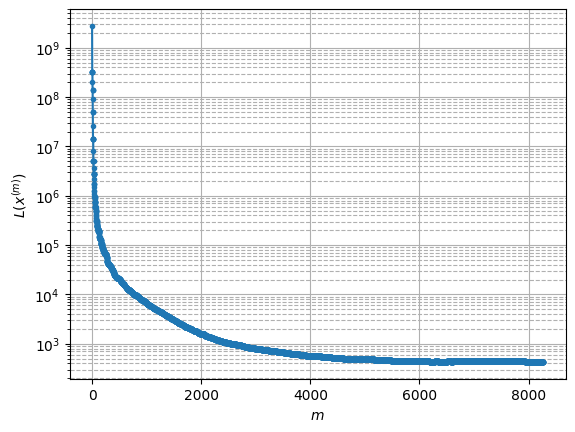

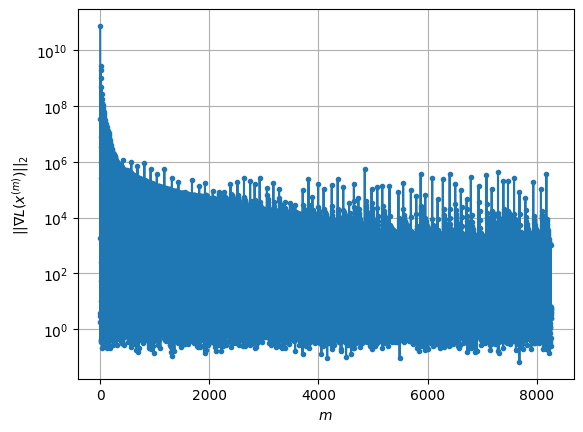

Windows:  25%|██▍       | 73/296 [4:35:19<13:23:39, 216.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 426.62360409700256
Gradient norm: 23384.711896852583
Global relative error: 0.9256578963785261
Position relative errors: 0.023245600581084477 m, 0.7399523957039543 m, 0.4466150997069901 m, 0.3306097823176531 m

STOP on Iteration 1
Cost function = 426.46055032490113 (-0.04%)
Gradient norm = 0.8867788542428331 (-100.00%)
Global relative error = 0.9335125128640979 (0.85%)
Final position relative errors: 0.026822327277437212 m, 0.7380703117301367 m, 0.46490002568979094 m, 0.33142360476528543 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 426.37985622221896
Gradient norm: 12621.964517389919
Global relative error: 0.9335125128640979
Position relative errors: 0.026822327277437212 m, 0.7380703117301367 m, 0.46490002568979094 m, 0.33142360476528543 m

STOP on Iteration 1
Cost function = 426.33280741590977 (-0.01%)
Gradient norm = 0.7820357954231328 (-99.99%)
Global relativ

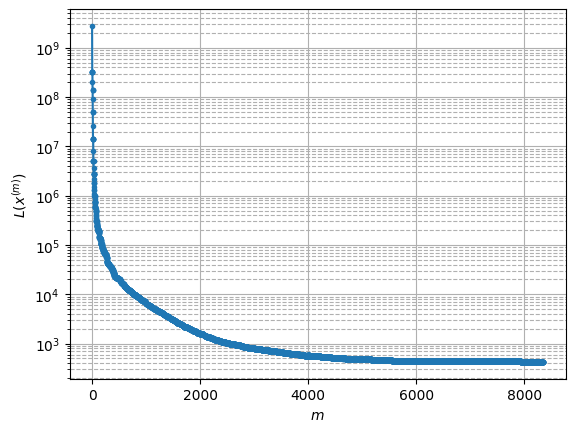

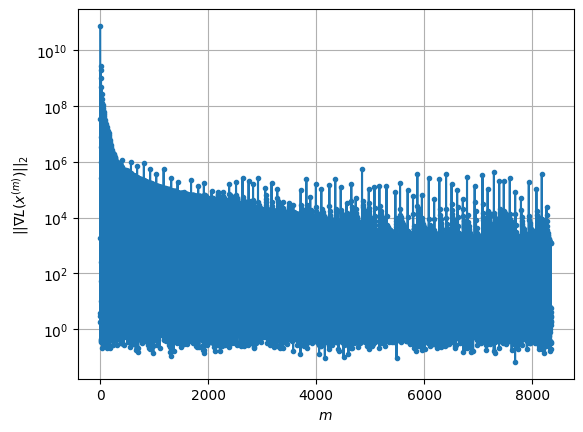

Windows:  25%|██▌       | 74/296 [4:38:05<12:24:01, 201.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 423.90160775924005
Gradient norm: 38744.82276494569
Global relative error: 0.8500869144253707
Position relative errors: 0.026632950188539894 m, 0.6342693781326368 m, 0.4919108282487352 m, 0.278675053494729 m

STOP on Iteration 1
Cost function = 423.74774409610984 (-0.04%)
Gradient norm = 0.539491186936473 (-100.00%)
Global relative error = 0.8458890571241762 (-0.49%)
Final position relative errors: 0.03397775918516493 m, 0.6398909201204545 m, 0.4800474030132161 m, 0.2728794176931438 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 423.7057303885391
Gradient norm: 14364.799451302337
Global relative error: 0.8458890571241762
Position relative errors: 0.03397775918516493 m, 0.6398909201204545 m, 0.4800474030132161 m, 0.2728794176931438 m

Iteration 1
Cost function: 423.68267575717596 (-0.01%)
Gradient norm: 2.829987964198414 (-99.98%)
Global relative error = 0.84443690

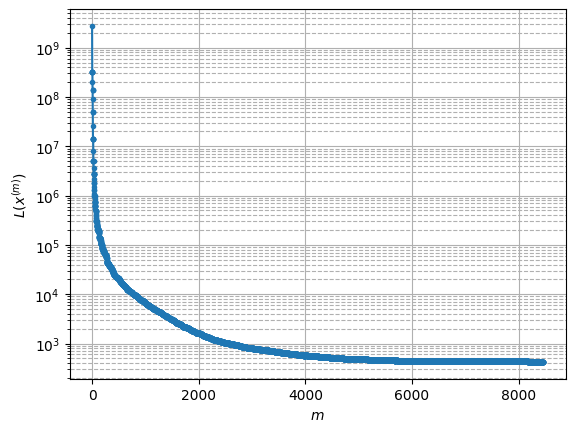

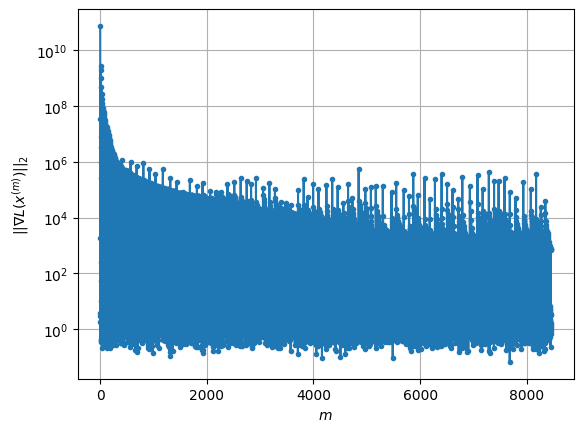

Windows:  25%|██▌       | 75/296 [4:41:41<12:36:53, 205.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 422.74783846784715
Gradient norm: 48110.55051296071
Global relative error: 0.7735193606848463
Position relative errors: 0.033444880127069934 m, 0.5953714765261581 m, 0.447175410561571 m, 0.2068235453150695 m

Iteration 1
Cost function: 422.58398362223994 (-0.04%)
Gradient norm: 5.906290800833866 (-99.99%)
Global relative error = 0.7761994373795149 (0.35%)
Position relative errors: 0.02296564326416596 m, 0.599361839149767 m, 0.44766124319588324 m, 0.20571421564071424 m

Iteration 2
Cost function: 422.58398380373006 (0.00%)
Gradient norm: 4.806551246658732 (-18.62%)
Global relative error = 0.7761994385455856 (0.00%)
Position relative errors: 0.022965642725811693 m, 0.5993618397327587 m, 0.4476612447562886 m, 0.20571421500637388 m

Iteration 3
Cost function: 422.5839839356017 (0.00%)
Gradient norm: 3.104687367664932 (-35.41%)
Global relative error = 0.776199434062365 (-0.00%)
Position relative errors: 0.02

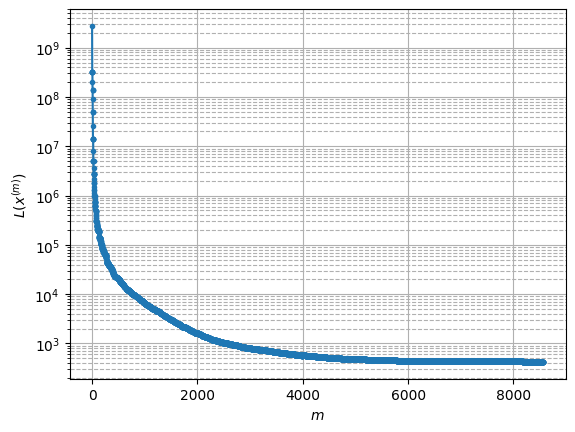

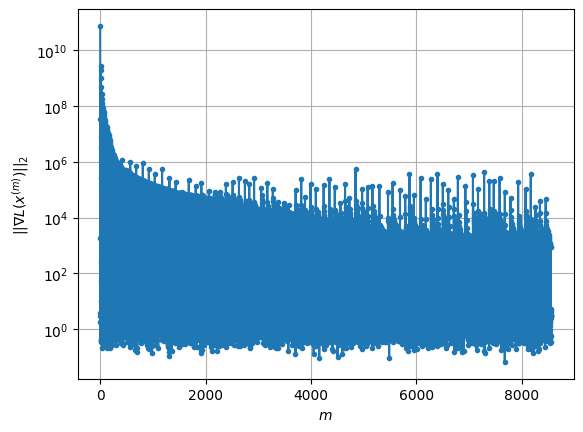

Windows:  26%|██▌       | 76/296 [4:45:07<12:34:02, 205.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 426.7049157915191
Gradient norm: 108828.57878139536
Global relative error: 0.7337004389053734
Position relative errors: 0.02208475171545159 m, 0.538445700459013 m, 0.47318520061529573 m, 0.15490684137578656 m

Iteration 1
Cost function: 426.3929691859217 (-0.07%)
Gradient norm: 2.6128320805784893 (-100.00%)
Global relative error = 0.7328773316202977 (-0.11%)
Position relative errors: 0.027605308620145742 m, 0.5253024349980774 m, 0.4843978236878685 m, 0.16049542599580588 m

STOP on Iteration 2
Cost function = 426.39296933537435 (0.00%)
Gradient norm = 0.9289149735148214 (-64.45%)
Global relative error = 0.7328773283241921 (-0.00%)
Final position relative errors: 0.02760531004740257 m, 0.5253024289822288 m, 0.4843978245080591 m, 0.16049542791364227 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 426.244465094936
Gradient norm: 35278.05315241377
Global relative error:

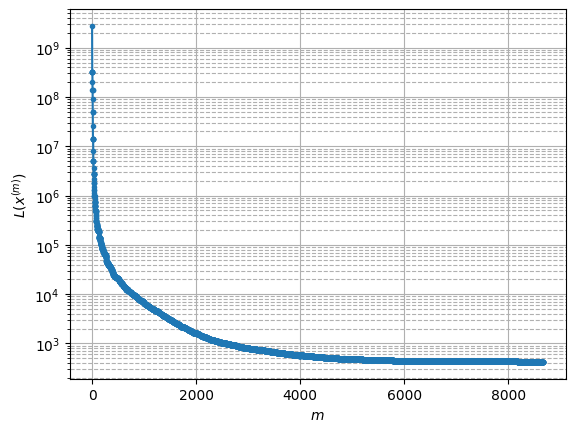

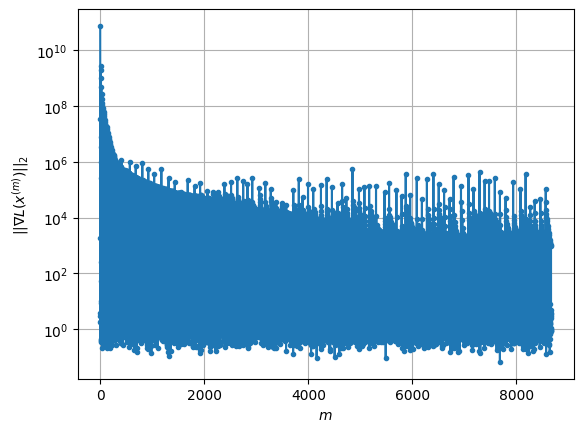

Windows:  26%|██▌       | 77/296 [4:48:34<12:32:13, 206.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.370460185007
Gradient norm: 78197.01340251269
Global relative error: 0.7410860863804472
Position relative errors: 0.02487333104969637 m, 0.4416599447889209 m, 0.5870084832985426 m, 0.09456741216044319 m

STOP on Iteration 1
Cost function = 424.28782697692475 (-0.02%)
Gradient norm = 0.5786603304231819 (-100.00%)
Global relative error = 0.7548585795509068 (1.86%)
Final position relative errors: 0.026798325057934114 m, 0.4461306162122299 m, 0.6009649282978153 m, 0.09432658015113587 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 424.25387697406074
Gradient norm: 13461.637296823934
Global relative error: 0.7548585795509068
Position relative errors: 0.026798325057934114 m, 0.4461306162122299 m, 0.6009649282978153 m, 0.09432658015113587 m

STOP on Iteration 1
Cost function = 424.23382400341933 (-0.00%)
Gradient norm = 0.7922964734038609 (-99.99%)
Global relative err

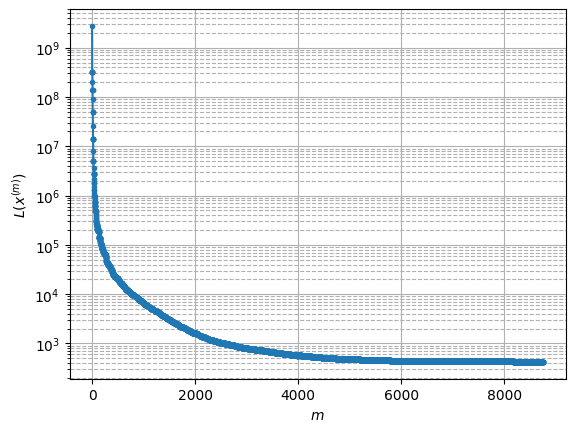

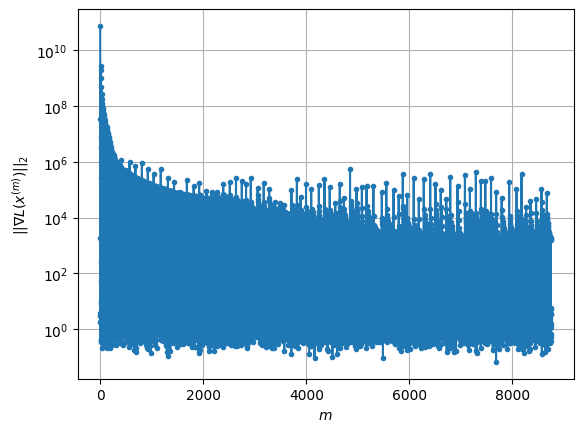

Windows:  26%|██▋       | 78/296 [4:51:22<11:47:24, 194.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 422.24231914964145
Gradient norm: 61160.61319291128
Global relative error: 0.7876103315900687
Position relative errors: 0.02555955921133532 m, 0.41892387462901187 m, 0.664551347545869 m, 0.0504634210842904 m

Iteration 1
Cost function: 422.1255703930238 (-0.03%)
Gradient norm: 3.4896517536765 (-99.99%)
Global relative error = 0.7957825952917821 (1.04%)
Position relative errors: 0.019591747028796444 m, 0.4269689709691426 m, 0.6696385081334952 m, 0.04651216876375918 m

Iteration 2
Cost function: 422.1255705468279 (0.00%)
Gradient norm: 3.3125050104213445 (-5.08%)
Global relative error = 0.7957825960227142 (0.00%)
Position relative errors: 0.019591745369755557 m, 0.42696896904984694 m, 0.6696385102232107 m, 0.04651216950101539 m

STOP on Iteration 3
Cost function = 422.1255704631753 (-0.00%)
Gradient norm = 0.29934049577866384 (-90.96%)
Global relative error = 0.7957825934349408 (-0.00%)
Final position rel

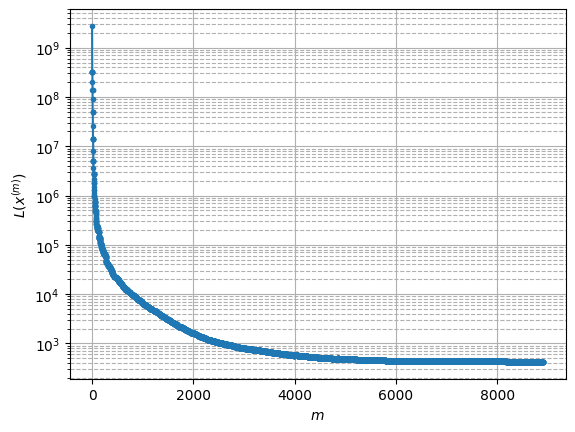

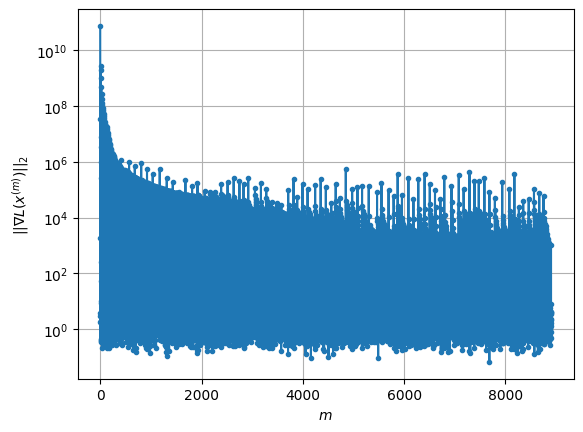

Windows:  27%|██▋       | 79/296 [4:56:17<13:33:01, 224.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 421.97277866807383
Gradient norm: 37152.444110396136
Global relative error: 0.8845731864820825
Position relative errors: 0.016902398030904004 m, 0.4331468725959449 m, 0.764729001035892 m, 0.09875632076364588 m

STOP on Iteration 1
Cost function = 421.84560590082924 (-0.03%)
Gradient norm = 0.9065036274795581 (-100.00%)
Global relative error = 0.8856473165363121 (0.12%)
Final position relative errors: 0.011493693605136657 m, 0.43223814931030446 m, 0.7618361685448859 m, 0.1304237192962401 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 421.81139828855316
Gradient norm: 19637.972271919647
Global relative error: 0.8856473165363121
Position relative errors: 0.011493693605136657 m, 0.43223814931030446 m, 0.7618361685448859 m, 0.1304237192962401 m

Iteration 1
Cost function: 421.7903312592487 (-0.00%)
Gradient norm: 2.1868670054522563 (-99.99%)
Global relative error = 0.8

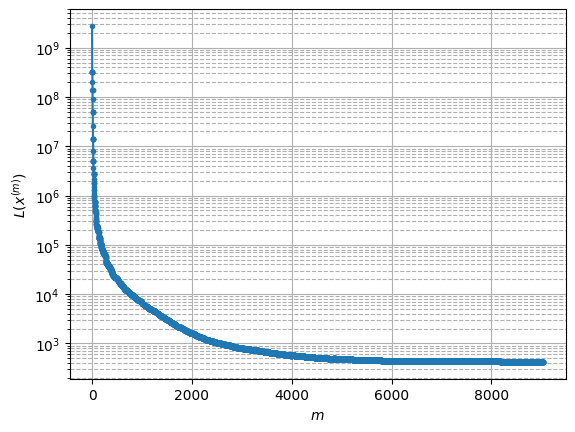

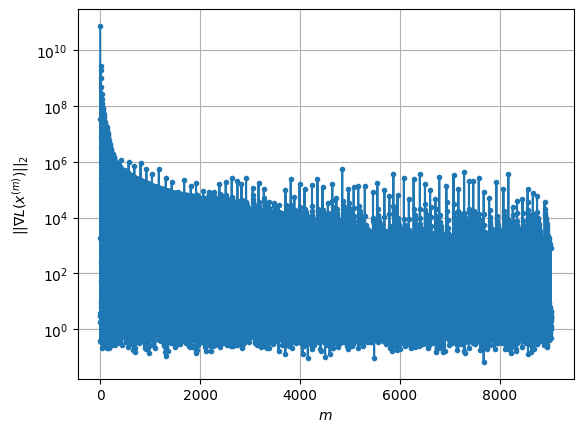

Windows:  27%|██▋       | 80/296 [5:00:37<14:07:45, 235.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 421.6376465548844
Gradient norm: 70085.13900822403
Global relative error: 0.9281010207517553
Position relative errors: 0.009914279810409706 m, 0.403440002606638 m, 0.809558162793751 m, 0.20765476815654885 m

Iteration 1
Cost function: 421.52401357960434 (-0.03%)
Gradient norm: 2.1360613448989176 (-100.00%)
Global relative error = 0.9190768700569283 (-0.97%)
Position relative errors: 0.011287088406514378 m, 0.41099684878216175 m, 0.803260992073159 m, 0.1744242922809359 m

Iteration 2
Cost function: 421.5240137540491 (0.00%)
Gradient norm: 3.622011072113087 (69.56%)
Global relative error = 0.9190768727701577 (0.00%)
Position relative errors: 0.01128708842314333 m, 0.4109968504608718 m, 0.8032609948761371 m, 0.1744242897125248 m

Iteration 3
Cost function: 421.5240137536631 (-0.00%)
Gradient norm: 5.256186160548712 (45.12%)
Global relative error = 0.9190768763230606 (0.00%)
Position relative errors: 0.0112

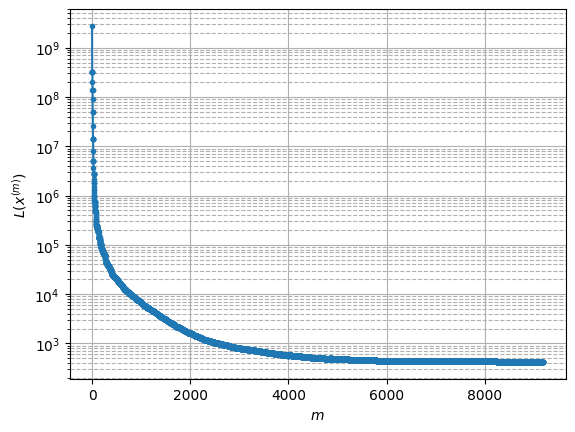

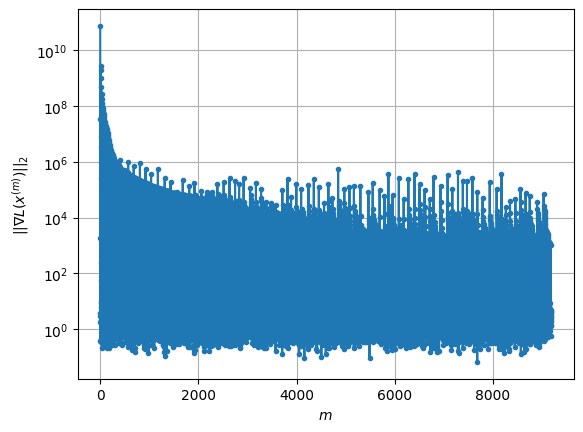

Windows:  27%|██▋       | 81/296 [5:05:41<15:17:02, 255.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.50248850499077
Gradient norm: 97515.60222563626
Global relative error: 0.8524295328557104
Position relative errors: 0.011388046409923218 m, 0.3156857112820419 m, 0.774442108094983 m, 0.164572755356976 m

Iteration 1
Cost function: 424.19514568052347 (-0.07%)
Gradient norm: 2.029311225360413 (-100.00%)
Global relative error = 0.8412656486067605 (-1.31%)
Position relative errors: 0.0062626063036136225 m, 0.32030520849491684 m, 0.7614262670058948 m, 0.15911983463544346 m

STOP on Iteration 2
Cost function = 424.1951455717193 (-0.00%)
Gradient norm = 0.5338709247957233 (-73.69%)
Global relative error = 0.8412656443908353 (-0.00%)
Final position relative errors: 0.006262606054141773 m, 0.32030521226708303 m, 0.7614262617718801 m, 0.15911982980841394 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 424.10308446280976
Gradient norm: 27724.078075761616
Global relative e

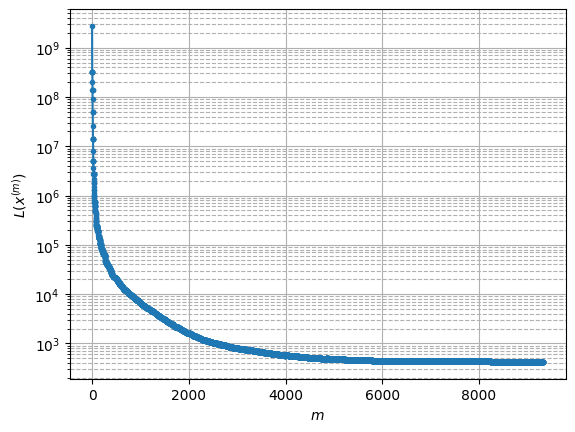

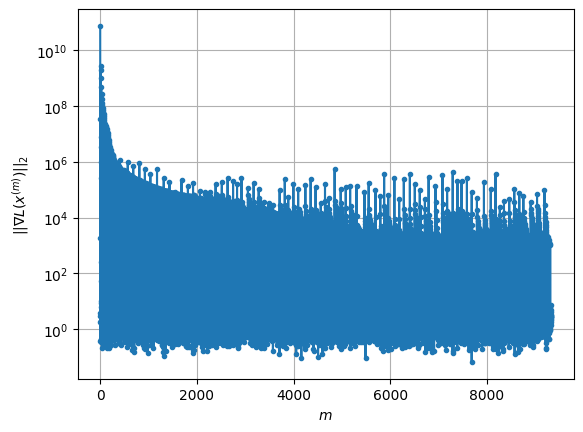

Windows:  28%|██▊       | 82/296 [5:10:09<15:25:22, 259.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 423.3383510710446
Gradient norm: 126687.72761185466
Global relative error: 0.7906764147583424
Position relative errors: 0.006215770683892503 m, 0.22091858792004374 m, 0.7367268928238522 m, 0.18318070799984637 m

Iteration 1
Cost function: 423.198282077296 (-0.03%)
Gradient norm: 1.8934712047684552 (-100.00%)
Global relative error = 0.7734245236730879 (-2.18%)
Position relative errors: 0.006554538256439409 m, 0.1946319915501577 m, 0.7251738152246349 m, 0.18541857663233838 m

Iteration 2
Cost function: 423.1982820867479 (0.00%)
Gradient norm: 3.4431861269653026 (81.85%)
Global relative error = 0.7734245173511105 (-0.00%)
Position relative errors: 0.00655453836749067 m, 0.1946319975505623 m, 0.7251738073237415 m, 0.1854185748598885 m

Iteration 3
Cost function: 423.19828154104454 (-0.00%)
Gradient norm: 4.970069440009464 (44.35%)
Global relative error = 0.773424518640658 (0.00%)
Position relative errors: 0

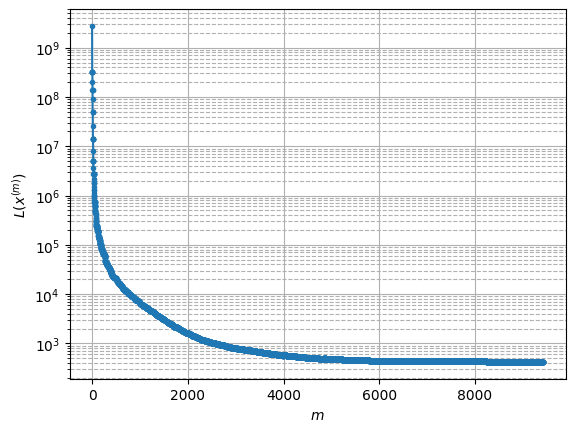

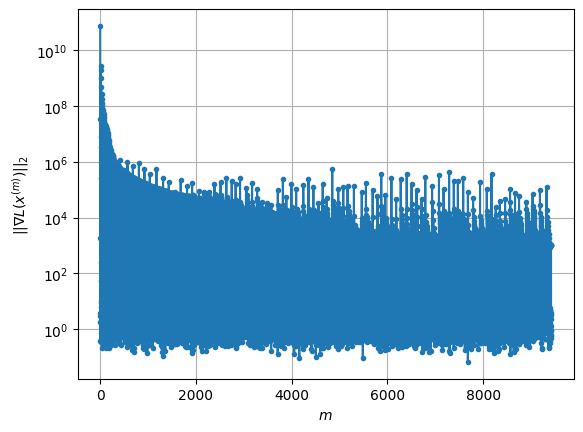

Windows:  28%|██▊       | 83/296 [5:13:09<13:56:42, 235.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.8561669587174
Gradient norm: 197467.8751573326
Global relative error: 0.7311406869161771
Position relative errors: 0.0060447600776404615 m, 0.03289371249295759 m, 0.6986031977280555 m, 0.21306868107646162 m

STOP on Iteration 1
Cost function = 428.6422726657316 (-0.05%)
Gradient norm = 0.9218191529686228 (-100.00%)
Global relative error = 0.7279260604629212 (-0.44%)
Final position relative errors: 0.004998135763657172 m, 0.026754282703287245 m, 0.6945665148108944 m, 0.2161237253556363 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 428.575241125755
Gradient norm: 22022.28647442294
Global relative error: 0.7279260604629212
Position relative errors: 0.004998135763657172 m, 0.026754282703287245 m, 0.6945665148108944 m, 0.2161237253556363 m

Iteration 1
Cost function: 428.5415876689403 (-0.01%)
Gradient norm: 1.721604363657408 (-99.99%)
Global relative error = 0.72

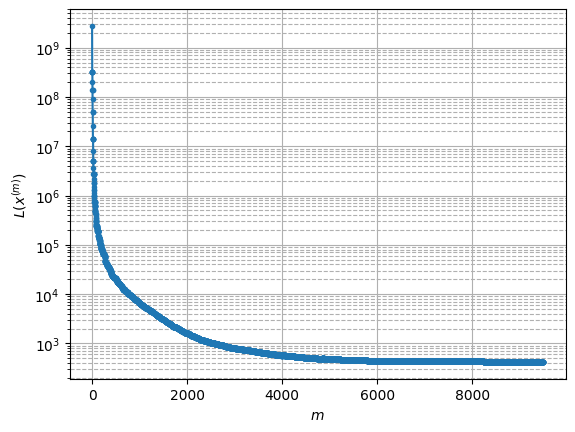

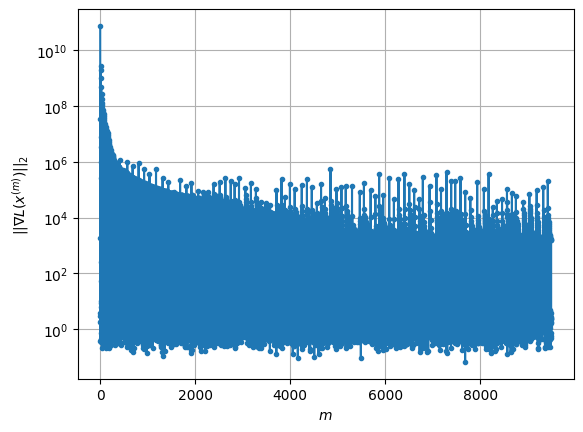

Windows:  28%|██▊       | 84/296 [5:15:22<12:04:16, 204.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 427.90188727759744
Gradient norm: 98014.72101727656
Global relative error: 0.7463744207189309
Position relative errors: 0.004552649849683601 m, 0.08150857041700652 m, 0.6732296343006099 m, 0.31171954678213043 m

Iteration 1
Cost function: 427.7633414386694 (-0.03%)
Gradient norm: 5.26926946785341 (-99.99%)
Global relative error = 0.7476190750721251 (0.17%)
Position relative errors: 0.006517934364687222 m, 0.11005538306914629 m, 0.670072973405424 m, 0.31269575909810493 m

Iteration 2
Cost function: 427.76334172149154 (0.00%)
Gradient norm: 1.4955251570733197 (-71.62%)
Global relative error = 0.7476190738023547 (-0.00%)
Position relative errors: 0.006517920096538111 m, 0.11005538279629752 m, 0.6700729733645923 m, 0.3126957565431736 m

Iteration 3
Cost function: 427.7633412845317 (-0.00%)
Gradient norm: 3.069774546573035 (105.26%)
Global relative error = 0.7476190745243175 (0.00%)
Position relative errors:

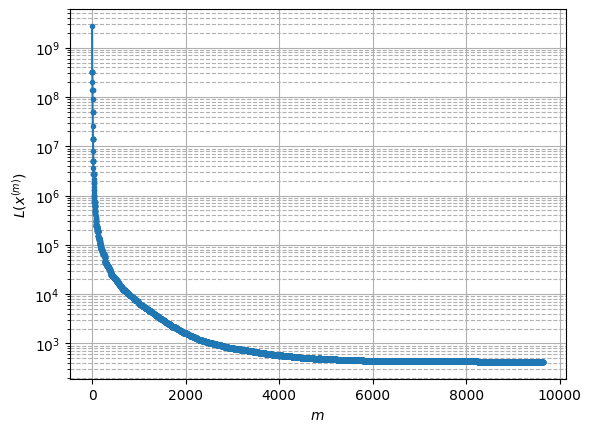

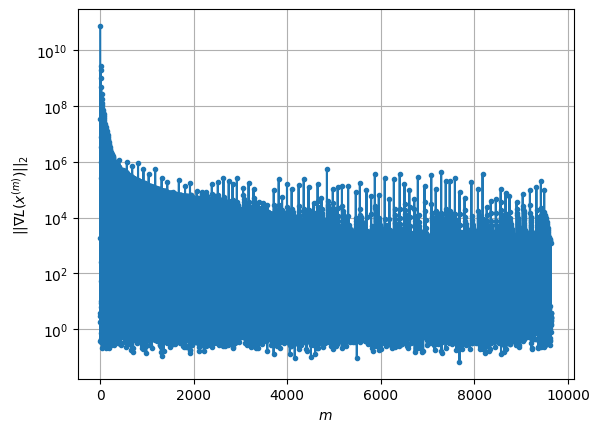

Windows:  29%|██▊       | 85/296 [5:19:54<13:11:28, 225.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 425.07955051747666
Gradient norm: 370892.55622412905
Global relative error: 0.7955539903842952
Position relative errors: 0.005636870686988983 m, 0.2203422222440347 m, 0.662785434187792 m, 0.3808362414506355 m

STOP on Iteration 1
Cost function = 424.66364490842227 (-0.10%)
Gradient norm = 0.5025903474518353 (-100.00%)
Global relative error = 0.8085930763801334 (1.64%)
Final position relative errors: 0.007534447360483194 m, 0.19776615414631396 m, 0.6635362175444877 m, 0.41757792063813715 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 424.5224958438963
Gradient norm: 13560.830070562117
Global relative error: 0.8085930763801334
Position relative errors: 0.007534447360483194 m, 0.19776615414631396 m, 0.6635362175444877 m, 0.41757792063813715 m

STOP on Iteration 1
Cost function = 424.4543060052622 (-0.02%)
Gradient norm = 0.7535027761158944 (-99.99%)
Global relative e

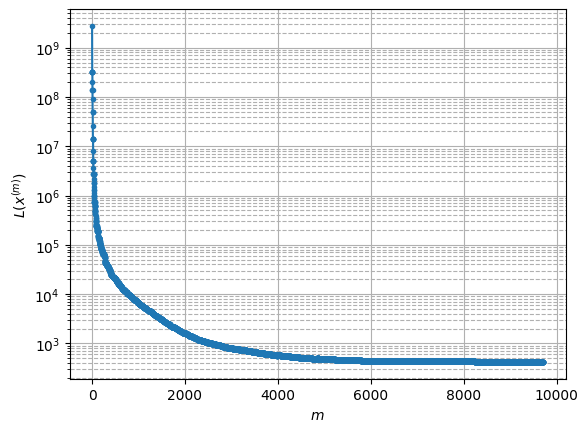

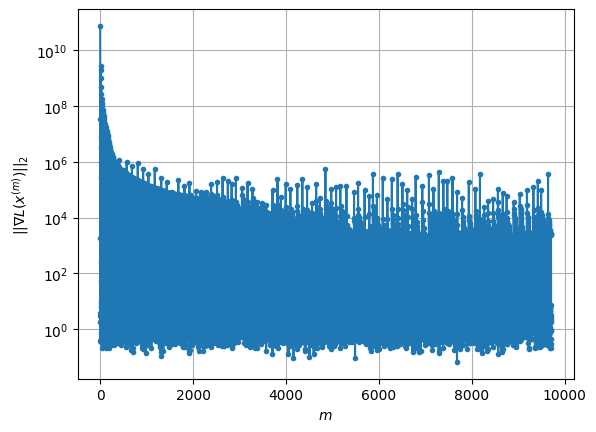

Windows:  29%|██▉       | 86/296 [5:22:02<11:26:11, 196.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.3656794452324
Gradient norm: 91630.72553628574
Global relative error: 0.9143495641647826
Position relative errors: 0.007309212786891989 m, 0.25551802286376224 m, 0.6841031162456119 m, 0.5501750385754646 m

Iteration 1
Cost function: 424.2305102968586 (-0.03%)
Gradient norm: 2.462960085198269 (-100.00%)
Global relative error = 0.9125915374382632 (-0.19%)
Position relative errors: 0.006386053027773881 m, 0.25025302704208063 m, 0.6815702583827717 m, 0.5528248996570646 m

Iteration 2
Cost function: 424.23051018035864 (-0.00%)
Gradient norm: 2.5448172663758024 (3.32%)
Global relative error = 0.912591535411453 (-0.00%)
Position relative errors: 0.006386054154026501 m, 0.25025302800773225 m, 0.6815702580919406 m, 0.5528248962196745 m

Iteration 3
Cost function: 424.2305097943744 (-0.00%)
Gradient norm: 3.3615725843310154 (32.09%)
Global relative error = 0.9125915347291251 (-0.00%)
Position relative errors:

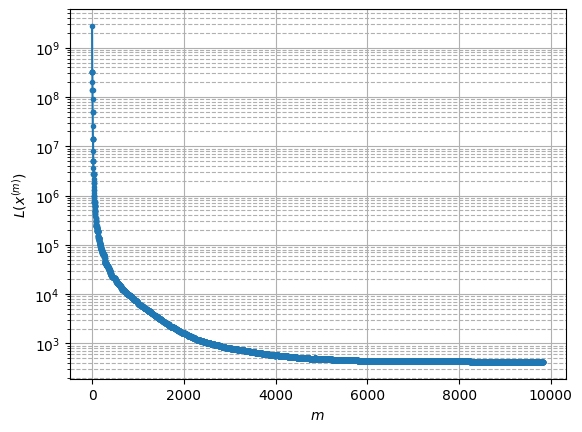

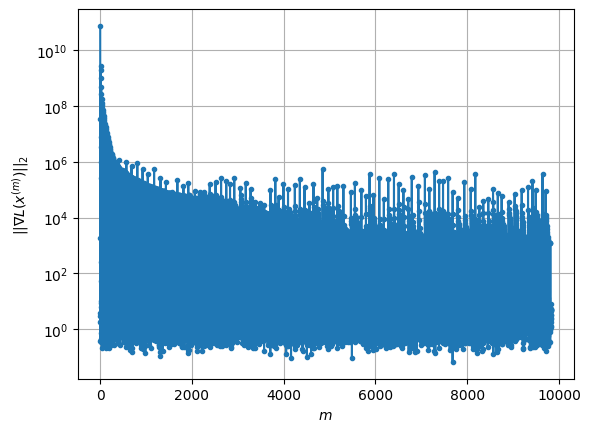

Windows:  29%|██▉       | 87/296 [5:26:32<12:39:18, 217.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.7701915878594
Gradient norm: 306952.4824084787
Global relative error: 0.970358929515167
Position relative errors: 0.006855215442649017 m, 0.3338971530310314 m, 0.654709445637075 m, 0.633573548770149 m

STOP on Iteration 1
Cost function = 428.47313958205734 (-0.07%)
Gradient norm = 0.8606571984929138 (-100.00%)
Global relative error = 0.9773808916196989 (0.72%)
Final position relative errors: 0.013922134847126622 m, 0.3333030878903956 m, 0.6579996126201559 m, 0.6411106713792177 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 428.41658157933955
Gradient norm: 25897.288169050636
Global relative error: 0.9773808916196989
Position relative errors: 0.013922134847126622 m, 0.3333030878903956 m, 0.6579996126201559 m, 0.6411106713792177 m

Iteration 1
Cost function: 428.3775304751107 (-0.01%)
Gradient norm: 2.120949849494931 (-99.99%)
Global relative error = 0.982011090

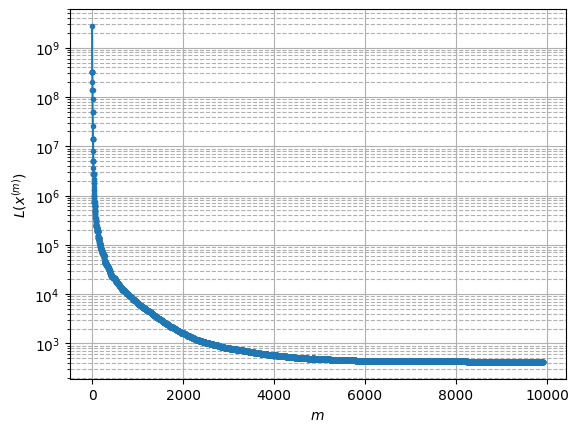

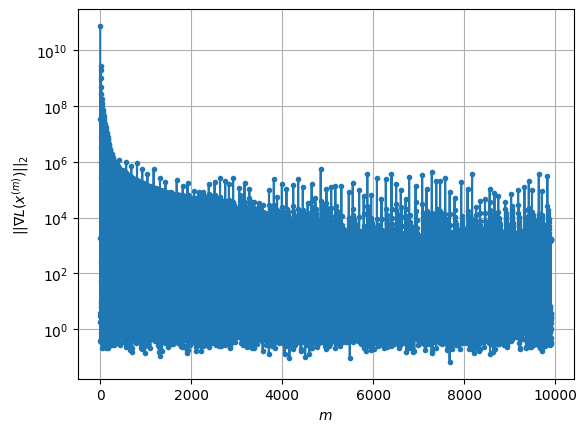

Windows:  30%|██▉       | 88/296 [5:29:44<12:09:32, 210.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 427.23388513862034
Gradient norm: 239050.90193408873
Global relative error: 1.0726375755060105
Position relative errors: 0.012640290047549135 m, 0.3937986471865288 m, 0.6716245065734746 m, 0.737721316887295 m

Iteration 1
Cost function: 427.12976177998155 (-0.02%)
Gradient norm: 1.8692630581627487 (-100.00%)
Global relative error = 1.0730770242515297 (0.04%)
Position relative errors: 0.012723681159039551 m, 0.3859021966363267 m, 0.6733973547945579 m, 0.7409088420666121 m

STOP on Iteration 2
Cost function = 427.12976209123616 (0.00%)
Gradient norm = 0.2606893258550679 (-86.05%)
Global relative error = 1.07307702297789 (-0.00%)
Final position relative errors: 0.0127236847743312 m, 0.38590219638107837 m, 0.6733973543710315 m, 0.740908840677766 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 427.11362068590705
Gradient norm: 11280.416265104079
Global relative error: 1

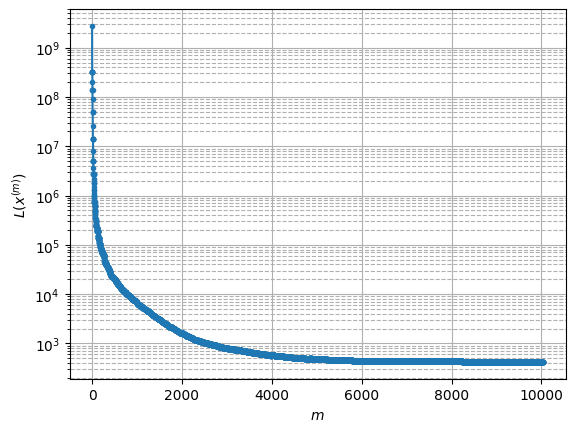

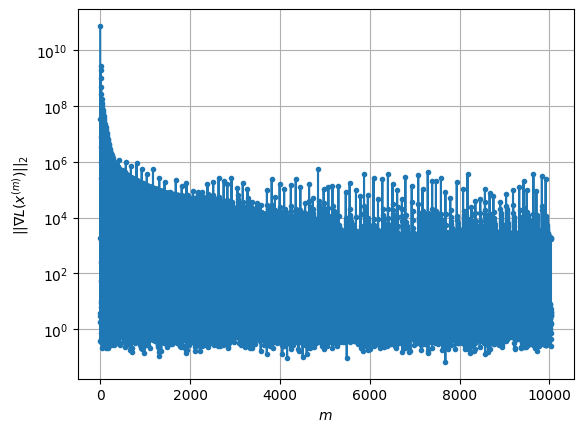

Windows:  30%|███       | 89/296 [5:34:21<13:14:52, 230.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 427.6379241293308
Gradient norm: 221533.9045885335
Global relative error: 1.1440634371443406
Position relative errors: 0.013401188187133255 m, 0.4028747924842633 m, 0.6518807736523377 m, 0.8493780993481463 m

STOP on Iteration 1
Cost function = 427.2175151472053 (-0.10%)
Gradient norm = 0.7092807318801433 (-100.00%)
Global relative error = 1.1494838159701037 (0.47%)
Final position relative errors: 0.018520582259259497 m, 0.4041540390554823 m, 0.667871244049268 m, 0.8435495111950321 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 427.05286269905775
Gradient norm: 22753.676825677256
Global relative error: 1.1494838159701037
Position relative errors: 0.018520582259259497 m, 0.4041540390554823 m, 0.667871244049268 m, 0.8435495111950321 m

STOP on Iteration 1
Cost function = 426.97198284975764 (-0.02%)
Gradient norm = 0.6616842642548583 (-100.00%)
Global relative error 

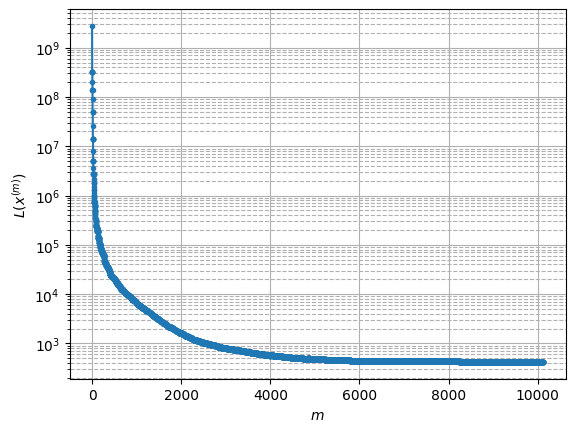

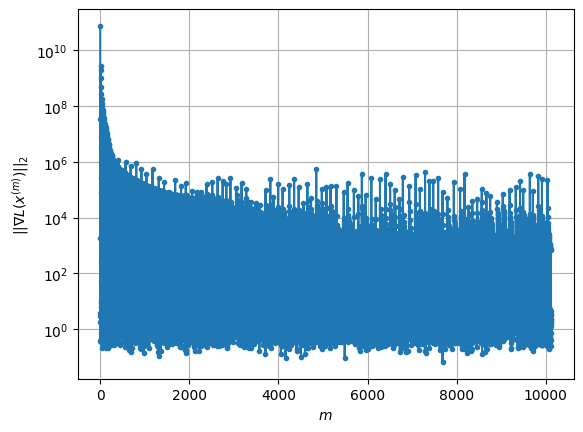

Windows:  30%|███       | 90/296 [5:37:31<12:29:22, 218.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.67643057921396
Gradient norm: 164846.01996644025
Global relative error: 1.2180066854605809
Position relative errors: 0.017878289994516988 m, 0.4809346105070234 m, 0.7014009902821258 m, 0.8717554737595873 m

STOP on Iteration 1
Cost function = 429.5829422913948 (-0.02%)
Gradient norm = 0.43858323194278265 (-100.00%)
Global relative error = 1.215748013926722 (-0.19%)
Final position relative errors: 0.0185665748725387 m, 0.48417264265683285 m, 0.6968493317191912 m, 0.8704451647502993 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 429.56575035606414
Gradient norm: 7485.757963754365
Global relative error: 1.215748013926722
Position relative errors: 0.0185665748725387 m, 0.48417264265683285 m, 0.6968493317191912 m, 0.8704451647502993 m

Iteration 1
Cost function: 429.5572092174597 (-0.00%)
Gradient norm: 1.609047273786665 (-99.98%)
Global relative error = 1.21534059

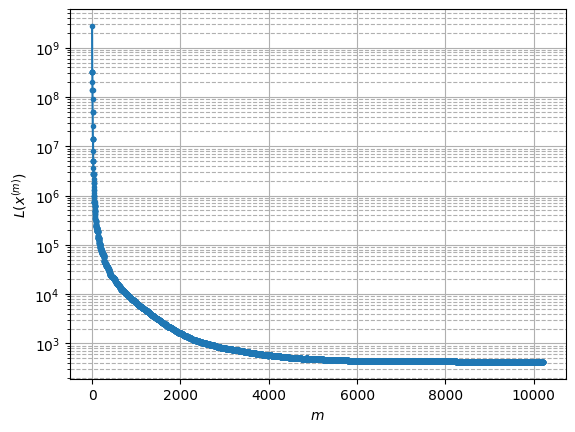

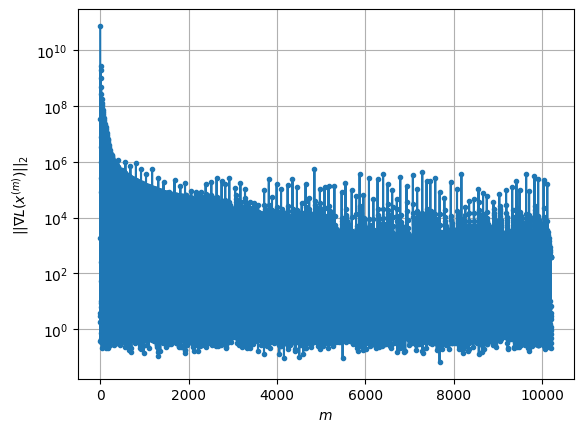

Windows:  31%|███       | 91/296 [5:40:50<12:05:47, 212.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.44530317267504
Gradient norm: 82161.43529430153
Global relative error: 1.2479560566656946
Position relative errors: 0.019394543164041805 m, 0.5632185236469733 m, 0.675975403397527 m, 0.8847931528349468 m

STOP on Iteration 1
Cost function = 432.2071576579931 (-0.06%)
Gradient norm = 0.2534910696216152 (-100.00%)
Global relative error = 1.2390909227373992 (-0.71%)
Final position relative errors: 0.01583793092959926 m, 0.5563312644045288 m, 0.665748819174657 m, 0.8845157693714242 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 432.1146719190749
Gradient norm: 21745.962623512398
Global relative error: 1.2390909227373992
Position relative errors: 0.01583793092959926 m, 0.5563312644045288 m, 0.665748819174657 m, 0.8845157693714242 m

STOP on Iteration 1
Cost function = 432.0689139276496 (-0.01%)
Gradient norm = 0.7694788918641993 (-100.00%)
Global relative error = 1

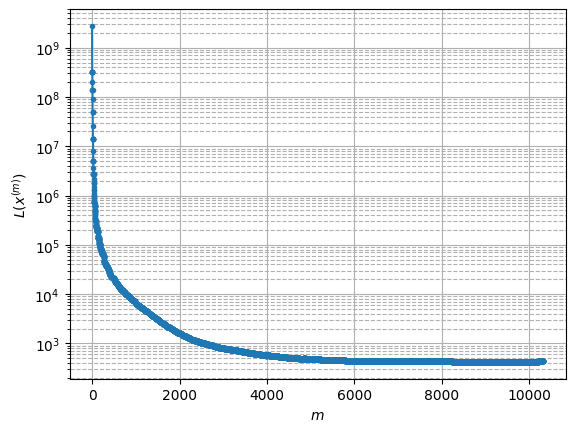

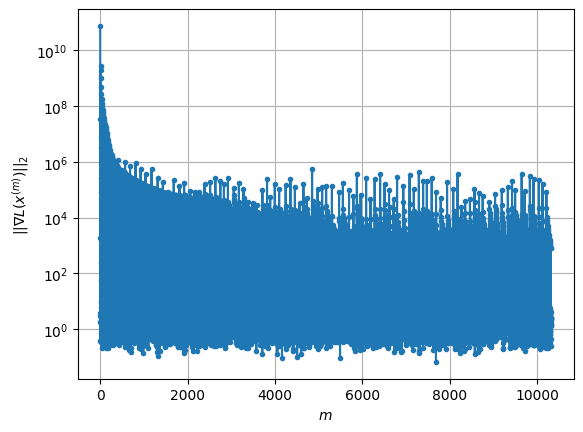

Windows:  31%|███       | 92/296 [5:44:55<12:35:35, 222.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.572630066421
Gradient norm: 80146.69019592424
Global relative error: 1.2472952742043368
Position relative errors: 0.016386352407728684 m, 0.5839409894673567 m, 0.6248447095442606 m, 0.9077762947562188 m

STOP on Iteration 1
Cost function = 430.5028831712999 (-0.02%)
Gradient norm = 0.37914947201436666 (-100.00%)
Global relative error = 1.25053704233603 (0.26%)
Final position relative errors: 0.012749625456835983 m, 0.582303702450826 m, 0.6298673696154952 m, 0.9098728639801579 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 430.4784411784359
Gradient norm: 7441.699479226201
Global relative error: 1.25053704233603
Position relative errors: 0.012749625456835983 m, 0.582303702450826 m, 0.6298673696154952 m, 0.9098728639801579 m

STOP on Iteration 1
Cost function = 430.46531191984946 (-0.00%)
Gradient norm = 0.5447976086191262 (-99.99%)
Global relative error = 1.252

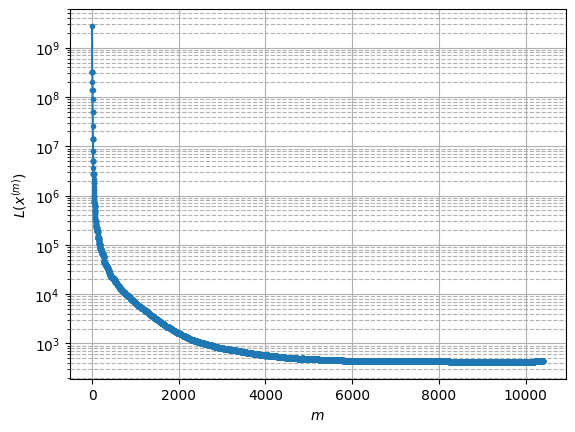

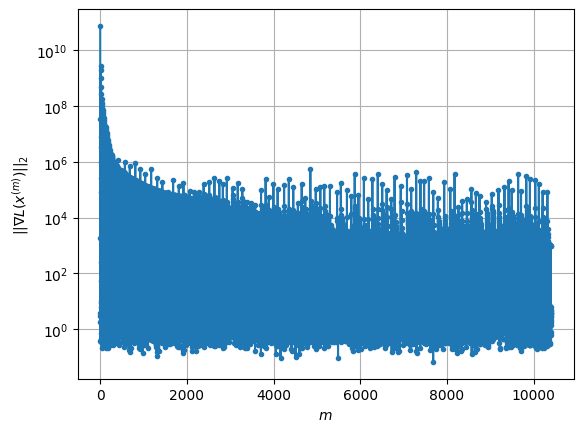

Windows:  31%|███▏      | 93/296 [5:48:13<12:06:38, 214.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.5226980934258
Gradient norm: 172344.74689519257
Global relative error: 1.2913090013771749
Position relative errors: 0.013698864730537552 m, 0.6028181761049826 m, 0.6156652492270916 m, 0.9616947075255167 m

STOP on Iteration 1
Cost function = 429.361099682548 (-0.04%)
Gradient norm = 0.8726560249607686 (-100.00%)
Global relative error = 1.2887773052759055 (-0.20%)
Final position relative errors: 0.008639283093488501 m, 0.6045450857838917 m, 0.6104225162487087 m, 0.9606147964593125 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 429.31348323150064
Gradient norm: 18103.18750592758
Global relative error: 1.2887773052759055
Position relative errors: 0.008639283093488501 m, 0.6045450857838917 m, 0.6104225162487087 m, 0.9606147964593125 m

Iteration 1
Cost function: 429.28809836351485 (-0.01%)
Gradient norm: 3.0691273114228697 (-99.98%)
Global relative error = 1.28766

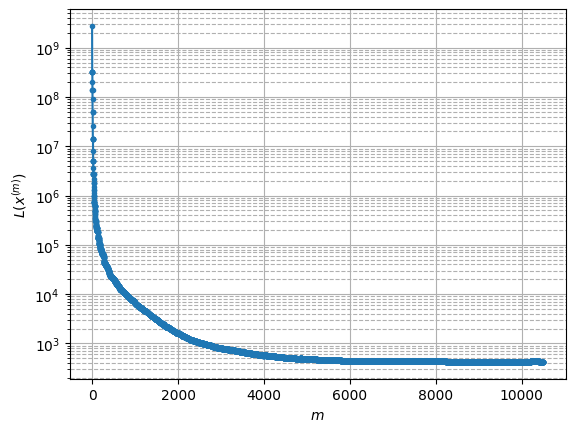

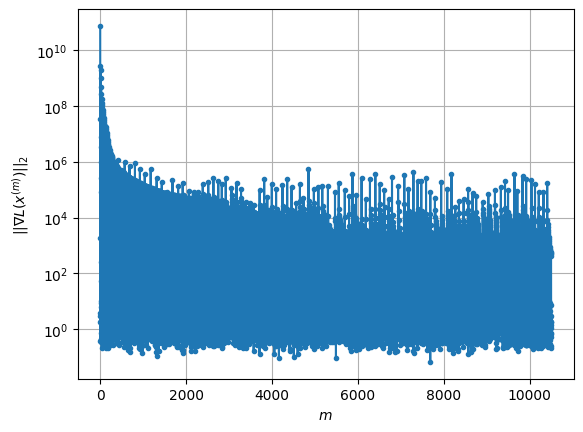

Windows:  32%|███▏      | 94/296 [5:51:42<11:57:09, 213.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 423.7954189673387
Gradient norm: 42617.98410176016
Global relative error: 1.2969374367192756
Position relative errors: 0.010033698059900717 m, 0.6647670300689494 m, 0.5539947043412994 m, 0.9659811910711267 m

Iteration 1
Cost function: 423.5410439822494 (-0.06%)
Gradient norm: 3.615565869187051 (-99.99%)
Global relative error = 1.3045432844649207 (0.59%)
Position relative errors: 0.011685070616920404 m, 0.6710484828548026 m, 0.570394550013114 m, 0.9623094941923894 m

Iteration 2
Cost function: 423.54104393675254 (-0.00%)
Gradient norm: 6.5591704922927665 (81.41%)
Global relative error = 1.3045432863699722 (0.00%)
Position relative errors: 0.01168506874968343 m, 0.6710484825983853 m, 0.5703945574591053 m, 0.9623094925629331 m

STOP on Iteration 3
Cost function = 423.5410440324143 (0.00%)
Gradient norm = 0.6181406185565154 (-90.58%)
Global relative error = 1.3045432866829985 (0.00%)
Final position relativ

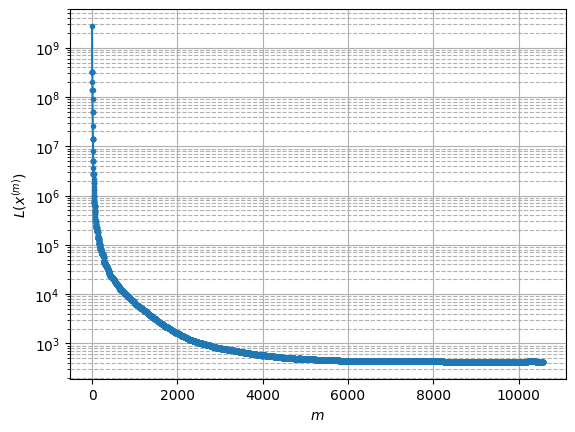

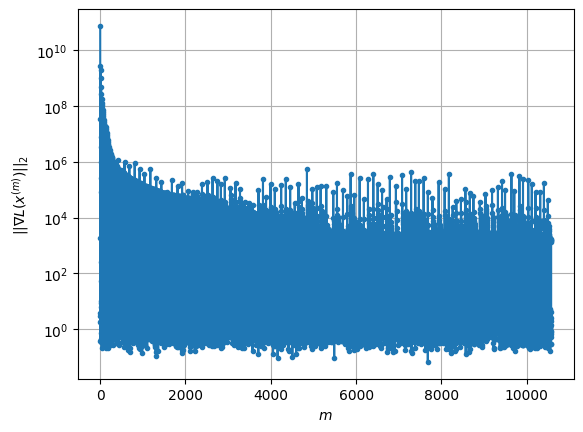

Windows:  32%|███▏      | 95/296 [5:54:37<11:16:01, 201.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 421.09445271738065
Gradient norm: 78927.70887656235
Global relative error: 1.3516990868672083
Position relative errors: 0.01090588771555593 m, 0.7407640371493366 m, 0.6360000651265991 m, 0.9347422233874686 m

Iteration 1
Cost function: 420.9003634877641 (-0.05%)
Gradient norm: 3.4069444904974335 (-100.00%)
Global relative error = 1.347851292389602 (-0.28%)
Position relative errors: 0.01622555641908664 m, 0.746822941556593 m, 0.6196095450450573 m, 0.9352958580149917 m

Iteration 2
Cost function: 420.900362686665 (-0.00%)
Gradient norm: 5.897898881172631 (73.11%)
Global relative error = 1.3478512923366763 (-0.00%)
Position relative errors: 0.016225554542924757 m, 0.7468229410160857 m, 0.6196095453669609 m, 0.9352958581896049 m

Iteration 3
Cost function: 420.90036374981395 (0.00%)
Gradient norm: 4.467935799405402 (-24.25%)
Global relative error = 1.3478512922843242 (-0.00%)
Position relative errors: 0.016

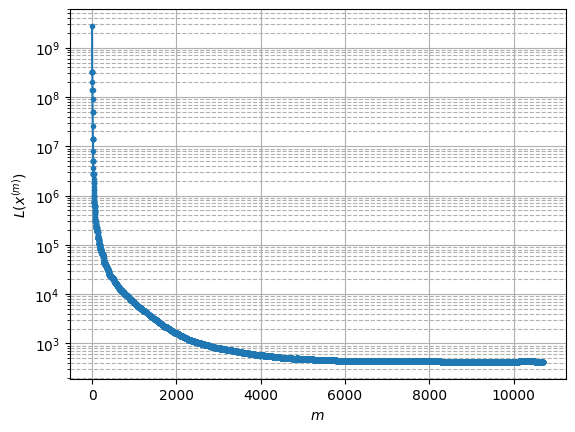

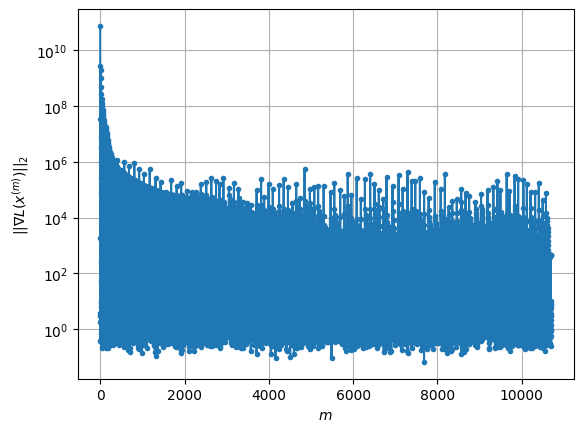

Windows:  32%|███▏      | 96/296 [5:59:13<12:26:19, 223.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 423.0363650448499
Gradient norm: 86440.73945669548
Global relative error: 1.3372699693369172
Position relative errors: 0.0175393185750149 m, 0.8554630703935071 m, 0.5542526467461073 m, 0.8654301505541176 m

Iteration 1
Cost function: 422.894027939357 (-0.03%)
Gradient norm: 1.0705000167967822 (-100.00%)
Global relative error = 1.3300853229260157 (-0.54%)
Position relative errors: 0.00999998994461025 m, 0.8539116174260192 m, 0.5468792350329836 m, 0.8606881560917462 m

STOP on Iteration 2
Cost function = 422.89402880115165 (0.00%)
Gradient norm = 0.47330631711495996 (-55.79%)
Global relative error = 1.3300853211716428 (-0.00%)
Final position relative errors: 0.00999999017091632 m, 0.853911616732893 m, 0.5468792317092533 m, 0.8606881561775198 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 422.8581550155367
Gradient norm: 15466.399122575991
Global relative error: 1.33

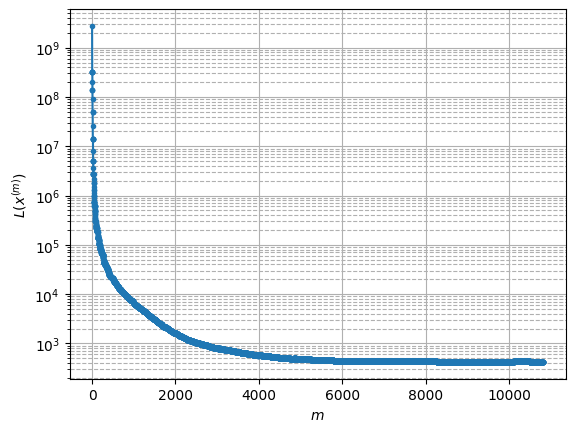

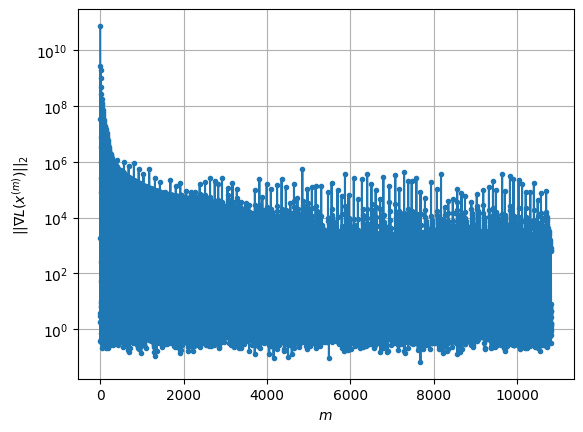

Windows:  33%|███▎      | 97/296 [6:03:46<13:12:10, 238.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.59374766147243
Gradient norm: 291228.97283511434
Global relative error: 1.3110332742692465
Position relative errors: 0.01085481011646749 m, 0.9159777198036474 m, 0.48488110990779154 m, 0.8028478609585858 m

Iteration 1
Cost function: 424.386101424208 (-0.05%)
Gradient norm: 1.2748197303242823 (-100.00%)
Global relative error = 1.3129731928421462 (0.15%)
Position relative errors: 0.014671506595460777 m, 0.9168087501043997 m, 0.48903639624964607 m, 0.8024883848005907 m

Iteration 2
Cost function: 424.38610147204525 (0.00%)
Gradient norm: 4.615720342482042 (262.07%)
Global relative error = 1.312973192446434 (-0.00%)
Position relative errors: 0.014671508533488467 m, 0.9168087499137323 m, 0.4890363966876903 m, 0.8024883840686062 m

Iteration 3
Cost function: 424.3861017605846 (0.00%)
Gradient norm: 3.8913533303630343 (-15.69%)
Global relative error = 1.312973191548203 (-0.00%)
Position relative errors: 0

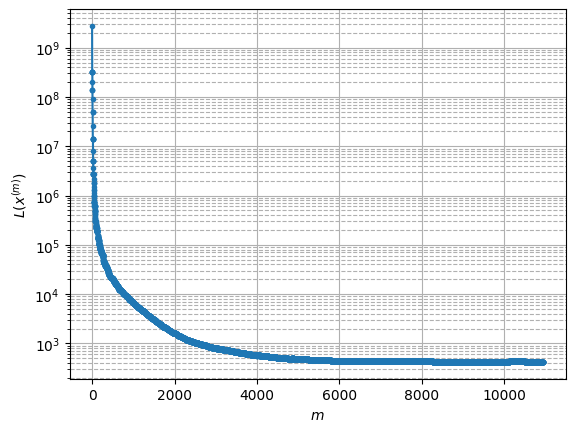

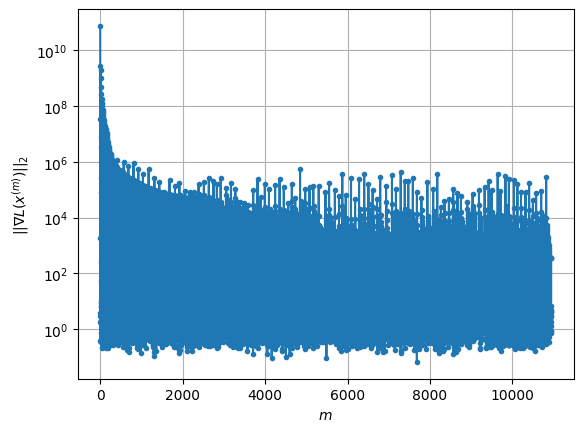

Windows:  33%|███▎      | 98/296 [6:08:14<13:36:58, 247.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.34542084347265
Gradient norm: 126650.10066157758
Global relative error: 1.3309555972311813
Position relative errors: 0.014321061621750194 m, 0.9851391895601129 m, 0.4877823759583569 m, 0.7502039620350206 m

Iteration 1
Cost function: 424.0936107743198 (-0.06%)
Gradient norm: 2.461396934594461 (-100.00%)
Global relative error = 1.3252364807826458 (-0.43%)
Position relative errors: 0.012447889801089324 m, 0.9875939526446382 m, 0.46718542644623356 m, 0.7499946002911978 m

Iteration 2
Cost function: 424.0936103150116 (-0.00%)
Gradient norm: 3.115559417492689 (26.58%)
Global relative error = 1.3252364811798636 (0.00%)
Position relative errors: 0.012447891301455263 m, 0.987593952849079 m, 0.46718542906900584 m, 0.7499945990652036 m

Iteration 3
Cost function: 424.0936107725518 (0.00%)
Gradient norm: 4.473710343377661 (43.59%)
Global relative error = 1.3252364846365536 (0.00%)
Position relative errors: 0.0

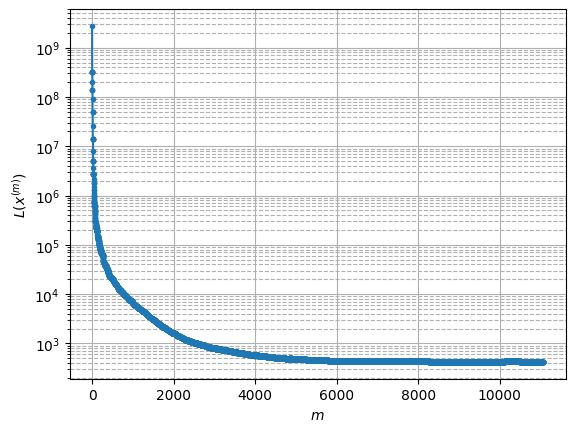

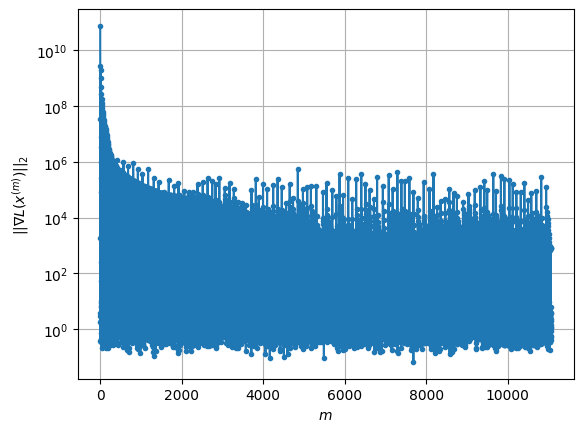

Windows:  33%|███▎      | 99/296 [6:12:49<13:59:09, 255.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424.3052803536811
Gradient norm: 172123.20125886673
Global relative error: 1.284553165675544
Position relative errors: 0.013046456603719826 m, 1.052558664772696 m, 0.3541286541443062 m, 0.6454602832521179 m

Iteration 1
Cost function: 424.01608005736824 (-0.07%)
Gradient norm: 3.5816453370004293 (-100.00%)
Global relative error = 1.2721699179618766 (-0.96%)
Position relative errors: 0.012614293996611372 m, 1.0459712544922963 m, 0.3483204692480809 m, 0.6347230864294457 m

Iteration 2
Cost function: 424.016080175626 (0.00%)
Gradient norm: 1.552360782342153 (-56.66%)
Global relative error = 1.2721699187865552 (0.00%)
Position relative errors: 0.012614285679169555 m, 1.0459712551931029 m, 0.3483204710817164 m, 0.6347230860865147 m

Iteration 3
Cost function: 424.01608063613384 (0.00%)
Gradient norm: 6.581357317876866 (323.96%)
Global relative error = 1.2721699192375098 (0.00%)
Position relative errors: 0.01

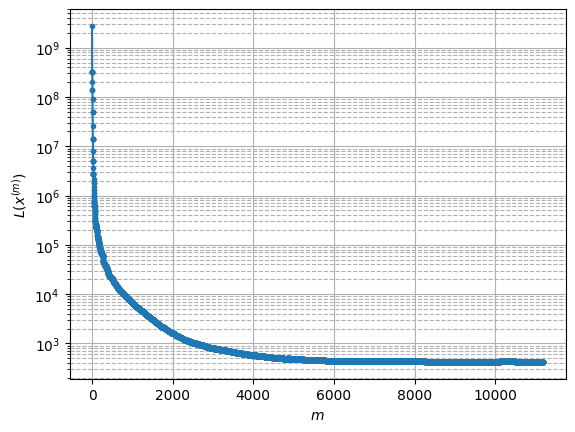

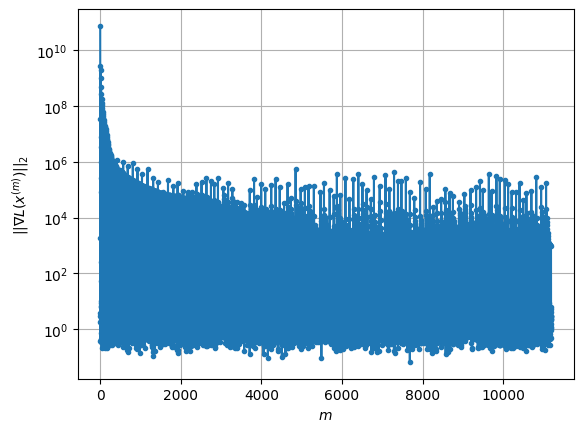

Windows:  34%|███▍      | 100/296 [6:17:39<14:29:15, 266.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.8264529606622
Gradient norm: 92803.51043012034
Global relative error: 1.2306667548817032
Position relative errors: 0.012872057950946253 m, 1.0493604916755424 m, 0.26850816663065774 m, 0.5840549352391402 m

Iteration 1
Cost function: 428.6265366434777 (-0.05%)
Gradient norm: 3.563682239847832 (-100.00%)
Global relative error = 1.2329230919210357 (0.18%)
Position relative errors: 0.017655895289122432 m, 1.0495232761468685 m, 0.2712691488952168 m, 0.5871122744829966 m

STOP on Iteration 2
Cost function = 428.62653701550386 (0.00%)
Gradient norm = 0.35093827814102274 (-90.15%)
Global relative error = 1.2329230917123588 (-0.00%)
Final position relative errors: 0.01765589905354697 m, 1.0495232754414014 m, 0.27126914916651373 m, 0.5871122750673196 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 428.5996966323169
Gradient norm: 19161.597240336127
Global relative error:

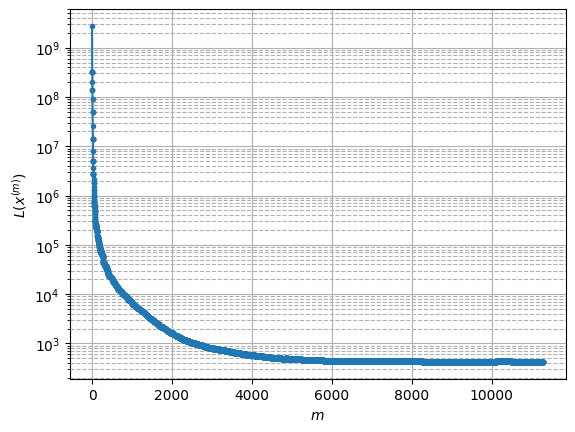

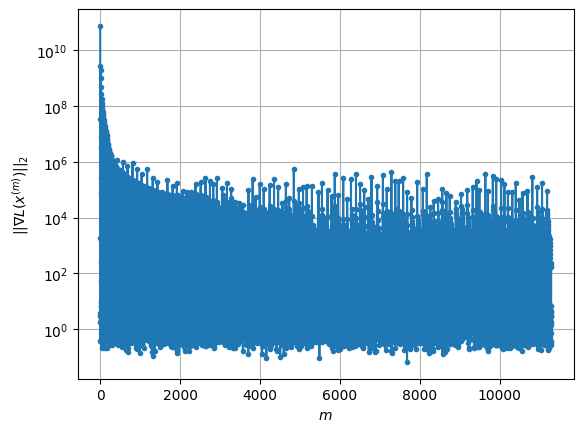

Windows:  34%|███▍      | 101/296 [6:21:30<13:50:29, 255.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.2929982006822
Gradient norm: 116416.80030139016
Global relative error: 1.229037661566709
Position relative errors: 0.01763989369272718 m, 1.0617673005308883 m, 0.24522412064756485 m, 0.5680994681932837 m

Iteration 1
Cost function: 430.1925178902789 (-0.02%)
Gradient norm: 1.6990542093046201 (-100.00%)
Global relative error = 1.2300948567267234 (0.09%)
Position relative errors: 0.02167917801617318 m, 1.0605829547751067 m, 0.24815525333854008 m, 0.571178955716828 m

Iteration 2
Cost function: 430.19251841344675 (0.00%)
Gradient norm: 2.5302581175941774 (48.92%)
Global relative error = 1.2300948579766897 (0.00%)
Position relative errors: 0.021679176487358256 m, 1.0605829544887904 m, 0.24815525339397318 m, 0.5711789589743406 m

Iteration 3
Cost function: 430.19251819776605 (-0.00%)
Gradient norm: 1.0922708913533683 (-56.83%)
Global relative error = 1.2300948549310695 (-0.00%)
Position relative errors: 

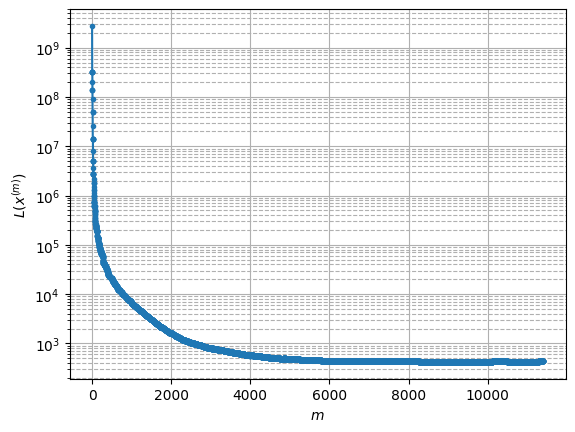

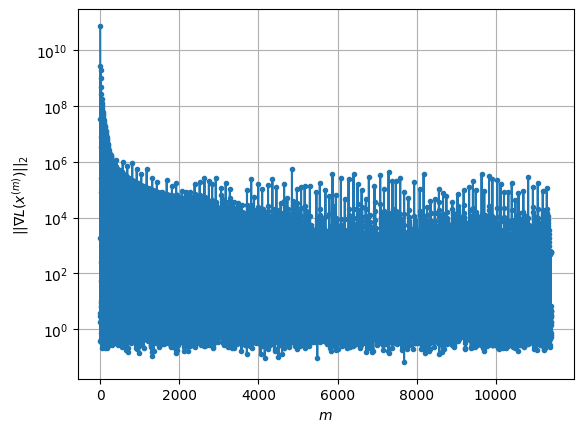

Windows:  34%|███▍      | 102/296 [6:25:34<13:35:11, 252.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 431.27628064526823
Gradient norm: 83682.89072936737
Global relative error: 1.2263139055937946
Position relative errors: 0.0213752819062163 m, 1.058436351020137 m, 0.26053044386599344 m, 0.5614485915655053 m

Iteration 1
Cost function: 431.1218297449763 (-0.04%)
Gradient norm: 3.3298596259530657 (-100.00%)
Global relative error = 1.2288963795016903 (0.21%)
Position relative errors: 0.02600040937151749 m, 1.0561072047972633 m, 0.2874220970316381 m, 0.5581537804677453 m

Iteration 2
Cost function: 431.1218297850668 (0.00%)
Gradient norm: 5.871043085194442 (76.32%)
Global relative error = 1.2288963803184187 (0.00%)
Position relative errors: 0.026000399510231816 m, 1.0561072055740994 m, 0.28742210343949576 m, 0.5581537779556991 m

Iteration 3
Cost function: 431.1218298604194 (0.00%)
Gradient norm: 3.229267309146372 (-45.00%)
Global relative error = 1.228896380759517 (0.00%)
Position relative errors: 0.026000

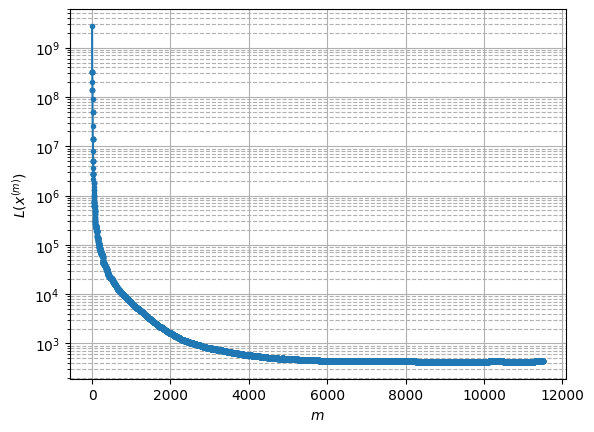

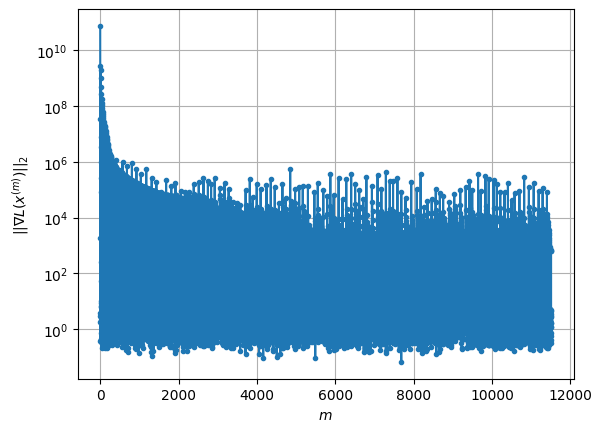

Windows:  35%|███▍      | 103/296 [6:29:35<13:19:46, 248.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.14000668188686
Gradient norm: 109625.59846670384
Global relative error: 1.252753698787576
Position relative errors: 0.02582777969171367 m, 1.044432525009787 m, 0.377947239495429 m, 0.5788268753151189 m

STOP on Iteration 1
Cost function = 427.9455366575623 (-0.05%)
Gradient norm = 0.26229481568035695 (-100.00%)
Global relative error = 1.2541964197104467 (0.12%)
Final position relative errors: 0.01597873874559761 m, 1.042750865385 m, 0.36243606647296855 m, 0.5950321657990904 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 427.9022460219914
Gradient norm: 11159.471291021724
Global relative error: 1.2541964197104467
Position relative errors: 0.01597873874559761 m, 1.042750865385 m, 0.36243606647296855 m, 0.5950321657990904 m

STOP on Iteration 1
Cost function = 427.87736974279306 (-0.01%)
Gradient norm = 0.2997246917187108 (-100.00%)
Global relative error = 1.2568

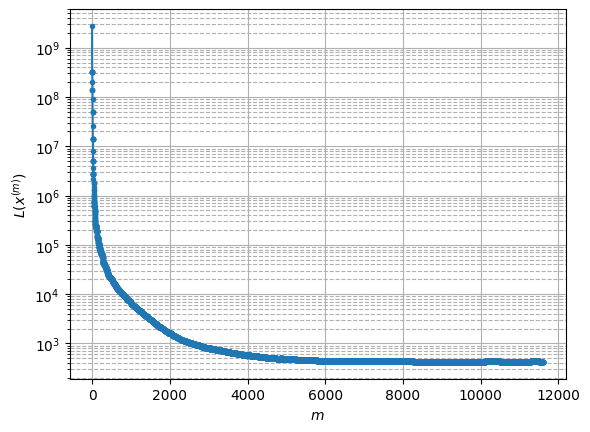

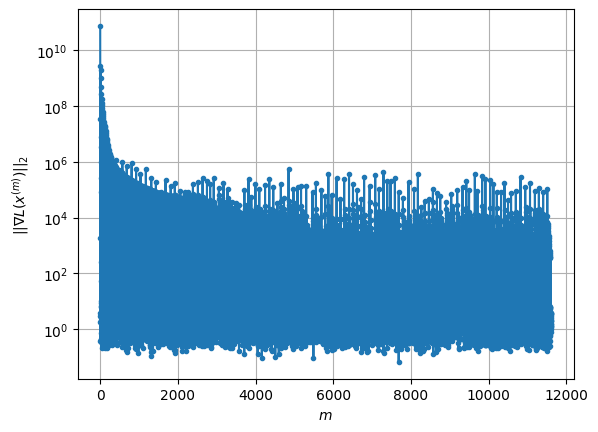

Windows:  35%|███▌      | 104/296 [6:33:13<12:46:37, 239.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.7431552056869
Gradient norm: 128637.08445926537
Global relative error: 1.2413547821238762
Position relative errors: 0.01601532994354287 m, 0.9949257464070803 m, 0.38392588430374086 m, 0.6351597922823491 m

Iteration 1
Cost function: 428.5540256674556 (-0.04%)
Gradient norm: 4.636706572943058 (-100.00%)
Global relative error = 1.2395806939484888 (-0.14%)
Position relative errors: 0.02435054888806732 m, 0.9961950679983834 m, 0.34883686692866384 m, 0.6495187914910411 m

Iteration 2
Cost function: 428.55402574627055 (0.00%)
Gradient norm: 4.609087876530017 (-0.60%)
Global relative error = 1.2395806926815678 (-0.00%)
Position relative errors: 0.024350539043206686 m, 0.9961950673968432 m, 0.3488368838205158 m, 0.6495187812927734 m

Iteration 3
Cost function: 428.5540256496869 (-0.00%)
Gradient norm: 1.5808968605428415 (-65.70%)
Global relative error = 1.2395806958822813 (0.00%)
Position relative errors: 0

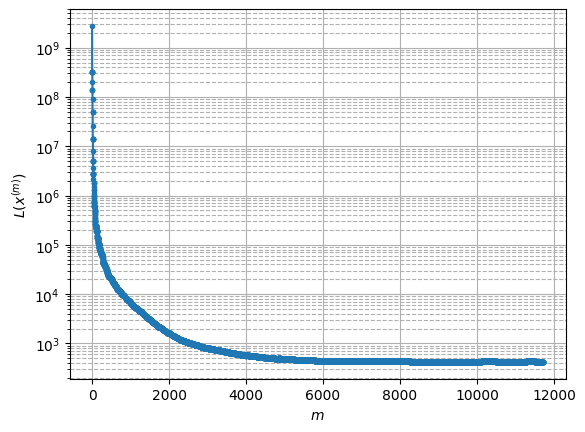

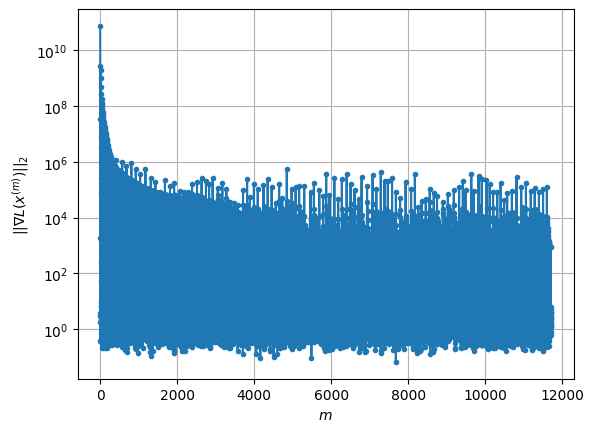

Windows:  35%|███▌      | 105/296 [6:37:25<12:54:32, 243.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.5977400433245
Gradient norm: 343411.643062125
Global relative error: 1.1865057584144112
Position relative errors: 0.023070151606757693 m, 0.9591684005392725 m, 0.2934941302276326 m, 0.6333402300917538 m

Iteration 1
Cost function: 429.4175851669158 (-0.04%)
Gradient norm: 2.6186735543570396 (-100.00%)
Global relative error = 1.177782951542356 (-0.74%)
Position relative errors: 0.025072665272072643 m, 0.9589224382591558 m, 0.29974039874279806 m, 0.6141388241263529 m

Iteration 2
Cost function: 429.41758522765275 (0.00%)
Gradient norm: 1.6655104482142988 (-36.40%)
Global relative error = 1.1777829526261838 (0.00%)
Position relative errors: 0.02507266960479249 m, 0.9589224414391336 m, 0.299740399968364 m, 0.6141388204645989 m

Iteration 3
Cost function: 429.4175846429844 (-0.00%)
Gradient norm: 1.808860091267596 (8.61%)
Global relative error = 1.1777829485440208 (-0.00%)
Position relative errors: 0.025

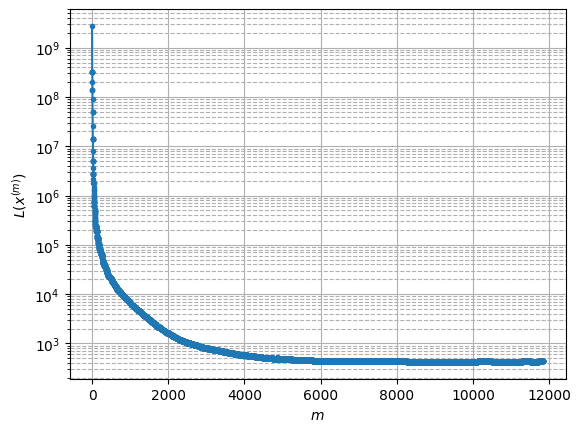

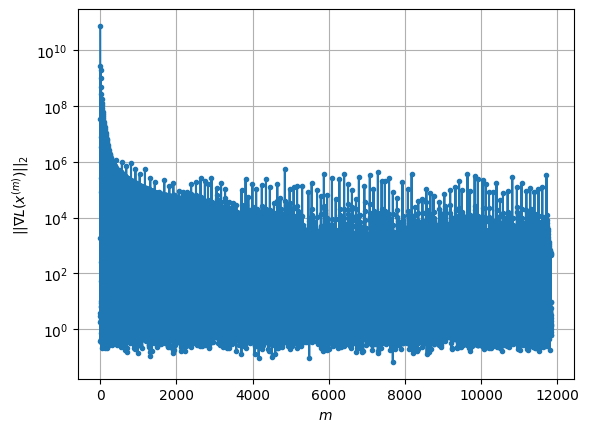

Windows:  36%|███▌      | 106/296 [6:42:02<13:21:49, 253.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.3740338308655
Gradient norm: 82187.47804005342
Global relative error: 1.0987763567741085
Position relative errors: 0.02351051755183527 m, 0.9123422539991446 m, 0.27384636652166944 m, 0.5471704737441758 m

Iteration 1
Cost function: 429.17126044074126 (-0.05%)
Gradient norm: 4.190821067642492 (-99.99%)
Global relative error = 1.097706077337742 (-0.10%)
Position relative errors: 0.01372980826630138 m, 0.9065163039293247 m, 0.2823431532821356 m, 0.55070833119066 m

Iteration 2
Cost function: 429.17126093668105 (0.00%)
Gradient norm: 9.60905667233691 (129.29%)
Global relative error = 1.0977060846406688 (0.00%)
Position relative errors: 0.013729797569059014 m, 0.9065163083110319 m, 0.28234316542136634 m, 0.5507083325776222 m

Iteration 3
Cost function: 429.17126071371257 (-0.00%)
Gradient norm: 6.126214055701924 (-36.25%)
Global relative error = 1.0977060828497403 (-0.00%)
Position relative errors: 0.013

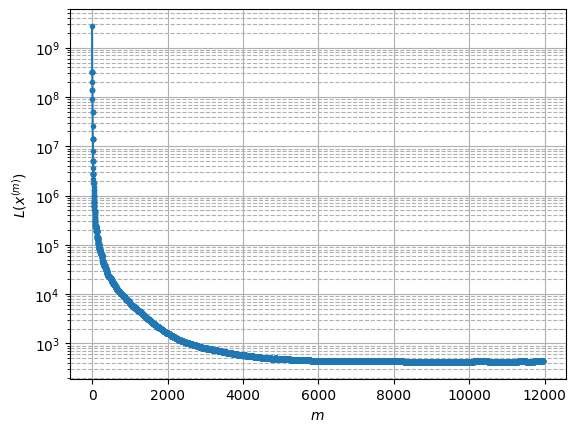

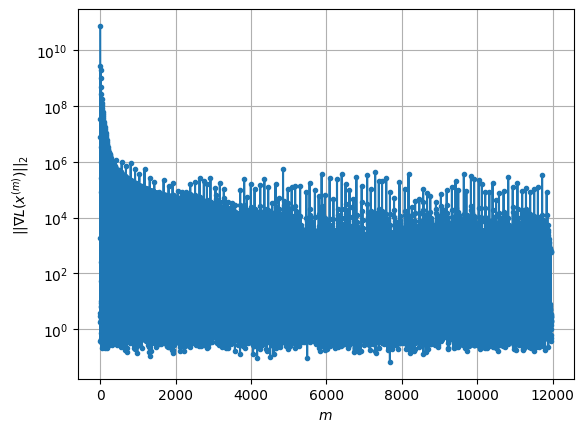

Windows:  36%|███▌      | 107/296 [6:46:27<13:29:07, 256.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 427.5686157608259
Gradient norm: 74866.96816806603
Global relative error: 1.046372272018711
Position relative errors: 0.012917235324277609 m, 0.8795484387604621 m, 0.2658925333633943 m, 0.5004226152268815 m

STOP on Iteration 1
Cost function = 427.5364222505702 (-0.01%)
Gradient norm = 0.8338276101784086 (-100.00%)
Global relative error = 1.0451064729377384 (-0.12%)
Final position relative errors: 0.011935565773935876 m, 0.8782699670436521 m, 0.2610528696588655 m, 0.5025906466965556 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 427.52675793111456
Gradient norm: 6717.6161875282205
Global relative error: 1.0451064729377384
Position relative errors: 0.011935565773935876 m, 0.8782699670436521 m, 0.2610528696588655 m, 0.5025906466965556 m

STOP on Iteration 1
Cost function = 427.52169396215277 (-0.00%)
Gradient norm = 0.9988432753585168 (-99.99%)
Global relative error

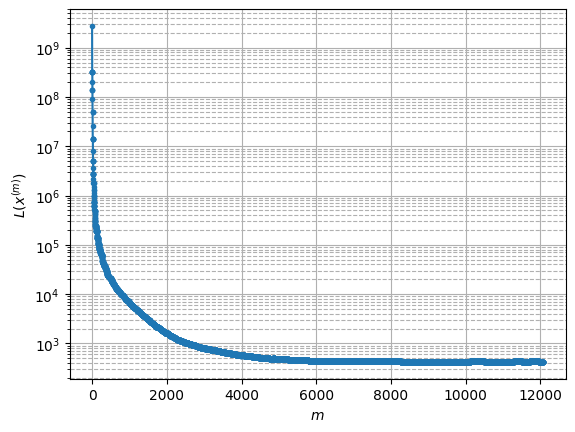

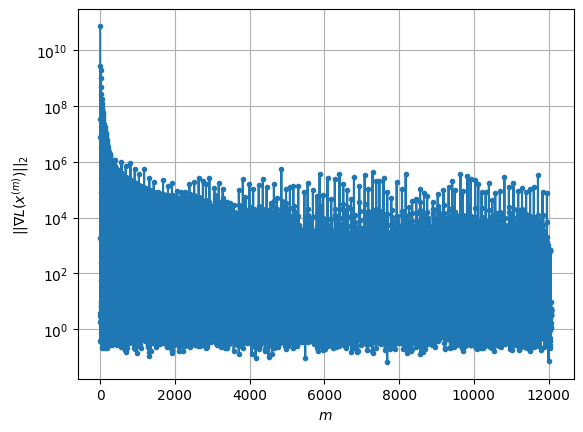

Windows:  36%|███▋      | 108/296 [6:51:01<13:40:37, 261.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.2591660972137
Gradient norm: 138708.80466210618
Global relative error: 1.0003192467787196
Position relative errors: 0.011653032010146657 m, 0.8543371706251851 m, 0.2526640359544652 m, 0.4547204550438546 m

STOP on Iteration 1
Cost function = 428.07836113763113 (-0.04%)
Gradient norm = 0.6740571068177366 (-100.00%)
Global relative error = 0.9942908963555932 (-0.60%)
Final position relative errors: 0.01911690220154741 m, 0.8524444799385892 m, 0.24821990183397283 m, 0.4471836689927006 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 428.047035231116
Gradient norm: 13928.251032114262
Global relative error: 0.9942908963555932
Position relative errors: 0.01911690220154741 m, 0.8524444799385892 m, 0.24821990183397283 m, 0.4471836689927006 m

Iteration 1
Cost function: 428.03215120264053 (-0.00%)
Gradient norm: 3.694947517911874 (-99.97%)
Global relative error = 0.98942

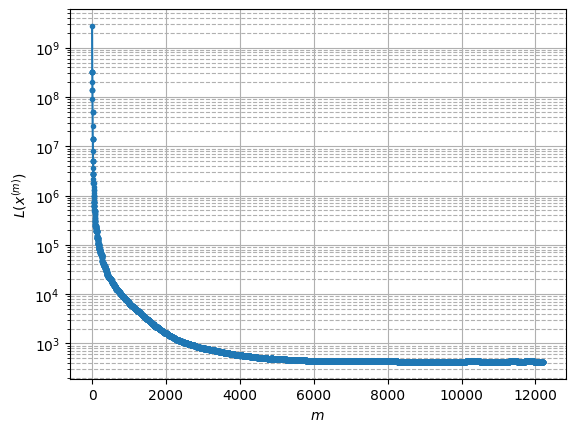

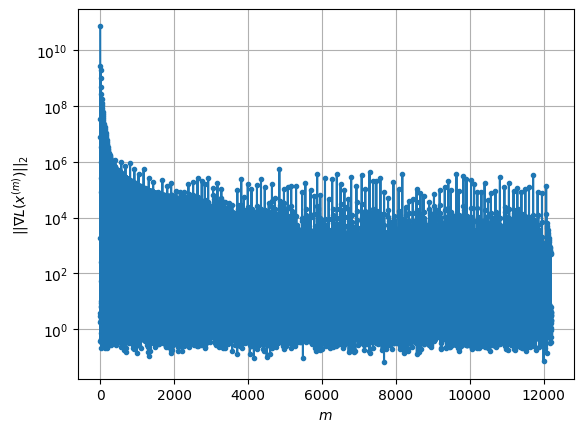

Windows:  37%|███▋      | 109/296 [6:56:06<14:17:23, 275.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.7991732275974
Gradient norm: 156486.4746230601
Global relative error: 0.9206291915222118
Position relative errors: 0.017949110718053895 m, 0.7927826438679366 m, 0.26220815690374644 m, 0.3872693041544094 m

Iteration 1
Cost function: 430.5944087399354 (-0.05%)
Gradient norm: 1.363228839782115 (-100.00%)
Global relative error = 0.925896230908312 (0.57%)
Position relative errors: 0.013061970691465528 m, 0.7902640180130713 m, 0.25798847923743984 m, 0.40747630850231314 m

Iteration 2
Cost function: 430.5944086507502 (-0.00%)
Gradient norm: 1.5350596374088648 (12.60%)
Global relative error = 0.9258962320725995 (0.00%)
Position relative errors: 0.013061973471668811 m, 0.790264018330173 m, 0.2579884794450426 m, 0.40747631031232395 m

STOP on Iteration 3
Cost function = 430.5944084847283 (-0.00%)
Gradient norm = 0.5316304392546102 (-65.37%)
Global relative error = 0.9258962324472138 (0.00%)
Final position re

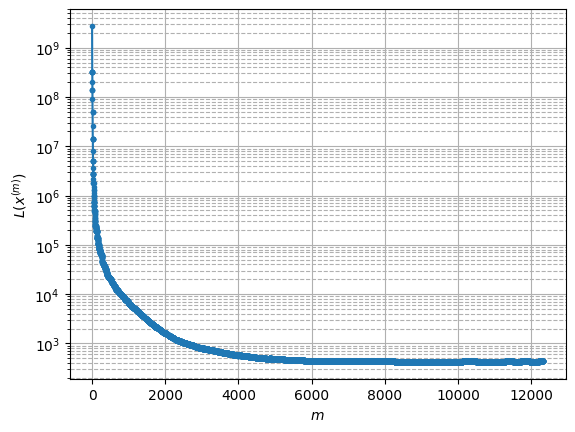

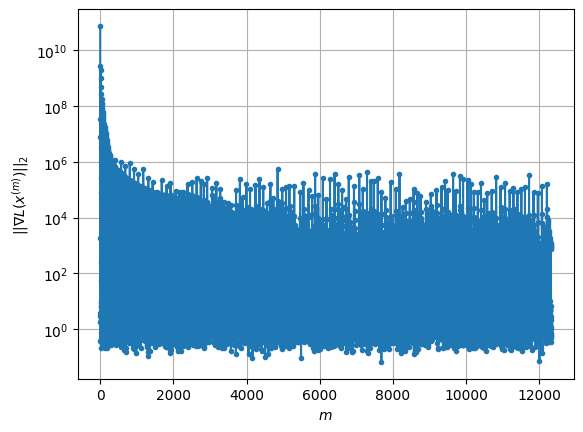

Windows:  37%|███▋      | 110/296 [7:00:23<13:55:25, 269.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.0437345236695
Gradient norm: 41632.84527964614
Global relative error: 0.8883442059841267
Position relative errors: 0.012772589321158405 m, 0.7452082353482995 m, 0.28359446440712754 m, 0.3914461908788636 m

Iteration 1
Cost function: 427.9603872452652 (-0.02%)
Gradient norm: 1.5875641869277137 (-100.00%)
Global relative error = 0.8927368057441154 (0.49%)
Position relative errors: 0.01018161685313554 m, 0.7447169548180361 m, 0.2865863620611352 m, 0.4001739724022134 m

Iteration 2
Cost function: 427.9603870595505 (-0.00%)
Gradient norm: 4.142084766045614 (160.91%)
Global relative error = 0.8927368030627274 (-0.00%)
Position relative errors: 0.010181617681227297 m, 0.7447169526526854 m, 0.2865863633432176 m, 0.40017396951082335 m

Iteration 3
Cost function: 427.96038746591836 (0.00%)
Gradient norm: 5.111503612093471 (23.40%)
Global relative error = 0.8927368032815433 (0.00%)
Position relative errors: 0.

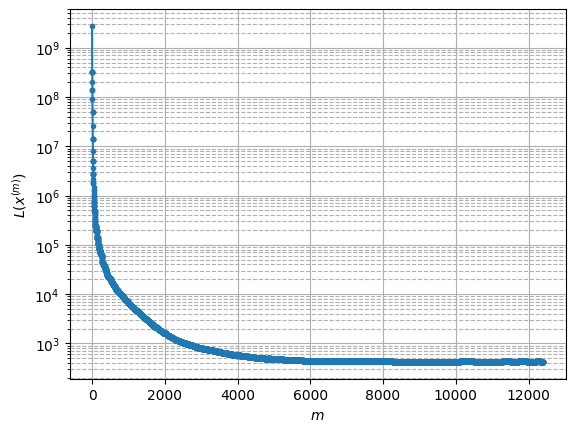

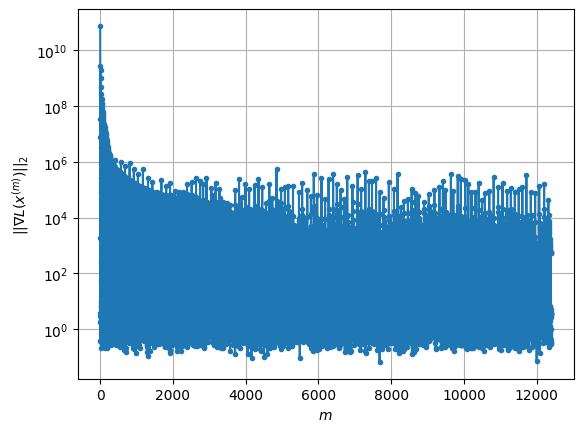

Windows:  38%|███▊      | 111/296 [7:03:17<12:22:39, 240.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 427.45152619113645
Gradient norm: 88823.91704591464
Global relative error: 0.8556452299294484
Position relative errors: 0.010483578008142095 m, 0.6891462271591063 m, 0.3268702336319153 m, 0.3876223493951229 m

Iteration 1
Cost function: 427.3480688162094 (-0.02%)
Gradient norm: 1.0617095005890642 (-100.00%)
Global relative error = 0.8552868611691401 (-0.04%)
Position relative errors: 0.01364219248837119 m, 0.6911856978210411 m, 0.31237077914575134 m, 0.39498763535256287 m

Iteration 2
Cost function: 427.3480684935073 (-0.00%)
Gradient norm: 2.2215933168080264 (109.25%)
Global relative error = 0.8552868621851951 (0.00%)
Position relative errors: 0.01364219341546495 m, 0.6911857003014344 m, 0.3123707787569404 m, 0.39498763348772964 m

Iteration 3
Cost function: 427.3480686925977 (0.00%)
Gradient norm: 1.1992515397887316 (-46.02%)
Global relative error = 0.855286859690666 (-0.00%)
Position relative errors:

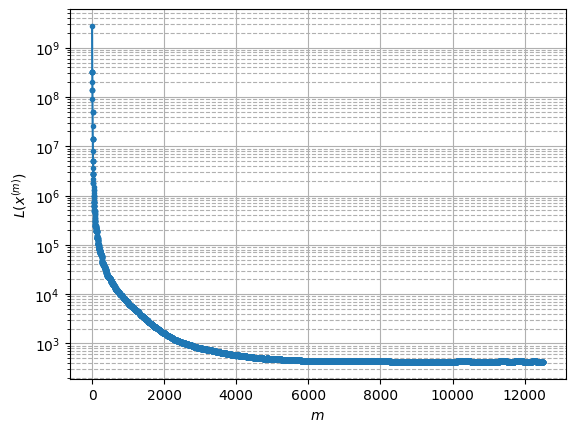

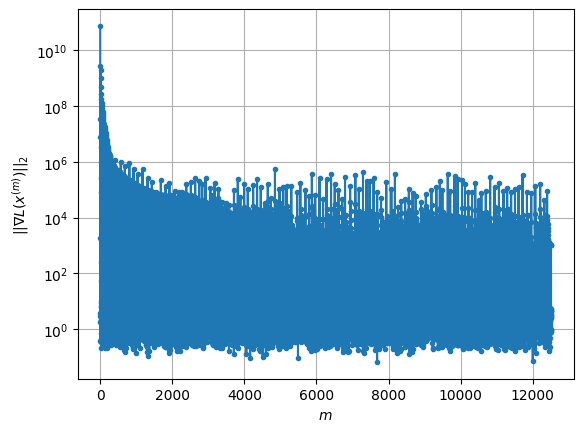

Windows:  38%|███▊      | 112/296 [7:07:30<12:29:58, 244.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 431.3887654783664
Gradient norm: 151168.070208368
Global relative error: 0.7845805955499564
Position relative errors: 0.014433515081783822 m, 0.6590914881784328 m, 0.2831133569051848 m, 0.3174940785421284 m

Iteration 1
Cost function: 431.2777380378065 (-0.03%)
Gradient norm: 3.1220421810408547 (-100.00%)
Global relative error = 0.765980809126186 (-2.37%)
Position relative errors: 0.01489983051049598 m, 0.6524509673078047 m, 0.28641912384372264 m, 0.2806693958006667 m

Iteration 2
Cost function: 431.2777382834117 (0.00%)
Gradient norm: 2.613726404563274 (-16.28%)
Global relative error = 0.7659808103723601 (0.00%)
Position relative errors: 0.014899829721577655 m, 0.6524509685326966 m, 0.286419124396658 m, 0.28066939583183104 m

Iteration 3
Cost function: 431.2777385823731 (0.00%)
Gradient norm: 2.047200082472508 (-21.68%)
Global relative error = 0.7659808091067002 (-0.00%)
Position relative errors: 0.014

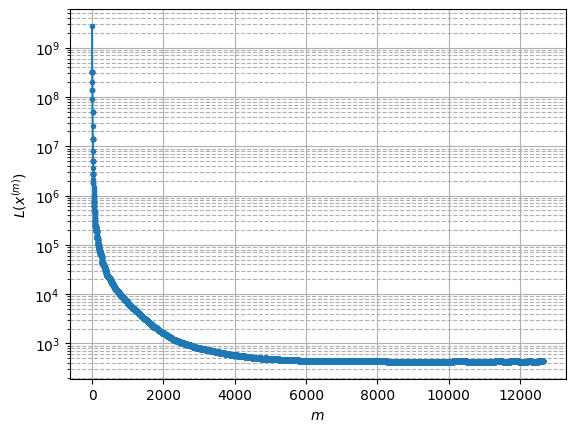

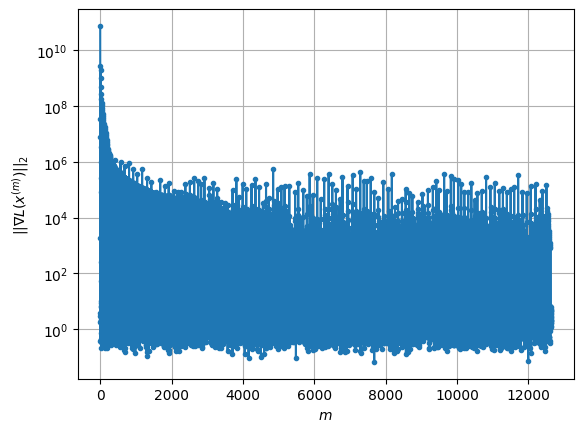

Windows:  38%|███▊      | 113/296 [7:12:30<13:16:55, 261.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 433.0043114401273
Gradient norm: 188652.7952999391
Global relative error: 0.7152191376338422
Position relative errors: 0.01526246747014062 m, 0.6145013776169835 m, 0.32021862805997925 m, 0.17650075883489583 m

Iteration 1
Cost function: 432.7716594678843 (-0.05%)
Gradient norm: 1.5750519521023738 (-100.00%)
Global relative error = 0.7115690743466389 (-0.51%)
Position relative errors: 0.02112205446920231 m, 0.6153059164208537 m, 0.31038943993925244 m, 0.17589880841677988 m

Iteration 2
Cost function: 432.771659542041 (0.00%)
Gradient norm: 2.998150332861544 (90.35%)
Global relative error = 0.7115690742634225 (-0.00%)
Position relative errors: 0.0211220573108175 m, 0.6153059154422951 m, 0.31038944043623296 m, 0.17589881028501686 m

Iteration 3
Cost function: 432.77165932632164 (-0.00%)
Gradient norm: 5.7785613633490245 (92.74%)
Global relative error = 0.7115690784422588 (0.00%)
Position relative errors: 0

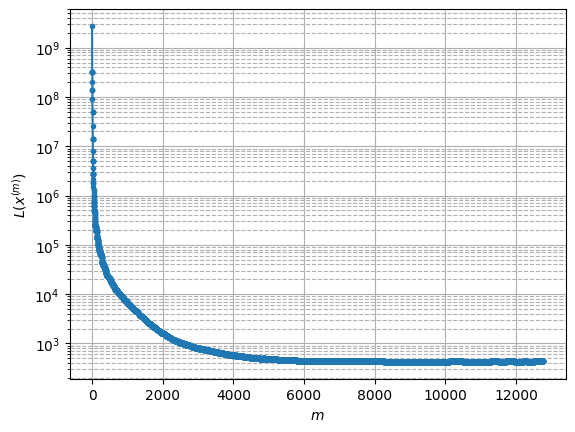

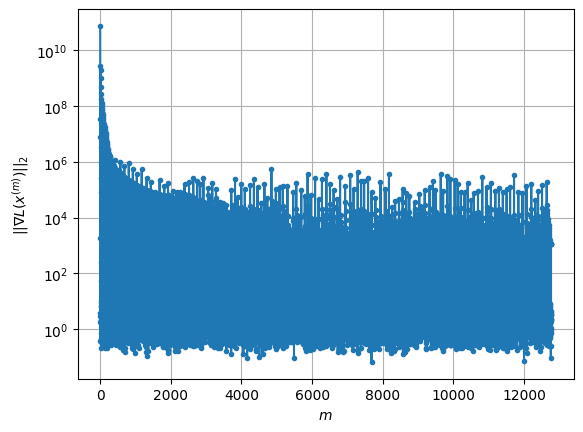

Windows:  39%|███▊      | 114/296 [7:17:19<13:37:21, 269.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.8117550799519
Gradient norm: 37483.49972466887
Global relative error: 0.6500402974758341
Position relative errors: 0.021502574285853192 m, 0.5916478301870728 m, 0.2314540656850704 m, 0.13590764658833962 m

Iteration 1
Cost function: 432.6422412403502 (-0.04%)
Gradient norm: 2.1653242215547066 (-99.99%)
Global relative error = 0.6632457283848633 (2.03%)
Position relative errors: 0.01475928359756985 m, 0.6032506980732322 m, 0.241884119843434 m, 0.13136480555519214 m

STOP on Iteration 2
Cost function = 432.64224097567114 (-0.00%)
Gradient norm = 0.5489041122712743 (-74.65%)
Global relative error = 0.6632457284006668 (0.00%)
Final position relative errors: 0.014759284022628416 m, 0.603250696546207 m, 0.2418841237156677 m, 0.13136480546958984 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 432.5924945386729
Gradient norm: 15951.21676329208
Global relative error: 0.

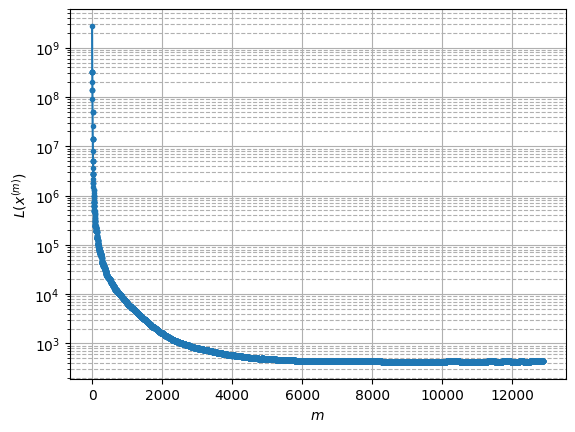

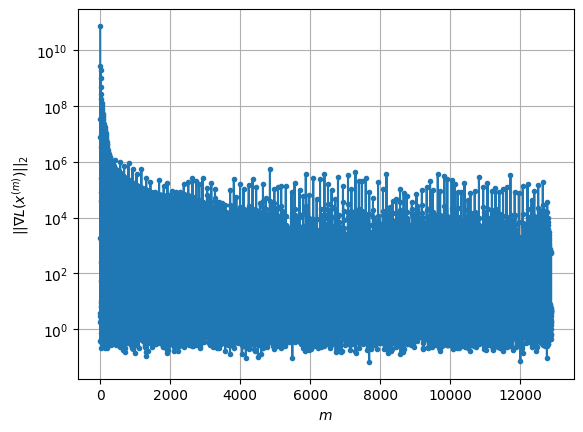

Windows:  39%|███▉      | 115/296 [7:21:35<13:20:47, 265.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 433.8747560085728
Gradient norm: 179049.46812889556
Global relative error: 0.6872524709790522
Position relative errors: 0.014863970388061119 m, 0.6043100894310844 m, 0.30391586654664704 m, 0.12057568464266516 m

Iteration 1
Cost function: 433.74896998598837 (-0.03%)
Gradient norm: 1.7473673487769064 (-100.00%)
Global relative error = 0.6908643264269853 (0.53%)
Position relative errors: 0.009415322835299403 m, 0.60965788910808 m, 0.308255989512724 m, 0.10246650804736633 m

Iteration 2
Cost function: 433.748970015923 (0.00%)
Gradient norm: 2.785084183543159 (59.39%)
Global relative error = 0.6908643297425926 (0.00%)
Position relative errors: 0.009415322017677905 m, 0.6096578900036672 m, 0.30825599273496934 m, 0.10246651545519439 m

Iteration 3
Cost function: 433.74897003621203 (0.00%)
Gradient norm: 4.558035547282235 (63.66%)
Global relative error = 0.6908643304311562 (0.00%)
Position relative errors: 0.0

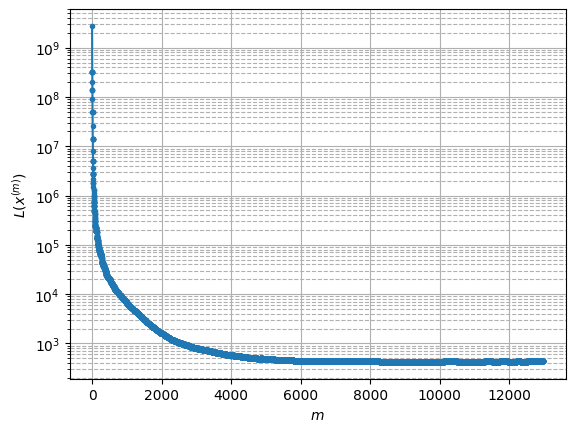

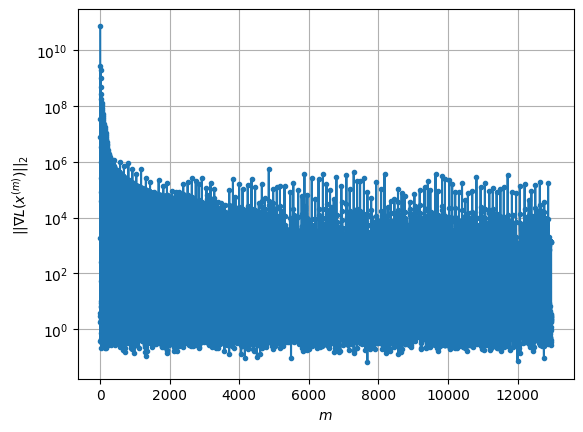

Windows:  39%|███▉      | 116/296 [7:24:54<12:16:44, 245.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.4058890677603
Gradient norm: 207319.49051659295
Global relative error: 0.6935406598014618
Position relative errors: 0.009838411932067949 m, 0.6267782732074304 m, 0.27111477707123754 m, 0.12060979599779759 m

Iteration 1
Cost function: 432.27438198805237 (-0.03%)
Gradient norm: 4.945087088490329 (-100.00%)
Global relative error = 0.6878707656972767 (-0.82%)
Position relative errors: 0.00979458026058315 m, 0.6104465671240594 m, 0.2901718900944326 m, 0.12737592530073535 m

Iteration 2
Cost function: 432.27438118548093 (-0.00%)
Gradient norm: 1.166196980567575 (-76.42%)
Global relative error = 0.6878707636917827 (-0.00%)
Position relative errors: 0.009794577723062999 m, 0.6104465700768672 m, 0.2901718799256666 m, 0.12737592367949746 m

STOP on Iteration 3
Cost function = 432.27438174590446 (0.00%)
Gradient norm = 0.733826875455635 (-37.08%)
Global relative error = 0.6878707617451512 (-0.00%)
Final posit

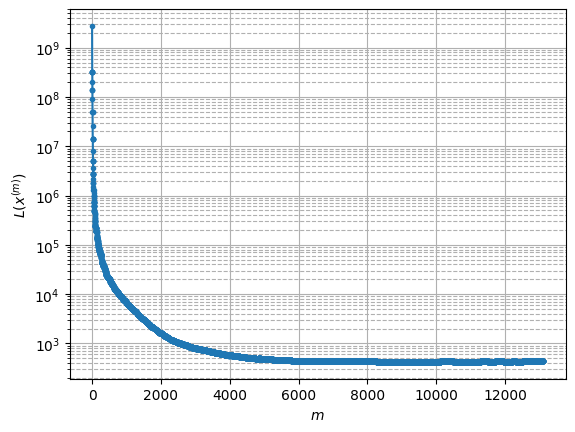

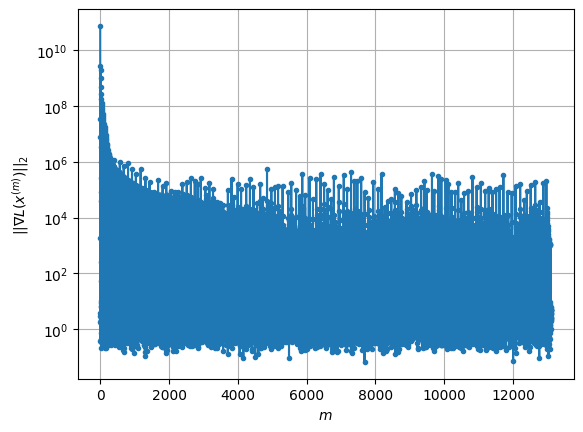

Windows:  40%|███▉      | 117/296 [7:30:07<13:12:47, 265.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.1289061128929
Gradient norm: 116155.67099055574
Global relative error: 0.6880230182572321
Position relative errors: 0.008727471613559508 m, 0.5225666159595252 m, 0.40416253047259565 m, 0.19202988005457494 m

STOP on Iteration 1
Cost function = 432.02415581077736 (-0.02%)
Gradient norm = 0.7650827401717311 (-100.00%)
Global relative error = 0.6759425863551286 (-1.76%)
Final position relative errors: 0.007804250022664508 m, 0.5127672844653759 m, 0.39600486473078855 m, 0.1925786507454765 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 432.0023614376078
Gradient norm: 9806.632483769152
Global relative error: 0.6759425863551286
Position relative errors: 0.007804250022664508 m, 0.5127672844653759 m, 0.39600486473078855 m, 0.1925786507454765 m

Iteration 1
Cost function: 431.99160570670745 (-0.00%)
Gradient norm: 3.647216298927027 (-99.96%)
Global relative error = 0.6

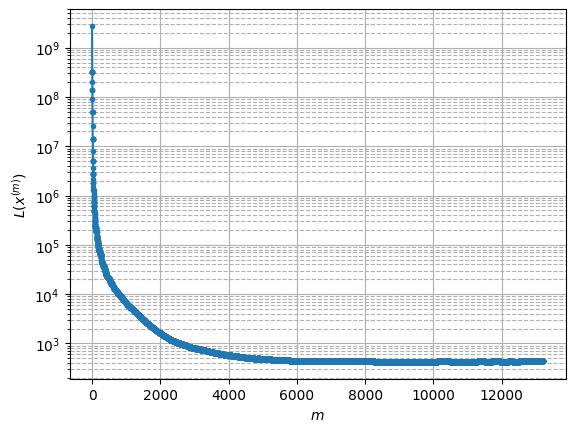

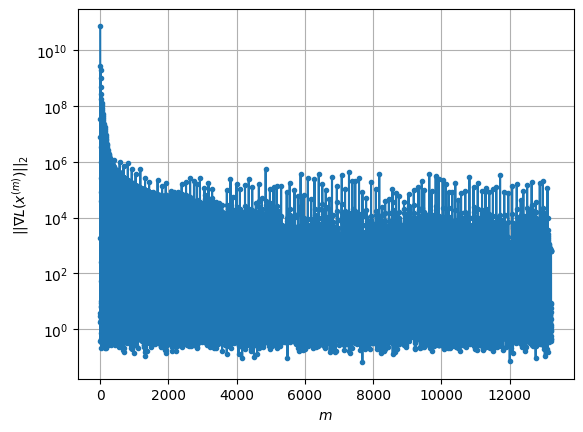

Windows:  40%|███▉      | 118/296 [7:34:08<12:46:42, 258.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.5507241493297
Gradient norm: 159755.32259461252
Global relative error: 0.6770787333815971
Position relative errors: 0.007455246825045166 m, 0.48109369452857176 m, 0.4076543165028244 m, 0.24646733937608506 m

Iteration 1
Cost function: 429.3409644834778 (-0.05%)
Gradient norm: 3.3915458893733024 (-100.00%)
Global relative error = 0.6557149972021417 (-3.16%)
Position relative errors: 0.014267219909363199 m, 0.4738741353561172 m, 0.38109935361756186 m, 0.24487652978269947 m

Iteration 2
Cost function: 429.3409642531211 (-0.00%)
Gradient norm: 4.3676042311559105 (28.78%)
Global relative error = 0.655714998038646 (0.00%)
Position relative errors: 0.014267224306920276 m, 0.4738741368004148 m, 0.3810993539742381 m, 0.24487652841640634 m

STOP on Iteration 3
Cost function = 429.340964750226 (0.00%)
Gradient norm = 0.4355977993389971 (-90.03%)
Global relative error = 0.6557149998107153 (0.00%)
Final position

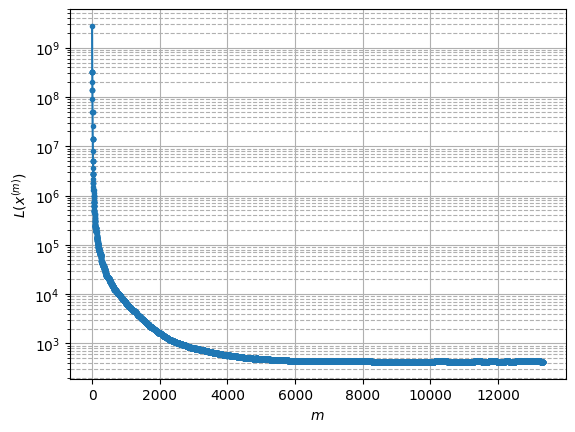

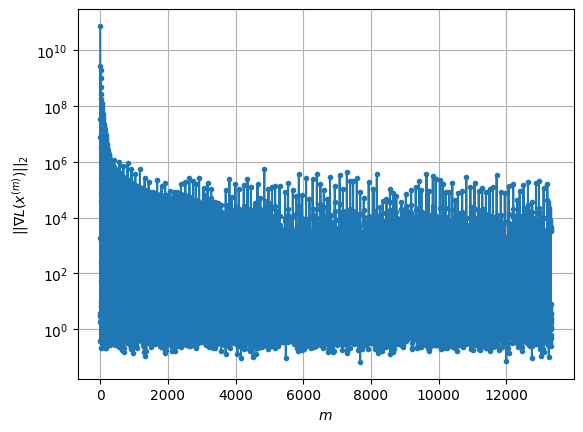

Windows:  40%|████      | 119/296 [7:38:28<12:43:09, 258.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.8366763300331
Gradient norm: 268954.54915541055
Global relative error: 0.5469144952797835
Position relative errors: 0.013787396095199652 m, 0.4180638323379362 m, 0.2710868291191192 m, 0.2250763441442508 m

Iteration 1
Cost function: 430.549645234854 (-0.07%)
Gradient norm: 3.0273577714216757 (-100.00%)
Global relative error = 0.5514451324033376 (0.83%)
Position relative errors: 0.014227342660366174 m, 0.4315963771949963 m, 0.2621293136790349 m, 0.2211368904820179 m

Iteration 2
Cost function: 430.5496457304901 (0.00%)
Gradient norm: 6.281093569336911 (107.48%)
Global relative error = 0.5514451315953818 (-0.00%)
Position relative errors: 0.01422734645330443 m, 0.43159637472296397 m, 0.262129313699964 m, 0.22113689302309927 m

Iteration 3
Cost function: 430.54964575440266 (0.00%)
Gradient norm: 6.333339852056236 (0.83%)
Global relative error = 0.5514451350793372 (0.00%)
Position relative errors: 0.014

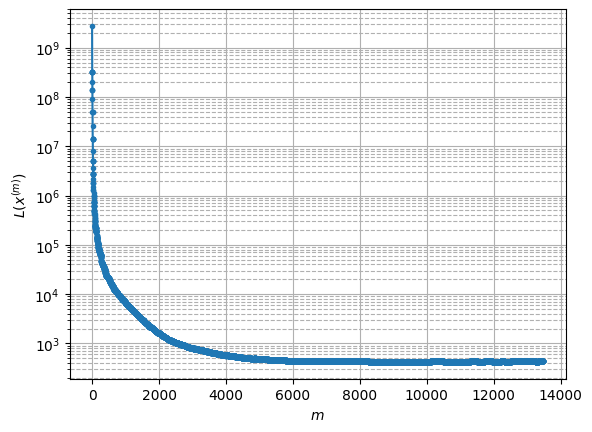

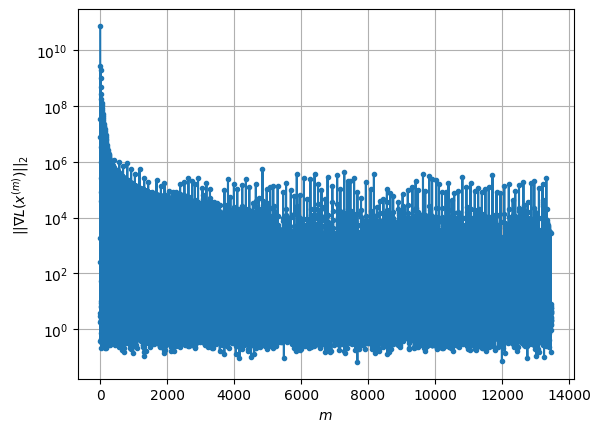

Windows:  41%|████      | 120/296 [7:43:43<13:28:27, 275.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.5720516056772
Gradient norm: 182687.18921624418
Global relative error: 0.49631425414898434
Position relative errors: 0.01455427482935744 m, 0.40445115552095345 m, 0.22864507275245913 m, 0.17394290622463815 m

Iteration 1
Cost function: 429.44662299296095 (-0.03%)
Gradient norm: 5.5886828924996035 (-100.00%)
Global relative error = 0.5016660560330202 (1.08%)
Position relative errors: 0.010657756286075794 m, 0.41319227677502324 m, 0.2265704625929309 m, 0.17173418821986244 m

Iteration 2
Cost function: 429.4466231846216 (0.00%)
Gradient norm: 3.100587932120407 (-44.52%)
Global relative error = 0.5016660582509046 (0.00%)
Position relative errors: 0.010657754573094036 m, 0.4131922798164305 m, 0.22657046170107956 m, 0.17173418866398146 m

Iteration 3
Cost function: 429.44662317165 (-0.00%)
Gradient norm: 2.1306854890662335 (-31.28%)
Global relative error = 0.5016660541453274 (-0.00%)
Position relative err

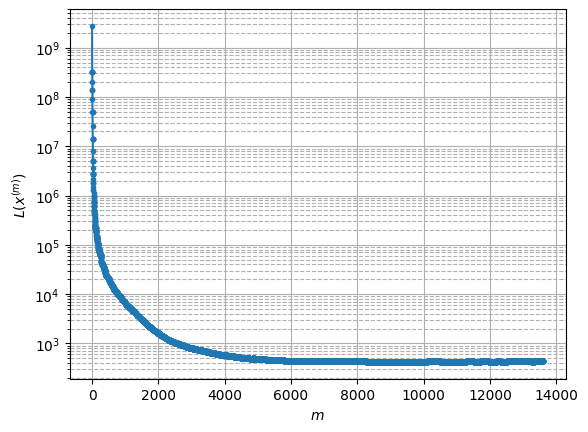

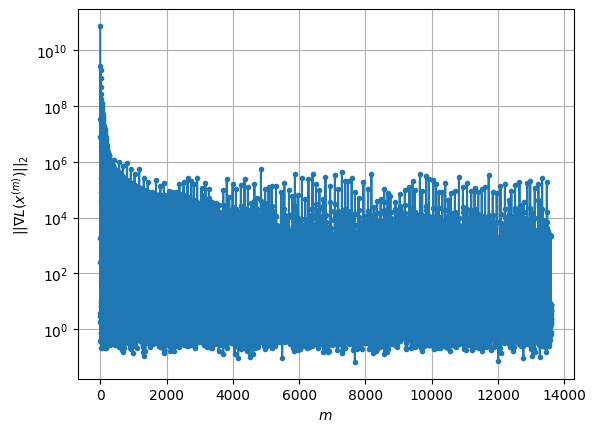

Windows:  41%|████      | 121/296 [7:48:26<13:30:26, 277.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.0779740540138
Gradient norm: 155861.64910808607
Global relative error: 0.5220600440388616
Position relative errors: 0.011227975343347133 m, 0.4549350018430137 m, 0.19638311132264744 m, 0.16397523100367173 m

Iteration 1
Cost function: 428.86492087008844 (-0.05%)
Gradient norm: 1.3725951540738857 (-100.00%)
Global relative error = 0.5167226827973457 (-1.02%)
Position relative errors: 0.0072808855007258436 m, 0.444293822007351 m, 0.19138582043123148 m, 0.1814475921894099 m

Iteration 2
Cost function: 428.86492132817244 (0.00%)
Gradient norm: 1.7332751333859595 (26.28%)
Global relative error = 0.5167226858339806 (0.00%)
Position relative errors: 0.0072808951538542565 m, 0.4442938280248244 m, 0.19138581954346376 m, 0.18144758665168367 m

Iteration 3
Cost function: 428.8649210740239 (-0.00%)
Gradient norm: 2.868974285116167 (65.52%)
Global relative error = 0.5167226918749247 (0.00%)
Position relative err

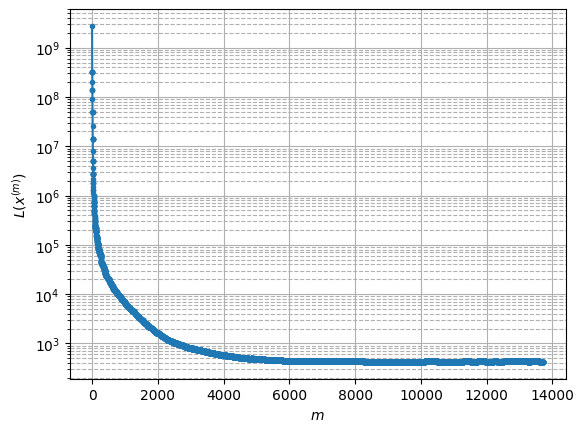

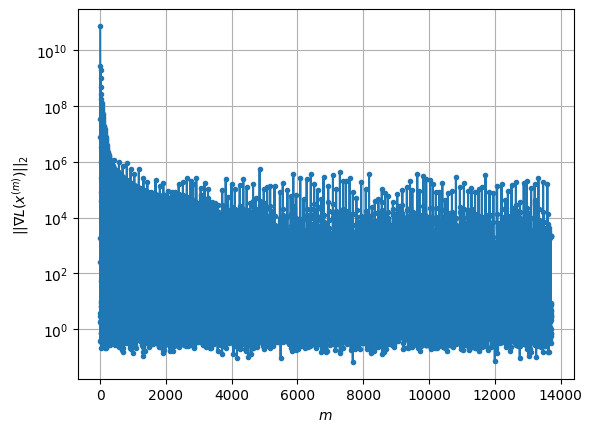

Windows:  41%|████      | 122/296 [7:52:41<13:06:09, 271.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.7713763737151
Gradient norm: 95532.82957306429
Global relative error: 0.5346485040300829
Position relative errors: 0.007688349639328468 m, 0.4647744478794364 m, 0.10958330460035509 m, 0.24034482276854754 m

Iteration 1
Cost function: 428.5832426172259 (-0.04%)
Gradient norm: 4.3689004354721765 (-100.00%)
Global relative error = 0.5194724414967233 (-2.84%)
Position relative errors: 0.004204259597954616 m, 0.4629139121110413 m, 0.09979743663488501 m, 0.21350562963381894 m

STOP on Iteration 2
Cost function = 428.58324247685675 (-0.00%)
Gradient norm = 0.8243872197354929 (-81.13%)
Global relative error = 0.5194724382793451 (-0.00%)
Final position relative errors: 0.004204264178453942 m, 0.46291390847425684 m, 0.09979743364000448 m, 0.21350563100054837 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 428.50741085124616
Gradient norm: 18968.673685453017
Global relati

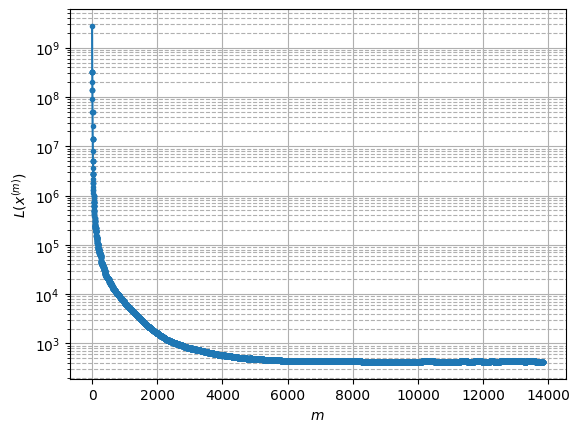

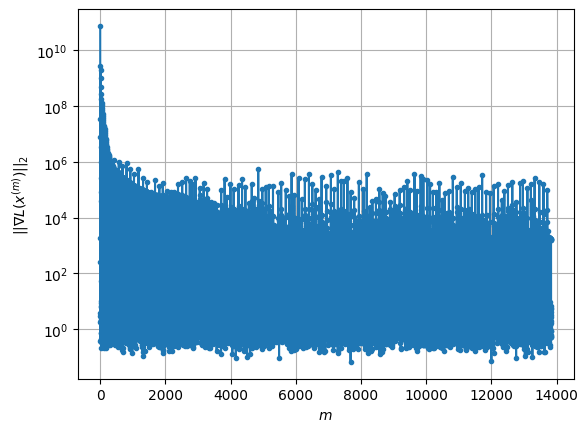

Windows:  42%|████▏     | 123/296 [7:57:15<13:04:02, 271.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 431.51803797263193
Gradient norm: 71384.27717538617
Global relative error: 0.49664790041490864
Position relative errors: 0.004069253882083051 m, 0.4543636083030566 m, 0.10142710862081798 m, 0.17294052953647693 m

Iteration 1
Cost function: 431.29502849070485 (-0.05%)
Gradient norm: 6.052438472064744 (-99.99%)
Global relative error = 0.49466671573224746 (-0.40%)
Position relative errors: 0.01299109675479929 m, 0.4458753922422956 m, 0.0905422970376346 m, 0.1937090938007031 m

STOP on Iteration 2
Cost function = 431.2950277457155 (-0.00%)
Gradient norm = 0.23021470768695432 (-96.20%)
Global relative error = 0.4946667230646998 (0.00%)
Final position relative errors: 0.01299108759210914 m, 0.4458753991676164 m, 0.0905423038852331 m, 0.1937090939985345 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 431.2385035267241
Gradient norm: 16879.92154995618
Global relative error

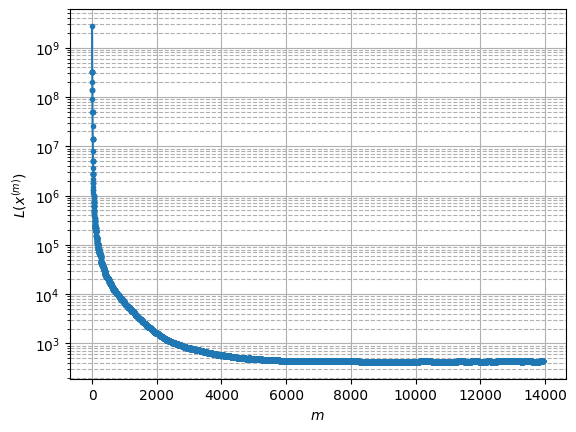

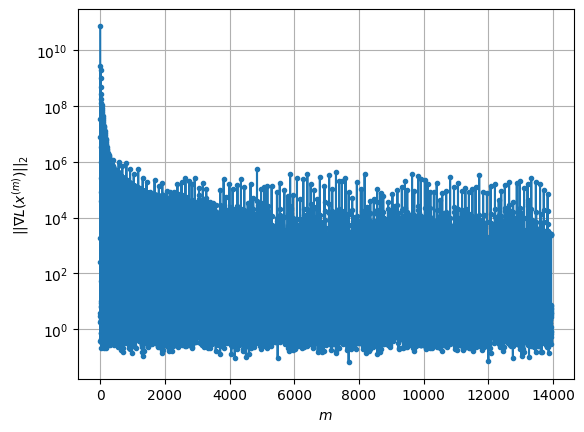

Windows:  42%|████▏     | 124/296 [8:01:25<12:40:29, 265.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 434.8205495720474
Gradient norm: 30600.67872186733
Global relative error: 0.5347509420816562
Position relative errors: 0.013070577024350724 m, 0.47218973822710203 m, 0.04704820810418749 m, 0.24619230270943748 m

Iteration 1
Cost function: 434.74096356802846 (-0.02%)
Gradient norm: 4.924688292657045 (-99.98%)
Global relative error = 0.5481146719890487 (2.50%)
Position relative errors: 0.013786960044212936 m, 0.47800472355505896 m, 0.04515785931227807 m, 0.2640292675541354 m

STOP on Iteration 2
Cost function = 434.740962866922 (-0.00%)
Gradient norm = 0.42579880530883624 (-91.35%)
Global relative error = 0.5481146713785777 (-0.00%)
Final position relative errors: 0.013786958252820737 m, 0.47800472829023277 m, 0.045157853424087006 m, 0.26402925881477435 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 434.7154487559992
Gradient norm: 22736.622352547114
Global relative

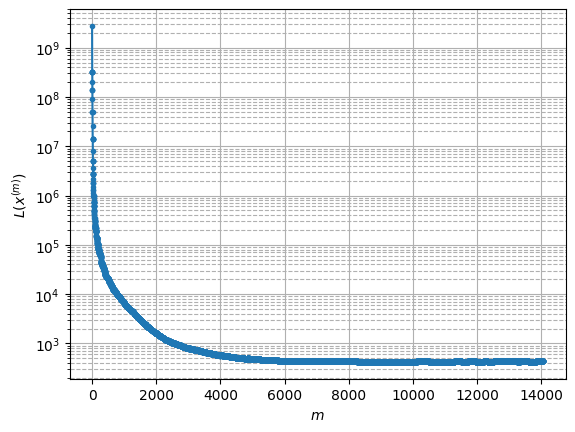

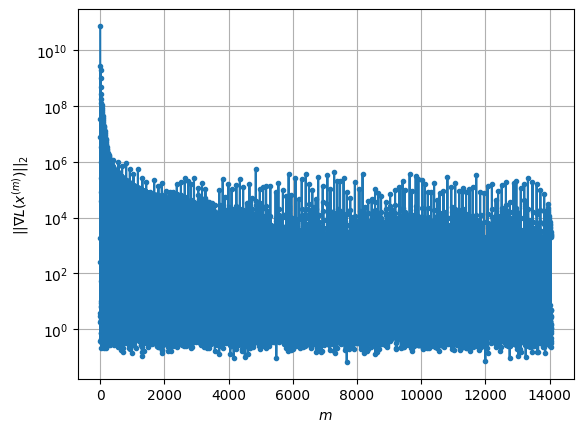

Windows:  42%|████▏     | 125/296 [8:05:27<12:16:13, 258.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.959613119482
Gradient norm: 290393.6571024703
Global relative error: 0.6311716084470966
Position relative errors: 0.014087635177854928 m, 0.5341085726772987 m, 0.09019389501147806 m, 0.32368465115022754 m

Iteration 1
Cost function: 432.78528434028794 (-0.04%)
Gradient norm: 2.38378166054052 (-100.00%)
Global relative error = 0.6580874898835128 (4.26%)
Position relative errors: 0.012427350146546062 m, 0.5611875180743956 m, 0.07259730378698832 m, 0.3357415611350642 m

Iteration 2
Cost function: 432.78528456794714 (0.00%)
Gradient norm: 1.5354306503006365 (-35.59%)
Global relative error = 0.658087503605666 (0.00%)
Position relative errors: 0.012427354356021348 m, 0.5611875307824519 m, 0.07259730498403222 m, 0.33574156637584174 m

STOP on Iteration 3
Cost function = 432.7852844641809 (-0.00%)
Gradient norm = 0.439678880856393 (-71.36%)
Global relative error = 0.6580875077271261 (0.00%)
Final position r

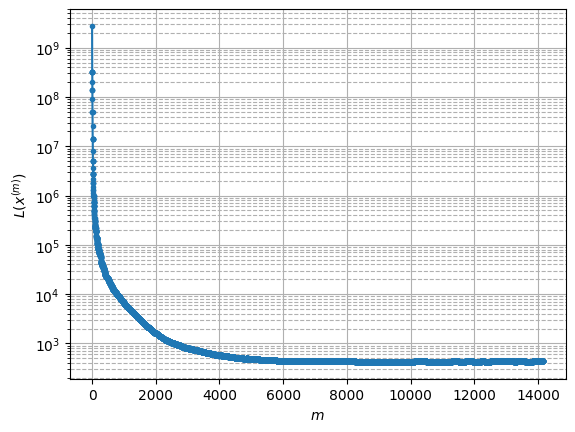

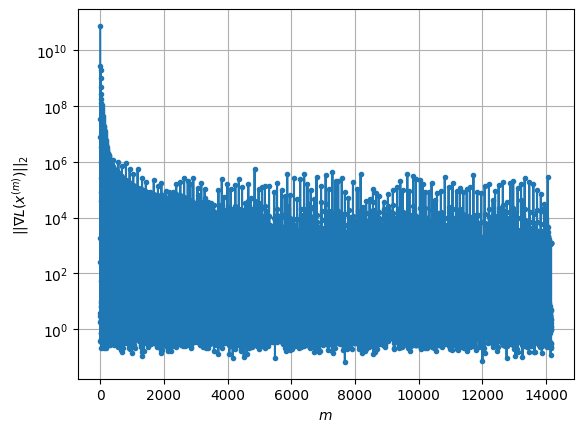

Windows:  43%|████▎     | 126/296 [8:09:31<11:59:47, 254.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 433.88317572520316
Gradient norm: 107825.08361403181
Global relative error: 0.719426192342405
Position relative errors: 0.012568681270785847 m, 0.6161249554758564 m, 0.06314175814274357 m, 0.3658123274195699 m

STOP on Iteration 1
Cost function = 433.67339170456245 (-0.05%)
Gradient norm = 0.503850145559165 (-100.00%)
Global relative error = 0.7387584731172584 (2.69%)
Final position relative errors: 0.013450214523125248 m, 0.617887735365479 m, 0.05263055101617394 m, 0.401282125886894 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 433.58856247842624
Gradient norm: 20469.288767283404
Global relative error: 0.7387584731172584
Position relative errors: 0.013450214523125248 m, 0.617887735365479 m, 0.05263055101617394 m, 0.401282125886894 m

Iteration 1
Cost function: 433.53965539139807 (-0.01%)
Gradient norm: 1.4003267207211973 (-99.99%)
Global relative error = 0.75336

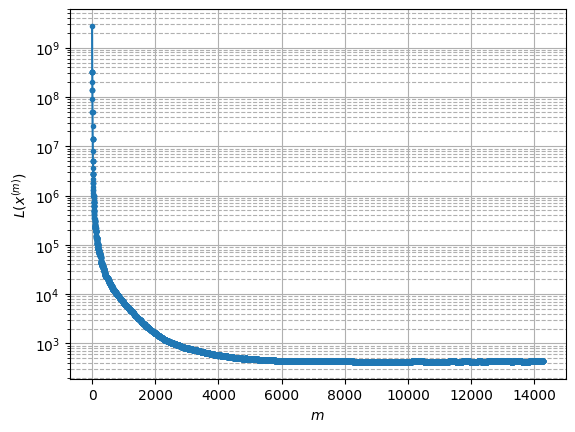

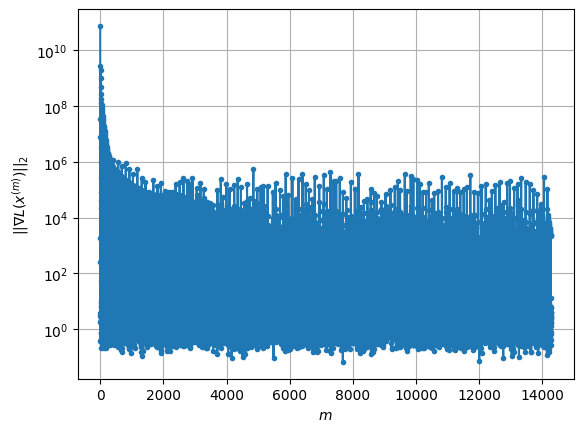

Windows:  43%|████▎     | 127/296 [8:14:11<12:17:08, 261.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 432.803541997833
Gradient norm: 237483.36713209838
Global relative error: 0.7876590173967469
Position relative errors: 0.01346512213853565 m, 0.6502250399837004 m, 0.09533650213832799 m, 0.4339851991525117 m

Iteration 1
Cost function: 432.5573031678998 (-0.06%)
Gradient norm: 3.024727979774315 (-100.00%)
Global relative error = 0.8226432947387456 (4.44%)
Position relative errors: 0.013294764088347242 m, 0.6746408620521751 m, 0.10636211540999983 m, 0.4583790922357665 m

Iteration 2
Cost function: 432.55730307032127 (-0.00%)
Gradient norm: 3.8591236822949924 (27.59%)
Global relative error = 0.8226433223134981 (0.00%)
Position relative errors: 0.013294763307265626 m, 0.6746408911391738 m, 0.10636210570289878 m, 0.4583791011884704 m

Iteration 3
Cost function: 432.55730335093597 (0.00%)
Gradient norm: 1.782076068497867 (-53.82%)
Global relative error = 0.8226433146318396 (-0.00%)
Position relative errors: 

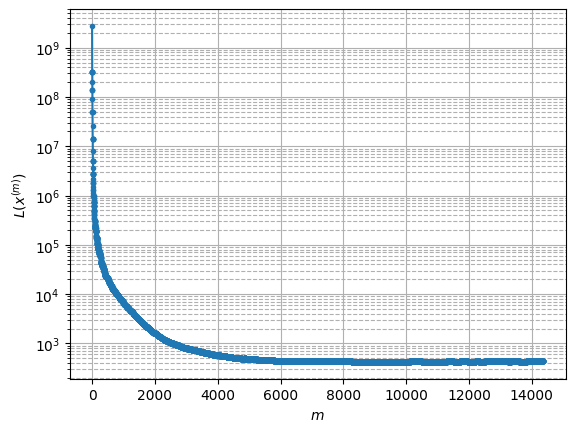

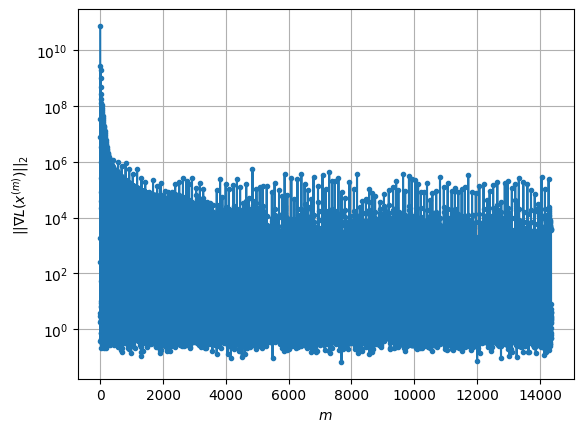

Windows:  43%|████▎     | 128/296 [8:17:06<11:00:09, 235.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.6571236050153
Gradient norm: 166074.3928521593
Global relative error: 0.9647223391290013
Position relative errors: 0.01349174064959484 m, 0.7920933953366092 m, 0.14404119875642385 m, 0.5313629155558017 m

Iteration 1
Cost function: 430.4582792444097 (-0.05%)
Gradient norm: 3.627293362503803 (-100.00%)
Global relative error = 0.9373976940460719 (-2.83%)
Position relative errors: 0.015251846051185125 m, 0.7637333791620394 m, 0.1473728519466709 m, 0.522947072683564 m

Iteration 2
Cost function: 430.45827958017327 (0.00%)
Gradient norm: 1.6441969861211405 (-54.67%)
Global relative error = 0.9373977069541098 (0.00%)
Position relative errors: 0.015251846371939966 m, 0.7637333936408985 m, 0.14737285536657918 m, 0.5229470737029314 m

Iteration 3
Cost function: 430.45827963084963 (0.00%)
Gradient norm: 1.0595720402231545 (-35.56%)
Global relative error = 0.9373977118544586 (0.00%)
Position relative errors: 0

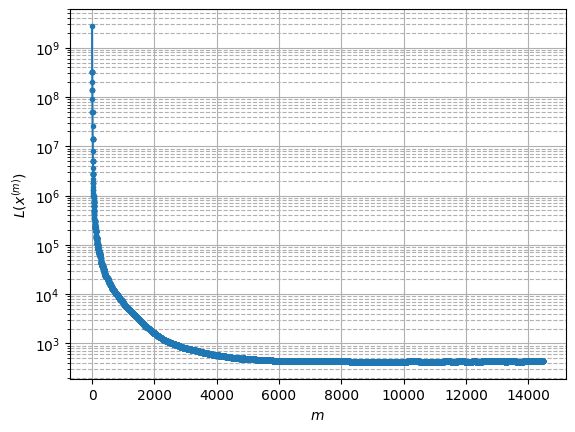

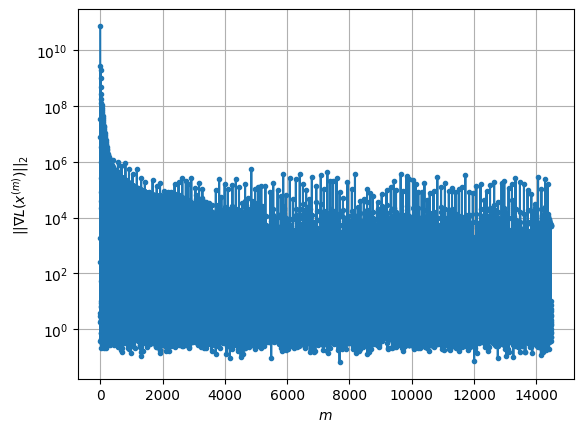

Windows:  44%|████▎     | 129/296 [8:21:28<11:18:04, 243.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 431.2226850663588
Gradient norm: 163013.326895729
Global relative error: 0.9023839368751239
Position relative errors: 0.01408254438965616 m, 0.7168005493346788 m, 0.31258984030522224 m, 0.45009152198174573 m

Iteration 1
Cost function: 431.1091333003629 (-0.03%)
Gradient norm: 2.485533455811655 (-100.00%)
Global relative error = 0.9047318201178841 (0.26%)
Position relative errors: 0.013900397889891686 m, 0.7212311053488378 m, 0.310618156926305 m, 0.4490967238908452 m

Iteration 2
Cost function: 431.1091339483365 (0.00%)
Gradient norm: 1.270014664454601 (-48.90%)
Global relative error = 0.9047318230836646 (0.00%)
Position relative errors: 0.013900402673987821 m, 0.721231108786029 m, 0.3106181543910403 m, 0.4490967259510319 m

Iteration 3
Cost function: 431.10913373304555 (-0.00%)
Gradient norm: 1.168023474753868 (-8.03%)
Global relative error = 0.9047318288931095 (0.00%)
Position relative errors: 0.01390

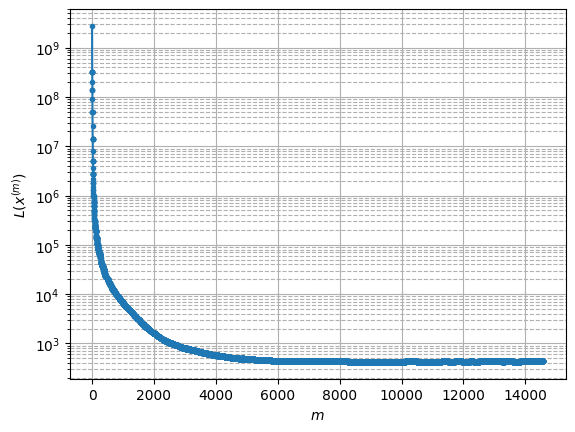

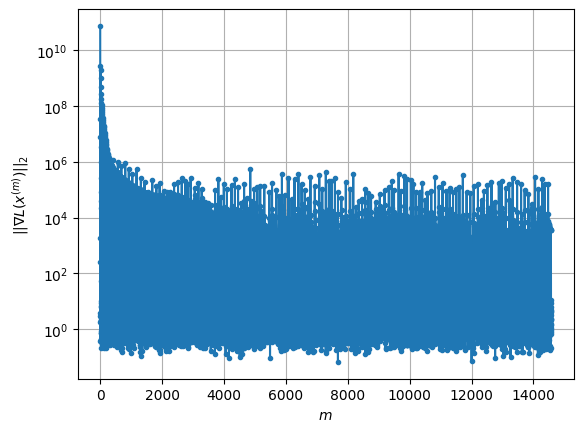

Windows:  44%|████▍     | 130/296 [8:25:17<11:02:09, 239.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 436.3975028379343
Gradient norm: 354245.7713720496
Global relative error: 0.9934390965051748
Position relative errors: 0.014043188719921615 m, 0.7746417068038293 m, 0.41751553655150864 m, 0.4607974215923291 m

STOP on Iteration 1
Cost function = 436.02506965225155 (-0.09%)
Gradient norm = 0.5359740432138874 (-100.00%)
Global relative error = 1.0048347633930945 (1.15%)
Final position relative errors: 0.012574815899176061 m, 0.7957508021290068 m, 0.42096962157726825 m, 0.4462053643284235 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 435.940361241005
Gradient norm: 24863.00009096523
Global relative error: 1.0048347633930945
Position relative errors: 0.012574815899176061 m, 0.7957508021290068 m, 0.42096962157726825 m, 0.4462053643284235 m

STOP on Iteration 1
Cost function = 435.8870430770022 (-0.01%)
Gradient norm = 0.4971600347945468 (-100.00%)
Global relative erro

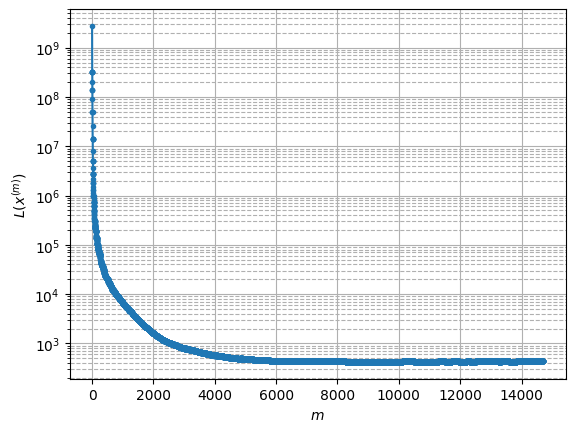

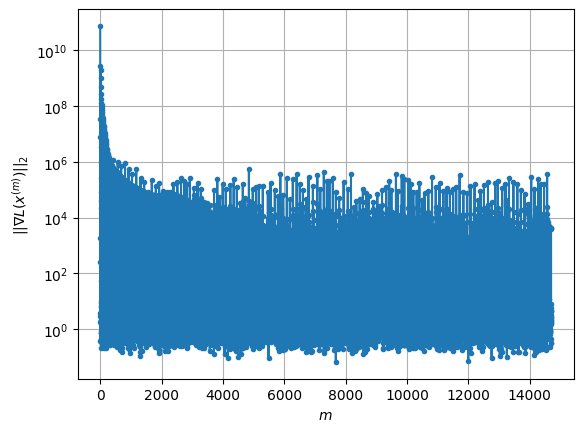

Windows:  44%|████▍     | 131/296 [8:30:15<11:46:34, 256.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 433.87229321381926
Gradient norm: 143248.33989542106
Global relative error: 1.1583265702023406
Position relative errors: 0.012785392615832853 m, 0.9182189641302217 m, 0.5561150187957489 m, 0.43493208399388167 m

Iteration 1
Cost function: 433.7825400784204 (-0.02%)
Gradient norm: 1.3304934055646889 (-100.00%)
Global relative error = 1.1756891010465038 (1.50%)
Position relative errors: 0.01427807419059286 m, 0.9403473984023134 m, 0.5601514410841818 m, 0.428972046380625 m

Iteration 2
Cost function: 433.78254048990055 (0.00%)
Gradient norm: 1.271871987928885 (-4.41%)
Global relative error = 1.175689107415116 (0.00%)
Position relative errors: 0.014278075310321499 m, 0.9403474052600725 m, 0.5601514411861168 m, 0.428972048631918 m

Iteration 3
Cost function: 433.7825406807446 (0.00%)
Gradient norm: 2.543060751299685 (99.95%)
Global relative error = 1.1756891118443291 (0.00%)
Position relative errors: 0.01427

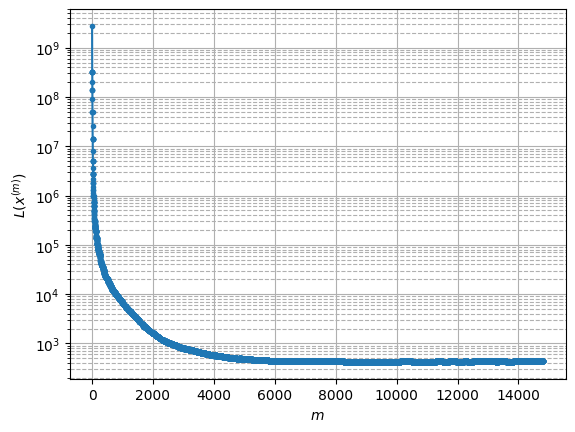

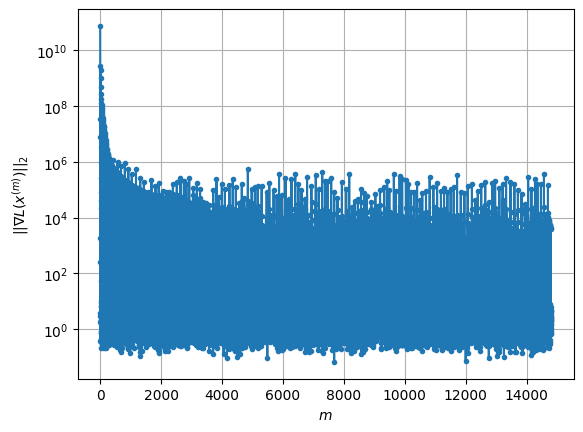

Windows:  45%|████▍     | 132/296 [8:34:21<11:33:12, 253.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 435.4540524628782
Gradient norm: 162840.92431819288
Global relative error: 1.2904027260392192
Position relative errors: 0.014474096918184645 m, 1.031148155474564 m, 0.6562112420549713 m, 0.4135800959198938 m

STOP on Iteration 1
Cost function = 435.2223483734264 (-0.05%)
Gradient norm = 0.5396769779788105 (-100.00%)
Global relative error = 1.2944866392415963 (0.32%)
Final position relative errors: 0.0159515285366288 m, 1.0407684265586976 m, 0.6597163148355236 m, 0.3962514169048567 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 435.1622929294094
Gradient norm: 16600.162444018395
Global relative error: 1.2944866392415963
Position relative errors: 0.0159515285366288 m, 1.0407684265586976 m, 0.6597163148355236 m, 0.3962514169048567 m

Iteration 1
Cost function: 435.1307628329655 (-0.01%)
Gradient norm: 1.6190517234402122 (-99.99%)
Global relative error = 1.29693038851

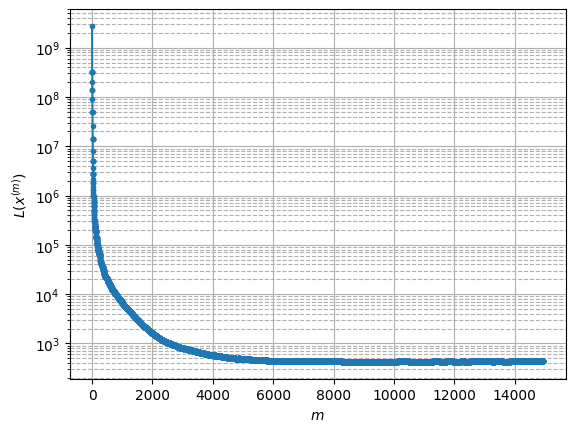

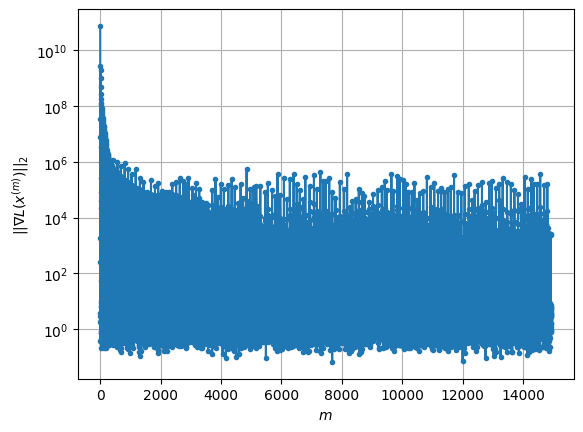

Windows:  45%|████▍     | 133/296 [8:39:08<11:56:13, 263.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 443.4147786410655
Gradient norm: 294526.37283775565
Global relative error: 1.3175860620528128
Position relative errors: 0.01575225522240527 m, 1.0625017112780586 m, 0.7105767537029991 m, 0.31930224906615584 m

Iteration 1
Cost function: 443.0489503407689 (-0.08%)
Gradient norm: 6.520699104963718 (-100.00%)
Global relative error = 1.3207489003314403 (0.24%)
Position relative errors: 0.020928953692439557 m, 1.0842623294298404 m, 0.6917462212113826 m, 0.2996668306104806 m

Iteration 2
Cost function: 443.0489505465957 (0.00%)
Gradient norm: 1.5295252477091543 (-76.54%)
Global relative error = 1.3207489166231323 (0.00%)
Position relative errors: 0.020928953301930082 m, 1.0842623375339844 m, 0.6917462363753621 m, 0.2996668381146634 m

Iteration 3
Cost function: 443.048950639983 (0.00%)
Gradient norm: 3.964478561597753 (159.20%)
Global relative error = 1.3207489126966796 (-0.00%)
Position relative errors: 0.02

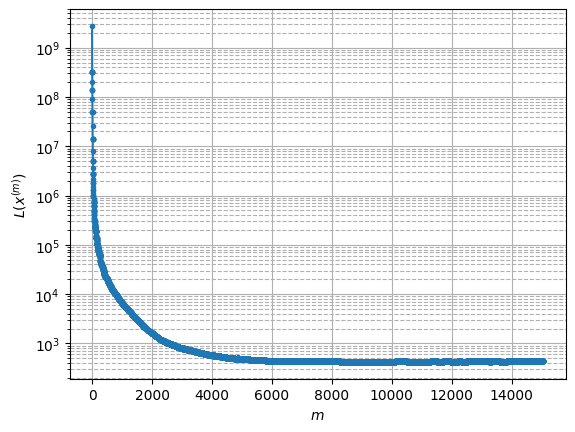

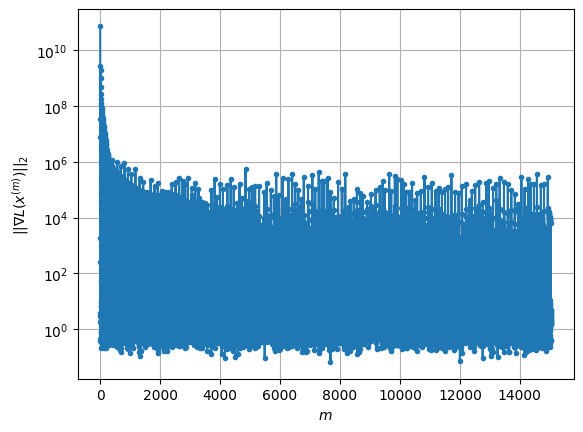

Windows:  45%|████▌     | 134/296 [8:43:22<11:44:22, 260.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 435.11923990086075
Gradient norm: 98942.74456899786
Global relative error: 1.2659015283525832
Position relative errors: 0.020400906989636137 m, 1.1429399804055866 m, 0.46307782479679027 m, 0.28519353748843135 m

Iteration 1
Cost function: 434.87216998815614 (-0.06%)
Gradient norm: 1.0353310714261525 (-100.00%)
Global relative error = 1.2393749542367642 (-2.10%)
Position relative errors: 0.020201574476704422 m, 1.1108903301034838 m, 0.4559641221876236 m, 0.3060381851580245 m

Iteration 2
Cost function: 434.8721694131567 (-0.00%)
Gradient norm: 1.2530194002666117 (21.03%)
Global relative error = 1.2393749830352372 (0.00%)
Position relative errors: 0.02020157532192051 m, 1.1108903586940628 m, 0.45596413427175864 m, 0.3060381799432363 m

Iteration 3
Cost function: 434.87217000759614 (0.00%)
Gradient norm: 2.5771862549426565 (105.68%)
Global relative error = 1.2393749863957775 (0.00%)
Position relative error

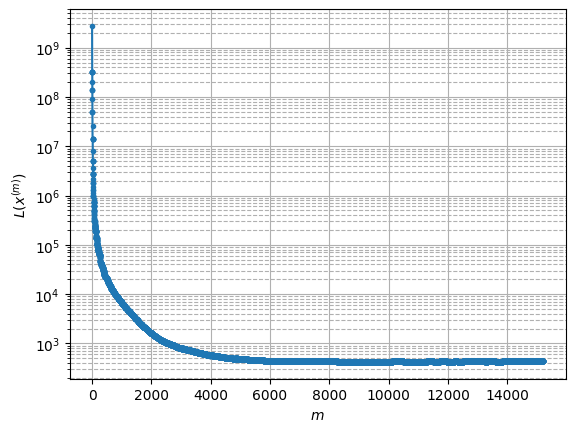

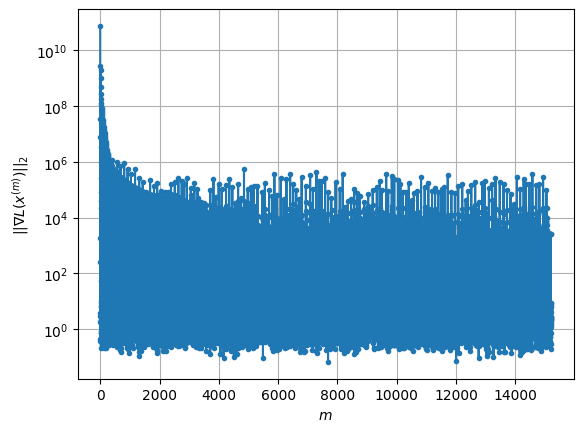

Windows:  46%|████▌     | 135/296 [8:49:35<13:09:40, 294.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 438.31964266022914
Gradient norm: 125378.51108974175
Global relative error: 1.0990753437719862
Position relative errors: 0.019761647912001794 m, 1.0214191558179058 m, 0.322734340450072 m, 0.2451922367535774 m

Iteration 1
Cost function: 438.18905379088955 (-0.03%)
Gradient norm: 3.899442652944272 (-100.00%)
Global relative error = 1.083296437191198 (-1.44%)
Position relative errors: 0.019957858628624963 m, 1.0060584447908212 m, 0.32276134097475156 m, 0.2383319178570503 m

Iteration 2
Cost function: 438.18905395894444 (0.00%)
Gradient norm: 5.788696953010962 (48.45%)
Global relative error = 1.0832964505228555 (0.00%)
Position relative errors: 0.019957861048417406 m, 1.0060584549691027 m, 0.32276134662117933 m, 0.23833192763932948 m

STOP on Iteration 3
Cost function = 438.1890536914378 (-0.00%)
Gradient norm = 0.21337565508925127 (-96.31%)
Global relative error = 1.08329644658456 (-0.00%)
Final position 

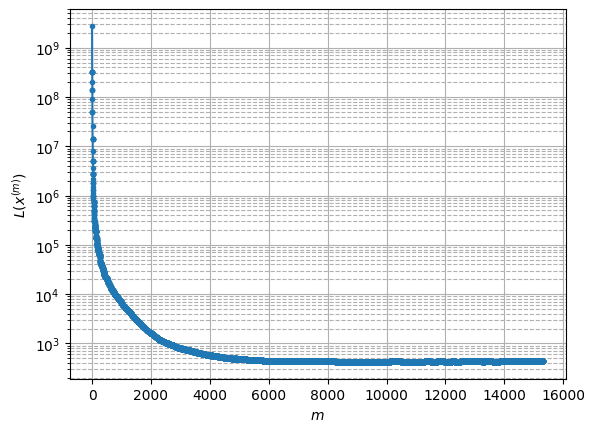

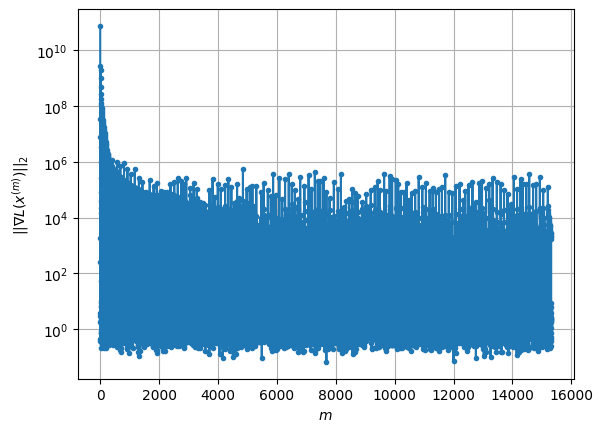

Windows:  46%|████▌     | 136/296 [8:53:41<12:26:37, 279.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 435.6787421018696
Gradient norm: 50178.3661447013
Global relative error: 0.9637515949964276
Position relative errors: 0.0199772653591334 m, 0.8958696797327874 m, 0.32609076531549286 m, 0.13963521001863413 m

Iteration 1
Cost function: 435.5574624051456 (-0.03%)
Gradient norm: 5.532567712932414 (-99.99%)
Global relative error = 0.9543242234055157 (-0.98%)
Position relative errors: 0.017595141503608348 m, 0.8869684365441077 m, 0.3264180019610127 m, 0.1310001601292077 m

STOP on Iteration 2
Cost function = 435.55746253413827 (0.00%)
Gradient norm = 0.22362740362175784 (-95.96%)
Global relative error = 0.9543242303461209 (0.00%)
Final position relative errors: 0.017595144311658747 m, 0.8869684411661306 m, 0.32641800360856016 m, 0.13100017491387153 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 435.5103338474569
Gradient norm: 17038.791945724024
Global relative error: 

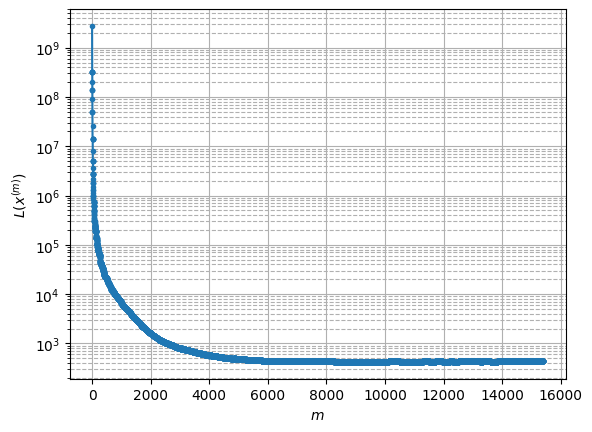

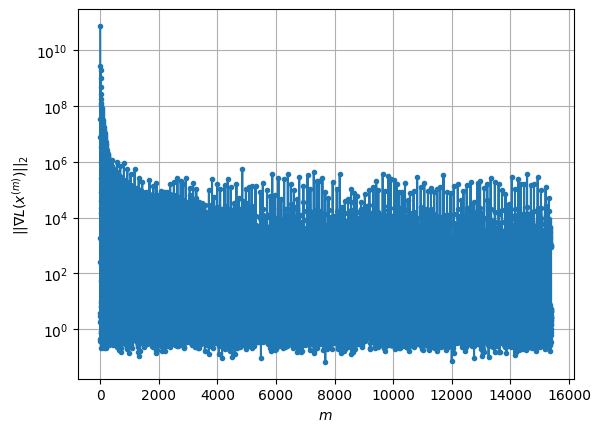

Windows:  46%|████▋     | 137/296 [8:56:32<10:54:50, 247.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 435.28907539895414
Gradient norm: 316711.47571205505
Global relative error: 0.8059304508921192
Position relative errors: 0.017874318975191632 m, 0.7304095247530651 m, 0.3343770561972865 m, 0.062416373459316006 m

Iteration 1
Cost function: 434.96250546383834 (-0.08%)
Gradient norm: 4.371054320594247 (-100.00%)
Global relative error = 0.7993103737177444 (-0.82%)
Position relative errors: 0.030203117443807402 m, 0.7190989630558551 m, 0.3430830195356504 m, 0.056329934536225416 m

Iteration 2
Cost function: 434.9625048572279 (-0.00%)
Gradient norm: 4.726216855825873 (8.13%)
Global relative error = 0.7993103754727855 (0.00%)
Position relative errors: 0.03020311190334431 m, 0.7190989645967315 m, 0.34308302205150704 m, 0.05632992741693723 m

STOP on Iteration 3
Cost function = 434.962504894425 (0.00%)
Gradient norm = 0.8036423434586369 (-83.00%)
Global relative error = 0.7993103770282849 (0.00%)
Final position

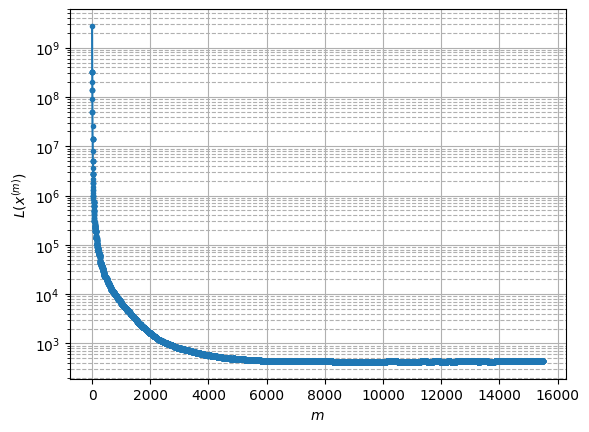

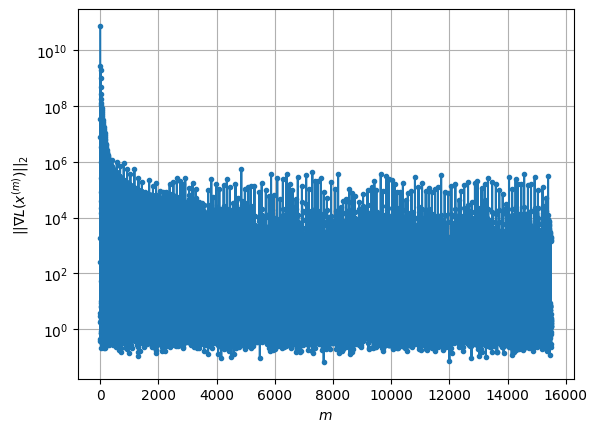

Windows:  47%|████▋     | 138/296 [9:00:32<10:45:38, 245.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 436.2823176597609
Gradient norm: 144564.47843235044
Global relative error: 0.7206510102029456
Position relative errors: 0.031132090231011218 m, 0.579392720148905 m, 0.40336790611803586 m, 0.14129527721213783 m

Iteration 1
Cost function: 436.082658282593 (-0.05%)
Gradient norm: 2.068709329279198 (-100.00%)
Global relative error = 0.7124144582414201 (-1.14%)
Position relative errors: 0.02685601522433095 m, 0.5782135883017006 m, 0.3788609965759697 m, 0.17012875300211278 m

STOP on Iteration 2
Cost function = 436.0826585169073 (0.00%)
Gradient norm = 0.19480210750749483 (-90.58%)
Global relative error = 0.7124144568905031 (-0.00%)
Final position relative errors: 0.026856017097513844 m, 0.5782135881101994 m, 0.378860994446143 m, 0.1701287524432738 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 436.0126786704298
Gradient norm: 15952.769220200984
Global relative error: 

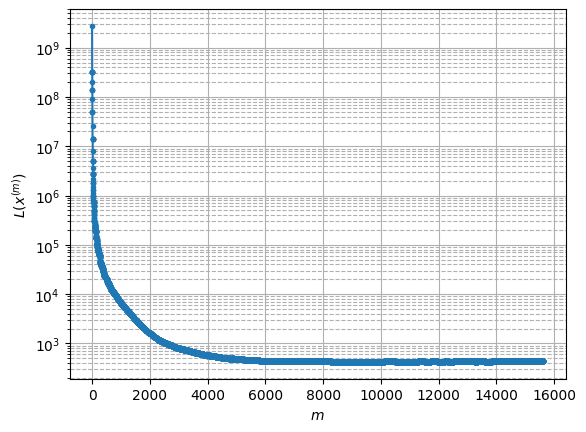

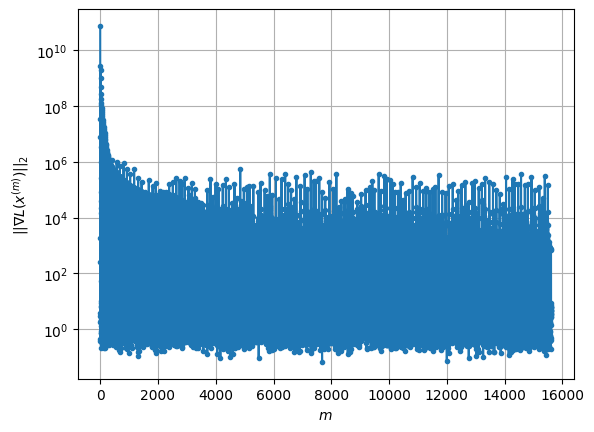

Windows:  47%|████▋     | 139/296 [9:04:46<10:47:56, 247.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 439.25814326096526
Gradient norm: 58097.540999584766
Global relative error: 0.6640074500855685
Position relative errors: 0.02616277208564029 m, 0.4816874152551549 m, 0.36912768190932166 m, 0.26821735002035985 m

Iteration 1
Cost function: 439.1571348866893 (-0.02%)
Gradient norm: 1.9258313145348867 (-100.00%)
Global relative error = 0.6661352995314022 (0.32%)
Position relative errors: 0.03184727520032505 m, 0.4813671062869489 m, 0.362429898602619 m, 0.28222228517653614 m

Iteration 2
Cost function: 439.15713404435934 (-0.00%)
Gradient norm: 3.015179124128364 (56.57%)
Global relative error = 0.6661352963485901 (-0.00%)
Position relative errors: 0.03184727661074283 m, 0.48136710601500154 m, 0.36242989572474366 m, 0.28222228166455926 m

Iteration 3
Cost function: 439.15713476474997 (0.00%)
Gradient norm: 2.6958559059790357 (-10.59%)
Global relative error = 0.6661352952222819 (-0.00%)
Position relative erro

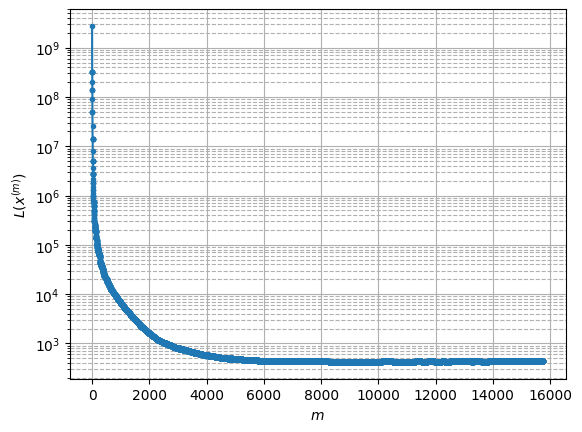

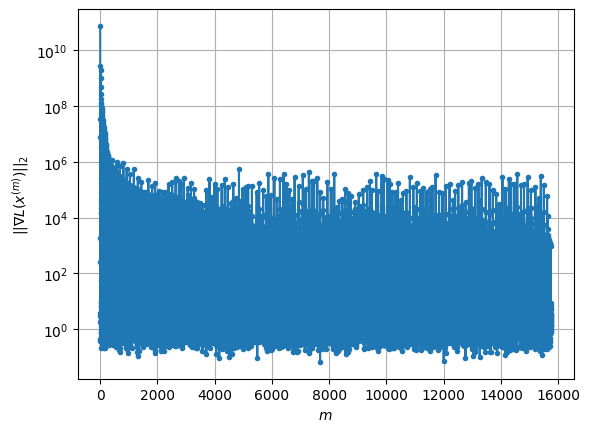

Windows:  47%|████▋     | 140/296 [9:10:13<11:45:42, 271.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 437.52691393796886
Gradient norm: 244288.50085770627
Global relative error: 0.6465617870734216
Position relative errors: 0.030944683837890456 m, 0.38127447965929123 m, 0.36855925320507615 m, 0.3686129391014095 m

STOP on Iteration 1
Cost function = 437.2750900742595 (-0.06%)
Gradient norm = 0.6216369164002654 (-100.00%)
Global relative error = 0.6518584081867292 (0.82%)
Final position relative errors: 0.021417948844535066 m, 0.3773379114748696 m, 0.3884685029692805 m, 0.36216854031189133 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 437.2283561137502
Gradient norm: 8519.609560725306
Global relative error: 0.6518584081867292
Position relative errors: 0.021417948844535066 m, 0.3773379114748696 m, 0.3884685029692805 m, 0.36216854031189133 m

Iteration 1
Cost function: 437.2053667676221 (-0.01%)
Gradient norm: 3.2722350225701544 (-99.96%)
Global relative error = 0.65

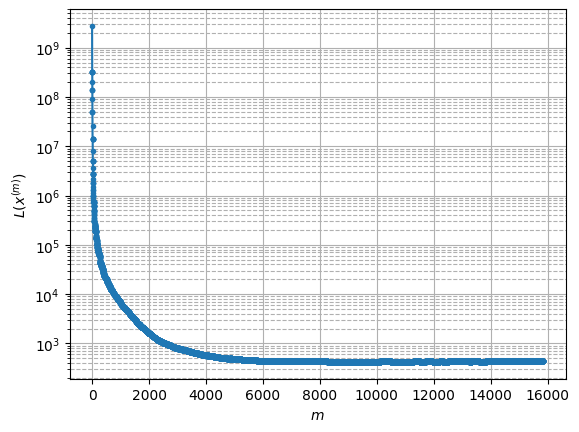

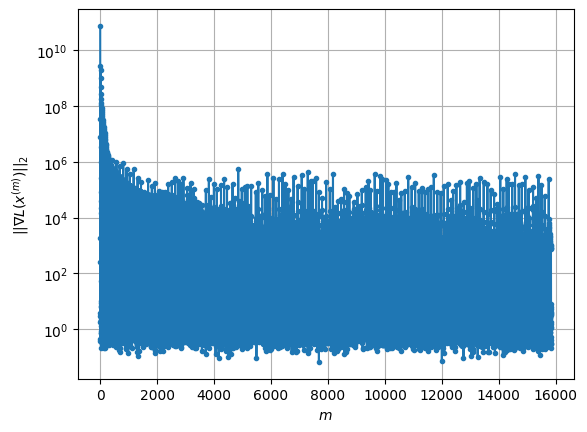

Windows:  48%|████▊     | 141/296 [9:13:24<10:39:20, 247.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 436.67009072310793
Gradient norm: 148324.2329592865
Global relative error: 0.6045214984457181
Position relative errors: 0.01999136346388899 m, 0.24892667910545718 m, 0.38131049246675913 m, 0.3970913214071869 m

STOP on Iteration 1
Cost function = 436.4696053010401 (-0.05%)
Gradient norm = 0.7780904349448117 (-100.00%)
Global relative error = 0.5983157120898414 (-1.03%)
Final position relative errors: 0.023868269104252264 m, 0.24530478761170915 m, 0.3530789277986032 m, 0.4154153997351368 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 436.4060470671382
Gradient norm: 14181.238048711659
Global relative error: 0.5983157120898414
Position relative errors: 0.023868269104252264 m, 0.24530478761170915 m, 0.3530789277986032 m, 0.4154153997351368 m

Iteration 1
Cost function: 436.3768307410572 (-0.01%)
Gradient norm: 3.5190444615912178 (-99.98%)
Global relative error = 0.59

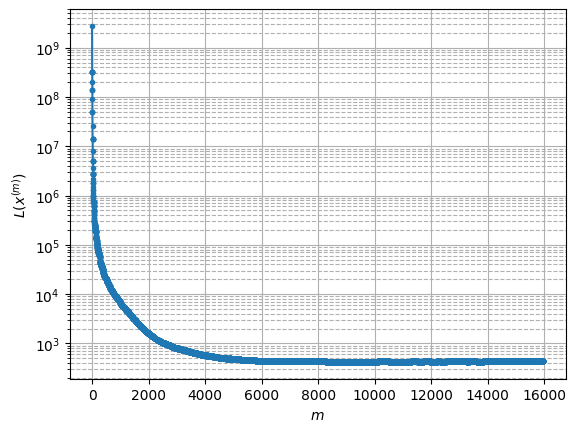

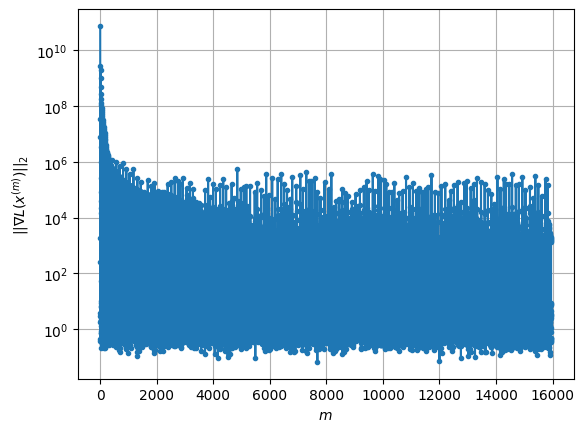

Windows:  48%|████▊     | 142/296 [9:17:32<10:35:43, 247.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 428.41071745244
Gradient norm: 74646.392168527
Global relative error: 0.6121783070154707
Position relative errors: 0.0226404693016817 m, 0.11410187436331926 m, 0.3214353619240414 m, 0.5078454344560936 m

Iteration 1
Cost function: 427.92702060078176 (-0.11%)
Gradient norm: 4.869794719474587 (-99.99%)
Global relative error = 0.6117377699203054 (-0.07%)
Position relative errors: 0.04576891234469641 m, 0.12696287329173003 m, 0.32882019854635247 m, 0.4978787492749235 m

STOP on Iteration 2
Cost function = 427.9270197962153 (-0.00%)
Gradient norm = 0.17583652998820182 (-96.39%)
Global relative error = 0.6117377745628763 (0.00%)
Final position relative errors: 0.0457689228988299 m, 0.12696289992122134 m, 0.32882019628087983 m, 0.4978787487144686 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 427.8766704284328
Gradient norm: 3441.4441692232085
Global relative error: 0.61

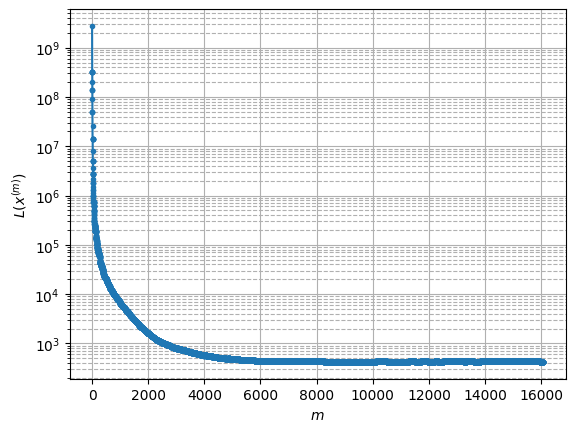

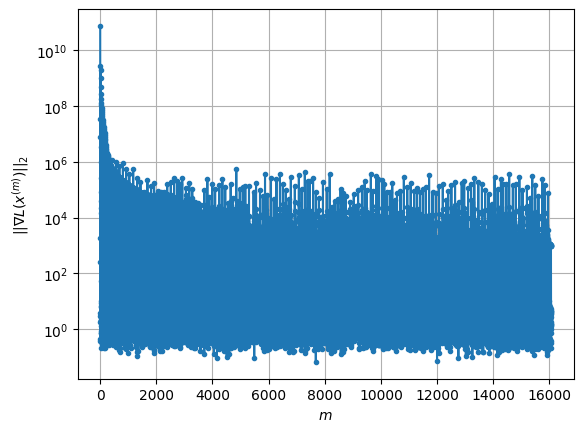

Windows:  48%|████▊     | 143/296 [9:21:43<10:33:34, 248.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 426.0329196562849
Gradient norm: 216856.91679367857
Global relative error: 0.6537077864704596
Position relative errors: 0.04224050753303099 m, 0.194148394851761 m, 0.3140455787291965 m, 0.5377999747742528 m

Iteration 1
Cost function: 425.8315096869024 (-0.05%)
Gradient norm: 1.196387851164999 (-100.00%)
Global relative error = 0.675220431966773 (3.29%)
Position relative errors: 0.03901040354756886 m, 0.22771111589826043 m, 0.32339525008962483 m, 0.5458583917271227 m

STOP on Iteration 2
Cost function = 425.83150965982793 (-0.00%)
Gradient norm = 0.6703076432009396 (-43.97%)
Global relative error = 0.6752204342602351 (0.00%)
Final position relative errors: 0.039010408424285214 m, 0.2277111321612122 m, 0.32339524447902523 m, 0.5458583907553263 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 425.76646247209726
Gradient norm: 7077.851876516964
Global relative error: 0

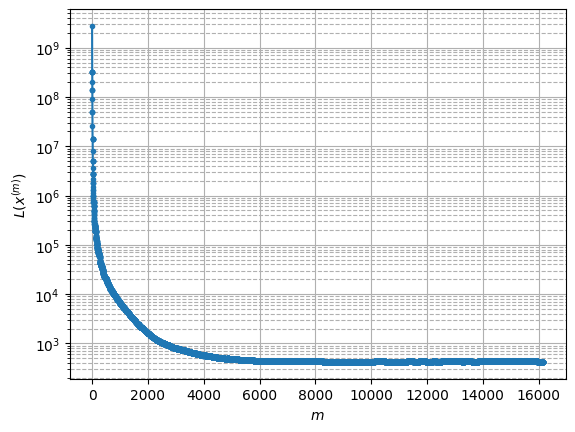

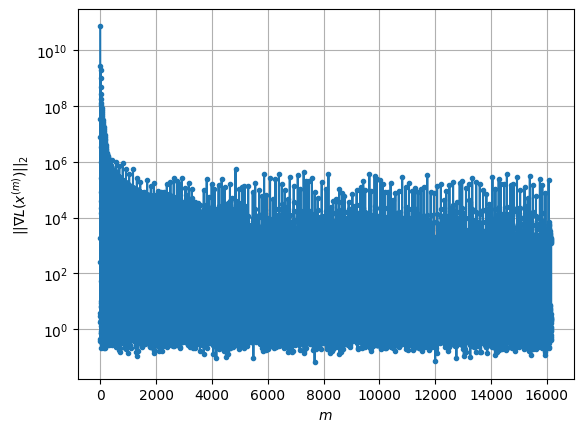

Windows:  49%|████▊     | 144/296 [9:25:03<9:52:42, 233.96s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 423.79409553972505
Gradient norm: 73040.33488027363
Global relative error: 0.7680987868133992
Position relative errors: 0.03905761322464878 m, 0.24451953943805743 m, 0.3474804958877832 m, 0.6386824874077229 m

Iteration 1
Cost function: 423.6226623367953 (-0.04%)
Gradient norm: 1.7651276793915938 (-100.00%)
Global relative error = 0.7526495160585338 (-2.01%)
Position relative errors: 0.039044636417226455 m, 0.1948273640200987 m, 0.3450947404568304 m, 0.6386754514451438 m

Iteration 2
Cost function: 423.62266210697953 (-0.00%)
Gradient norm: 2.287538339124278 (29.60%)
Global relative error = 0.7526495333974735 (0.00%)
Position relative errors: 0.03904464985054684 m, 0.1948274100408343 m, 0.34509474422157416 m, 0.638675454984249 m

STOP on Iteration 3
Cost function = 423.6226616295305 (-0.00%)
Gradient norm = 0.7388558655573143 (-67.70%)
Global relative error = 0.7526495334737244 (0.00%)
Final position re

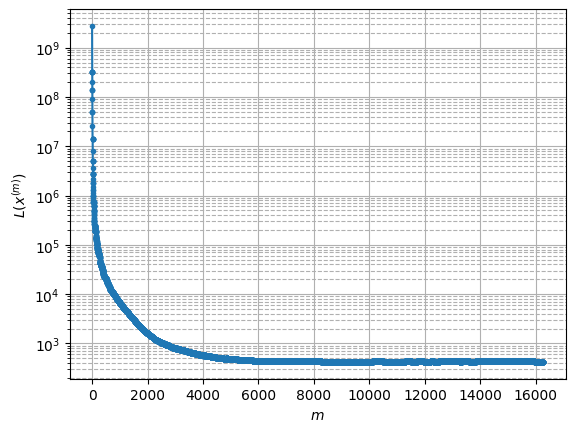

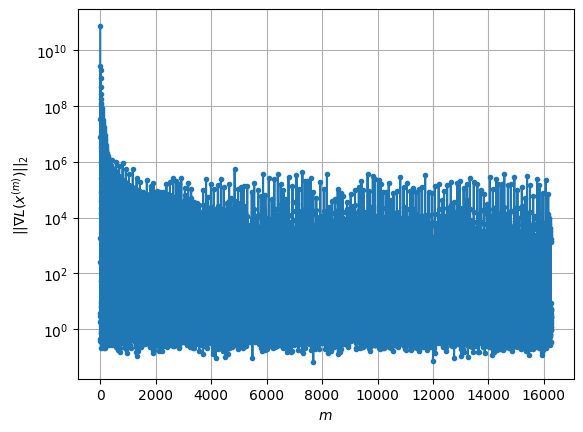

Windows:  49%|████▉     | 145/296 [9:29:00<9:51:29, 235.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 425.3016239629269
Gradient norm: 49510.96084886204
Global relative error: 0.8636805621436899
Position relative errors: 0.039759609105230485 m, 0.26611895107982153 m, 0.3958583401086348 m, 0.7189143673594952 m

Iteration 1
Cost function: 425.13632719343485 (-0.04%)
Gradient norm: 5.108754596554683 (-99.99%)
Global relative error = 0.8493127062511749 (-1.66%)
Position relative errors: 0.03637081861537404 m, 0.2753957069799725 m, 0.3675800221196709 m, 0.7134767750943374 m

Iteration 2
Cost function: 425.13632718110273 (-0.00%)
Gradient norm: 4.260909020267208 (-16.60%)
Global relative error = 0.8493126999947779 (-0.00%)
Position relative errors: 0.03637082338893581 m, 0.2753956983619629 m, 0.3675800177799286 m, 0.7134767729657701 m

Iteration 3
Cost function: 425.13632752906926 (0.00%)
Gradient norm: 1.5973207355253412 (-62.51%)
Global relative error = 0.8493127059883971 (0.00%)
Position relative errors: 0

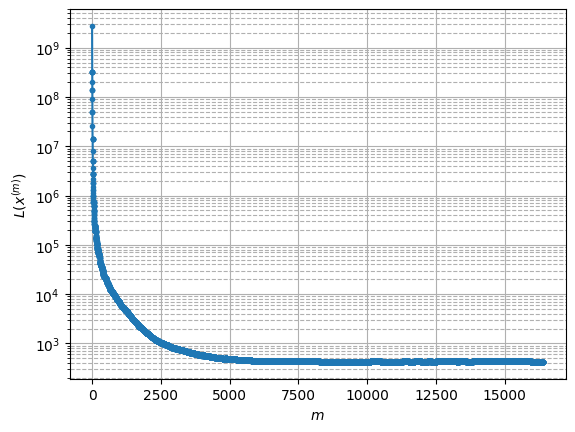

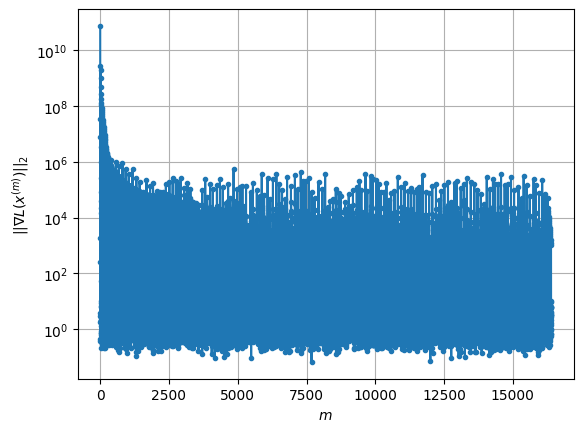

Windows:  49%|████▉     | 146/296 [9:33:59<10:34:57, 253.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 429.8192563459552
Gradient norm: 97667.72263371204
Global relative error: 0.8729570394591288
Position relative errors: 0.03408638130895073 m, 0.36856911872976134 m, 0.3210869626881066 m, 0.7224611067531733 m

Iteration 1
Cost function: 429.4463878313765 (-0.09%)
Gradient norm: 4.306564825587663 (-100.00%)
Global relative error = 0.8732568804737207 (0.03%)
Position relative errors: 0.041112498521290834 m, 0.3695753731883396 m, 0.3028609309750136 m, 0.7297771026516928 m

Iteration 2
Cost function: 429.4463881071568 (0.00%)
Gradient norm: 2.381640345829057 (-44.70%)
Global relative error = 0.8732568879747818 (0.00%)
Position relative errors: 0.04111249919079954 m, 0.3695753727057127 m, 0.3028609500459276 m, 0.7297771039197143 m

Iteration 3
Cost function: 429.4463887766628 (0.00%)
Gradient norm: 3.092448794560944 (29.85%)
Global relative error = 0.8732568868272896 (-0.00%)
Position relative errors: 0.04111

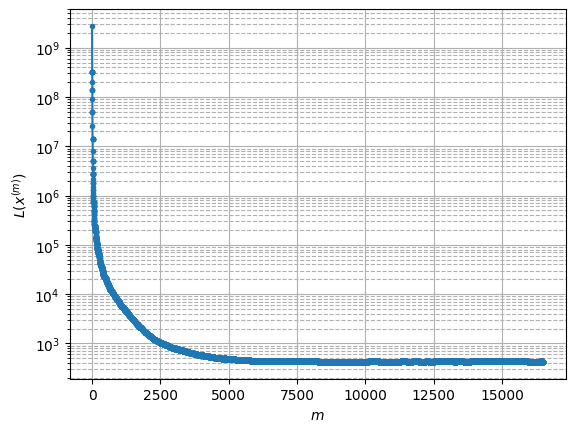

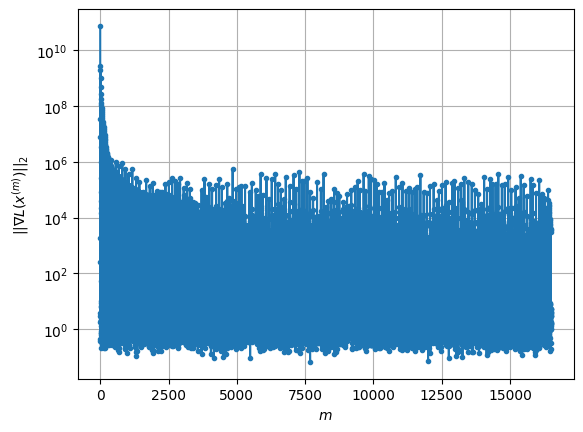

Windows:  50%|████▉     | 147/296 [9:38:13<10:30:41, 253.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 430.09902834719287
Gradient norm: 48002.735059200364
Global relative error: 0.9412254660570588
Position relative errors: 0.03925521904737877 m, 0.46661384049995486 m, 0.2733664700779499 m, 0.7693535556135437 m

STOP on Iteration 1
Cost function = 430.0446564597431 (-0.01%)
Gradient norm = 0.21522878937033804 (-100.00%)
Global relative error = 0.9435120323725138 (0.24%)
Final position relative errors: 0.04077022603133209 m, 0.46883428445998665 m, 0.2717195355520249 m, 0.771306583665181 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 430.01336985504065
Gradient norm: 26511.367065686296
Global relative error: 0.9435120323725138
Position relative errors: 0.04077022603133209 m, 0.46883428445998665 m, 0.2717195355520249 m, 0.771306583665181 m

Iteration 1
Cost function: 429.9894519885843 (-0.01%)
Gradient norm: 7.017202814260463 (-99.97%)
Global relative error = 0.945500

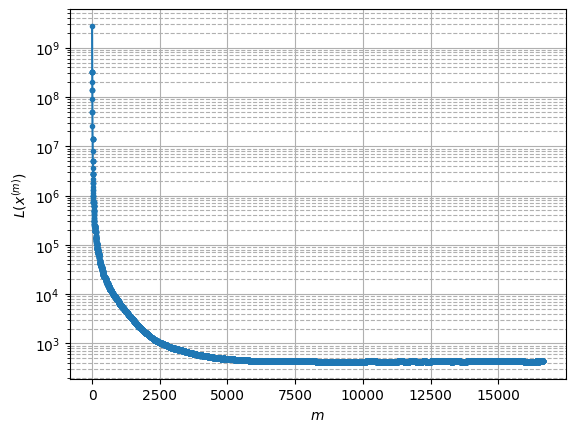

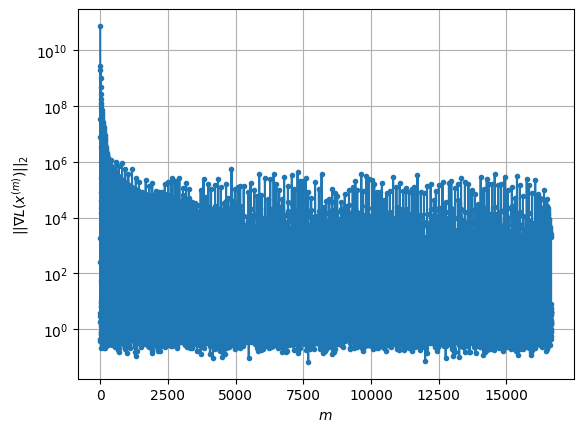

Windows:  50%|█████     | 148/296 [9:44:04<11:38:21, 283.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 437.7493884249092
Gradient norm: 235457.12197234025
Global relative error: 1.0131694247563952
Position relative errors: 0.0398235920930532 m, 0.5649214808483531 m, 0.2675037809328122 m, 0.7963856939834539 m

Iteration 1
Cost function: 437.5252878447636 (-0.05%)
Gradient norm: 2.135241140296288 (-100.00%)
Global relative error = 1.018018577610775 (0.48%)
Position relative errors: 0.03502195128828345 m, 0.5633018894016094 m, 0.26755473210114367 m, 0.8038899735338463 m

Iteration 2
Cost function: 437.5252884025565 (0.00%)
Gradient norm: 4.762250114129333 (123.03%)
Global relative error = 1.0180185769230254 (-0.00%)
Position relative errors: 0.035021951249918123 m, 0.5633018912997624 m, 0.26755473221219334 m, 0.8038899712975442 m

Iteration 3
Cost function: 437.525287636189 (-0.00%)
Gradient norm: 2.2346340929685238 (-53.08%)
Global relative error = 1.0180185788571003 (0.00%)
Position relative errors: 0.035

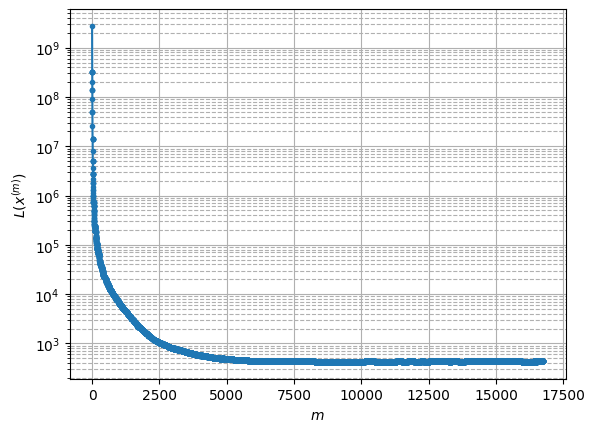

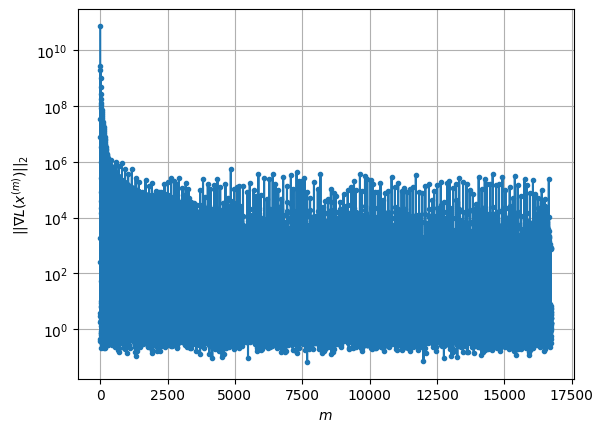

Windows:  50%|█████     | 149/296 [9:47:22<10:31:03, 257.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 438.91198216496105
Gradient norm: 182948.79104359957
Global relative error: 1.0989133997816647
Position relative errors: 0.034523105096163784 m, 0.658792969024645 m, 0.2940225257754956 m, 0.8282269936808481 m

Iteration 1
Cost function: 438.66776691989537 (-0.06%)
Gradient norm: 1.6692722662000417 (-100.00%)
Global relative error = 1.0993941864630141 (0.04%)
Position relative errors: 0.04042858906701764 m, 0.6656957232327921 m, 0.3006494837759169 m, 0.8206648331280229 m

STOP on Iteration 2
Cost function = 438.6677667049636 (-0.00%)
Gradient norm = 0.7863574840797818 (-52.89%)
Global relative error = 1.0993941835391745 (-0.00%)
Final position relative errors: 0.040428574258185045 m, 0.6656957184381257 m, 0.3006494839512399 m, 0.8206648337657115 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 438.5834046339561
Gradient norm: 25125.35637322902
Global relative error: 

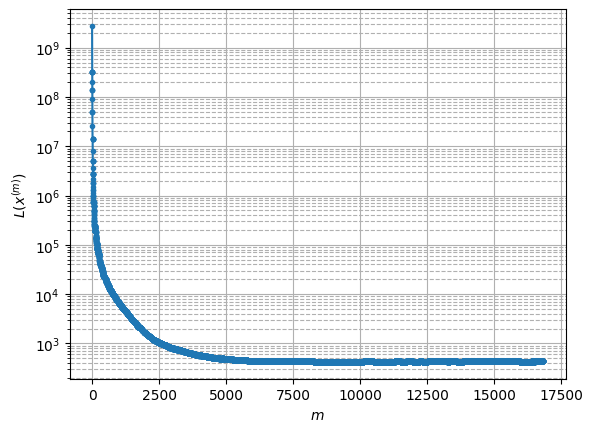

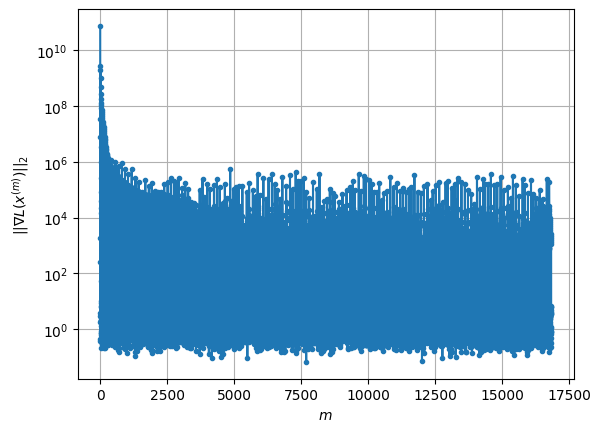

Windows:  51%|█████     | 150/296 [9:50:11<9:22:17, 231.08s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 436.82660605299634
Gradient norm: 117238.08547114774
Global relative error: 1.1931069296529546
Position relative errors: 0.040449434289088745 m, 0.7772918391987779 m, 0.3376644814879988 m, 0.838848460301641 m

Iteration 1
Cost function: 436.75449227912026 (-0.02%)
Gradient norm: 2.218052721218159 (-100.00%)
Global relative error = 1.196018749990046 (0.24%)
Position relative errors: 0.0404253635038387 m, 0.7719484089240022 m, 0.3406490025904283 m, 0.8466871941930539 m

STOP on Iteration 2
Cost function = 436.7544918025486 (-0.00%)
Gradient norm = 0.35840609303258836 (-83.84%)
Global relative error = 1.1960187468666066 (-0.00%)
Final position relative errors: 0.04042536909759696 m, 0.7719484052710924 m, 0.34064900071685594 m, 0.8466871935981138 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 436.7249686049871
Gradient norm: 11733.616320488994
Global relative error: 1

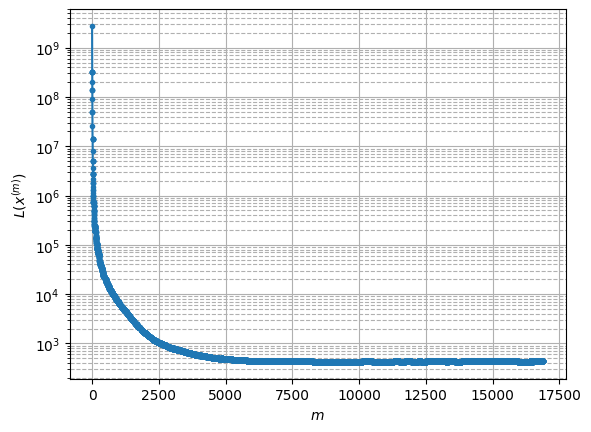

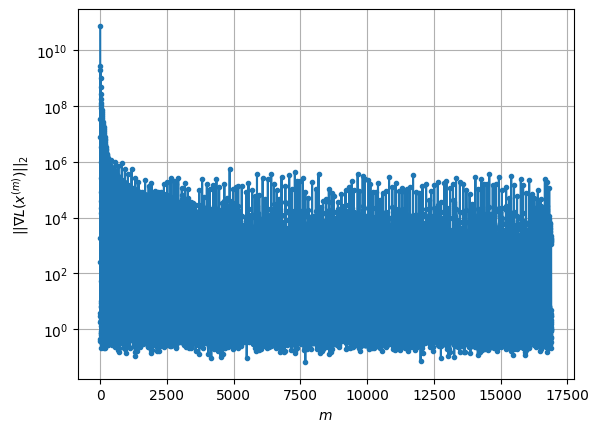

Windows:  51%|█████     | 151/296 [9:52:49<8:25:19, 209.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 434.97325766666273
Gradient norm: 133473.71229536168
Global relative error: 1.2693627204697182
Position relative errors: 0.03954634580875616 m, 0.8500251205052654 m, 0.3614610493349274 m, 0.8697814808509496 m

Iteration 1
Cost function: 434.43853749783466 (-0.12%)
Gradient norm: 3.053249037741181 (-100.00%)
Global relative error = 1.2669482650311958 (-0.19%)
Position relative errors: 0.06387694807776019 m, 0.8504535893152076 m, 0.35147412487274315 m, 0.8684878278477722 m

Iteration 2
Cost function: 434.43853853134306 (0.00%)
Gradient norm: 1.4497607522452305 (-52.52%)
Global relative error = 1.2669482618734056 (-0.00%)
Position relative errors: 0.06387694990335495 m, 0.8504535857489379 m, 0.3514741187919772 m, 0.8684878290600079 m

Iteration 3
Cost function: 434.4385385261976 (-0.00%)
Gradient norm: 3.000545187448108 (106.97%)
Global relative error = 1.2669482624806343 (0.00%)
Position relative errors: 

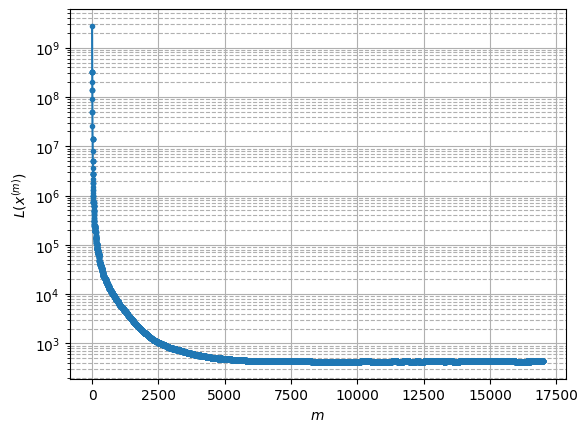

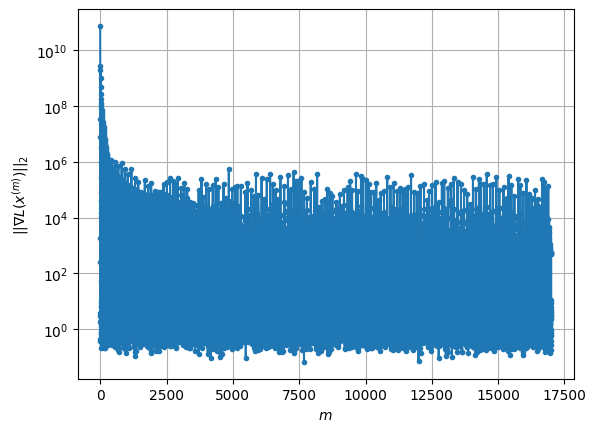

Windows:  51%|█████▏    | 152/296 [9:56:52<8:46:15, 219.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 440.9959150491404
Gradient norm: 277401.46379157965
Global relative error: 1.3055462795778503
Position relative errors: 0.06052147954086422 m, 0.9307932066303584 m, 0.31151026110298385 m, 0.8587040764247484 m

Iteration 1
Cost function: 440.81367110826557 (-0.04%)
Gradient norm: 2.9147944504391377 (-100.00%)
Global relative error = 1.3058387642762308 (0.02%)
Position relative errors: 0.056280019536825585 m, 0.9330754912189219 m, 0.30491032859670886 m, 0.8593290140065525 m

Iteration 2
Cost function: 440.8136716410873 (0.00%)
Gradient norm: 1.7182004962438409 (-41.05%)
Global relative error = 1.3058387638753053 (-0.00%)
Position relative errors: 0.05628002245279357 m, 0.9330754922010362 m, 0.3049103282098334 m, 0.8593290122772073 m

Iteration 3
Cost function: 440.8136714250427 (-0.00%)
Gradient norm: 5.262476686465114 (206.28%)
Global relative error = 1.3058387639726468 (0.00%)
Position relative errors: 

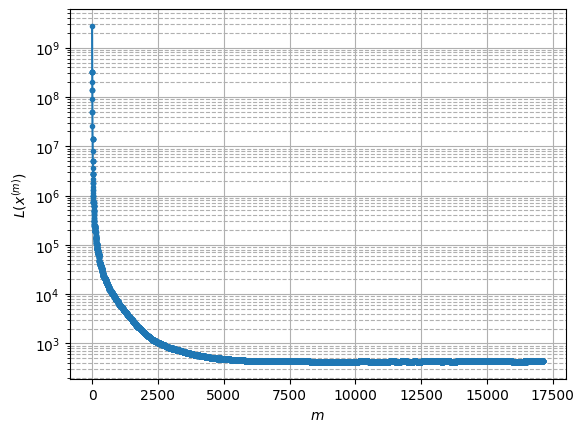

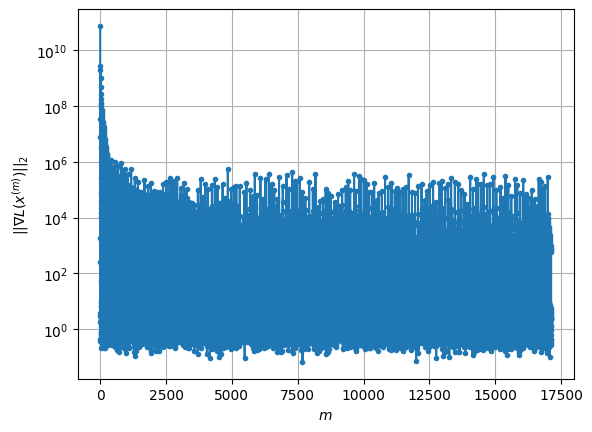

Windows:  52%|█████▏    | 153/296 [10:01:42<9:33:04, 240.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 441.43186559896327
Gradient norm: 182707.37457661872
Global relative error: 1.3558131156622155
Position relative errors: 0.054130333383434016 m, 1.0132315535549965 m, 0.2770100826526067 m, 0.8555265166448579 m

Iteration 1
Cost function: 441.2303562909247 (-0.05%)
Gradient norm: 2.7710248363746417 (-100.00%)
Global relative error = 1.360641929304726 (0.36%)
Position relative errors: 0.04591001446575443 m, 1.0185463371116796 m, 0.27096874725430853 m, 0.8592888338675921 m

Iteration 2
Cost function: 441.2303565145109 (0.00%)
Gradient norm: 1.4477283677532735 (-47.75%)
Global relative error = 1.3606419291505547 (-0.00%)
Position relative errors: 0.04591000707938781 m, 1.0185463364795557 m, 0.27096874603462034 m, 0.8592888351520048 m

Iteration 3
Cost function: 441.23035599967534 (-0.00%)
Gradient norm: 1.7481412874028368 (20.75%)
Global relative error = 1.3606419300913721 (0.00%)
Position relative errors: 

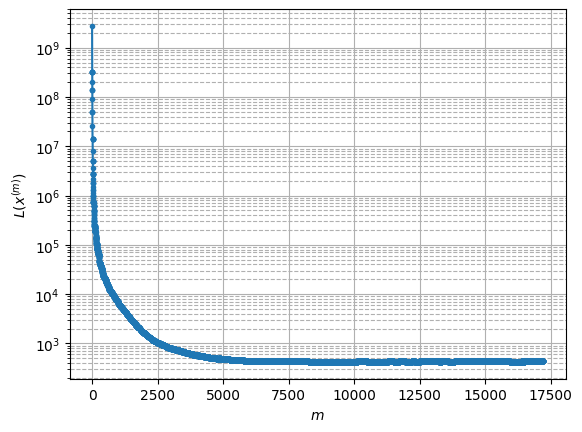

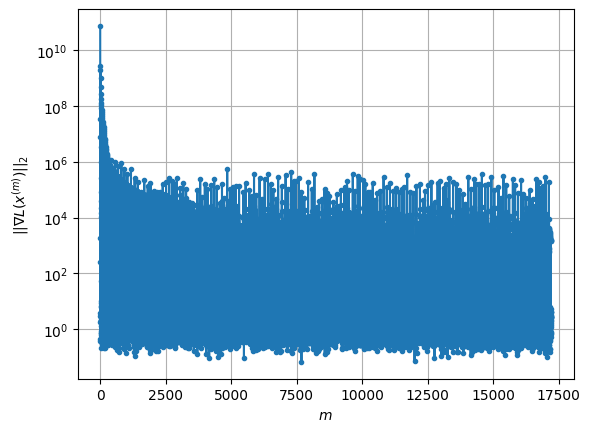

Windows:  52%|█████▏    | 154/296 [10:05:02<9:00:31, 228.39s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.494432058305
Gradient norm: 371539.24054882163
Global relative error: 1.4402489885763665
Position relative errors: 0.04487820460518581 m, 1.123122311818241 m, 0.20997608431967887 m, 0.8756761742998125 m

Iteration 1
Cost function: 446.24211276121923 (-0.06%)
Gradient norm: 4.222341794066302 (-100.00%)
Global relative error = 1.4436344375765282 (0.24%)
Position relative errors: 0.03922901152621348 m, 1.1236549037135777 m, 0.20643523739076147 m, 0.8816603495972487 m

Iteration 2
Cost function: 446.2421127073211 (-0.00%)
Gradient norm: 7.3674873531602385 (74.49%)
Global relative error = 1.4436344366945921 (-0.00%)
Position relative errors: 0.039229015451411206 m, 1.1236549040410426 m, 0.20643523971663247 m, 0.8816603470165819 m

Iteration 3
Cost function: 446.2421132251536 (0.00%)
Gradient norm: 2.9565160209014074 (-59.87%)
Global relative error = 1.443634437985338 (0.00%)
Position relative errors: 0.0

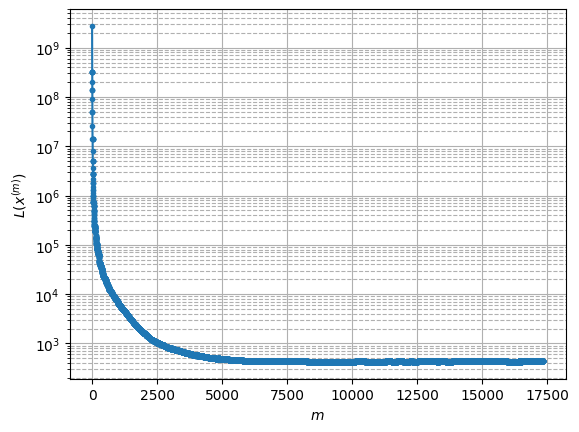

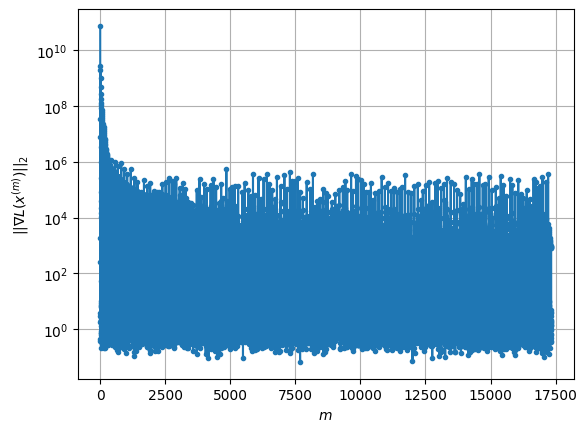

Windows:  52%|█████▏    | 155/296 [10:09:27<9:22:55, 239.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 441.82445346964533
Gradient norm: 104503.21946277782
Global relative error: 1.5091931045100584
Position relative errors: 0.038775816221609895 m, 1.2003447065009134 m, 0.16087888506745907 m, 0.8996945416513902 m

Iteration 1
Cost function: 441.6322698671449 (-0.04%)
Gradient norm: 3.030361227554628 (-100.00%)
Global relative error = 1.5185549123800137 (0.62%)
Position relative errors: 0.027908708723905495 m, 1.207859193472893 m, 0.15577397698577014 m, 0.9066643148134653 m

Iteration 2
Cost function: 441.6322697072144 (-0.00%)
Gradient norm: 3.770249420659699 (24.42%)
Global relative error = 1.5185549095828645 (-0.00%)
Position relative errors: 0.02790870980273439 m, 1.2078591904035367 m, 0.15577397659474693 m, 0.9066643142515515 m

STOP on Iteration 3
Cost function = 441.6322698264745 (0.00%)
Gradient norm = 0.4688800425413606 (-87.56%)
Global relative error = 1.5185549094275186 (-0.00%)
Final position r

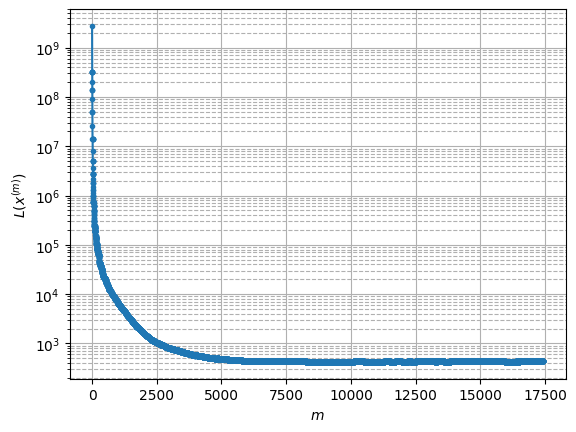

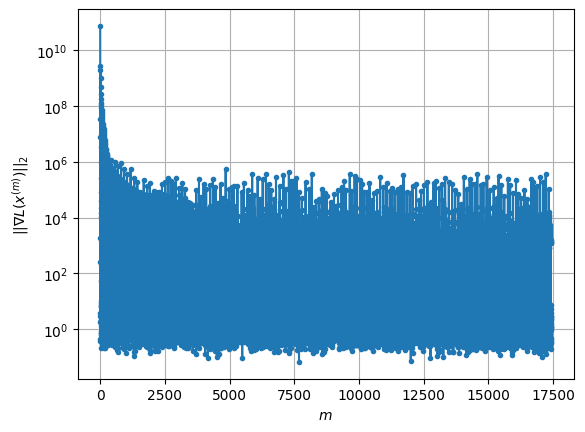

Windows:  53%|█████▎    | 156/296 [10:12:58<8:58:34, 230.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.958865623067
Gradient norm: 339809.2191594146
Global relative error: 1.6275693767852069
Position relative errors: 0.029189886687690063 m, 1.3213881731857897 m, 0.13664360619490318 m, 0.9398889211623939 m

Iteration 1
Cost function: 442.6346273516895 (-0.07%)
Gradient norm: 2.7861605190749232 (-100.00%)
Global relative error = 1.6273751697243988 (-0.01%)
Position relative errors: 0.018799720296383216 m, 1.3198085677475067 m, 0.15383951420604625 m, 0.9393799113376776 m

Iteration 2
Cost function: 442.63462762693825 (0.00%)
Gradient norm: 2.9043756268161673 (4.24%)
Global relative error = 1.6273751663754226 (-0.00%)
Position relative errors: 0.01879972756231138 m, 1.319808567035788 m, 0.15383951035824459 m, 0.9393799070206239 m

Iteration 3
Cost function: 442.6346274434011 (-0.00%)
Gradient norm: 4.691495864181152 (61.53%)
Global relative error = 1.6273751688232623 (0.00%)
Position relative errors: 0.0

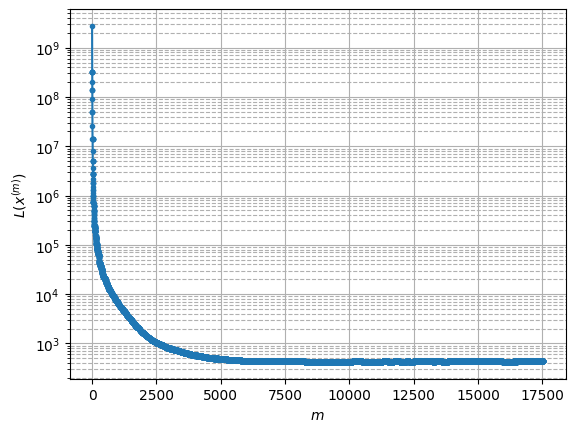

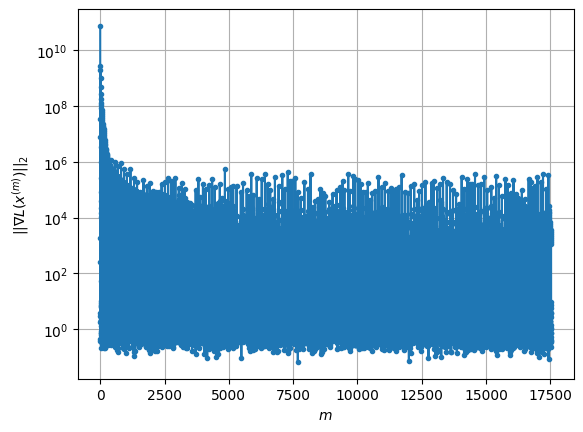

Windows:  53%|█████▎    | 157/296 [10:16:56<9:00:02, 233.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 443.14738430635214
Gradient norm: 369651.01728741353
Global relative error: 1.6772292613786448
Position relative errors: 0.018326200719630467 m, 1.4004930323065579 m, 0.19668194620204932 m, 0.901497132071605 m

STOP on Iteration 1
Cost function = 442.7485475109694 (-0.09%)
Gradient norm = 0.4735532790238388 (-100.00%)
Global relative error = 1.678676709838306 (0.09%)
Final position relative errors: 0.007764686544467753 m, 1.4042052002490257 m, 0.1395716483437748 m, 0.9091876452940889 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 442.66196934299444
Gradient norm: 7983.557085429156
Global relative error: 1.678676709838306
Position relative errors: 0.007764686544467753 m, 1.4042052002490257 m, 0.1395716483437748 m, 0.9091876452940889 m

Iteration 1
Cost function: 442.6034038258803 (-0.01%)
Gradient norm: 4.574394740807569 (-99.94%)
Global relative error = 1.68015493

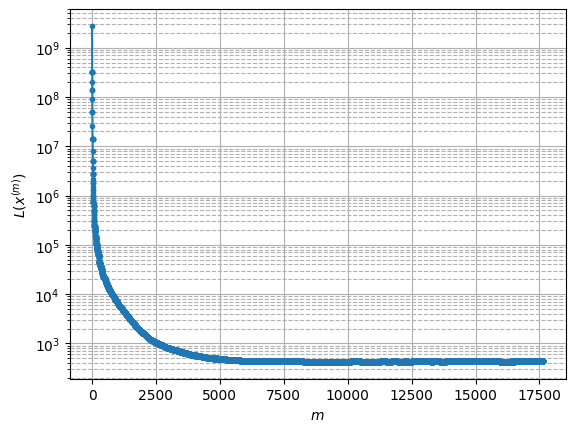

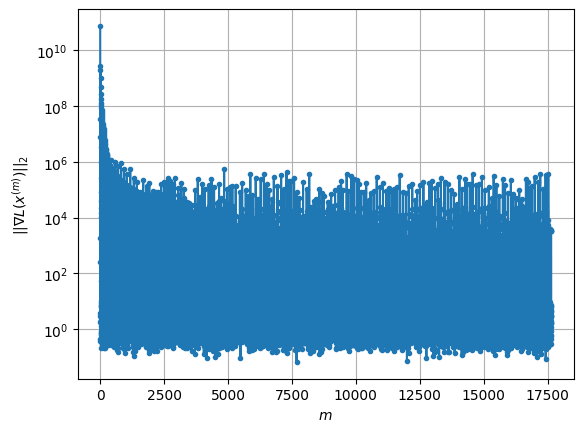

Windows:  53%|█████▎    | 158/296 [10:21:04<9:05:53, 237.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 441.92827248676264
Gradient norm: 251638.51523601104
Global relative error: 1.7048532759154398
Position relative errors: 0.007543099076294658 m, 1.4636750691691023 m, 0.11299108445879749 m, 0.866807729939943 m

Iteration 1
Cost function: 441.58614949543755 (-0.08%)
Gradient norm: 3.2634712157822823 (-100.00%)
Global relative error = 1.7089338121782969 (0.24%)
Position relative errors: 0.007202180220926262 m, 1.4745676394871823 m, 0.12818451893827357 m, 0.8541788165878964 m

Iteration 2
Cost function: 441.58614934603327 (-0.00%)
Gradient norm: 2.4336607730617446 (-25.43%)
Global relative error = 1.7089338123617834 (0.00%)
Position relative errors: 0.007202183361627171 m, 1.474567638420062 m, 0.1281845204054133 m, 0.854178818550506 m

Iteration 3
Cost function: 441.58614959837354 (0.00%)
Gradient norm: 3.9538635483513054 (62.47%)
Global relative error = 1.7089338097474225 (-0.00%)
Position relative errors

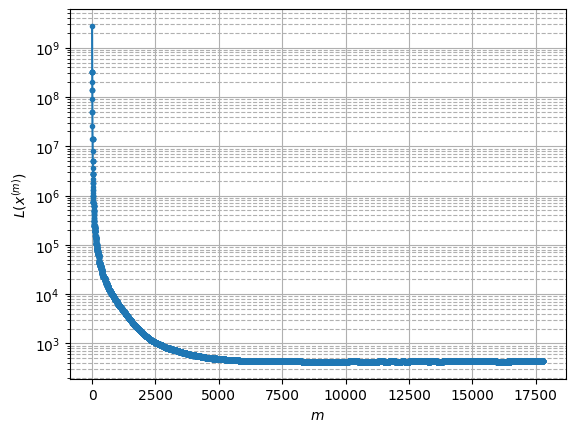

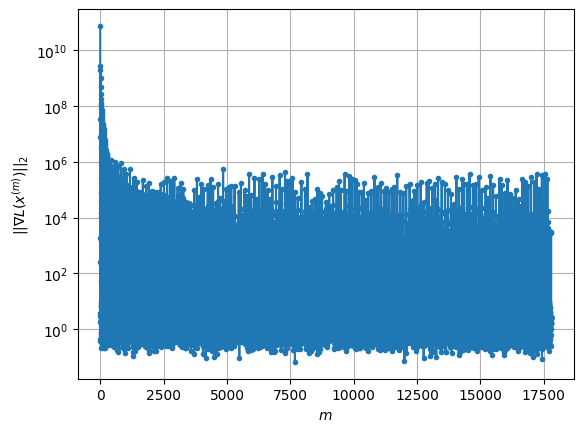

Windows:  54%|█████▎    | 159/296 [10:26:35<10:06:27, 265.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 447.5579963170318
Gradient norm: 430134.2266848038
Global relative error: 1.7701757777258251
Position relative errors: 0.007601630834299835 m, 1.5674843539914758 m, 0.22873567287889562 m, 0.7900232517660151 m

STOP on Iteration 1
Cost function = 447.2684626706729 (-0.06%)
Gradient norm = 0.858288313398303 (-100.00%)
Global relative error = 1.777290387536227 (0.40%)
Final position relative errors: 0.009319885275346699 m, 1.5735249707061636 m, 0.2549923128165463 m, 0.7859209732915546 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 447.22593149327133
Gradient norm: 9480.610746917551
Global relative error: 1.777290387536227
Position relative errors: 0.009319885275346699 m, 1.5735249707061636 m, 0.2549923128165463 m, 0.7859209732915546 m

Iteration 1
Cost function: 447.19704563980883 (-0.01%)
Gradient norm: 2.388071148992559 (-99.97%)
Global relative error = 1.782824558

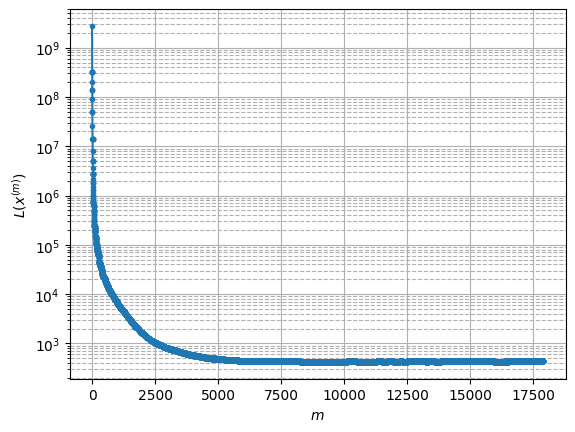

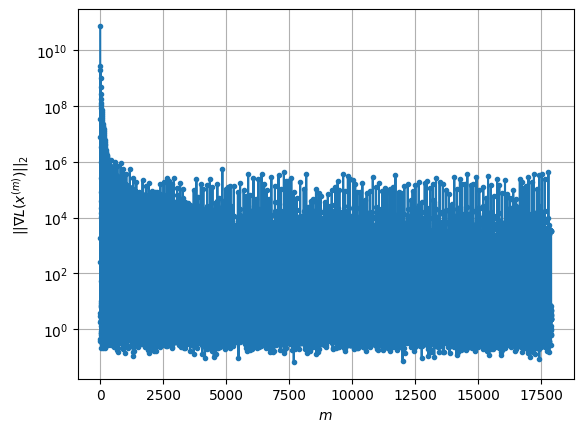

Windows:  54%|█████▍    | 160/296 [10:30:38<9:46:47, 258.88s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 445.2267824541208
Gradient norm: 101586.28440207255
Global relative error: 1.8074180766583765
Position relative errors: 0.0096552098427208 m, 1.614831727206086 m, 0.3940102865610597 m, 0.7097468225439587 m

Iteration 1
Cost function: 444.9972559367109 (-0.05%)
Gradient norm: 1.4482490297358155 (-100.00%)
Global relative error = 1.8006936575932802 (-0.37%)
Position relative errors: 0.014961932277207638 m, 1.615672793088539 m, 0.35911337577259034 m, 0.7091629707430926 m

Iteration 2
Cost function: 444.9972564365217 (0.00%)
Gradient norm: 1.5377549304918978 (6.18%)
Global relative error = 1.800693653972662 (-0.00%)
Position relative errors: 0.01496193699081022 m, 1.615672790867057 m, 0.3591133676329666 m, 0.709162970633239 m

Iteration 3
Cost function: 444.9972563387108 (-0.00%)
Gradient norm: 3.5732610406597396 (132.37%)
Global relative error = 1.8006936559304554 (0.00%)
Position relative errors: 0.014961

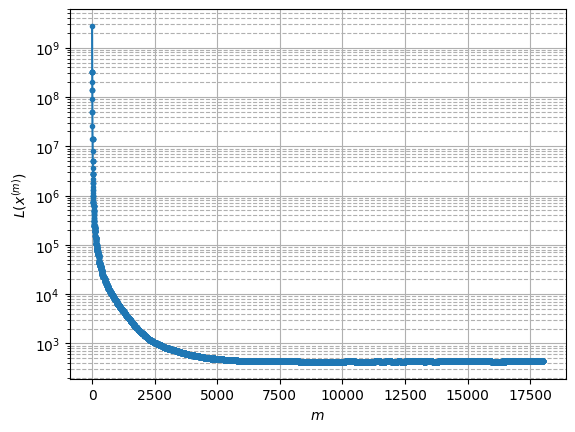

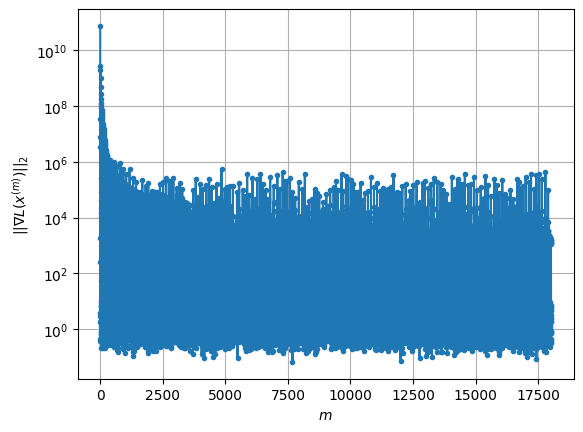

Windows:  54%|█████▍    | 161/296 [10:35:08<9:49:54, 262.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 443.40125706470695
Gradient norm: 140525.6185182874
Global relative error: 1.8012137075419448
Position relative errors: 0.015824553886441453 m, 1.649596194280047 m, 0.2834562931871054 m, 0.6652853070797787 m

Iteration 1
Cost function: 443.20963305062054 (-0.04%)
Gradient norm: 2.627568100398187 (-100.00%)
Global relative error = 1.8053505873515152 (0.23%)
Position relative errors: 0.020506401718807608 m, 1.6543120462859429 m, 0.28546971820273526 m, 0.6637982473693711 m

Iteration 2
Cost function: 443.20963350654694 (0.00%)
Gradient norm: 3.344392724021487 (27.28%)
Global relative error = 1.8053505861142207 (-0.00%)
Position relative errors: 0.020506405810699596 m, 1.6543120445855777 m, 0.28546971938430554 m, 0.6637982476073602 m

Iteration 3
Cost function: 443.2096329184675 (-0.00%)
Gradient norm: 1.652275726437247 (-50.60%)
Global relative error = 1.8053505835188637 (-0.00%)
Position relative errors: 

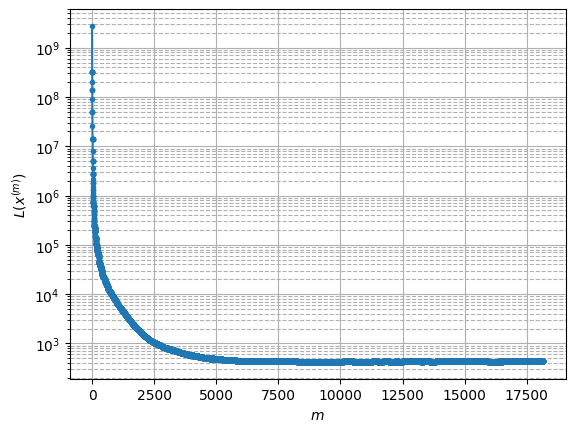

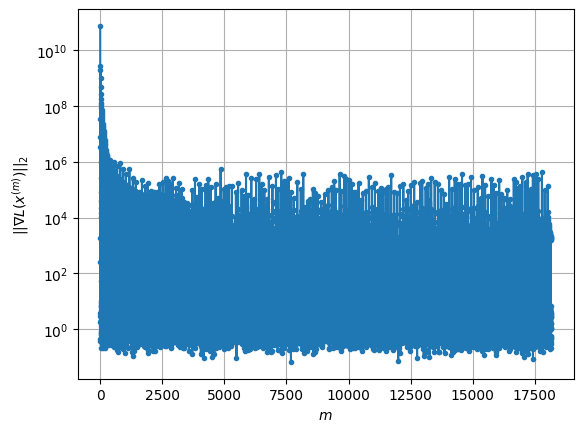

Windows:  55%|█████▍    | 162/296 [10:40:24<10:21:23, 278.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 442.6630279660166
Gradient norm: 225287.59370596785
Global relative error: 1.7645858151358056
Position relative errors: 0.02118326505210854 m, 1.6357712232589097 m, 0.24733481834197246 m, 0.613507395351493 m

Iteration 1
Cost function: 441.9466631076036 (-0.16%)
Gradient norm: 6.024407211694933 (-100.00%)
Global relative error = 1.7558234438858427 (-0.50%)
Position relative errors: 0.03705052724055699 m, 1.6309087091745789 m, 0.21619664715939496 m, 0.6123218232002062 m

Iteration 2
Cost function: 441.9466630592087 (-0.00%)
Gradient norm: 5.535808830063491 (-8.11%)
Global relative error = 1.755823439049764 (-0.00%)
Position relative errors: 0.03705051558928078 m, 1.6309087057172371 m, 0.2161966409589567 m, 0.6123218214356386 m

STOP on Iteration 3
Cost function = 441.94666264736867 (-0.00%)
Gradient norm = 0.5972944056375751 (-89.21%)
Global relative error = 1.7558234423241337 (0.00%)
Final position rela

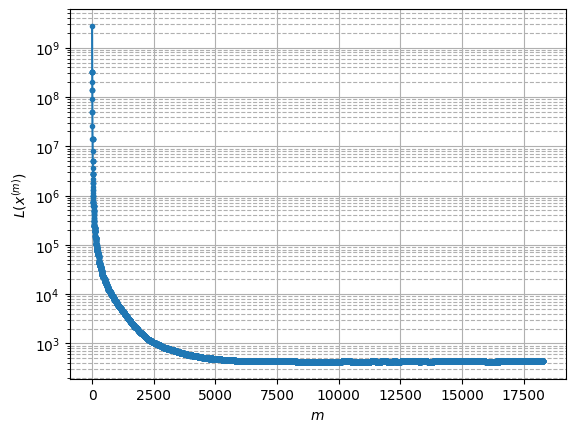

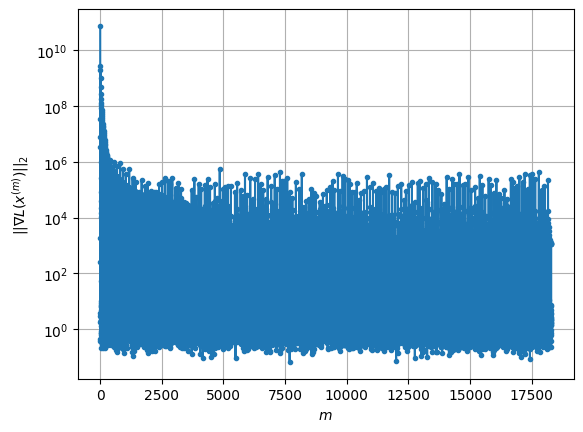

Windows:  55%|█████▌    | 163/296 [10:45:08<10:20:28, 279.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 444.60913725921705
Gradient norm: 230094.49507671356
Global relative error: 1.690740610687077
Position relative errors: 0.03584373127617429 m, 1.5720990196483318 m, 0.20628302227538542 m, 0.5858922294321032 m

Iteration 1
Cost function: 444.46637543703963 (-0.03%)
Gradient norm: 2.63436987981879 (-100.00%)
Global relative error = 1.6934382629530274 (0.16%)
Position relative errors: 0.035529382500961805 m, 1.5711437971788385 m, 0.20508296903279358 m, 0.5965883088649626 m

Iteration 2
Cost function: 444.4663748711938 (-0.00%)
Gradient norm: 4.241792214135485 (61.02%)
Global relative error = 1.6934382623148494 (-0.00%)
Position relative errors: 0.03552938283952772 m, 1.5711437967196205 m, 0.20508296882245203 m, 0.5965883083149908 m

Iteration 3
Cost function: 444.4663759288343 (0.00%)
Gradient norm: 3.8507705654579283 (-9.22%)
Global relative error = 1.693438262725271 (0.00%)
Position relative errors: 0.03

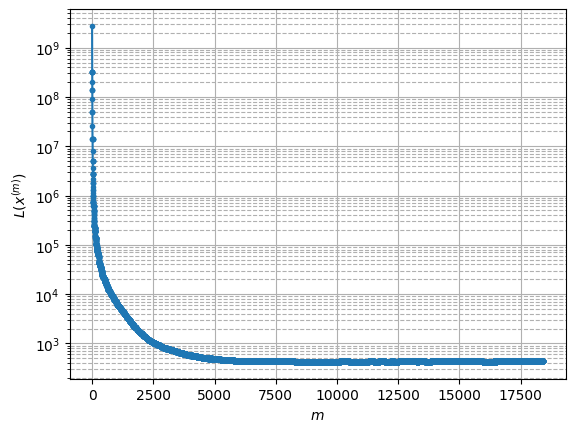

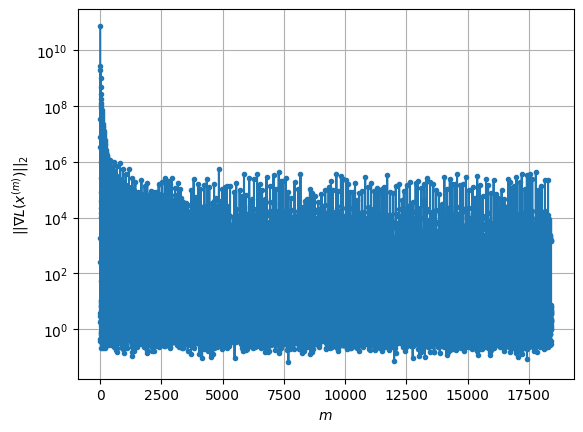

Windows:  55%|█████▌    | 164/296 [10:49:49<10:16:34, 280.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 445.17907405099925
Gradient norm: 125712.45740544269
Global relative error: 1.6052868084861858
Position relative errors: 0.03423504138387874 m, 1.488203419740766 m, 0.17794226437124552 m, 0.5738980585608447 m

Iteration 1
Cost function: 444.75634024213014 (-0.09%)
Gradient norm: 2.4580732083191967 (-100.00%)
Global relative error = 1.6063123658167195 (0.06%)
Position relative errors: 0.01627706642310362 m, 1.487866178660501 m, 0.17853705561883262 m, 0.5782312270277887 m

Iteration 2
Cost function: 444.75634004306653 (-0.00%)
Gradient norm: 3.889649302620156 (58.24%)
Global relative error = 1.6063123644986415 (-0.00%)
Position relative errors: 0.016277064278543744 m, 1.4878661768508037 m, 0.17853705681661353 m, 0.5782312277133341 m

Iteration 3
Cost function: 444.7563403709376 (0.00%)
Gradient norm: 2.2466294491088292 (-42.24%)
Global relative error = 1.6063123632890948 (-0.00%)
Position relative errors:

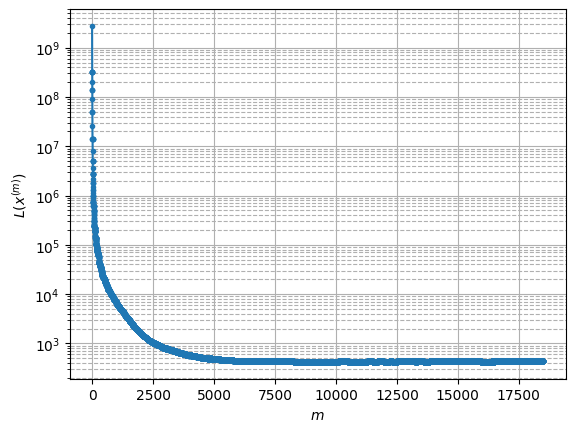

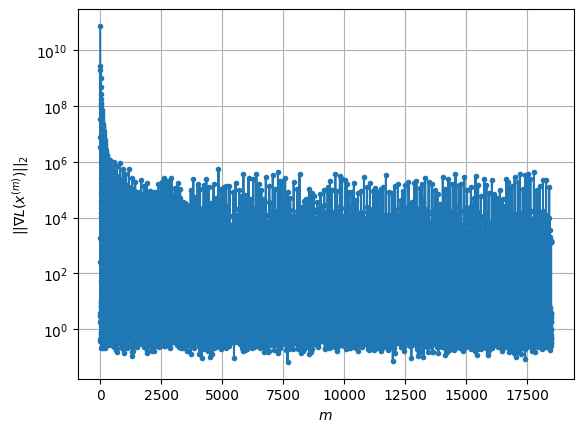

Windows:  56%|█████▌    | 165/296 [10:52:54<9:09:47, 251.81s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 450.5913207912434
Gradient norm: 168286.08350595573
Global relative error: 1.5140500730609856
Position relative errors: 0.017072460746964002 m, 1.4171267849170843 m, 0.19751228578771476 m, 0.49476687958680365 m

Iteration 1
Cost function: 450.25749899288326 (-0.07%)
Gradient norm: 2.71864079425964 (-100.00%)
Global relative error = 1.507718743457896 (-0.42%)
Position relative errors: 0.012497527507014914 m, 1.4117160755114417 m, 0.21403073684990528 m, 0.4840513593639911 m

STOP on Iteration 2
Cost function = 450.25749951848434 (0.00%)
Gradient norm = 0.4602776906884156 (-83.07%)
Global relative error = 1.5077187453091319 (0.00%)
Final position relative errors: 0.012497527921440427 m, 1.4117160766035481 m, 0.21403074132709415 m, 0.48405135995475806 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 450.11933964365767
Gradient norm: 38272.02227210802
Global relative err

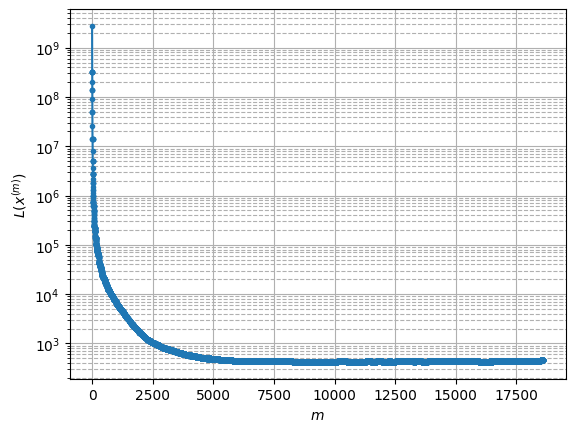

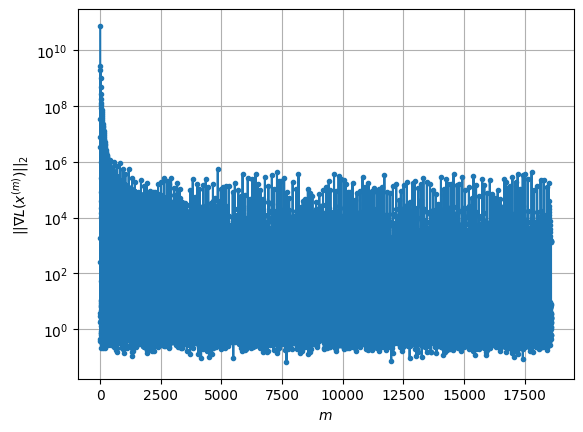

Windows:  56%|█████▌    | 166/296 [10:56:39<8:48:15, 243.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 450.62215885577
Gradient norm: 311438.54612804245
Global relative error: 1.420209201047242
Position relative errors: 0.01378659925567674 m, 1.327386211563411 m, 0.35667715749845763 m, 0.35725090734825876 m

Iteration 1
Cost function: 450.32093655096156 (-0.07%)
Gradient norm: 1.9422555821933098 (-100.00%)
Global relative error = 1.4159716547120844 (-0.30%)
Position relative errors: 0.024654611660824832 m, 1.3181096967262833 m, 0.3686061472696259 m, 0.36205117722526936 m

Iteration 2
Cost function: 450.320938833512 (0.00%)
Gradient norm: 3.793203620443388 (95.30%)
Global relative error = 1.4159716502862822 (-0.00%)
Position relative errors: 0.02465461970195437 m, 1.318109694073719 m, 0.36860614038281736 m, 0.362051176037146 m

Iteration 3
Cost function: 450.32093859740667 (-0.00%)
Gradient norm: 1.0593851213727377 (-72.07%)
Global relative error = 1.4159716523541355 (0.00%)
Position relative errors: 0.02

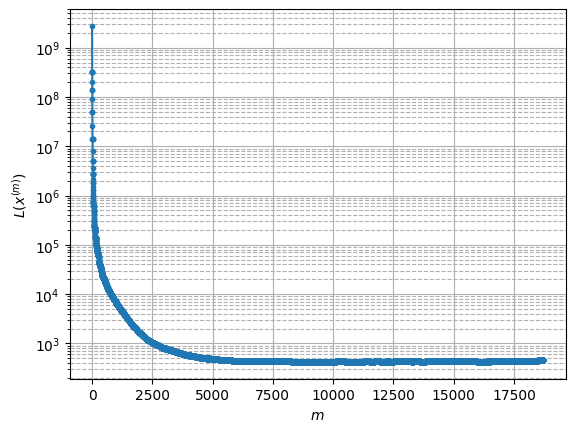

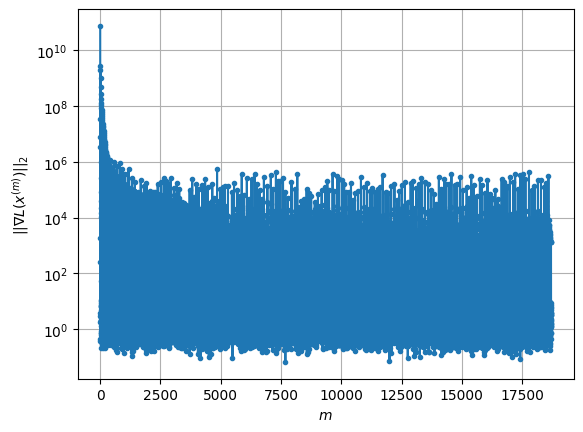

Windows:  56%|█████▋    | 167/296 [11:00:58<8:53:46, 248.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.45781572666243
Gradient norm: 327028.13380371005
Global relative error: 1.2651285397240175
Position relative errors: 0.02333201851663017 m, 1.1834376144739314 m, 0.33316639586881164 m, 0.2974519498855368 m

Iteration 1
Cost function: 452.13415775756 (-0.07%)
Gradient norm: 1.5746438280147117 (-100.00%)
Global relative error = 1.2650911837785284 (-0.00%)
Position relative errors: 0.012162605523800562 m, 1.1773692158628866 m, 0.34927145428549433 m, 0.3035048433628648 m

Iteration 2
Cost function: 452.13415830684085 (0.00%)
Gradient norm: 2.218122019486272 (40.86%)
Global relative error = 1.2650911855495448 (0.00%)
Position relative errors: 0.012162606894160871 m, 1.17736921682679 m, 0.3492714544415199 m, 0.3035048467712505 m

Iteration 3
Cost function: 452.1341585436676 (0.00%)
Gradient norm: 1.0156379841895646 (-54.21%)
Global relative error = 1.26509118714888 (0.00%)
Position relative errors: 0.0121

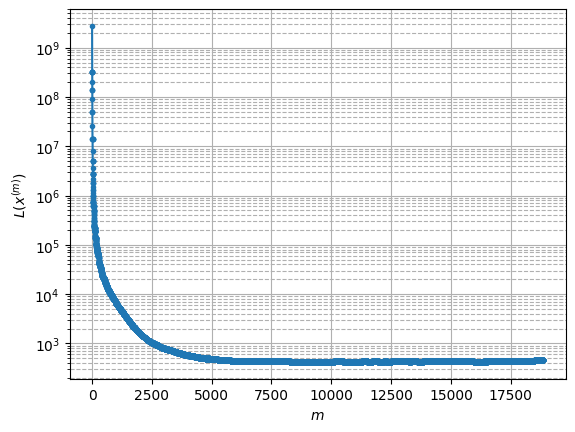

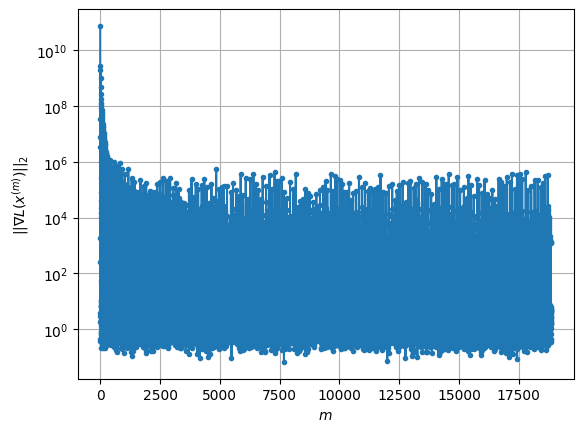

Windows:  57%|█████▋    | 168/296 [11:06:19<9:36:16, 270.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 451.53768669772177
Gradient norm: 434351.82400564343
Global relative error: 1.1416829341414323
Position relative errors: 0.012350026967090517 m, 1.0571983910704714 m, 0.3530380676186444 m, 0.24693858819072909 m

STOP on Iteration 1
Cost function = 451.251610348361 (-0.06%)
Gradient norm = 0.5809533437733342 (-100.00%)
Global relative error = 1.134206641293287 (-0.65%)
Final position relative errors: 0.01847412022957022 m, 1.0529694763561392 m, 0.3516358837949011 m, 0.2317034109417918 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 451.23007013871
Gradient norm: 13509.641586069394
Global relative error: 1.134206641293287
Position relative errors: 0.01847412022957022 m, 1.0529694763561392 m, 0.3516358837949011 m, 0.2317034109417918 m

STOP on Iteration 1
Cost function = 451.21864690813277 (-0.00%)
Gradient norm = 0.47181526156566306 (-100.00%)
Global relative error =

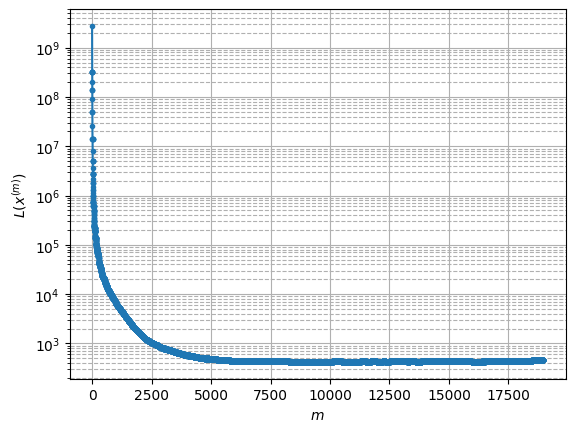

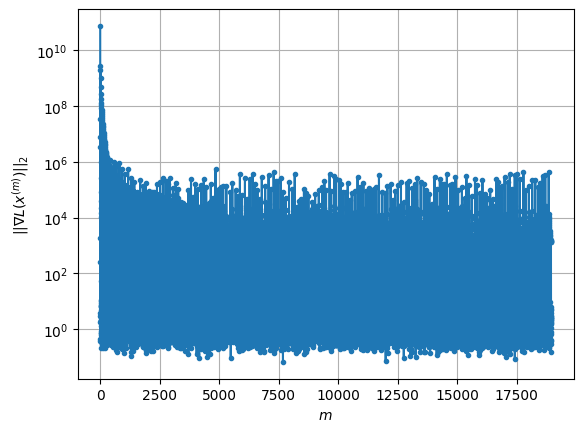

Windows:  57%|█████▋    | 169/296 [11:10:07<9:04:39, 257.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 450.6136345090992
Gradient norm: 113371.43811693879
Global relative error: 0.9983310539476256
Position relative errors: 0.01839467892244388 m, 0.9163712255548404 m, 0.36176831016394395 m, 0.1603402363242713 m

Iteration 1
Cost function: 450.5614844918279 (-0.01%)
Gradient norm: 3.8880402408062285 (-100.00%)
Global relative error = 0.9948532485954762 (-0.35%)
Position relative errors: 0.01657823771529839 m, 0.915405943052132 m, 0.3479775673276006 m, 0.17434648911756895 m

Iteration 2
Cost function: 450.56148415487013 (-0.00%)
Gradient norm: 2.3056332268250537 (-40.70%)
Global relative error = 0.9948532516988127 (0.00%)
Position relative errors: 0.01657824245033828 m, 0.9154059445203445 m, 0.34797756726950446 m, 0.17434649878261885 m

Iteration 3
Cost function: 450.561484459744 (0.00%)
Gradient norm: 3.5006481591247276 (51.83%)
Global relative error = 0.994853249702585 (-0.00%)
Position relative errors: 0

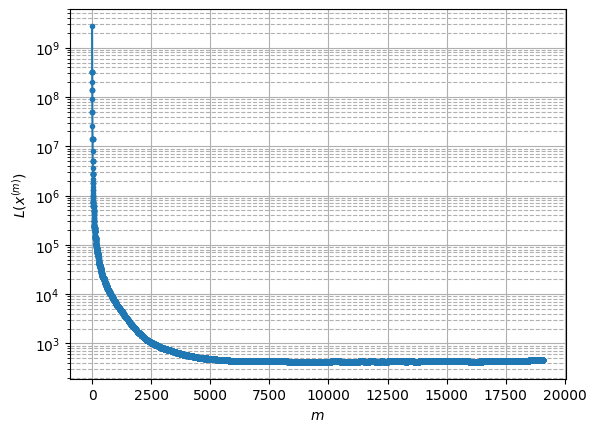

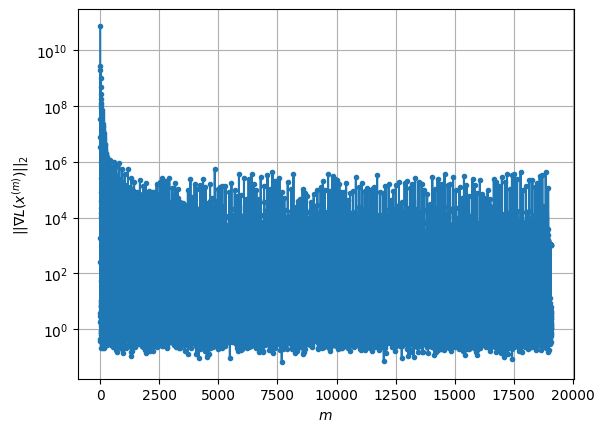

Windows:  57%|█████▋    | 170/296 [11:15:12<9:30:38, 271.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.466962110652
Gradient norm: 221987.4327844394
Global relative error: 0.8706135507034564
Position relative errors: 0.016144354216651478 m, 0.7808552802806574 m, 0.3021625352017817 m, 0.23804335194207743 m

Iteration 1
Cost function: 452.3258297242043 (-0.03%)
Gradient norm: 1.12256451009951 (-100.00%)
Global relative error = 0.8675710148937837 (-0.35%)
Position relative errors: 0.01746716905049517 m, 0.7799446904844646 m, 0.29821699194207185 m, 0.234780205713513 m

Iteration 2
Cost function: 452.32582990330474 (0.00%)
Gradient norm: 4.210709324055065 (275.10%)
Global relative error = 0.8675710184649418 (0.00%)
Position relative errors: 0.01746716699210693 m, 0.7799446908592775 m, 0.29821700000253154 m, 0.23478020757944074 m

Iteration 3
Cost function: 452.32582918805525 (-0.00%)
Gradient norm: 6.681466175244187 (58.68%)
Global relative error = 0.8675710170049812 (-0.00%)
Position relative errors: 0.0

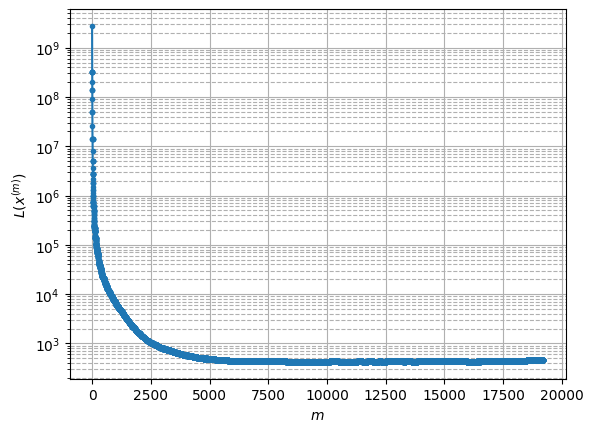

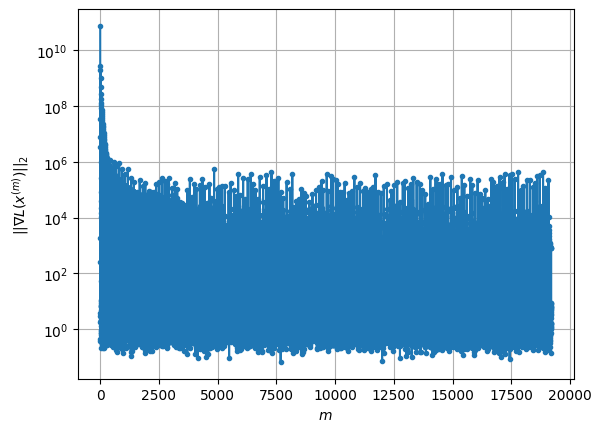

Windows:  58%|█████▊    | 171/296 [11:19:24<9:13:48, 265.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.01497574472404
Gradient norm: 71023.69592133249
Global relative error: 0.7824865166144388
Position relative errors: 0.017477051930206156 m, 0.65614753439041 m, 0.2789664052420639 m, 0.32190366370927925 m

Iteration 1
Cost function: 448.8397377348821 (-0.04%)
Gradient norm: 1.6472122278753254 (-100.00%)
Global relative error = 0.7996076488699804 (2.19%)
Position relative errors: 0.019057769796890243 m, 0.6552540861354111 m, 0.30037332399604694 m, 0.3455737325062667 m

Iteration 2
Cost function: 448.839737220819 (-0.00%)
Gradient norm: 3.825056631784566 (132.21%)
Global relative error = 0.7996076531511406 (0.00%)
Position relative errors: 0.019057768942035654 m, 0.6552540896498189 m, 0.300373327213414 m, 0.3455737329990533 m

Iteration 3
Cost function: 448.8397373592166 (0.00%)
Gradient norm: 3.2081415838009617 (-16.13%)
Global relative error = 0.7996076508293369 (-0.00%)
Position relative errors: 0.0

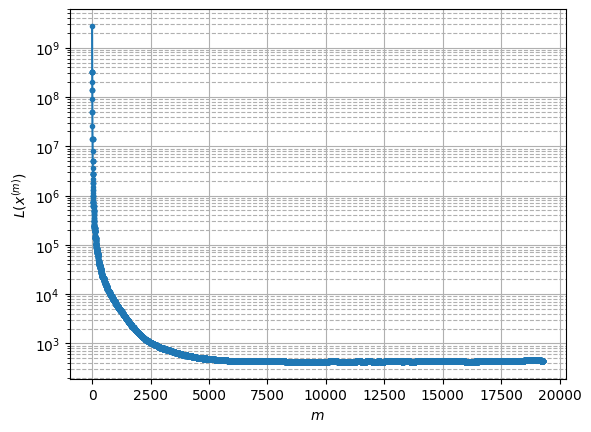

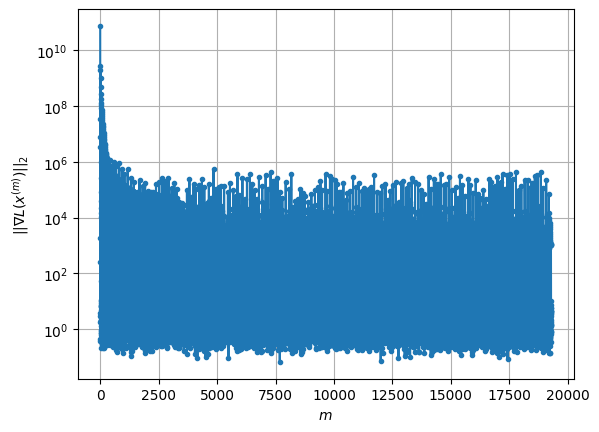

Windows:  58%|█████▊    | 172/296 [11:23:07<8:42:36, 252.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.5777958850933
Gradient norm: 74407.5180583147
Global relative error: 0.7842897325227742
Position relative errors: 0.019361526376890034 m, 0.5291063077201817 m, 0.3404333639004403 m, 0.46784691142049134 m

Iteration 1
Cost function: 449.38631694842 (-0.04%)
Gradient norm: 1.7519570553515498 (-100.00%)
Global relative error = 0.7854595785609108 (0.15%)
Position relative errors: 0.01276822341046099 m, 0.5227799877873024 m, 0.35254193160220465 m, 0.4681800343853841 m

Iteration 2
Cost function: 449.3863165839128 (-0.00%)
Gradient norm: 1.4386827917362377 (-17.88%)
Global relative error = 0.7854595827446049 (0.00%)
Position relative errors: 0.012768223616250818 m, 0.522779988594536 m, 0.3525419356919959 m, 0.4681800374176841 m

Iteration 3
Cost function: 449.38631709331065 (0.00%)
Gradient norm: 3.134185370019156 (117.85%)
Global relative error = 0.7854595783981698 (-0.00%)
Position relative errors: 0.01

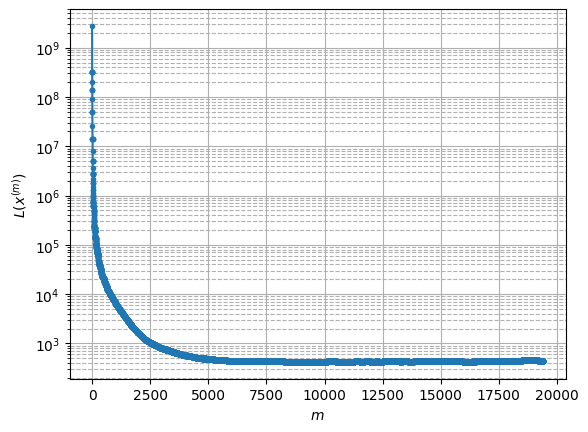

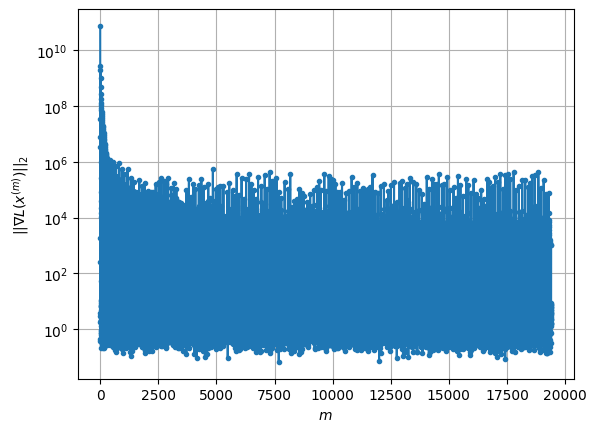

Windows:  58%|█████▊    | 173/296 [11:27:11<8:32:56, 250.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.9605953194158
Gradient norm: 236739.7239078273
Global relative error: 0.8038890538640949
Position relative errors: 0.012833173749339608 m, 0.3821741632918987 m, 0.3758624837555155 m, 0.5989460473542255 m

Iteration 1
Cost function: 454.68704741662793 (-0.06%)
Gradient norm: 1.3301722810445695 (-100.00%)
Global relative error = 0.7943143908479535 (-1.19%)
Position relative errors: 0.009328680743263333 m, 0.3821204825098296 m, 0.36351520719046226 m, 0.5938704423484905 m

STOP on Iteration 2
Cost function = 454.68704745244804 (0.00%)
Gradient norm = 0.6934483149189501 (-47.87%)
Global relative error = 0.7943143934448512 (0.00%)
Final position relative errors: 0.009328678922909506 m, 0.382120484447842 m, 0.3635152059287289 m, 0.5938704453758127 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.62332516979995
Gradient norm: 14926.044798906414
Global relative error

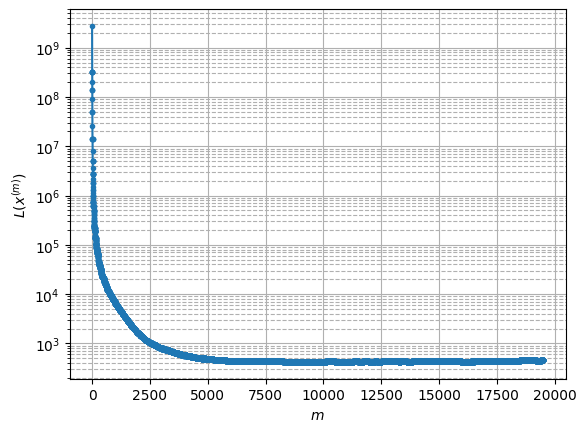

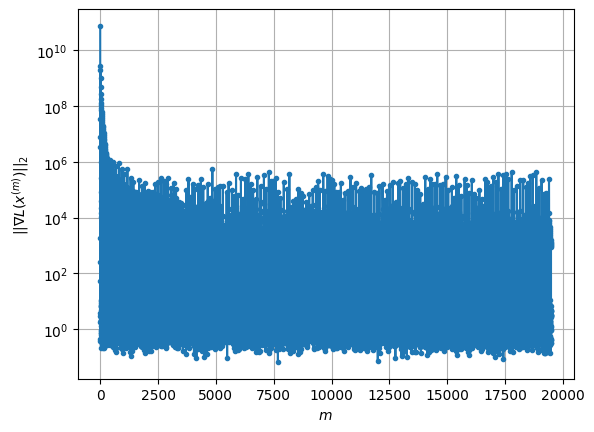

Windows:  59%|█████▉    | 174/296 [11:30:39<8:03:08, 237.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.3615087952897
Gradient norm: 240943.80521440017
Global relative error: 0.8554737505739991
Position relative errors: 0.009261769063547306 m, 0.26170306731431225 m, 0.3464898792637198 m, 0.7370202615662219 m

Iteration 1
Cost function: 458.1224245459971 (-0.05%)
Gradient norm: 3.469373396468591 (-100.00%)
Global relative error = 0.8703844564495288 (1.74%)
Position relative errors: 0.01120700257863654 m, 0.2742429147799727 m, 0.36327914834035446 m, 0.7417921477706504 m

STOP on Iteration 2
Cost function = 458.12242566683796 (0.00%)
Gradient norm = 0.23263330773620747 (-93.29%)
Global relative error = 0.8703844571278315 (0.00%)
Final position relative errors: 0.011206986435901399 m, 0.274242915366828 m, 0.3632791519649594 m, 0.7417921468183787 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 458.0835454601934
Gradient norm: 17518.44760116627
Global relative error: 0

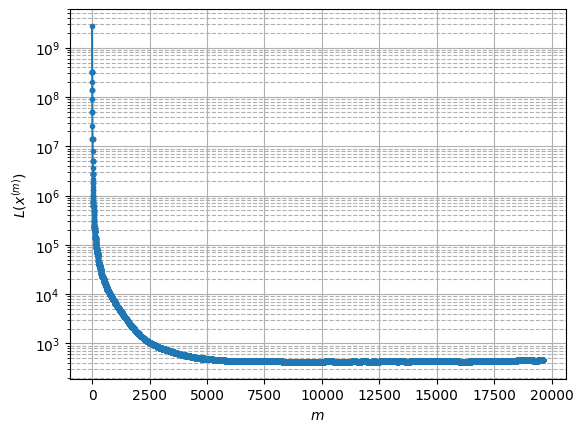

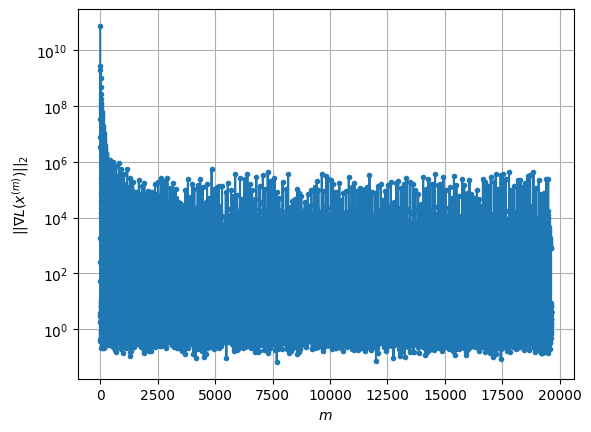

Windows:  59%|█████▉    | 175/296 [11:35:24<8:28:02, 251.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.26739189909574
Gradient norm: 144127.21189207298
Global relative error: 1.0114641580648398
Position relative errors: 0.011762106009640453 m, 0.24765119160964186 m, 0.412146614100858 m, 0.889785547958183 m

STOP on Iteration 1
Cost function = 457.9820043598931 (-0.06%)
Gradient norm = 0.9644979810760625 (-100.00%)
Global relative error = 1.0307868665538995 (1.91%)
Final position relative errors: 0.01832003666421837 m, 0.292013450839838 m, 0.41826099012983264 m, 0.8955247856312324 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.88032848440815
Gradient norm: 23477.934496472448
Global relative error: 1.0307868665538995
Position relative errors: 0.01832003666421837 m, 0.292013450839838 m, 0.41826099012983264 m, 0.8955247856312324 m

Iteration 1
Cost function: 457.82758947897327 (-0.01%)
Gradient norm: 2.8680859967581878 (-99.99%)
Global relative error = 1.041133

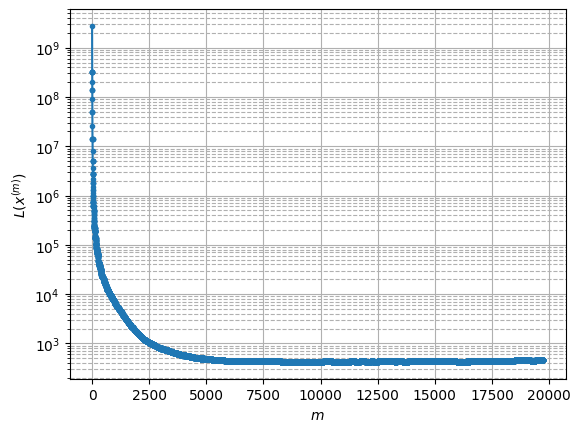

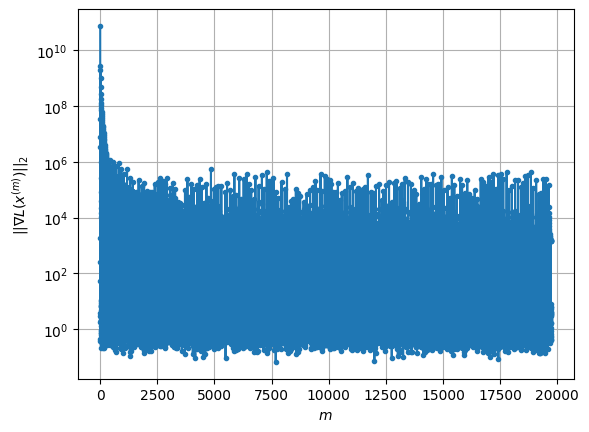

Windows:  59%|█████▉    | 176/296 [11:39:38<8:24:58, 252.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.33650942413664
Gradient norm: 80044.44539649016
Global relative error: 1.1643362758954627
Position relative errors: 0.017959938710305372 m, 0.3528011144861215 m, 0.42397396817566263 m, 1.0252446710085894 m

Iteration 1
Cost function: 456.9528152103332 (-0.08%)
Gradient norm: 5.115252257611142 (-99.99%)
Global relative error = 1.1416306268459813 (-1.95%)
Position relative errors: 0.015123038312818313 m, 0.2835525338395585 m, 0.42023501996955726 m, 1.0227830199926604 m

Iteration 2
Cost function: 456.95281453117116 (-0.00%)
Gradient norm: 1.847682278558203 (-63.88%)
Global relative error = 1.1416306247179142 (-0.00%)
Position relative errors: 0.015123042366543627 m, 0.283552525418853 m, 0.42023501916171657 m, 1.0227830202238193 m

Iteration 3
Cost function: 456.9528155101045 (0.00%)
Gradient norm: 5.283401633439945 (185.95%)
Global relative error = 1.141630621557606 (-0.00%)
Position relative errors: 

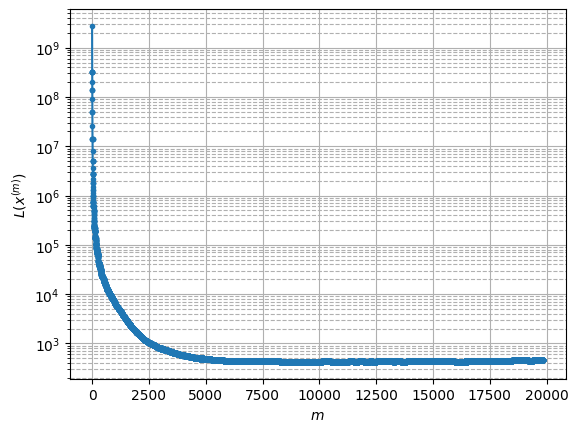

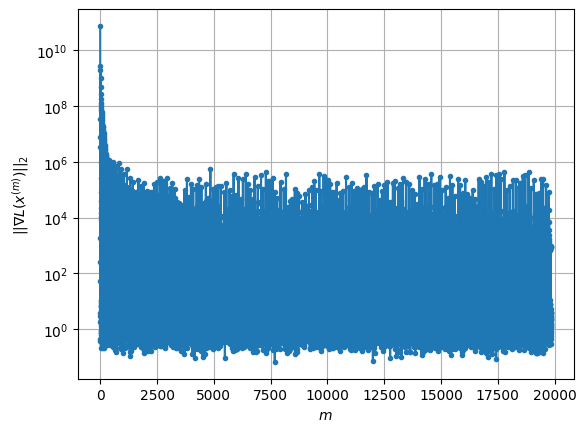

Windows:  60%|█████▉    | 177/296 [11:43:43<8:16:05, 250.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.8529986578821
Gradient norm: 158295.68573964108
Global relative error: 1.268164477469319
Position relative errors: 0.01329840432058265 m, 0.2757415366075285 m, 0.3507558065609516 m, 1.1870106700502872 m

Iteration 1
Cost function: 459.7811056959294 (-0.02%)
Gradient norm: 5.8957987291415455 (-100.00%)
Global relative error = 1.2676578163025616 (-0.04%)
Position relative errors: 0.013005624821694352 m, 0.27735644804809717 m, 0.34749755096266244 m, 1.1870548067715583 m

Iteration 2
Cost function: 459.7811052787714 (-0.00%)
Gradient norm: 3.5043202774310886 (-40.56%)
Global relative error = 1.2676578167349055 (0.00%)
Position relative errors: 0.013005621990503459 m, 0.27735644769862655 m, 0.3474975527315851 m, 1.1870548068280993 m

Iteration 3
Cost function: 459.7811053686819 (0.00%)
Gradient norm: 3.6086776154647167 (2.98%)
Global relative error = 1.2676578166499661 (-0.00%)
Position relative errors: 

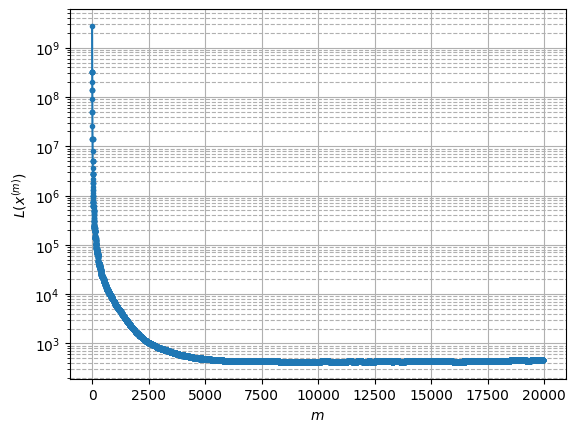

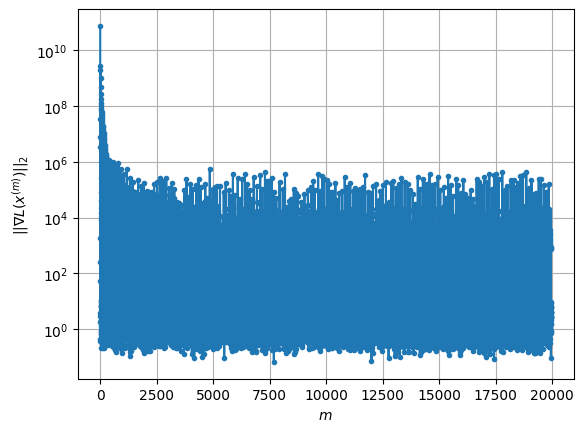

Windows:  60%|██████    | 178/296 [11:47:36<8:02:17, 245.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 461.0119995956004
Gradient norm: 286634.59321321617
Global relative error: 1.4652973832475233
Position relative errors: 0.013313627618678605 m, 0.4047157218577682 m, 0.34954676943082497 m, 1.3641608301123394 m

Iteration 1
Cost function: 460.76839567490146 (-0.05%)
Gradient norm: 7.987539795552345 (-100.00%)
Global relative error = 1.4622305551888901 (-0.21%)
Position relative errors: 0.021097582840492613 m, 0.39571628356718785 m, 0.32661501679922106 m, 1.3690864578731554 m

Iteration 2
Cost function: 460.7683954777019 (-0.00%)
Gradient norm: 8.581462433650202 (7.44%)
Global relative error = 1.4622305582358524 (0.00%)
Position relative errors: 0.02109758752341687 m, 0.39571628467645525 m, 0.32661502833457556 m, 1.3690864579827045 m

Iteration 3
Cost function: 460.76839581831683 (0.00%)
Gradient norm: 1.2689171174279839 (-85.21%)
Global relative error = 1.4622305560636917 (-0.00%)
Position relative error

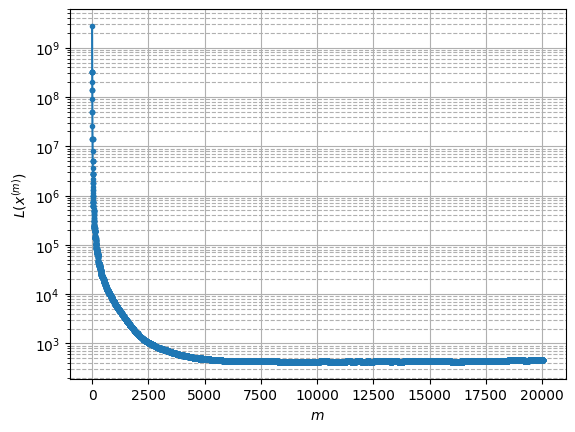

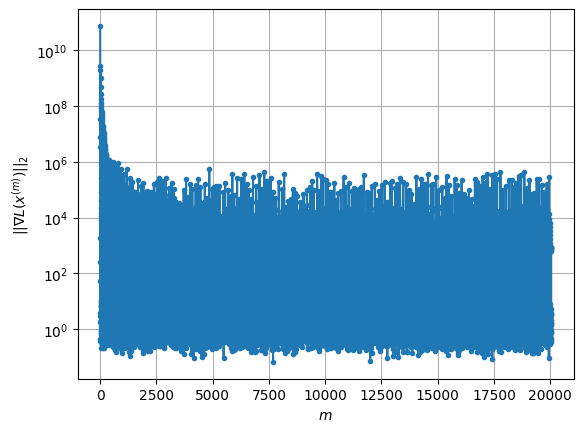

Windows:  60%|██████    | 179/296 [11:51:00<7:34:07, 232.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.8714034664779
Gradient norm: 50999.07185651189
Global relative error: 1.6501121562212464
Position relative errors: 0.01895336106945038 m, 0.49392653133742237 m, 0.2221871197043791 m, 1.5585808629683489 m

Iteration 1
Cost function: 458.7055544496914 (-0.04%)
Gradient norm: 4.014578514375282 (-99.99%)
Global relative error = 1.6502749656519626 (0.01%)
Position relative errors: 0.02049128175522614 m, 0.49672076480504496 m, 0.1931281464151686 m, 1.561714293004029 m

Iteration 2
Cost function: 458.70555440043483 (-0.00%)
Gradient norm: 3.3745584085034346 (-15.94%)
Global relative error = 1.6502749661002514 (0.00%)
Position relative errors: 0.020491285345004173 m, 0.4967207656468072 m, 0.19312814787853633 m, 1.5617142929819388 m

STOP on Iteration 3
Cost function = 458.7055536511503 (-0.00%)
Gradient norm = 0.30906156783785266 (-90.84%)
Global relative error = 1.6502749654294087 (-0.00%)
Final position r

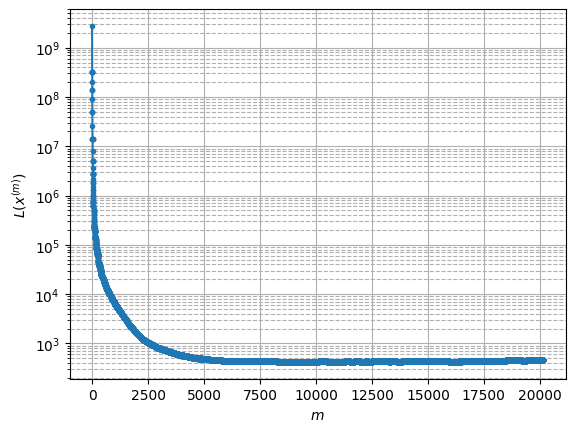

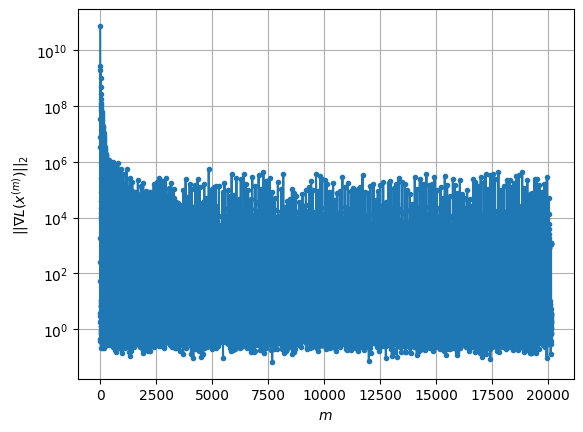

Windows:  61%|██████    | 180/296 [11:54:48<7:27:06, 231.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.37640435859817
Gradient norm: 35250.33654961451
Global relative error: 1.8573949749553063
Position relative errors: 0.018069001579276184 m, 0.6227421792611398 m, 0.12828514914792216 m, 1.7450843352402172 m

STOP on Iteration 1
Cost function = 456.2278942638471 (-0.03%)
Gradient norm = 0.8390994722790007 (-100.00%)
Global relative error = 1.863365670083343 (0.32%)
Final position relative errors: 0.014754276373661316 m, 0.6244181254451779 m, 0.1486225832319134 m, 1.7492632464658573 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 456.16516327349683
Gradient norm: 6886.475045794065
Global relative error: 1.863365670083343
Position relative errors: 0.014754276373661316 m, 0.6244181254451779 m, 0.1486225832319134 m, 1.7492632464658573 m

Iteration 1
Cost function: 456.1300994864005 (-0.01%)
Gradient norm: 1.945995880760733 (-99.97%)
Global relative error = 1.86943678

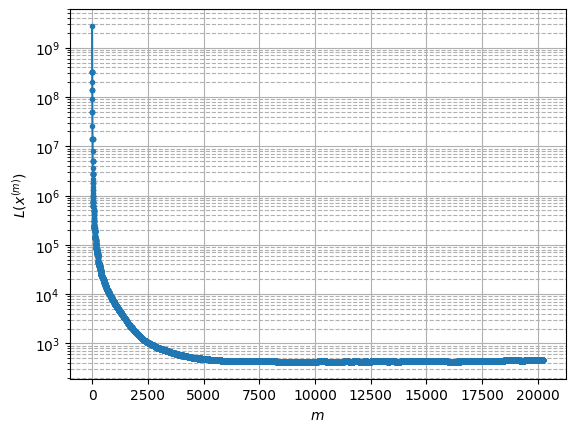

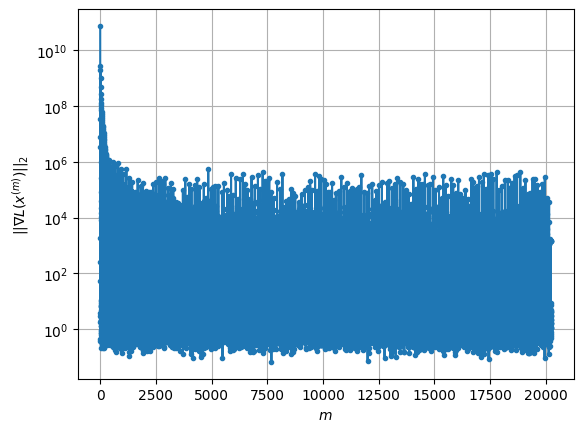

Windows:  61%|██████    | 181/296 [11:58:14<7:08:29, 223.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.03497193076754
Gradient norm: 91265.36693974929
Global relative error: 2.089826328776113
Position relative errors: 0.014900227822203797 m, 0.7591379711110314 m, 0.09889791011869466 m, 1.9444989580086143 m

Iteration 1
Cost function: 456.80441628565234 (-0.05%)
Gradient norm: 6.878221054985538 (-99.99%)
Global relative error = 2.0929362434621788 (0.15%)
Position relative errors: 0.018503236622552443 m, 0.7674603952902193 m, 0.0564770494478647 m, 1.9462399706963907 m

Iteration 2
Cost function: 456.804415433128 (-0.00%)
Gradient norm: 2.8970680806863367 (-57.88%)
Global relative error = 2.0929362430262746 (-0.00%)
Position relative errors: 0.01850323636641034 m, 0.7674603935105523 m, 0.0564770447641323 m, 1.9462399710677574 m

Iteration 3
Cost function: 456.80441625547303 (0.00%)
Gradient norm: 2.7984710270759816 (-3.40%)
Global relative error = 2.0929362434404437 (0.00%)
Position relative errors: 0.0

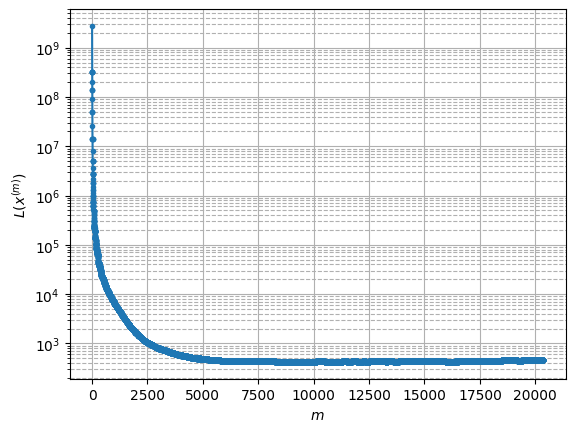

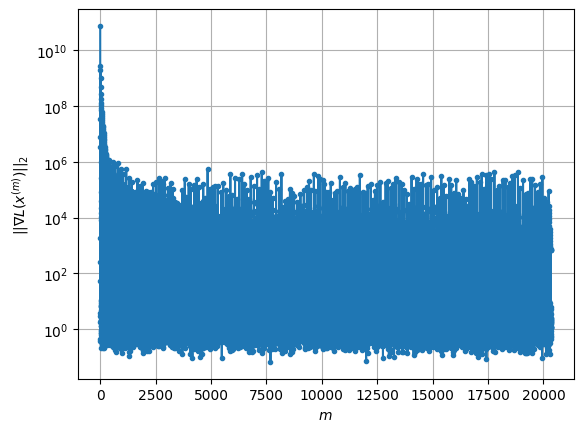

Windows:  61%|██████▏   | 182/296 [12:02:30<7:23:21, 233.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.5214683352821
Gradient norm: 181410.7970654311
Global relative error: 2.2851694376915805
Position relative errors: 0.018976710952910734 m, 0.9468715102717008 m, 0.10122311363258092 m, 2.077215327450533 m

Iteration 1
Cost function: 458.41879103609307 (-0.02%)
Gradient norm: 7.324253866426535 (-100.00%)
Global relative error = 2.290578679236623 (0.24%)
Position relative errors: 0.01608576920949538 m, 0.9579351651224342 m, 0.09734063131139718 m, 2.0783101308262535 m

Iteration 2
Cost function: 458.4187900933852 (-0.00%)
Gradient norm: 5.723461109595668 (-21.86%)
Global relative error = 2.2905786790038163 (-0.00%)
Position relative errors: 0.01608577814261421 m, 0.9579351642204039 m, 0.0973406347714603 m, 2.078310130754236 m

Iteration 3
Cost function: 458.4187907979321 (0.00%)
Gradient norm: 3.8719002899772894 (-32.35%)
Global relative error = 2.2905786796708183 (0.00%)
Position relative errors: 0.016

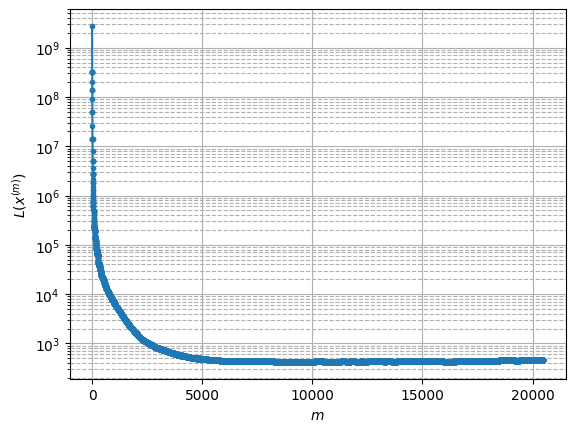

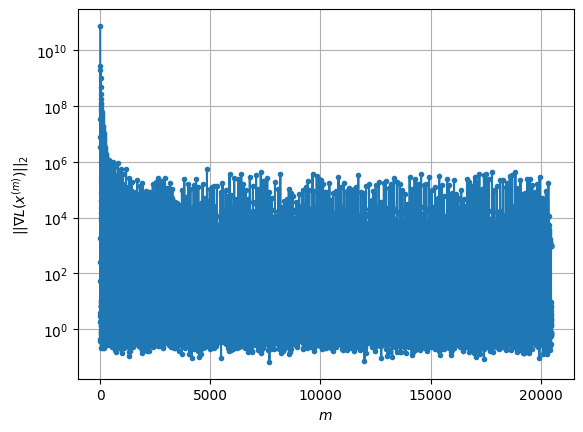

Windows:  62%|██████▏   | 183/296 [12:07:13<7:47:50, 248.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.43002501387497
Gradient norm: 153402.50475378678
Global relative error: 2.4751209618197993
Position relative errors: 0.01594956403996267 m, 1.132041564891964 m, 0.12348246826706365 m, 2.1975441107693223 m

Iteration 1
Cost function: 453.2581993955577 (-0.04%)
Gradient norm: 7.568735896075447 (-100.00%)
Global relative error = 2.4765136876280853 (0.06%)
Position relative errors: 0.01126295497913676 m, 1.1294227414053666 m, 0.15596612774639215 m, 2.1984241639535935 m

Iteration 2
Cost function: 453.25819805579164 (-0.00%)
Gradient norm: 7.050972608483231 (-6.84%)
Global relative error = 2.476513687732808 (0.00%)
Position relative errors: 0.01126295993170432 m, 1.1294227400010746 m, 0.15596613341230067 m, 2.198424164365669 m

Iteration 3
Cost function: 453.2581995514485 (0.00%)
Gradient norm: 2.2556965062418457 (-68.01%)
Global relative error = 2.476513688030547 (0.00%)
Position relative errors: 0.0112

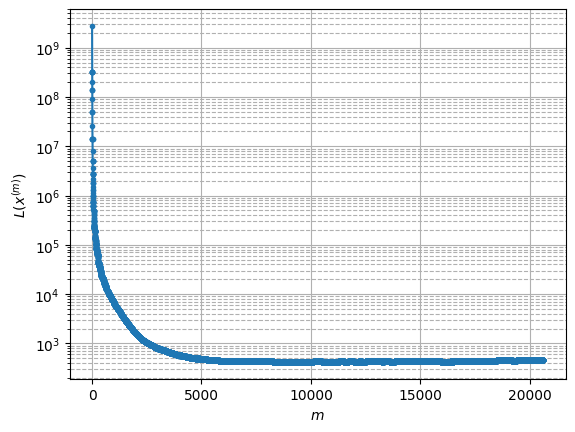

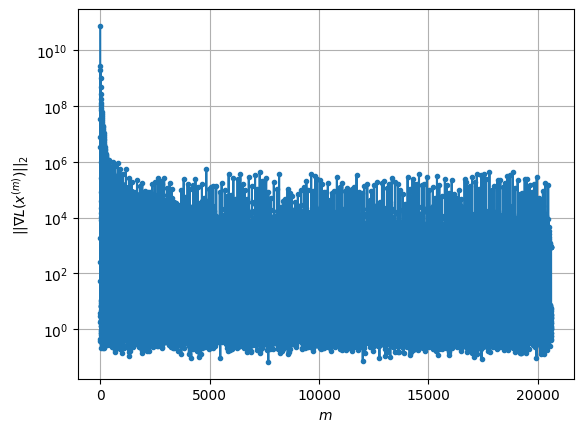

Windows:  62%|██████▏   | 184/296 [12:12:21<8:16:53, 266.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.5598248088514
Gradient norm: 236091.04735187444
Global relative error: 2.6235304989284245
Position relative errors: 0.010436346438972864 m, 1.2634421312781607 m, 0.1640016025925823 m, 2.293385775199073 m

Iteration 1
Cost function: 455.3683370636677 (-0.04%)
Gradient norm: 5.621319759882682 (-100.00%)
Global relative error = 2.626101568175021 (0.10%)
Position relative errors: 0.009716811466429524 m, 1.2637147567012512 m, 0.1779272794814288 m, 2.295142574011849 m

Iteration 2
Cost function: 455.3683369721636 (-0.00%)
Gradient norm: 6.350274732309777 (12.97%)
Global relative error = 2.6261015679238113 (-0.00%)
Position relative errors: 0.009716814011582767 m, 1.2637147567478244 m, 0.17792727006860348 m, 2.295142574417712 m

Iteration 3
Cost function: 455.36833688934536 (-0.00%)
Gradient norm: 4.208331745160403 (-33.73%)
Global relative error = 2.6261015680447666 (0.00%)
Position relative errors: 0.009

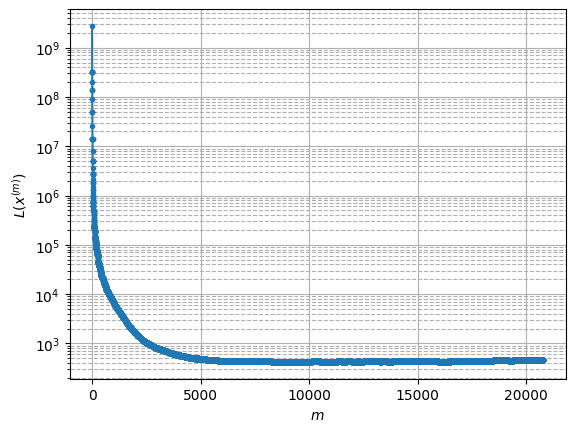

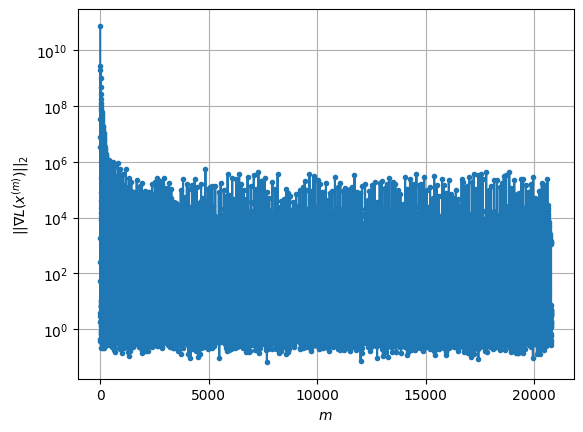

Windows:  62%|██████▎   | 185/296 [12:18:41<9:15:40, 300.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.5593710362772
Gradient norm: 126153.56579462712
Global relative error: 2.760192891387146
Position relative errors: 0.009327640251767872 m, 1.3894402454599128 m, 0.18541344113867708 m, 2.3777412740764876 m

STOP on Iteration 1
Cost function = 452.20662648777716 (-0.08%)
Gradient norm = 0.5288342578016504 (-100.00%)
Global relative error = 2.762760090844757 (0.09%)
Final position relative errors: 0.023284673617564165 m, 1.3904983102637916 m, 0.19694568169440835 m, 2.3790809392319363 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 452.18209853942744
Gradient norm: 14246.680225595892
Global relative error: 2.762760090844757
Position relative errors: 0.023284673617564165 m, 1.3904983102637916 m, 0.19694568169440835 m, 2.3790809392319363 m

Iteration 1
Cost function: 452.16683289486855 (-0.00%)
Gradient norm: 4.294463944280933 (-99.97%)
Global relative error = 2.7652

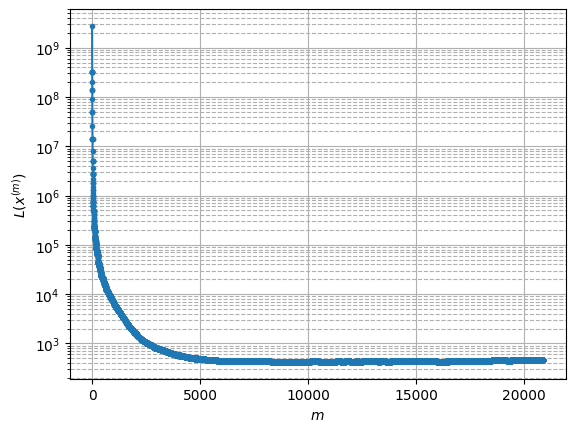

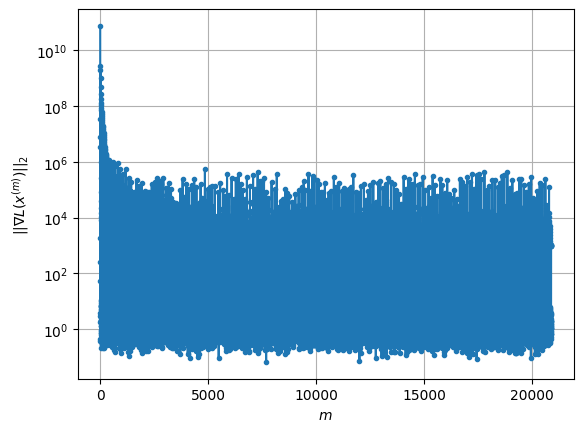

Windows:  63%|██████▎   | 186/296 [12:22:24<8:28:04, 277.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.78060568362474
Gradient norm: 69802.76252370537
Global relative error: 2.8653494487904765
Position relative errors: 0.02181753823610902 m, 1.4903676782099833 m, 0.1659393811330995 m, 2.441519694795647 m

Iteration 1
Cost function: 452.66010502137135 (-0.03%)
Gradient norm: 3.1667184756271816 (-100.00%)
Global relative error = 2.8686714119048284 (0.12%)
Position relative errors: 0.020873012904849872 m, 1.4938747208224705 m, 0.14853137528735397 m, 2.4444049157671386 m

Iteration 2
Cost function: 452.66010596221076 (0.00%)
Gradient norm: 7.327229718688877 (131.38%)
Global relative error = 2.8686714126924526 (0.00%)
Position relative errors: 0.020873007219850307 m, 1.4938747209582663 m, 0.14853137720222742 m, 2.444404916540667 m

Iteration 3
Cost function: 452.6601045677258 (-0.00%)
Gradient norm: 1.7653782630907773 (-75.91%)
Global relative error = 2.8686714116489007 (-0.00%)
Position relative errors: 

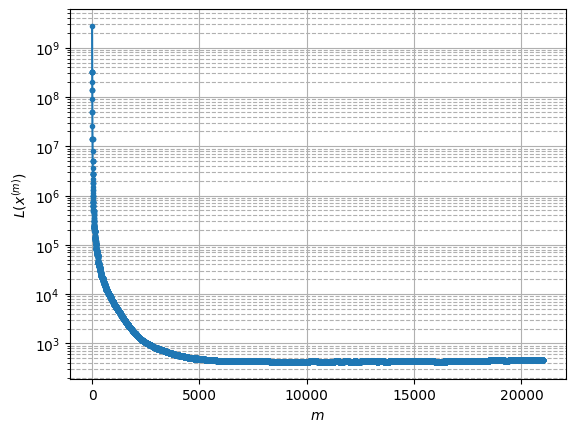

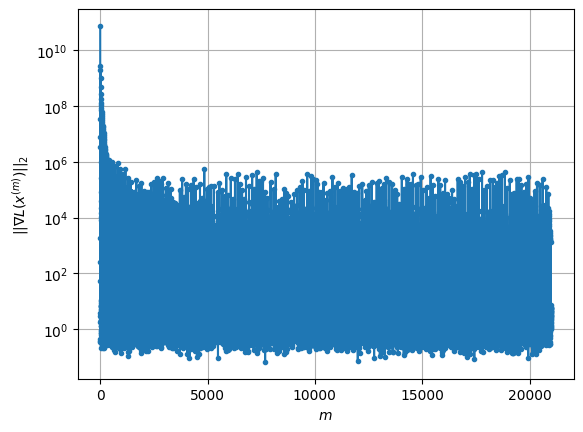

Windows:  63%|██████▎   | 187/296 [12:27:14<8:30:30, 281.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.5747300896592
Gradient norm: 113865.49047469166
Global relative error: 2.9815152259065485
Position relative errors: 0.020886703810236724 m, 1.5980057318752638 m, 0.18690166204262013 m, 2.510067963988428 m

Iteration 1
Cost function: 448.363777189571 (-0.05%)
Gradient norm: 5.1922901154935985 (-100.00%)
Global relative error = 2.987248484081975 (0.19%)
Position relative errors: 0.01715362798142718 m, 1.5993126272460958 m, 0.1962387721844559 m, 2.5153623320101786 m

STOP on Iteration 2
Cost function = 448.3637765874987 (-0.00%)
Gradient norm = 0.9870635410495031 (-80.99%)
Global relative error = 2.987248483703441 (-0.00%)
Final position relative errors: 0.017153627753928133 m, 1.599312627344577 m, 0.19623877607846252 m, 2.515362331195772 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 448.3149678228324
Gradient norm: 23680.272048311348
Global relative error: 2.98

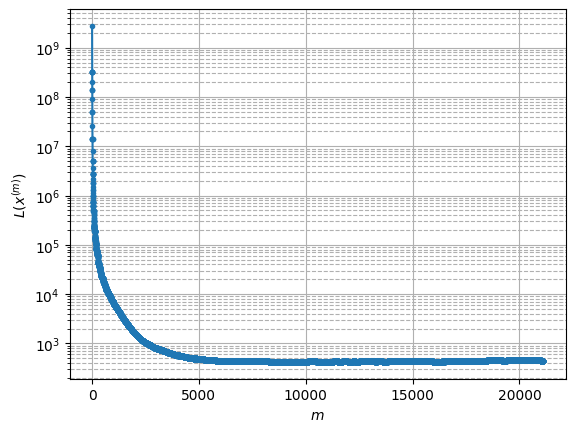

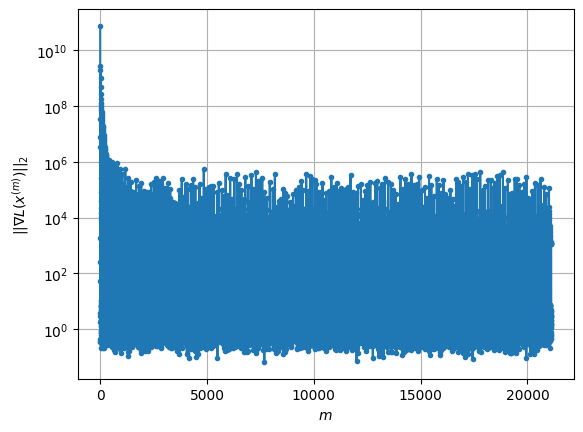

Windows:  64%|██████▎   | 188/296 [12:30:59<7:55:21, 264.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.76677167227217
Gradient norm: 292061.1821446114
Global relative error: 3.087928128741673
Position relative errors: 0.01681246850806909 m, 1.6700111889446119 m, 0.23783432275125962 m, 2.586409494297002 m

Iteration 1
Cost function: 448.41308902539595 (-0.08%)
Gradient norm: 1.5675851454958427 (-100.00%)
Global relative error = 3.0910918321934195 (0.10%)
Position relative errors: 0.027078241050734742 m, 1.6692705572097288 m, 0.2516895414023052 m, 2.589266847614298 m

Iteration 2
Cost function: 448.41308872965294 (-0.00%)
Gradient norm: 2.3493118541425626 (49.87%)
Global relative error = 3.0910918304858757 (-0.00%)
Position relative errors: 0.02707824786345124 m, 1.6692705566900037 m, 0.25168952539293155 m, 2.5892668473958245 m

Iteration 3
Cost function: 448.4130890716143 (0.00%)
Gradient norm: 3.7347917871778584 (58.97%)
Global relative error = 3.091091831377468 (0.00%)
Position relative errors: 0.02

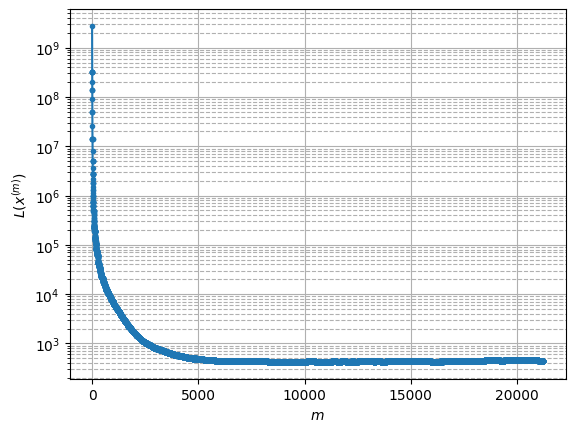

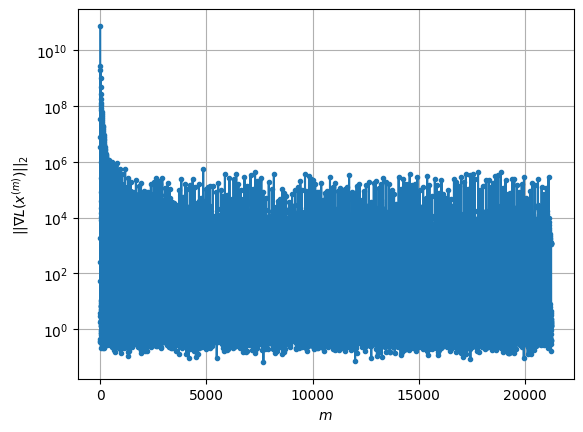

Windows:  64%|██████▍   | 189/296 [12:35:34<7:57:03, 267.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 444.98118473402457
Gradient norm: 214956.03275854947
Global relative error: 3.1470745043639807
Position relative errors: 0.025344986181858688 m, 1.7044080117164444 m, 0.2534297348062022 m, 2.633287200823548 m

Iteration 1
Cost function: 444.72722802988125 (-0.06%)
Gradient norm: 3.178491311383532 (-100.00%)
Global relative error = 3.150416730816872 (0.11%)
Position relative errors: 0.036722409276062025 m, 1.7022287388666273 m, 0.23806062617444676 m, 2.639984985622311 m

Iteration 2
Cost function: 444.727229341505 (0.00%)
Gradient norm: 1.625908838381074 (-48.85%)
Global relative error = 3.1504167307051008 (-0.00%)
Position relative errors: 0.03672240654322583 m, 1.7022287385543113 m, 0.23806062839327763 m, 2.6399849855282373 m

STOP on Iteration 3
Cost function = 444.72722939904145 (0.00%)
Gradient norm = 0.6274518306715358 (-61.41%)
Global relative error = 3.150416728932997 (-0.00%)
Final position rela

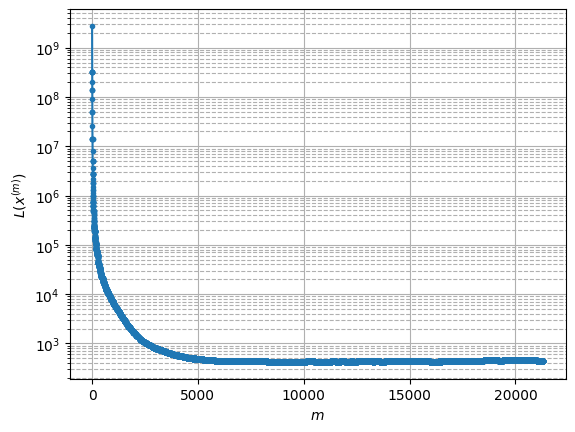

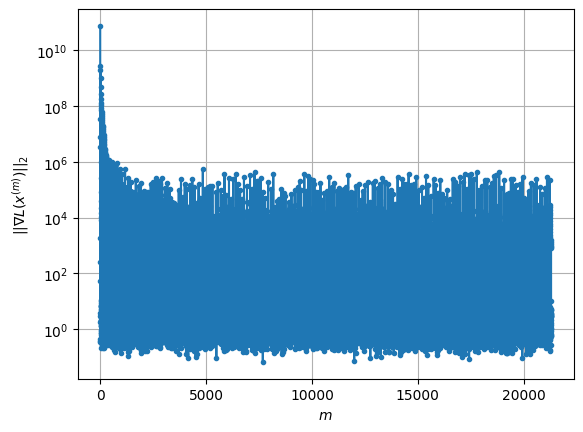

Windows:  64%|██████▍   | 190/296 [12:38:19<6:57:56, 236.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 445.7297865408392
Gradient norm: 335315.8125444384
Global relative error: 3.184409736172497
Position relative errors: 0.03421796699494065 m, 1.7065017885899858 m, 0.20556655918737027 m, 2.6804640876148857 m

Iteration 1
Cost function: 445.38956125503637 (-0.08%)
Gradient norm: 1.4293246261233319 (-100.00%)
Global relative error = 3.1879220030308857 (0.11%)
Position relative errors: 0.034299075031867875 m, 1.7059473426973961 m, 0.2281740303039149 m, 2.683160400357132 m

STOP on Iteration 2
Cost function = 445.3895614636714 (0.00%)
Gradient norm = 0.8257375689544368 (-42.23%)
Global relative error = 3.18792200235635 (-0.00%)
Final position relative errors: 0.03429907214265451 m, 1.7059473426709548 m, 0.2281740296343602 m, 2.683160399666387 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 445.30461198516434
Gradient norm: 23534.285908817514
Global relative error: 3.187

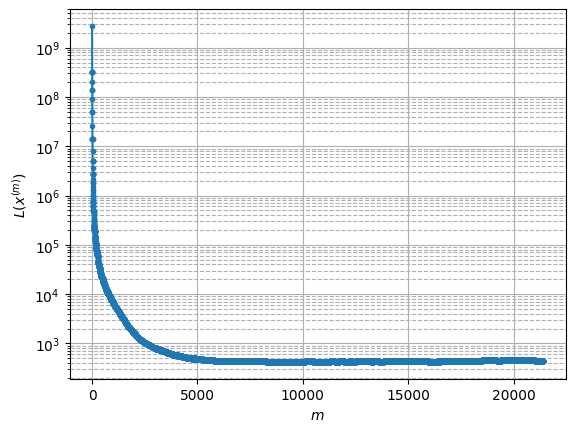

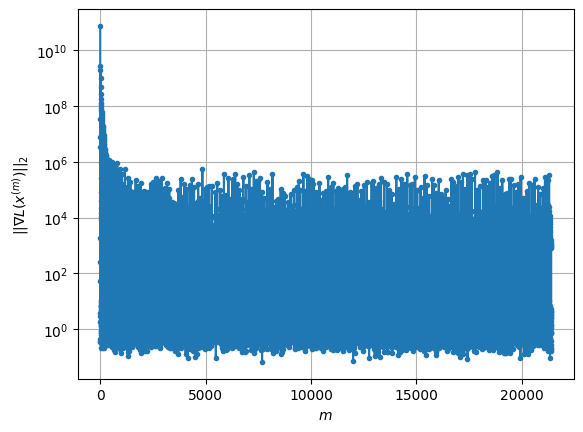

Windows:  65%|██████▍   | 191/296 [12:41:52<6:42:00, 229.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.8175379099151
Gradient norm: 315182.10912170936
Global relative error: 3.1869945469393204
Position relative errors: 0.03186488476874589 m, 1.6846873252142678 m, 0.21463916618165238 m, 2.696604618094772 m

Iteration 1
Cost function: 448.4988737337774 (-0.07%)
Gradient norm: 5.193035875979215 (-100.00%)
Global relative error = 3.187552154112076 (0.02%)
Position relative errors: 0.03031554961244674 m, 1.6799822767872876 m, 0.2022242413102248 m, 2.7011726274054793 m

Iteration 2
Cost function: 448.49887244701307 (-0.00%)
Gradient norm: 4.135285674062529 (-20.37%)
Global relative error = 3.1875521554539894 (0.00%)
Position relative errors: 0.030315556557387498 m, 1.6799822775765305 m, 0.20222424171282763 m, 2.7011726283900694 m

STOP on Iteration 3
Cost function = 448.4988733412244 (0.00%)
Gradient norm = 0.5287748385848431 (-87.21%)
Global relative error = 3.1875521553220834 (-0.00%)
Final position rela

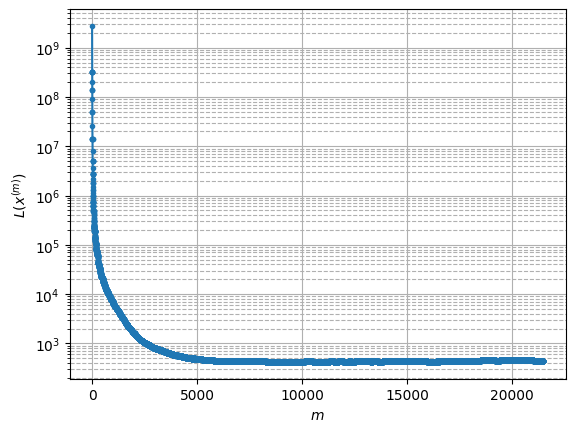

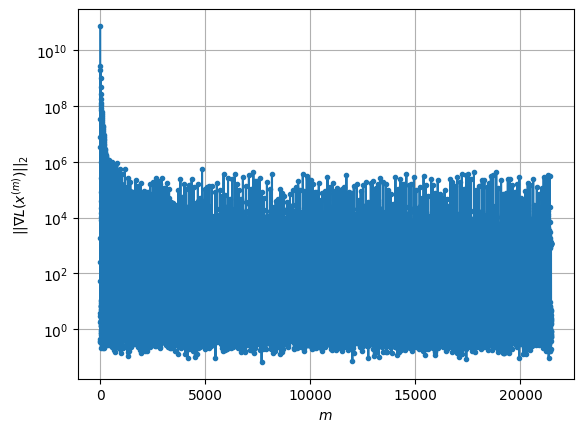

Windows:  65%|██████▍   | 192/296 [12:44:20<5:55:24, 205.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.49086469028833
Gradient norm: 103675.50638327433
Global relative error: 3.1849575480431245
Position relative errors: 0.029537473806123045 m, 1.6328342407378311 m, 0.22501397590632974 m, 2.725124141808314 m

Iteration 1
Cost function: 454.251217579642 (-0.05%)
Gradient norm: 2.1405855458382286 (-100.00%)
Global relative error = 3.1855898849527624 (0.02%)
Position relative errors: 0.03044497271586657 m, 1.6315221826615594 m, 0.24845832978060736 m, 2.7246024020554755 m

Iteration 2
Cost function: 454.2512173554875 (-0.00%)
Gradient norm: 2.8237759692358115 (31.92%)
Global relative error = 3.1855898848722495 (-0.00%)
Position relative errors: 0.030444972625829347 m, 1.6315221830037725 m, 0.2484583266314088 m, 2.724602402044603 m

Iteration 3
Cost function: 454.25121685398295 (-0.00%)
Gradient norm: 3.635468858226347 (28.74%)
Global relative error = 3.185589884130853 (-0.00%)
Position relative errors: 0.

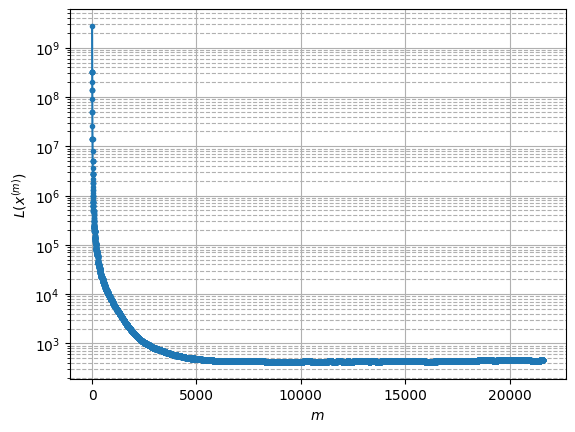

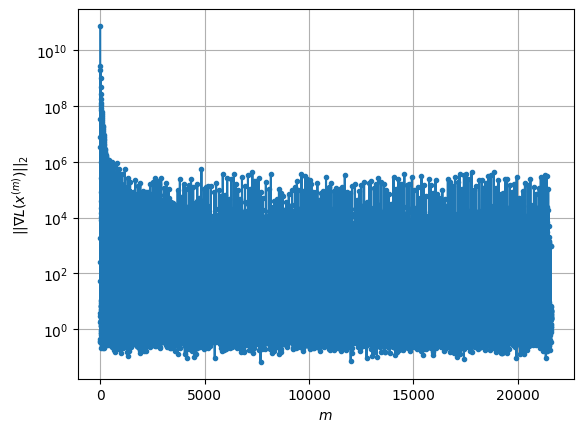

Windows:  65%|██████▌   | 193/296 [12:49:32<6:47:16, 237.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.93526727312445
Gradient norm: 124328.83064567344
Global relative error: 3.122630688596243
Position relative errors: 0.02935587330761424 m, 1.5995264384687615 m, 0.2719198703781901 m, 2.6678705174919766 m

STOP on Iteration 1
Cost function = 454.66201725588706 (-0.06%)
Gradient norm = 0.4685247101321231 (-100.00%)
Global relative error = 3.1267119886655124 (0.13%)
Final position relative errors: 0.022344295547670107 m, 1.6004453856109457 m, 0.2723084508798199 m, 2.672124423857718 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.56698807315496
Gradient norm: 19449.950742410954
Global relative error: 3.1267119886655124
Position relative errors: 0.022344295547670107 m, 1.6004453856109457 m, 0.2723084508798199 m, 2.672124423857718 m

Iteration 1
Cost function: 454.51970971759704 (-0.01%)
Gradient norm: 2.6912119831248162 (-99.99%)
Global relative error = 3.129907

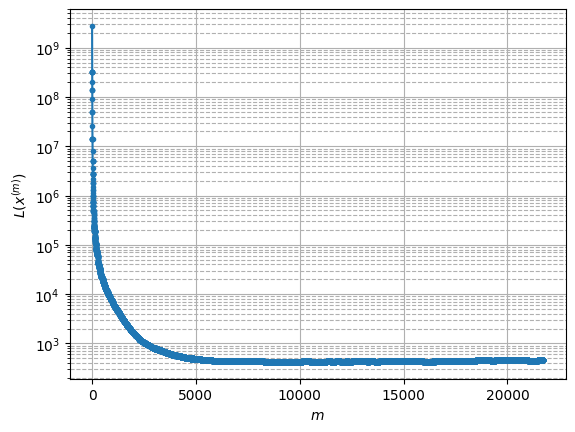

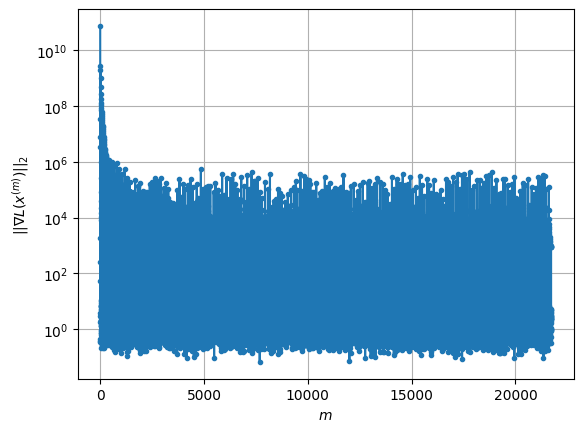

Windows:  66%|██████▌   | 194/296 [12:53:44<6:50:56, 241.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.3420573206314
Gradient norm: 75706.06538810072
Global relative error: 3.069062416987131
Position relative errors: 0.02157215815617753 m, 1.5504489554297511 m, 0.27711211785883066 m, 2.6340069280976457 m

STOP on Iteration 1
Cost function = 455.064040859823 (-0.06%)
Gradient norm = 0.9467498933012259 (-100.00%)
Global relative error = 3.074467615679939 (0.18%)
Final position relative errors: 0.020652678950673155 m, 1.5539936665952352 m, 0.3096659505983708 m, 2.634602826481615 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.94879199344376
Gradient norm: 24271.470246650944
Global relative error: 3.074467615679939
Position relative errors: 0.020652678950673155 m, 1.5539936665952352 m, 0.3096659505983708 m, 2.634602826481615 m

STOP on Iteration 1
Cost function = 454.8914744632764 (-0.01%)
Gradient norm = 0.5732485468867652 (-100.00%)
Global relative error = 3.0

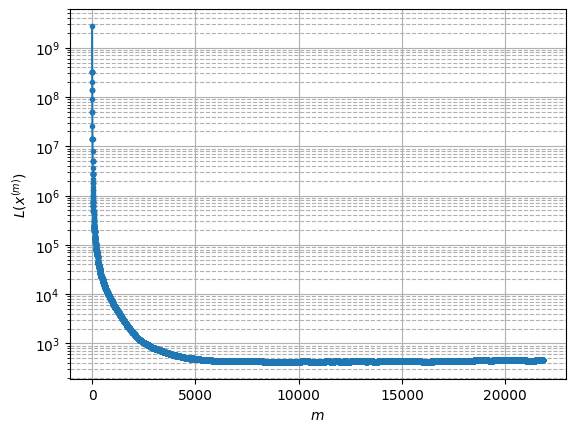

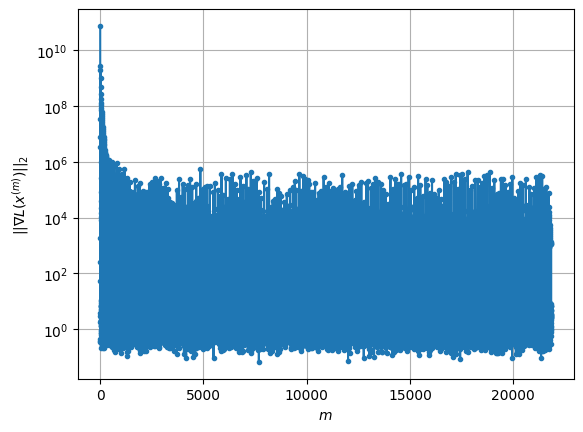

Windows:  66%|██████▌   | 195/296 [12:58:03<6:55:42, 246.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.45082579332114
Gradient norm: 106758.24136210105
Global relative error: 2.967205057599249
Position relative errors: 0.01963837096066217 m, 1.4921917526123796 m, 0.3109548705771549 m, 2.5456996877785785 m

STOP on Iteration 1
Cost function = 457.332394678285 (-0.03%)
Gradient norm = 0.4410507383965049 (-100.00%)
Global relative error = 2.9649674290929506 (-0.08%)
Final position relative errors: 0.025554942141605155 m, 1.4900829006713179 m, 0.29107708667457954 m, 2.5466255633789365 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.2988294662439
Gradient norm: 13935.048724139699
Global relative error: 2.9649674290929506
Position relative errors: 0.025554942141605155 m, 1.4900829006713179 m, 0.29107708667457954 m, 2.5466255633789365 m

STOP on Iteration 1
Cost function = 457.28152693758955 (-0.00%)
Gradient norm = 0.3364362759387238 (-100.00%)
Global relative err

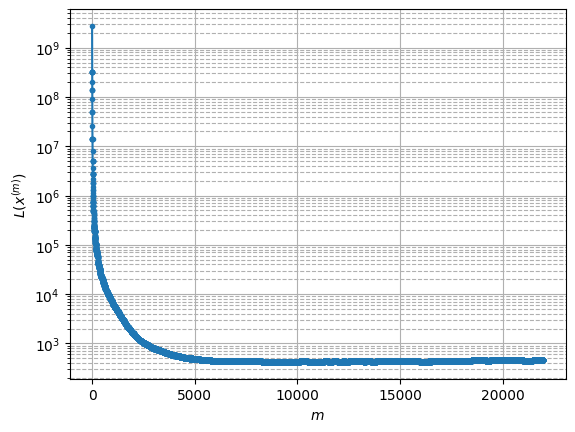

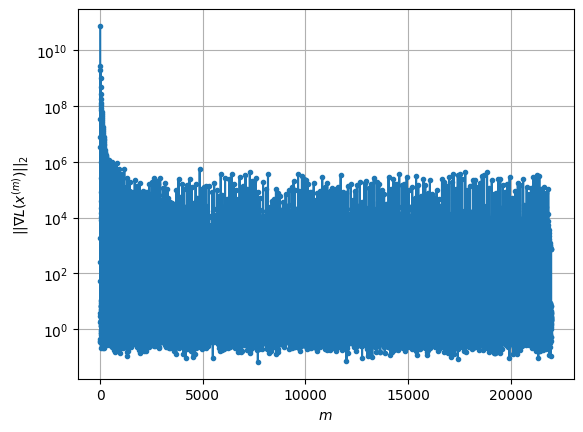

Windows:  66%|██████▌   | 196/296 [13:03:27<7:29:54, 269.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.94601431124096
Gradient norm: 85004.40730422508
Global relative error: 2.844928130929815
Position relative errors: 0.023933929796963745 m, 1.4380663208196274 m, 0.2541450607405362 m, 2.441395838325649 m

STOP on Iteration 1
Cost function = 457.7993656884964 (-0.03%)
Gradient norm = 0.3021519578797772 (-100.00%)
Global relative error = 2.841420474391196 (-0.12%)
Final position relative errors: 0.022181366448930224 m, 1.4336714870341194 m, 0.24155288652010104 m, 2.4411905776062697 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.7466227118011
Gradient norm: 20394.566609765996
Global relative error: 2.841420474391196
Position relative errors: 0.022181366448930224 m, 1.4336714870341194 m, 0.24155288652010104 m, 2.4411905776062697 m

Iteration 1
Cost function: 457.71939320668486 (-0.01%)
Gradient norm: 2.0701060475183124 (-99.99%)
Global relative error = 2.839963

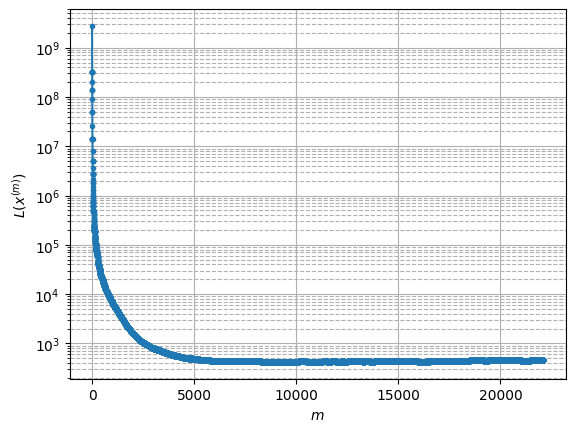

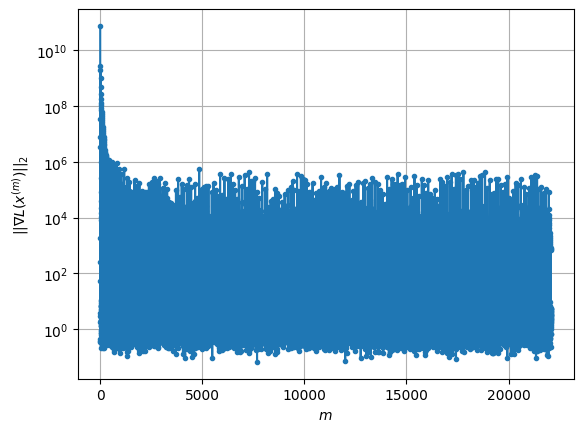

Windows:  67%|██████▋   | 197/296 [13:07:46<7:19:54, 266.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.64543881845447
Gradient norm: 68724.20649595266
Global relative error: 2.703216385305555
Position relative errors: 0.021601312389304853 m, 1.3807960808047506 m, 0.25013021262119894 m, 2.310355602435553 m

STOP on Iteration 1
Cost function = 453.4731710110023 (-0.04%)
Gradient norm = 0.9545734921510101 (-100.00%)
Global relative error = 2.705256906243208 (0.08%)
Final position relative errors: 0.033164668701339585 m, 1.3819603873209998 m, 0.24480918401316576 m, 2.312479774006909 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 453.44520010838056
Gradient norm: 12369.188593882793
Global relative error: 2.705256906243208
Position relative errors: 0.033164668701339585 m, 1.3819603873209998 m, 0.24480918401316576 m, 2.312479774006909 m

Iteration 1
Cost function: 453.43220860307576 (-0.00%)
Gradient norm: 6.504053021135296 (-99.95%)
Global relative error = 2.70687798

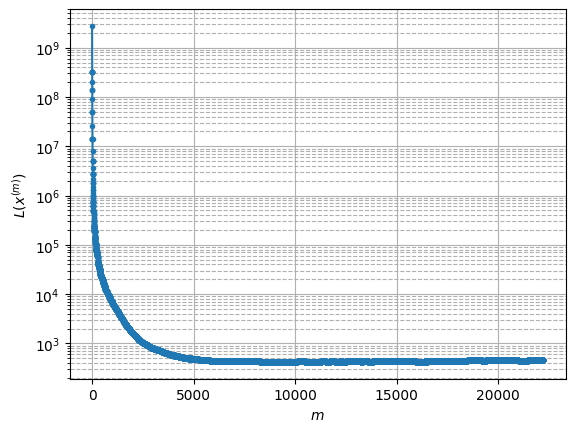

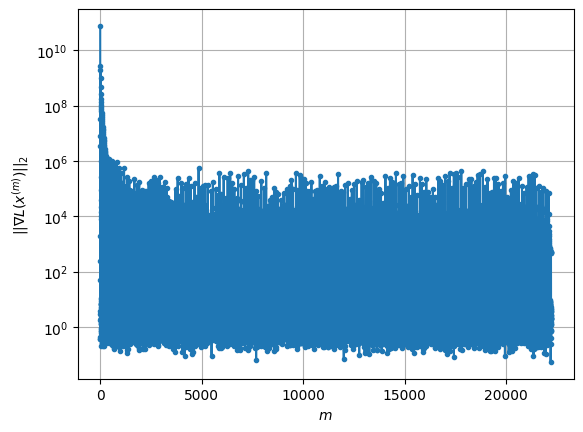

Windows:  67%|██████▋   | 198/296 [13:12:39<7:28:26, 274.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.3592038334949
Gradient norm: 370593.7211926372
Global relative error: 2.5659420117753537
Position relative errors: 0.03238912168813782 m, 1.3267048709408513 m, 0.2644205368668602 m, 2.1801233605147257 m

Iteration 1
Cost function: 458.9954413807224 (-0.08%)
Gradient norm: 3.090319491425924 (-100.00%)
Global relative error = 2.564685884931344 (-0.05%)
Position relative errors: 0.022092901509198883 m, 1.327217471987047 m, 0.2412792389482496 m, 2.181145629142535 m

STOP on Iteration 2
Cost function = 458.9954411646395 (-0.00%)
Gradient norm = 0.39880892707772975 (-87.09%)
Global relative error = 2.5646858849664502 (0.00%)
Final position relative errors: 0.022092894309258933 m, 1.327217472732883 m, 0.24127924082075916 m, 2.181145628595766 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 458.94294764828373
Gradient norm: 9068.149098053133
Global relative error: 2.564

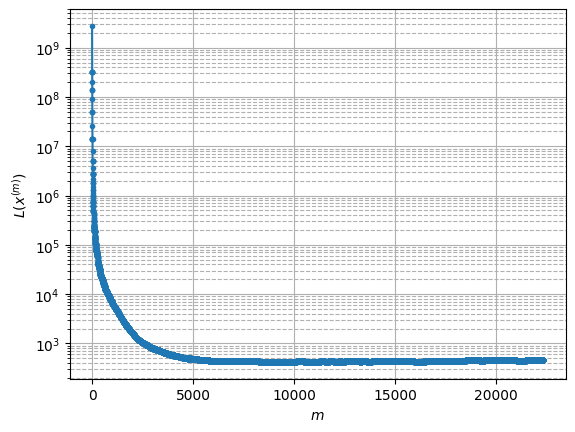

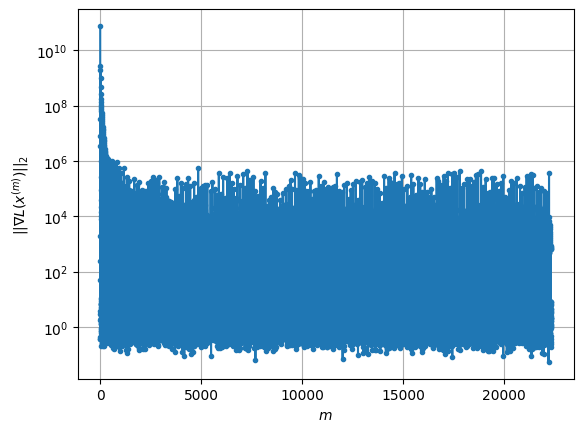

Windows:  67%|██████▋   | 199/296 [13:16:41<7:07:55, 264.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.6365980542272
Gradient norm: 82792.07309815339
Global relative error: 2.406352751281849
Position relative errors: 0.020141835468494587 m, 1.2667114450098083 m, 0.27412502709136266 m, 2.0274163127809186 m

Iteration 1
Cost function: 457.37511516354397 (-0.06%)
Gradient norm: 2.436315849102109 (-100.00%)
Global relative error = 2.3996717840706867 (-0.28%)
Position relative errors: 0.013739544374406037 m, 1.2585321203606183 m, 0.2775560798499006 m, 2.0241756076521042 m

Iteration 2
Cost function: 457.37511505648536 (-0.00%)
Gradient norm: 2.57223754271688 (5.58%)
Global relative error = 2.399671783785112 (-0.00%)
Position relative errors: 0.013739544810006466 m, 1.258532121232511 m, 0.27755607982646624 m, 2.0241756067717125 m

Iteration 3
Cost function: 457.3751148497733 (-0.00%)
Gradient norm: 5.99642324464994 (133.12%)
Global relative error = 2.39967178542203 (0.00%)
Position relative errors: 0.01373

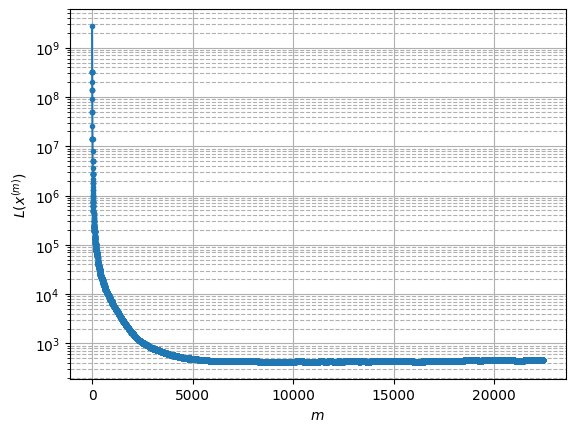

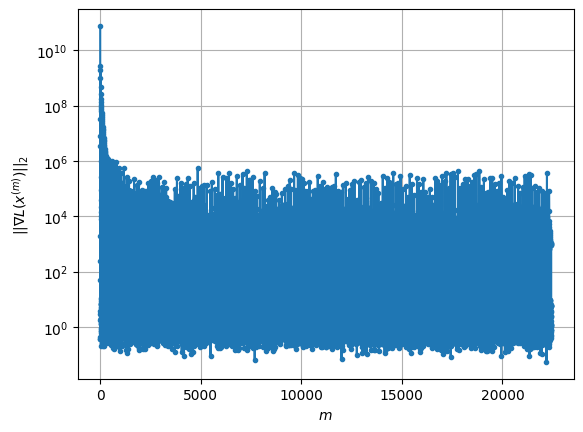

Windows:  68%|██████▊   | 200/296 [13:20:46<6:54:05, 258.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 451.58877310403494
Gradient norm: 42942.961120670756
Global relative error: 2.216760980011259
Position relative errors: 0.012866683559009932 m, 1.1773261839130047 m, 0.33729700851931277 m, 1.8476979408184764 m

Iteration 1
Cost function: 451.483056869343 (-0.02%)
Gradient norm: 2.3011777592789575 (-99.99%)
Global relative error = 2.214798164645587 (-0.09%)
Position relative errors: 0.00934125829683238 m, 1.1747696873577922 m, 0.3342270220522643 m, 1.847550358073766 m

Iteration 2
Cost function: 451.48305640201045 (-0.00%)
Gradient norm: 4.858291206623559 (111.12%)
Global relative error = 2.214798164712522 (0.00%)
Position relative errors: 0.009341255419820775 m, 1.1747696885766257 m, 0.3342270210251041 m, 1.8475503575793712 m

Iteration 3
Cost function: 451.4830567392648 (0.00%)
Gradient norm: 1.0332520298806906 (-78.73%)
Global relative error = 2.214798165070814 (0.00%)
Position relative errors: 0.0093

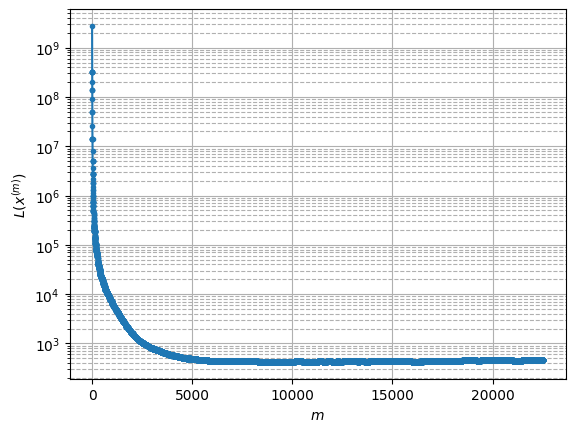

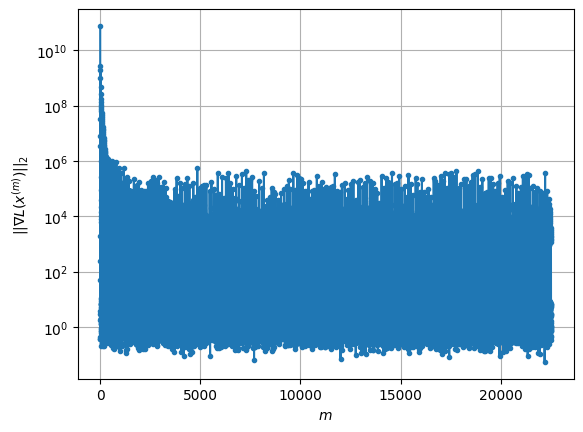

Windows:  68%|██████▊   | 201/296 [13:24:14<6:25:48, 243.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.1452267777821
Gradient norm: 86259.7933286283
Global relative error: 2.0196849114903928
Position relative errors: 0.01077385105061109 m, 1.0718922155478179 m, 0.3574154689682323 m, 1.6740075616044414 m

Iteration 1
Cost function: 448.0210285609093 (-0.03%)
Gradient norm: 2.843807359834991 (-100.00%)
Global relative error = 2.020360269244711 (0.03%)
Position relative errors: 0.008709094272738556 m, 1.0717745144566795 m, 0.36008501186745184 m, 1.6743377535436228 m

Iteration 2
Cost function: 448.0210281769578 (-0.00%)
Gradient norm: 4.508514200444149 (58.54%)
Global relative error = 2.020360269628532 (0.00%)
Position relative errors: 0.008709089604273431 m, 1.071774516191235 m, 0.3600850108348591 m, 1.6743377531427959 m

Iteration 3
Cost function: 448.02102876544143 (0.00%)
Gradient norm: 2.0648540193734104 (-54.20%)
Global relative error = 2.0203602687189615 (-0.00%)
Position relative errors: 0.00870

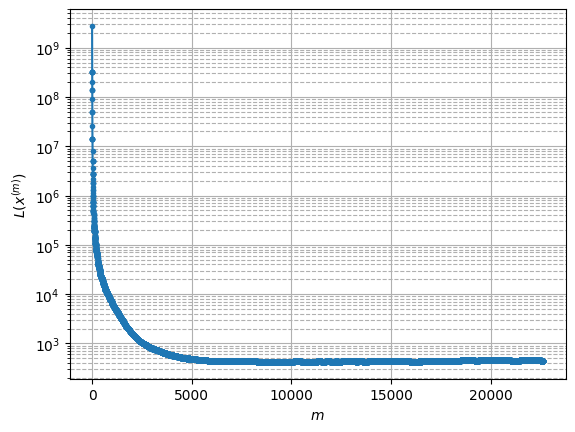

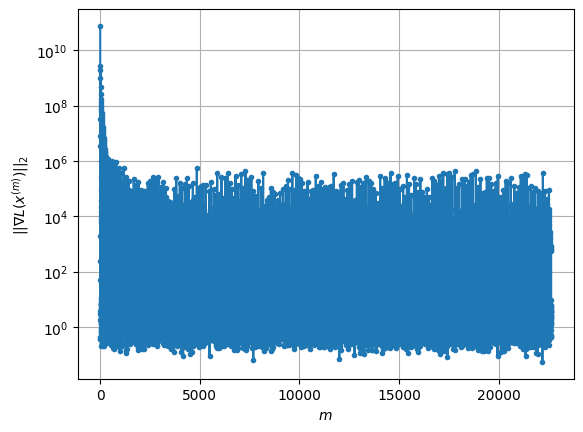

Windows:  68%|██████▊   | 202/296 [13:28:33<6:29:01, 248.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.2050752022425
Gradient norm: 169566.36683178466
Global relative error: 1.81688118445807
Position relative errors: 0.009643632374376588 m, 0.9573654043594156 m, 0.3947631925739244 m, 1.4928380610947258 m

STOP on Iteration 1
Cost function = 446.065752283151 (-0.03%)
Gradient norm = 0.2405584825925424 (-100.00%)
Global relative error = 1.8155277167225168 (-0.07%)
Final position relative errors: 0.010451374360446209 m, 0.9570606123169061 m, 0.395279107010431 m, 1.4912440409560754 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 446.03766213026154
Gradient norm: 16465.163834452233
Global relative error: 1.8155277167225168
Position relative errors: 0.010451374360446209 m, 0.9570606123169061 m, 0.395279107010431 m, 1.4912440409560754 m

Iteration 1
Cost function: 446.01554720869063 (-0.00%)
Gradient norm: 2.4617867670084683 (-99.99%)
Global relative error = 1.81445826

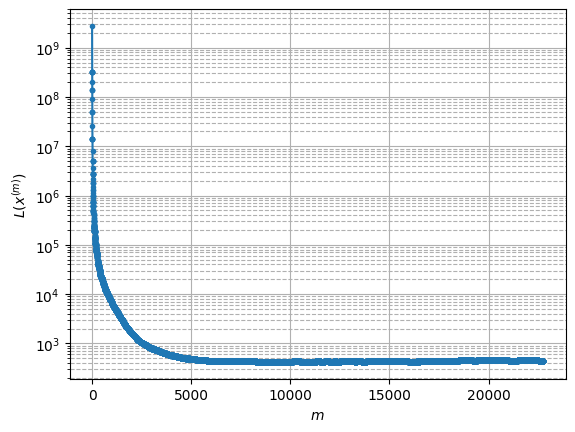

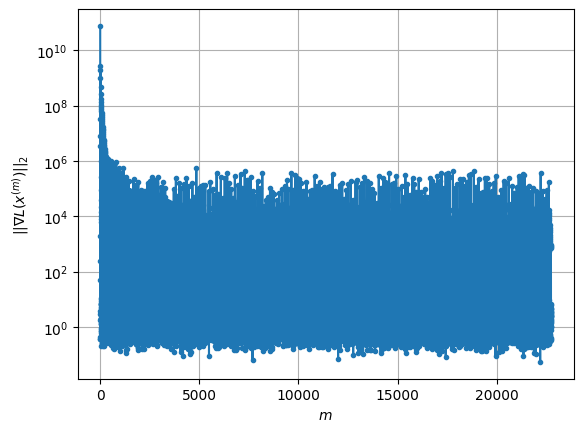

Windows:  69%|██████▊   | 203/296 [13:32:51<6:29:30, 251.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.4321505761465
Gradient norm: 185073.20773220054
Global relative error: 1.5990771685155705
Position relative errors: 0.009559560480980564 m, 0.8586126142176473 m, 0.4082141232414308 m, 1.285724875535794 m

Iteration 1
Cost function: 449.1191789136788 (-0.07%)
Gradient norm: 2.99047144640315 (-100.00%)
Global relative error = 1.595574194755203 (-0.22%)
Position relative errors: 0.01436110349813818 m, 0.852168429343875 m, 0.40973516104190794 m, 1.28513161384553 m

Iteration 2
Cost function: 449.11918060899075 (0.00%)
Gradient norm: 5.496764955327793 (83.81%)
Global relative error = 1.5955741959030834 (0.00%)
Position relative errors: 0.014361098483609624 m, 0.852168431306371 m, 0.40973515995979315 m, 1.2851316143704132 m

Iteration 3
Cost function: 449.1191792901722 (-0.00%)
Gradient norm: 1.2174666293437784 (-77.85%)
Global relative error = 1.5955741944128723 (-0.00%)
Position relative errors: 0.01436

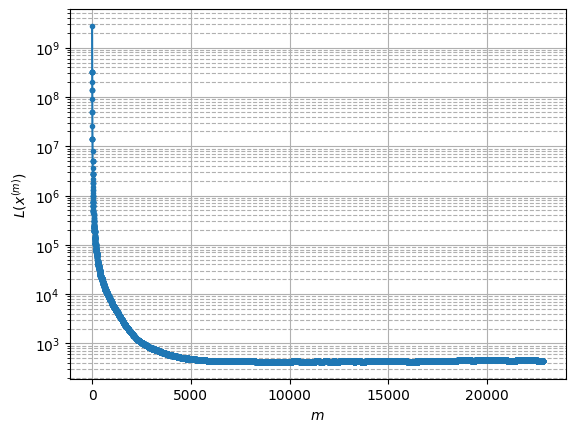

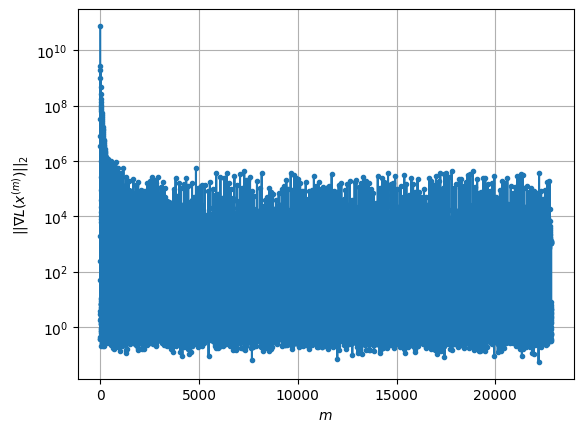

Windows:  69%|██████▉   | 204/296 [13:35:56<5:54:36, 231.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.5899745824646
Gradient norm: 188189.4142461296
Global relative error: 1.3823080556962901
Position relative errors: 0.014590102197475356 m, 0.7577644976258548 m, 0.4454010473685054 m, 1.0667515006516681 m

Iteration 1
Cost function: 448.3869333319199 (-0.05%)
Gradient norm: 7.482541530034547 (-100.00%)
Global relative error = 1.382147782408933 (-0.01%)
Position relative errors: 0.023877681640857497 m, 0.7585521404778226 m, 0.44742279474928515 m, 1.064969019201683 m

Iteration 2
Cost function: 448.3869322533607 (-0.00%)
Gradient norm: 6.625596166253091 (-11.45%)
Global relative error = 1.3821477817096903 (-0.00%)
Position relative errors: 0.023877673431459853 m, 0.758552141588801 m, 0.44742279561585496 m, 1.0649690173228563 m

Iteration 3
Cost function: 448.38693350081326 (0.00%)
Gradient norm: 6.153968813511503 (-7.12%)
Global relative error = 1.3821477814513823 (-0.00%)
Position relative errors: 0.0

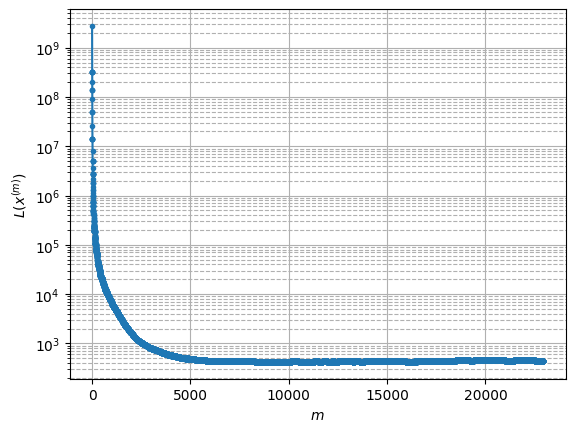

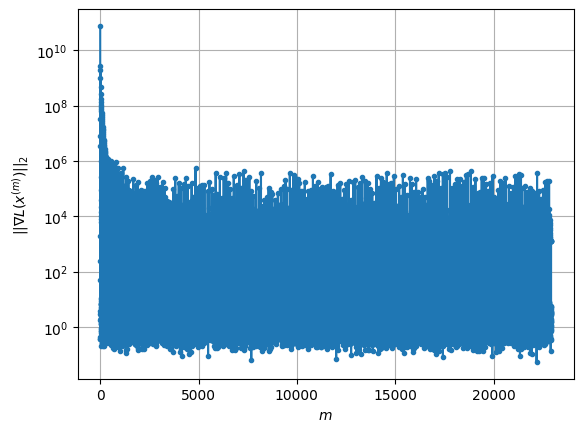

Windows:  69%|██████▉   | 205/296 [13:39:50<5:51:55, 232.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 448.8682814661768
Gradient norm: 118941.99164869386
Global relative error: 1.1732994544004591
Position relative errors: 0.022296732941485965 m, 0.6778289710948219 m, 0.4923075350036751 m, 0.8211574368616662 m

Iteration 1
Cost function: 448.52514234179546 (-0.08%)
Gradient norm: 1.415292480928165 (-100.00%)
Global relative error = 1.1792422219388647 (0.51%)
Position relative errors: 0.012176111468257506 m, 0.6784200584763898 m, 0.49637101835474257 m, 0.8269279519529772 m

STOP on Iteration 2
Cost function = 448.52514164074694 (-0.00%)
Gradient norm = 0.4910852509527026 (-65.30%)
Global relative error = 1.1792422267607887 (0.00%)
Final position relative errors: 0.012176109112395155 m, 0.678420059829316 m, 0.4963710207602509 m, 0.8269279563100912 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 448.4514176838044
Gradient norm: 15358.027442725139
Global relative error:

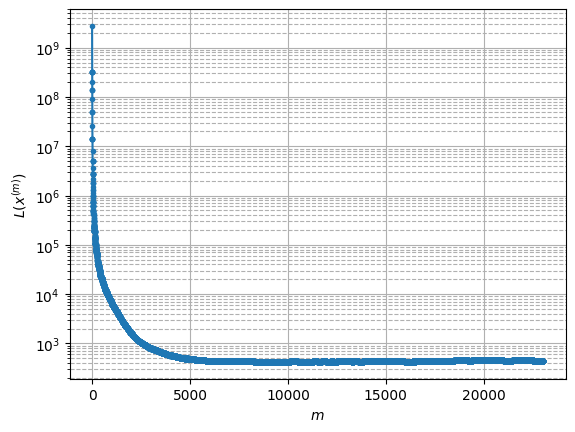

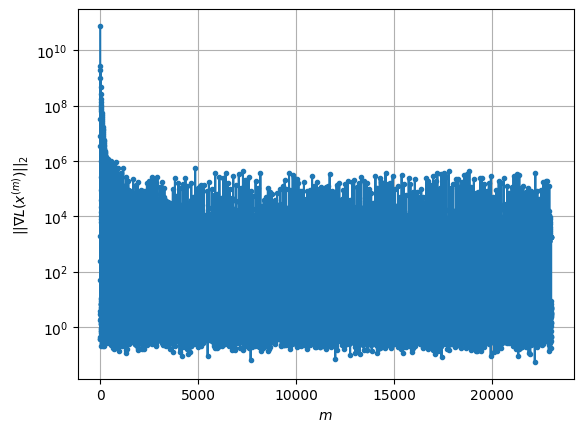

Windows:  70%|██████▉   | 206/296 [13:43:20<5:38:21, 225.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 450.44801554864904
Gradient norm: 87099.08656822026
Global relative error: 1.0244054857437863
Position relative errors: 0.010844619264043651 m, 0.6099933268053286 m, 0.5560892259909692 m, 0.6065841983426927 m

STOP on Iteration 1
Cost function = 450.22444739033836 (-0.05%)
Gradient norm = 0.373236836765251 (-100.00%)
Global relative error = 1.0192586855282078 (-0.50%)
Final position relative errors: 0.017765482163380544 m, 0.6126944146596981 m, 0.5613460999601608 m, 0.5899586652087855 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 450.1766491516437
Gradient norm: 20043.88672312639
Global relative error: 1.0192586855282078
Position relative errors: 0.017765482163380544 m, 0.6126944146596981 m, 0.5613460999601608 m, 0.5899586652087855 m

STOP on Iteration 1
Cost function = 450.15101633440213 (-0.01%)
Gradient norm = 0.7506784408463174 (-100.00%)
Global relative erro

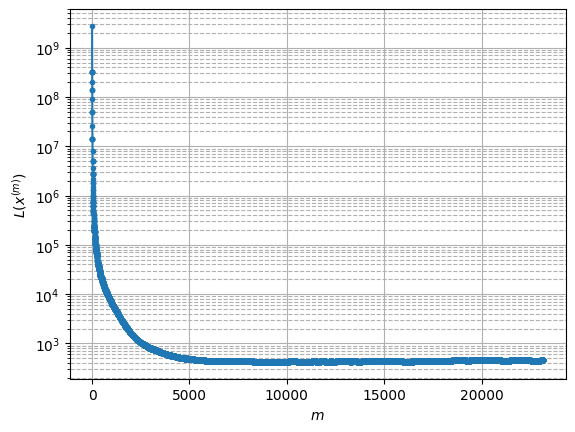

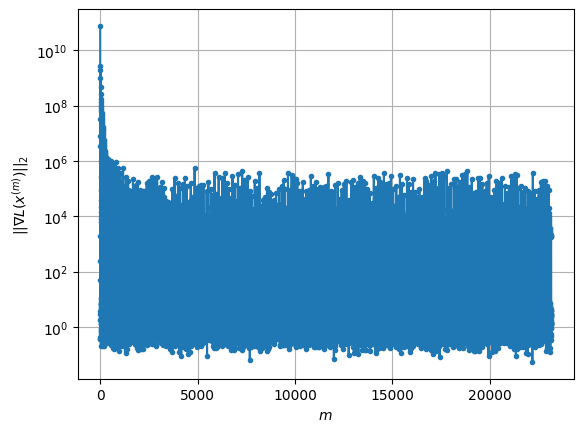

Windows:  70%|██████▉   | 207/296 [13:48:27<6:10:43, 249.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.4679232358303
Gradient norm: 75294.4827269998
Global relative error: 0.886507675653442
Position relative errors: 0.017107932664635207 m, 0.5608346200305259 m, 0.5998901250884694 m, 0.33343832866229794 m

Iteration 1
Cost function: 449.4282370004151 (-0.01%)
Gradient norm: 4.950081584178137 (-99.99%)
Global relative error = 0.8861116401431909 (-0.04%)
Position relative errors: 0.017178084311946375 m, 0.5637097640919058 m, 0.6021261487319374 m, 0.3233507544482868 m

STOP on Iteration 2
Cost function = 449.4282361424214 (-0.00%)
Gradient norm = 0.8250718177538077 (-83.33%)
Global relative error = 0.8861116434052506 (0.00%)
Final position relative errors: 0.017178079052518915 m, 0.5637097672348781 m, 0.6021261545319491 m, 0.3233507473873272 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 449.41427501353087
Gradient norm: 7448.449286337311
Global relative error: 0.8

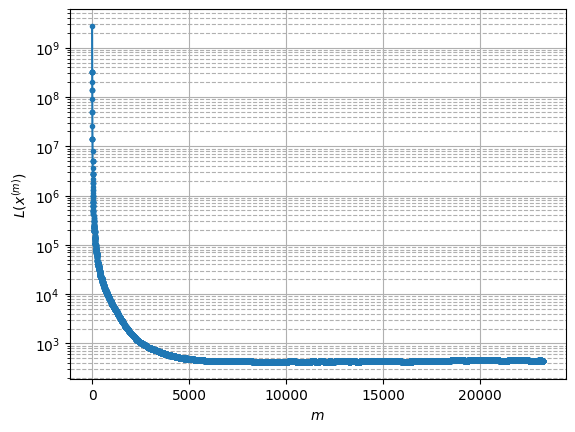

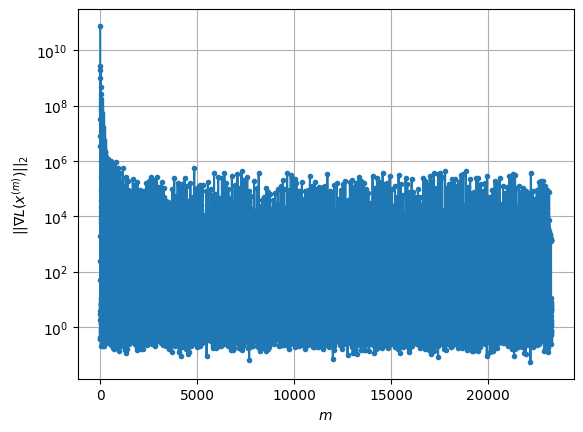

Windows:  70%|███████   | 208/296 [13:52:18<5:58:12, 244.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 449.5613685233234
Gradient norm: 114244.05898337
Global relative error: 0.8406060664400488
Position relative errors: 0.01701248872135897 m, 0.5079996953943738 m, 0.6374546651856027 m, 0.20468987784993245 m

STOP on Iteration 1
Cost function = 449.17478953866 (-0.09%)
Gradient norm = 0.40985214137730436 (-100.00%)
Global relative error = 0.8586209278624914 (2.14%)
Final position relative errors: 0.027904449414586637 m, 0.5099980992176743 m, 0.6516407993970684 m, 0.22737269849079775 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 449.0427597482287
Gradient norm: 26624.28321156128
Global relative error: 0.8586209278624914
Position relative errors: 0.027904449414586637 m, 0.5099980992176743 m, 0.6516407993970684 m, 0.22737269849079775 m

STOP on Iteration 1
Cost function = 448.97502590875877 (-0.02%)
Gradient norm = 0.6909926555915193 (-100.00%)
Global relative error =

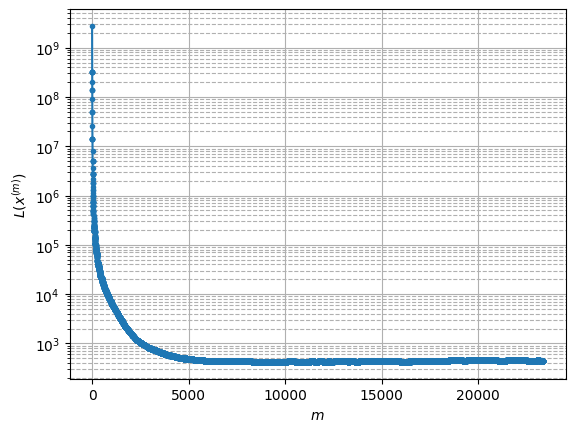

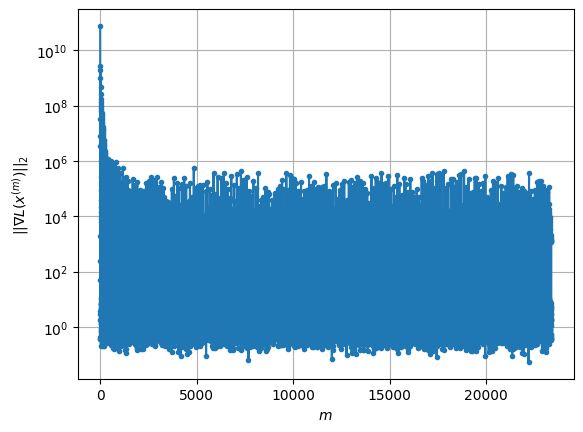

Windows:  71%|███████   | 209/296 [13:56:27<5:56:16, 245.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.18332619738794
Gradient norm: 166378.5836983949
Global relative error: 0.953868184721208
Position relative errors: 0.02709918304166624 m, 0.4416244582024979 m, 0.7245102295723647 m, 0.4349290372454122 m

STOP on Iteration 1
Cost function = 455.8366198337169 (-0.08%)
Gradient norm = 0.608835163782506 (-100.00%)
Global relative error = 0.9546634056041632 (0.08%)
Final position relative errors: 0.024161115268147983 m, 0.4384688974145042 m, 0.7363811738339124 m, 0.41984115381938897 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 455.7243963538201
Gradient norm: 34328.30409788498
Global relative error: 0.9546634056041632
Position relative errors: 0.024161115268147983 m, 0.4384688974145042 m, 0.7363811738339124 m, 0.41984115381938897 m

Iteration 1
Cost function: 455.66687119932027 (-0.01%)
Gradient norm: 2.5483475340114885 (-99.99%)
Global relative error = 0.9582694

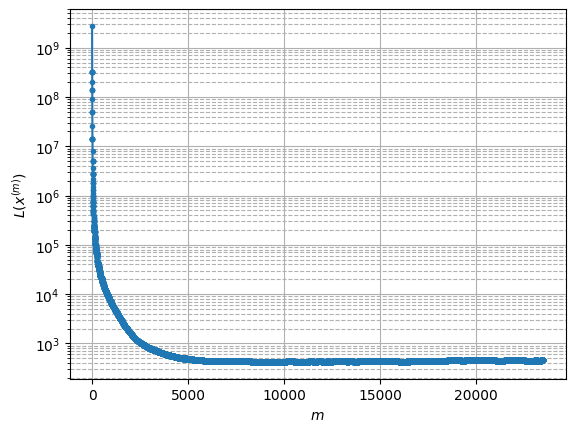

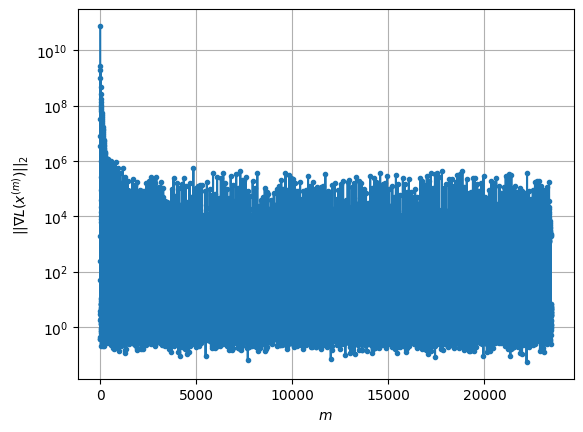

Windows:  71%|███████   | 210/296 [14:00:29<5:50:19, 244.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.6959365004562
Gradient norm: 171365.2896252976
Global relative error: 1.1133722460423798
Position relative errors: 0.023725421399512798 m, 0.3769876220743986 m, 0.8053934540552231 m, 0.6695049430757731 m

Iteration 1
Cost function: 458.5272509882092 (-0.04%)
Gradient norm: 2.8517889736208293 (-100.00%)
Global relative error = 1.1284880296616355 (1.36%)
Position relative errors: 0.02754255027617957 m, 0.39367238915066183 m, 0.8190444564220681 m, 0.6685021497830304 m

Iteration 2
Cost function: 458.52725196367754 (0.00%)
Gradient norm: 2.903376671952556 (1.81%)
Global relative error = 1.1284880249226312 (-0.00%)
Position relative errors: 0.02754255068526787 m, 0.3936723844635897 m, 0.8190444529244817 m, 0.6685021488117182 m

STOP on Iteration 3
Cost function = 458.52725266785194 (0.00%)
Gradient norm = 0.5005980231316834 (-82.76%)
Global relative error = 1.1284880258868315 (0.00%)
Final position relat

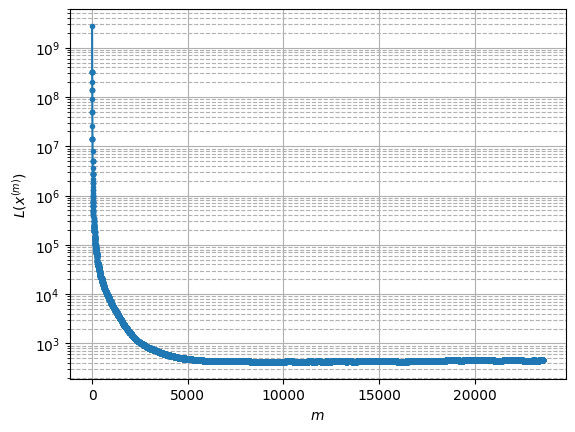

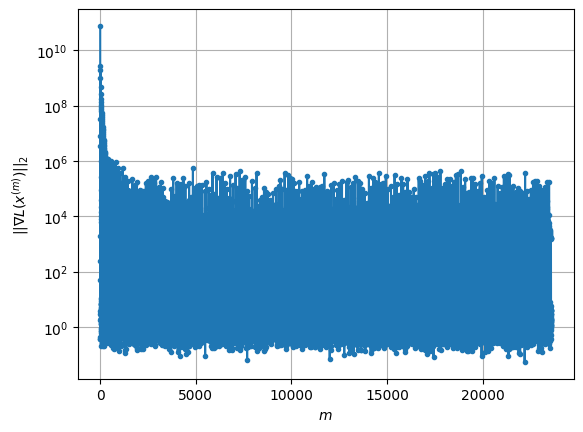

Windows:  71%|███████▏  | 211/296 [14:04:34<5:46:32, 244.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.7203298890993
Gradient norm: 101420.33025586687
Global relative error: 1.3416047711371641
Position relative errors: 0.027960043365283613 m, 0.38352493862001336 m, 0.8766795959011355 m, 0.9399168549270435 m

Iteration 1
Cost function: 458.5177343846856 (-0.04%)
Gradient norm: 4.193096379289451 (-100.00%)
Global relative error = 1.3398678816994927 (-0.13%)
Position relative errors: 0.030765778869522194 m, 0.3893707863035825 m, 0.8698106553875256 m, 0.9413287562963639 m

Iteration 2
Cost function: 458.5177330344937 (-0.00%)
Gradient norm: 3.54115595084338 (-15.55%)
Global relative error = 1.3398678800143604 (-0.00%)
Position relative errors: 0.03076576871387921 m, 0.3893707875003037 m, 0.869810651428687 m, 0.9413287573927537 m

Iteration 3
Cost function: 458.5177347231812 (0.00%)
Gradient norm: 5.559753012829835 (57.00%)
Global relative error = 1.3398678782501356 (-0.00%)
Position relative errors: 0.03

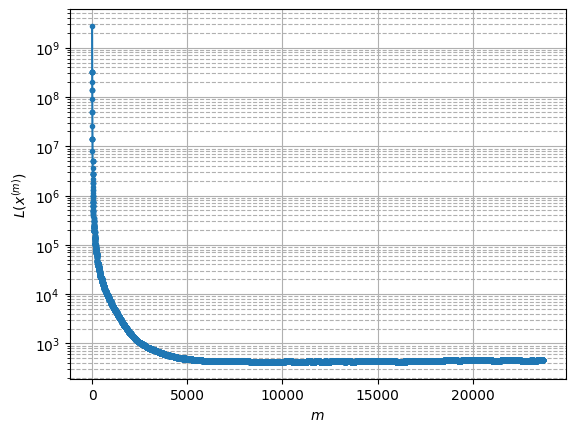

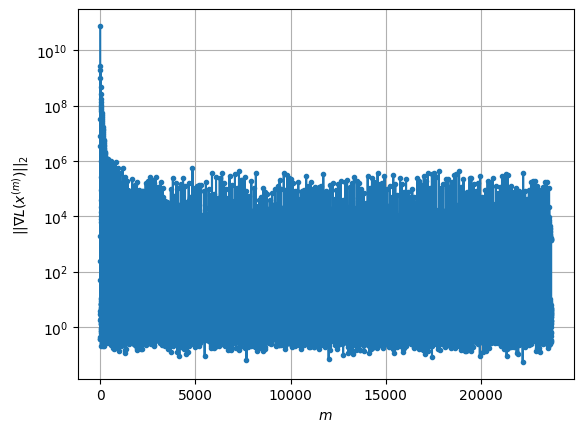

Windows:  72%|███████▏  | 212/296 [14:08:38<5:42:18, 244.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.51752322126197
Gradient norm: 256453.3804806693
Global relative error: 1.5549624846154626
Position relative errors: 0.03143845159429918 m, 0.3850209849639672 m, 0.8812009035439653 m, 1.2215338589186462 m

STOP on Iteration 1
Cost function = 457.37318452312905 (-0.03%)
Gradient norm = 0.445299932369301 (-100.00%)
Global relative error = 1.5594354821614234 (0.29%)
Final position relative errors: 0.03670730541447672 m, 0.393297095596839 m, 0.8812952263601833 m, 1.224381030821941 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.3456728668447
Gradient norm: 19756.166929978084
Global relative error: 1.5594354821614234
Position relative errors: 0.03670730541447672 m, 0.393297095596839 m, 0.8812952263601833 m, 1.224381030821941 m

Iteration 1
Cost function: 457.3277795102853 (-0.00%)
Gradient norm: 6.28135318823994 (-99.97%)
Global relative error = 1.561697143753010

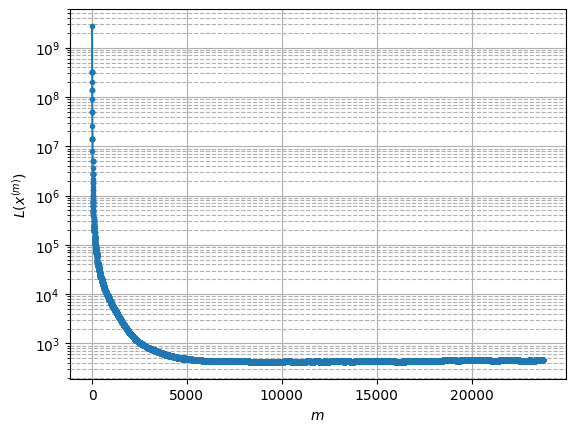

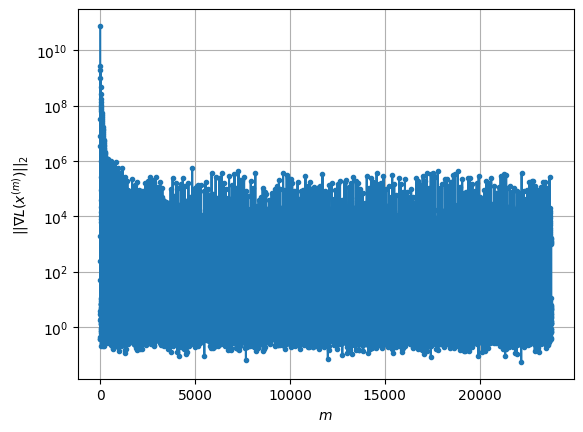

Windows:  72%|███████▏  | 213/296 [14:11:43<5:13:34, 226.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.712119500822
Gradient norm: 195163.45110770626
Global relative error: 1.7674592033682208
Position relative errors: 0.035335557006746315 m, 0.3345845049156321 m, 0.8803678691914251 m, 1.4952093335841492 m

STOP on Iteration 1
Cost function = 459.516202156073 (-0.04%)
Gradient norm = 0.2491088687125829 (-100.00%)
Global relative error = 1.763676121266214 (-0.21%)
Final position relative errors: 0.031171461080601218 m, 0.3277706186246599 m, 0.8777945963049562 m, 1.49385634933166 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 459.4432953154804
Gradient norm: 14796.716238147943
Global relative error: 1.763676121266214
Position relative errors: 0.031171461080601218 m, 0.3277706186246599 m, 0.8777945963049562 m, 1.49385634933166 m

Iteration 1
Cost function: 459.3931304475315 (-0.01%)
Gradient norm: 1.8365724042011817 (-99.99%)
Global relative error = 1.7646464851687

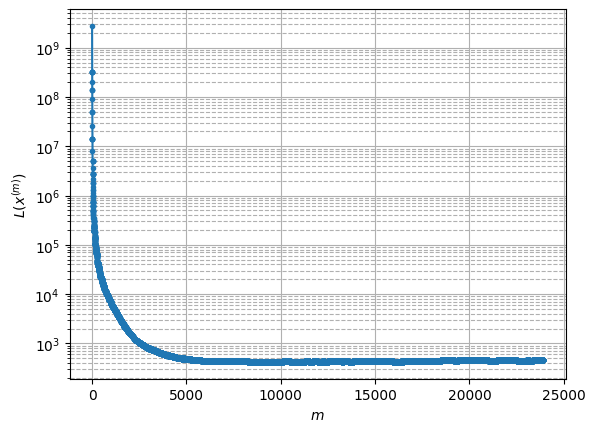

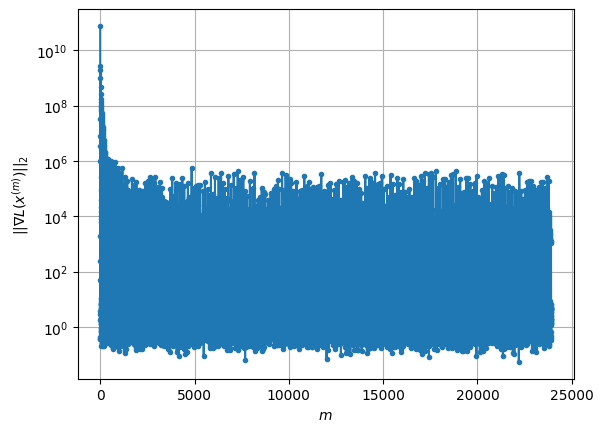

Windows:  72%|███████▏  | 214/296 [14:16:42<5:39:15, 248.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.4720641118884
Gradient norm: 97813.67182291743
Global relative error: 1.9995633840509077
Position relative errors: 0.032721441094257835 m, 0.3932629802687298 m, 0.8787387796026632 m, 1.7522352242427082 m

Iteration 1
Cost function: 457.3422222201387 (-0.03%)
Gradient norm: 2.104349110758083 (-100.00%)
Global relative error = 1.9980330515182356 (-0.08%)
Position relative errors: 0.027854161757646316 m, 0.3714463822251505 m, 0.8779010130305872 m, 1.755750695076812 m

Iteration 2
Cost function: 457.3422222625599 (0.00%)
Gradient norm: 3.485423916874424 (65.63%)
Global relative error = 1.9980330522244834 (0.00%)
Position relative errors: 0.027854165743308026 m, 0.37144638373513145 m, 0.8779010137978045 m, 1.755750695114216 m

STOP on Iteration 3
Cost function = 457.3422234228149 (0.00%)
Gradient norm = 0.719257929415596 (-79.36%)
Global relative error = 1.9980330505338608 (-0.00%)
Final position relativ

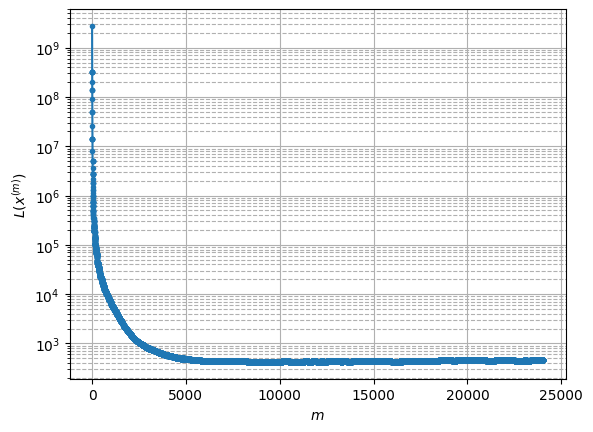

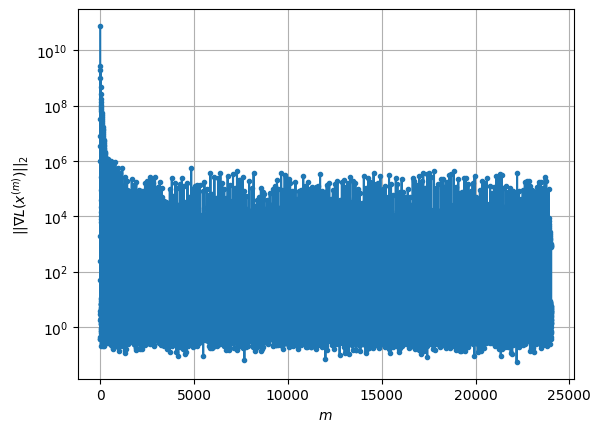

Windows:  73%|███████▎  | 215/296 [14:21:25<5:49:18, 258.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.4900800286995
Gradient norm: 237999.55857635412
Global relative error: 2.222188844267659
Position relative errors: 0.02766788882130273 m, 0.3526261504678321 m, 0.8693488263825515 m, 2.0142565000117907 m

STOP on Iteration 1
Cost function = 455.2061787865475 (-0.06%)
Gradient norm = 0.6065860347339891 (-100.00%)
Global relative error = 2.2265475830391677 (0.20%)
Final position relative errors: 0.015836469539496002 m, 0.36673528532505284 m, 0.8731155422580694 m, 2.015048861184278 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 455.19258896851693
Gradient norm: 6409.318778795045
Global relative error: 2.2265475830391677
Position relative errors: 0.015836469539496002 m, 0.36673528532505284 m, 0.8731155422580694 m, 2.015048861184278 m

Iteration 1
Cost function: 455.18445232124037 (-0.00%)
Gradient norm: 1.1445091137114 (-99.98%)
Global relative error = 2.2305692206

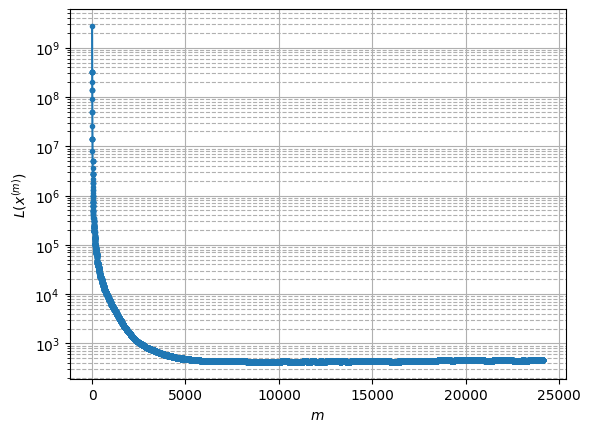

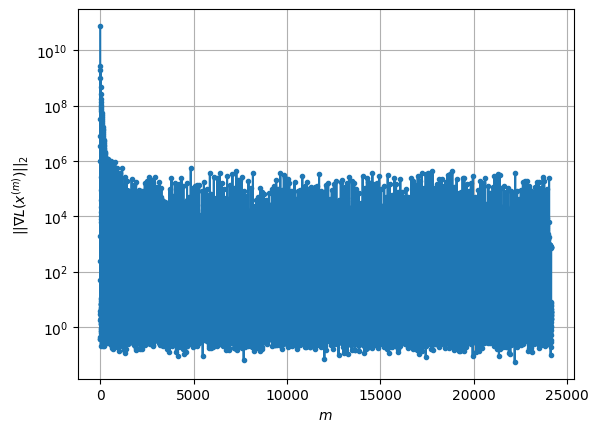

Windows:  73%|███████▎  | 216/296 [14:25:30<5:39:42, 254.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.6905302562442
Gradient norm: 118245.0120910552
Global relative error: 2.4580686095341133
Position relative errors: 0.016868769839816247 m, 0.4405318974392927 m, 0.8797965683808443 m, 2.2524856835561593 m

Iteration 1
Cost function: 454.51005708674796 (-0.04%)
Gradient norm: 2.3829006511867767 (-100.00%)
Global relative error = 2.4575319348618754 (-0.02%)
Position relative errors: 0.01433665643638697 m, 0.4256678983002528 m, 0.8737771887104232 m, 2.25711394154261 m

Iteration 2
Cost function: 454.5100576417133 (0.00%)
Gradient norm: 7.061131824518 (196.33%)
Global relative error = 2.457531938025369 (0.00%)
Position relative errors: 0.014336656278420358 m, 0.4256679145720757 m, 0.8737771890689906 m, 2.257113941780495 m

Iteration 3
Cost function: 454.5100570338417 (-0.00%)
Gradient norm: 2.9192527509228463 (-58.66%)
Global relative error = 2.457531936471921 (-0.00%)
Position relative errors: 0.0143366

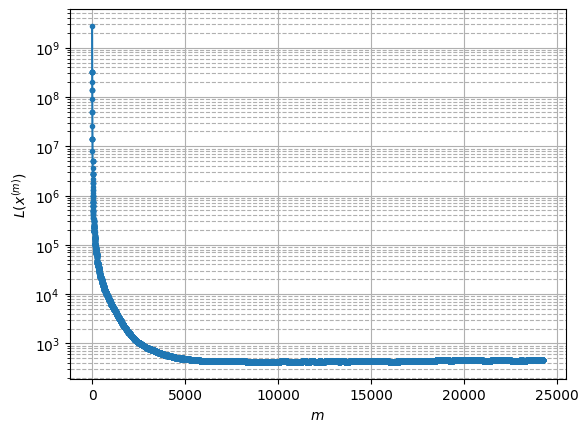

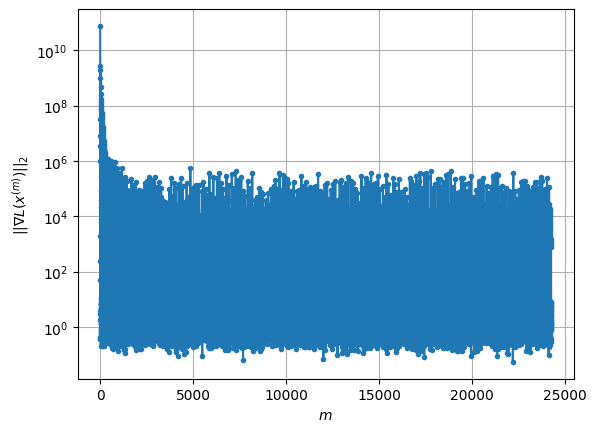

Windows:  73%|███████▎  | 217/296 [14:29:41<5:33:44, 253.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.6848282531429
Gradient norm: 110971.02948453958
Global relative error: 2.6740667851716826
Position relative errors: 0.014006787217996187 m, 0.41914646499190117 m, 0.8692046883656978 m, 2.493837092961912 m

STOP on Iteration 1
Cost function = 458.6064419460661 (-0.02%)
Gradient norm = 0.5474737342218895 (-100.00%)
Global relative error = 2.6759242737105913 (0.07%)
Final position relative errors: 0.014699493157526371 m, 0.4121909818030094 m, 0.8705513572186271 m, 2.496513691502369 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 458.5709762436516
Gradient norm: 27159.705240537496
Global relative error: 2.6759242737105913
Position relative errors: 0.014699493157526371 m, 0.4121909818030094 m, 0.8705513572186271 m, 2.496513691502369 m

STOP on Iteration 1
Cost function = 458.5441570015051 (-0.01%)
Gradient norm = 0.24229605747689847 (-100.00%)
Global relative error 

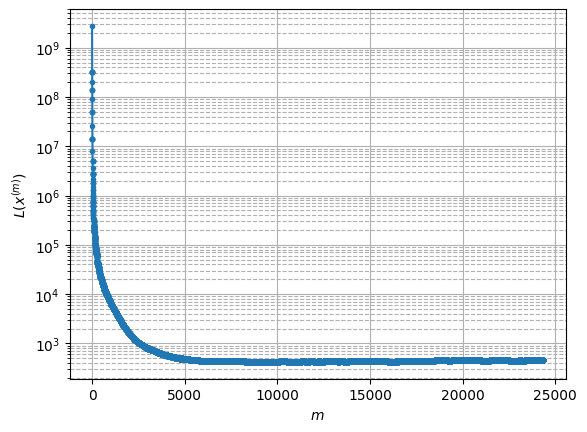

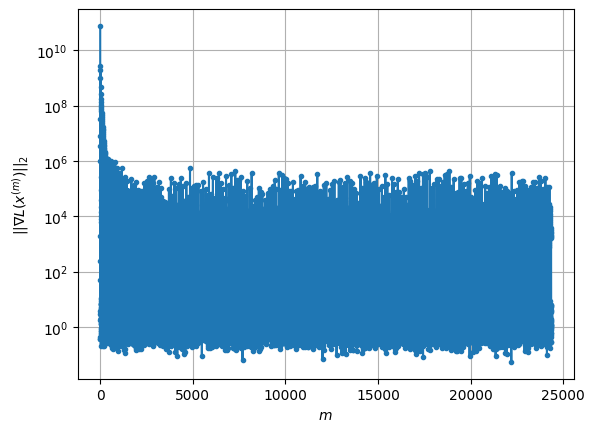

Windows:  74%|███████▎  | 218/296 [14:33:07<5:11:06, 239.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.08829610870225
Gradient norm: 166477.3539648298
Global relative error: 2.899999866435912
Position relative errors: 0.015664432322791792 m, 0.5213328769296812 m, 0.8556453167937795 m, 2.721364644505438 m

Iteration 1
Cost function: 457.9661849624188 (-0.03%)
Gradient norm: 5.469278032692845 (-100.00%)
Global relative error = 2.897166194163428 (-0.10%)
Position relative errors: 0.014745711448879565 m, 0.5112188131902974 m, 0.8515884074429627 m, 2.721542874884222 m

Iteration 2
Cost function: 457.96618656408145 (0.00%)
Gradient norm: 7.088730869141461 (29.61%)
Global relative error = 2.897166195752648 (0.00%)
Position relative errors: 0.014745711182015292 m, 0.5112188164293505 m, 0.8515884078354817 m, 2.7215428758461884 m

Iteration 3
Cost function: 457.966185032428 (-0.00%)
Gradient norm: 2.8526254111462643 (-59.76%)
Global relative error = 2.8971661939971605 (-0.00%)
Position relative errors: 0.01474

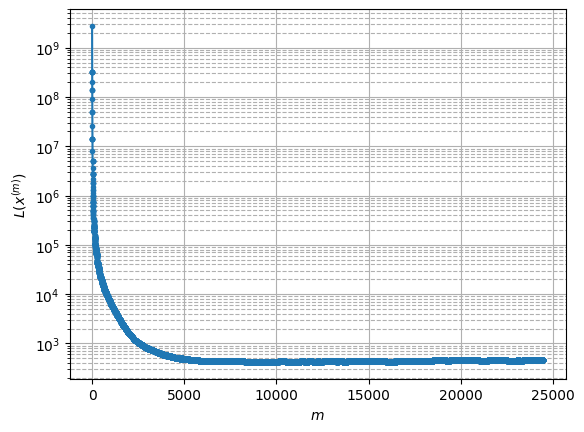

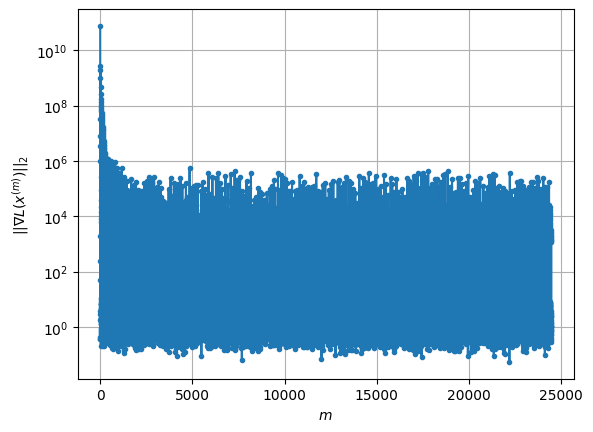

Windows:  74%|███████▍  | 219/296 [14:37:22<5:13:13, 244.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.69503880383303
Gradient norm: 74227.9012754833
Global relative error: 3.0687070720305916
Position relative errors: 0.014748847266487257 m, 0.5669341196531379 m, 0.808866460541852 m, 2.9053496463873314 m

Iteration 1
Cost function: 454.18863108593905 (-0.11%)
Gradient norm: 2.280209487828685 (-100.00%)
Global relative error = 3.073889890425964 (0.17%)
Position relative errors: 0.022827357574377687 m, 0.5919316210102508 m, 0.8138337010626802 m, 2.9044035315785233 m

Iteration 2
Cost function: 454.1886326896577 (0.00%)
Gradient norm: 1.0621239967711509 (-53.42%)
Global relative error = 3.073889887457966 (-0.00%)
Position relative errors: 0.02282735866998637 m, 0.5919316093893231 m, 0.8138336973796481 m, 2.9044035318291344 m

STOP on Iteration 3
Cost function = 454.1886315044805 (-0.00%)
Gradient norm = 0.8445289621151719 (-20.49%)
Global relative error = 3.073889886878323 (-0.00%)
Final position relati

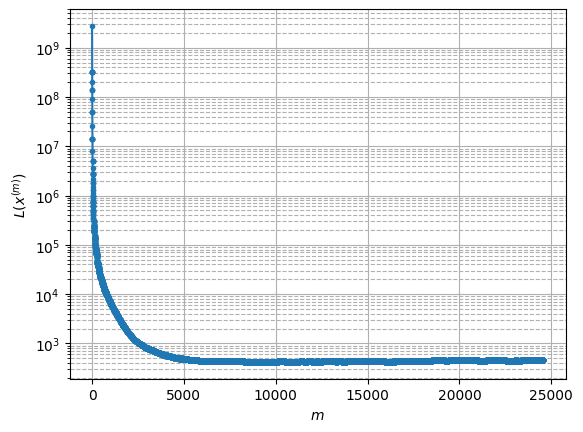

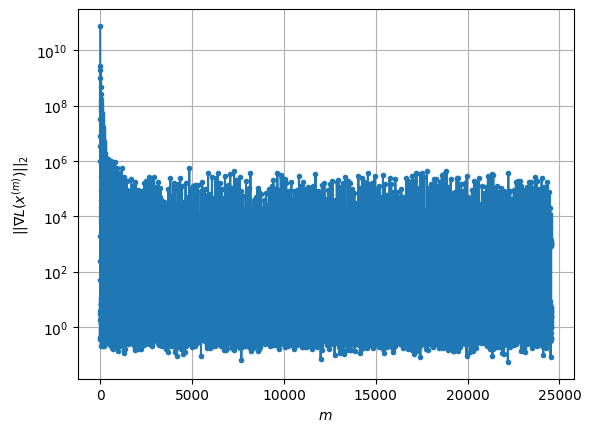

Windows:  74%|███████▍  | 220/296 [14:40:50<4:55:10, 233.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.03691384375
Gradient norm: 190781.37817438244
Global relative error: 3.2442727182338986
Position relative errors: 0.023273569955845223 m, 0.717145102144179 m, 0.8220856004586407 m, 3.055263311634301 m

Iteration 1
Cost function: 455.873632637181 (-0.04%)
Gradient norm: 4.660028071395818 (-100.00%)
Global relative error = 3.2445730857750843 (0.01%)
Position relative errors: 0.01870287589863414 m, 0.7128637609749671 m, 0.8236966385755295 m, 3.056181568293766 m

Iteration 2
Cost function: 455.87363218649057 (-0.00%)
Gradient norm: 2.79116605323516 (-40.10%)
Global relative error = 3.2445730859529354 (0.00%)
Position relative errors: 0.018702876906241086 m, 0.7128637596782338 m, 0.8236966392278262 m, 3.056181568603075 m

STOP on Iteration 3
Cost function = 455.8736323674109 (0.00%)
Gradient norm = 0.25500900819900113 (-90.86%)
Global relative error = 3.244573086232038 (0.00%)
Final position relative err

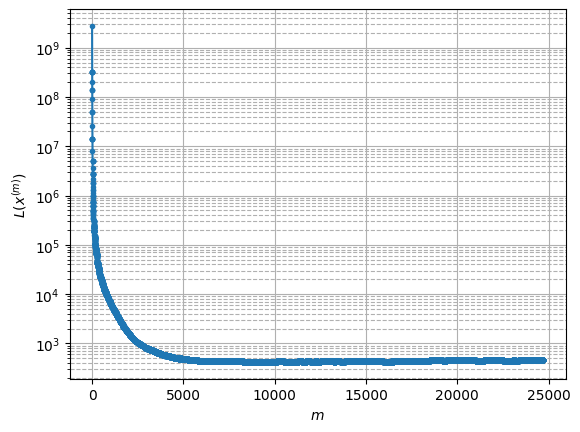

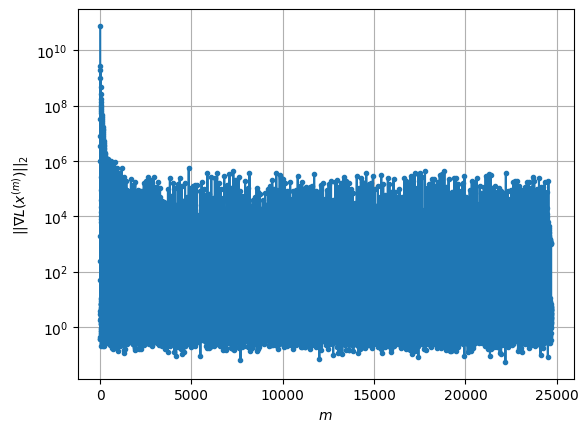

Windows:  75%|███████▍  | 221/296 [14:46:18<5:26:57, 261.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.7567405726599
Gradient norm: 123022.77275189992
Global relative error: 3.4000008574725693
Position relative errors: 0.019166119959036006 m, 0.8296880618150325 m, 0.8065310643249468 m, 3.196991922125172 m

Iteration 1
Cost function: 456.609231880057 (-0.03%)
Gradient norm: 4.160168778748143 (-100.00%)
Global relative error = 3.399130056149451 (-0.03%)
Position relative errors: 0.01846935077229929 m, 0.830288045557663 m, 0.8041595756977665 m, 3.1965116445437345 m

STOP on Iteration 2
Cost function = 456.6092327021133 (0.00%)
Gradient norm = 0.6862273160454622 (-83.50%)
Global relative error = 3.3991300557498656 (-0.00%)
Final position relative errors: 0.01846934816682391 m, 0.8302880465553443 m, 0.804159575773657 m, 3.1965116438556374 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 456.55238572583306
Gradient norm: 19977.91000664228
Global relative error: 3.39913

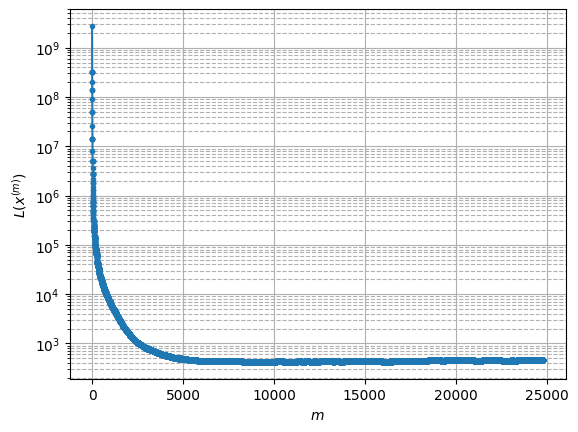

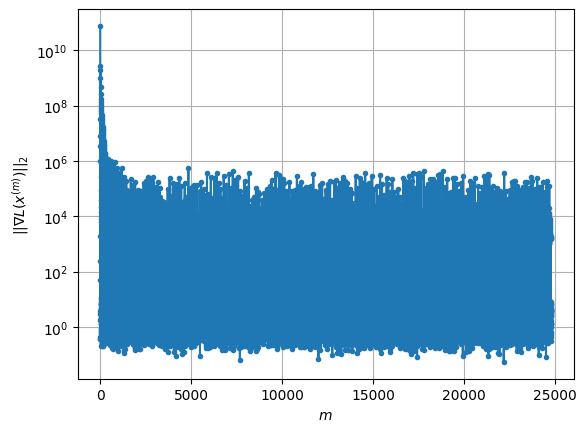

Windows:  75%|███████▌  | 222/296 [14:50:03<5:09:04, 250.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.36494772033893
Gradient norm: 46965.66851635365
Global relative error: 3.5297082305411256
Position relative errors: 0.01870512252533266 m, 0.9526711447087511 m, 0.7779502003089809 m, 3.308428065559425 m

Iteration 1
Cost function: 457.13926977239515 (-0.05%)
Gradient norm: 3.381897946658306 (-99.99%)
Global relative error = 3.533611494808626 (0.11%)
Position relative errors: 0.018591370740991976 m, 0.9559796823050845 m, 0.7738367215690943 m, 3.312603041852051 m

Iteration 2
Cost function: 457.1392704127012 (0.00%)
Gradient norm: 3.583275117607726 (5.95%)
Global relative error = 3.5336114966061962 (0.00%)
Position relative errors: 0.01859137249709446 m, 0.9559796808667959 m, 0.7738367308765262 m, 3.3126030420005197 m

Iteration 3
Cost function: 457.13927038584836 (-0.00%)
Gradient norm: 2.2082257308805247 (-38.37%)
Global relative error = 3.533611497106167 (0.00%)
Position relative errors: 0.01859137

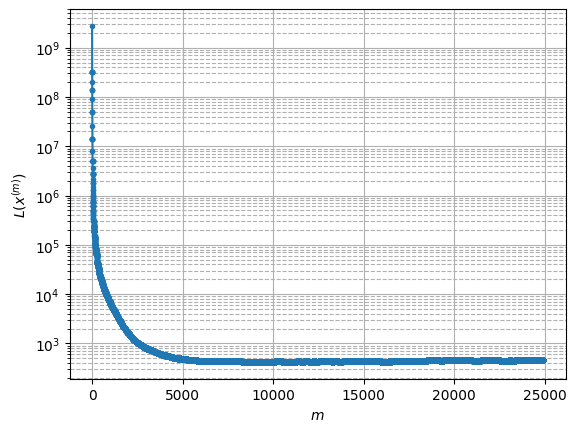

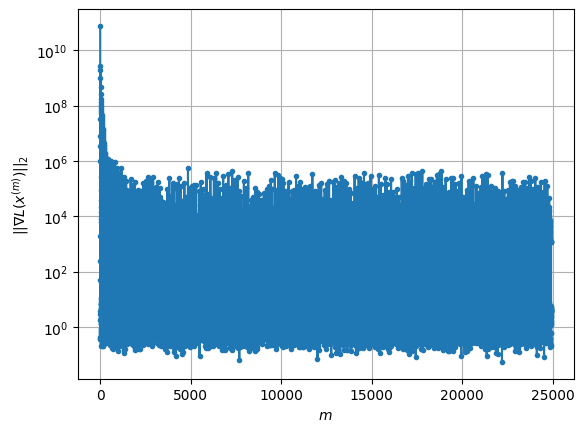

Windows:  75%|███████▌  | 223/296 [14:54:01<5:00:22, 246.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.58080191106956
Gradient norm: 143271.01174443978
Global relative error: 3.6702740531761764
Position relative errors: 0.018836090175843277 m, 1.059301349426769 m, 0.7284926455737878 m, 3.4376928076611923 m

Iteration 1
Cost function: 459.39141570620296 (-0.04%)
Gradient norm: 6.8882780400754555 (-100.00%)
Global relative error = 3.6698977831059985 (-0.01%)
Position relative errors: 0.017500131213762562 m, 1.0572166635619995 m, 0.7309785003525382 m, 3.4374122209494895 m

Iteration 2
Cost function: 459.39141620898044 (0.00%)
Gradient norm: 3.9974847589029725 (-41.97%)
Global relative error = 3.6698977839768507 (0.00%)
Position relative errors: 0.017500128250299063 m, 1.0572166621938215 m, 0.7309785058689419 m, 3.4374122211420466 m

STOP on Iteration 3
Cost function = 459.39141601693484 (-0.00%)
Gradient norm = 0.833871719597737 (-79.14%)
Global relative error = 3.6698977845139367 (0.00%)
Final position

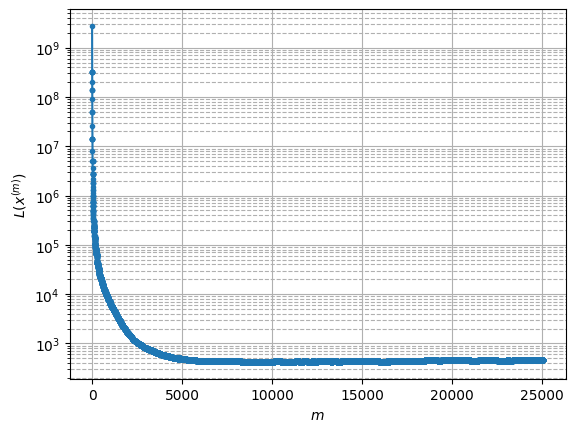

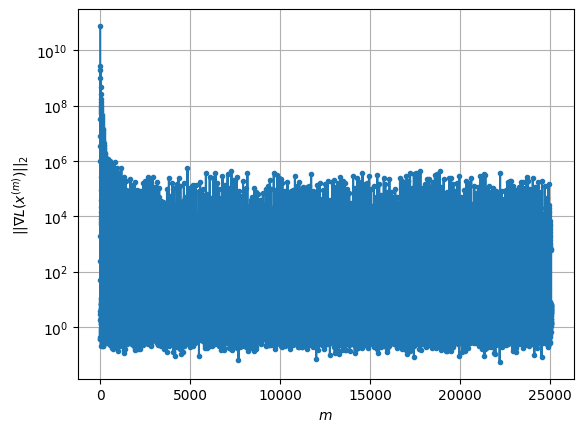

Windows:  76%|███████▌  | 224/296 [14:59:25<5:23:56, 269.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.1436225953421
Gradient norm: 86526.96993904545
Global relative error: 3.768466363471223
Position relative errors: 0.018011363978175512 m, 1.1602395111062425 m, 0.7070151952362752 m, 3.5149658499402925 m

Iteration 1
Cost function: 457.0145144645136 (-0.03%)
Gradient norm: 2.282693189097931 (-100.00%)
Global relative error = 3.7677840391108712 (-0.02%)
Position relative errors: 0.016049300415384084 m, 1.1594543612683856 m, 0.7031255548711834 m, 3.5152831827128437 m

Iteration 2
Cost function: 457.01451621778926 (0.00%)
Gradient norm: 1.9479387744210883 (-14.66%)
Global relative error = 3.7677840392401496 (0.00%)
Position relative errors: 0.016049302803139286 m, 1.1594543602775862 m, 0.7031255564336139 m, 3.515283182854788 m

STOP on Iteration 3
Cost function = 457.01451480530756 (-0.00%)
Gradient norm = 0.6439670708390083 (-66.94%)
Global relative error = 3.7677840394165 (0.00%)
Final position relati

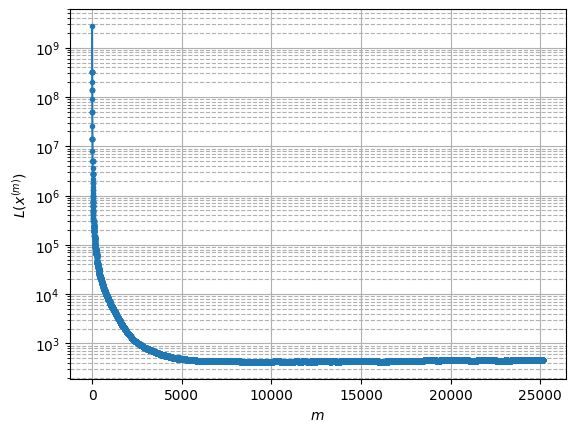

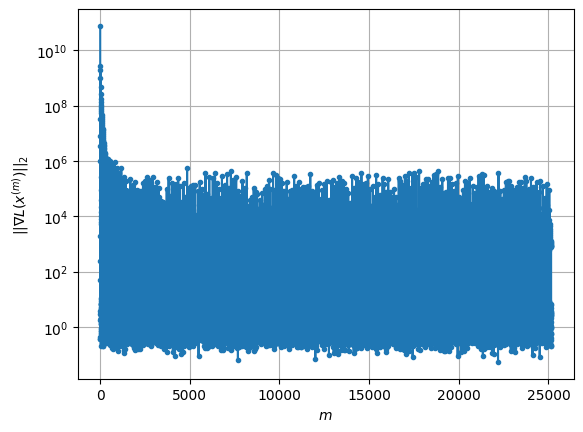

Windows:  76%|███████▌  | 225/296 [15:03:14<5:04:51, 257.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.9032404630779
Gradient norm: 184556.18235625184
Global relative error: 3.840577734318683
Position relative errors: 0.016786269095989736 m, 1.2586851001442336 m, 0.6400381226621962 m, 3.571528522898539 m

Iteration 1
Cost function: 458.7622182714477 (-0.03%)
Gradient norm: 5.092826414575469 (-100.00%)
Global relative error = 3.8420626206646604 (0.04%)
Position relative errors: 0.012746269431715253 m, 1.2600114610064137 m, 0.6411680895460734 m, 3.5724717953068232 m

Iteration 2
Cost function: 458.7622191613621 (0.00%)
Gradient norm: 5.033269333135469 (-1.17%)
Global relative error = 3.842062621605512 (0.00%)
Position relative errors: 0.012746270392648083 m, 1.260011461818375 m, 0.6411680942764909 m, 3.5724717951798763 m

STOP on Iteration 3
Cost function = 458.7622192005168 (0.00%)
Gradient norm = 0.7597402521874751 (-84.91%)
Global relative error = 3.842062621596461 (-0.00%)
Final position relative e

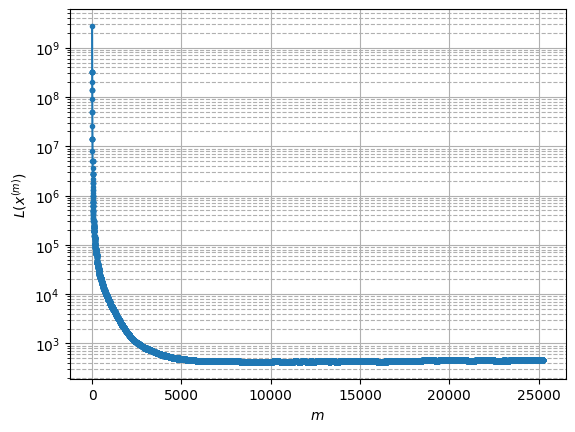

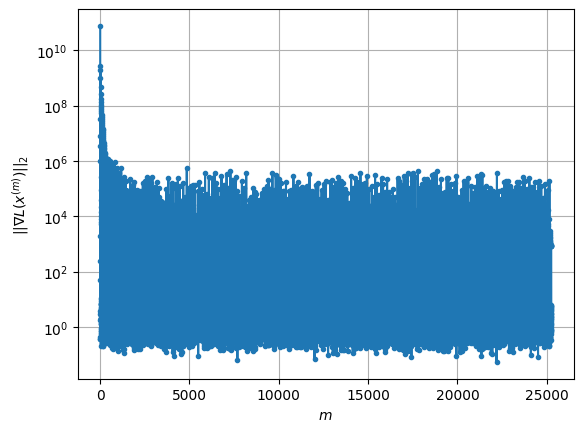

Windows:  76%|███████▋  | 226/296 [15:06:50<4:46:11, 245.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 461.97111991664326
Gradient norm: 303572.44670745777
Global relative error: 3.899218529756668
Position relative errors: 0.012910227388542979 m, 1.3503099975112145 m, 0.5986761718226268 m, 3.608598899240018 m

STOP on Iteration 1
Cost function = 461.53792514315137 (-0.09%)
Gradient norm = 0.8854585715063866 (-100.00%)
Global relative error = 3.9007727838697486 (0.04%)
Final position relative errors: 0.01400594610469676 m, 1.35108713190201 m, 0.5989457785981785 m, 3.609938704783272 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 461.3955922167588
Gradient norm: 20323.155350609974
Global relative error: 3.9007727838697486
Position relative errors: 0.01400594610469676 m, 1.35108713190201 m, 0.5989457785981785 m, 3.609938704783272 m

STOP on Iteration 1
Cost function = 461.32214086256886 (-0.02%)
Gradient norm = 0.40390955084656716 (-100.00%)
Global relative error = 3.9

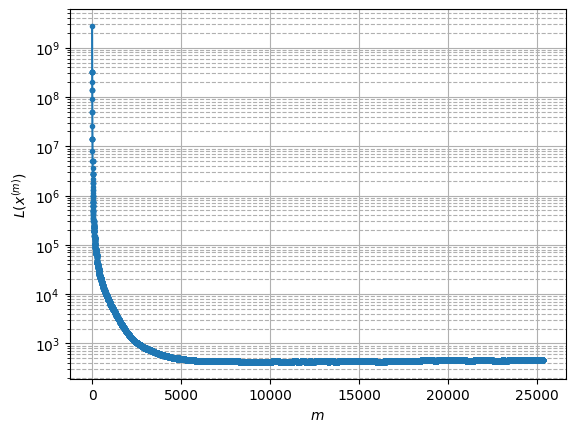

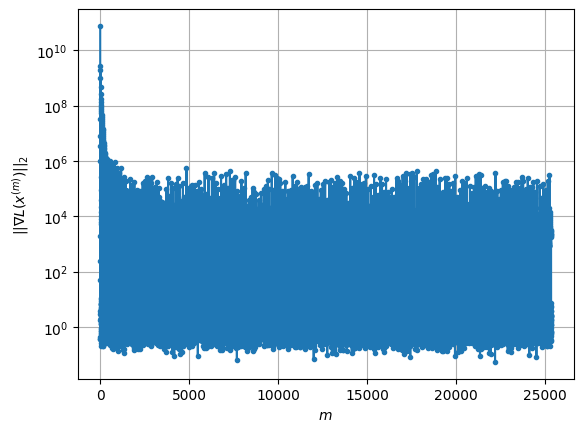

Windows:  77%|███████▋  | 227/296 [15:10:25<4:31:27, 236.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 460.9308266715638
Gradient norm: 208019.31585268836
Global relative error: 3.91431783319926
Position relative errors: 0.01398589793031767 m, 1.428873800362823 m, 0.5912828730498793 m, 3.5958852288588754 m

Iteration 1
Cost function: 460.60616758674274 (-0.07%)
Gradient norm: 1.0229280015702953 (-100.00%)
Global relative error = 3.9127038264157425 (-0.04%)
Position relative errors: 0.01538117274204777 m, 1.431184027359989 m, 0.5912240422491263 m, 3.593212897907346 m

Iteration 2
Cost function: 460.606166904141 (-0.00%)
Gradient norm: 1.7245301458268951 (68.59%)
Global relative error = 3.912703827166418 (0.00%)
Position relative errors: 0.015381170105467601 m, 1.4311840262708864 m, 0.5912240460182698 m, 3.5932128985496745 m

Iteration 3
Cost function: 460.6061677487707 (0.00%)
Gradient norm: 2.1960610061003605 (27.34%)
Global relative error = 3.9127038268839867 (-0.00%)
Position relative errors: 0.0153811

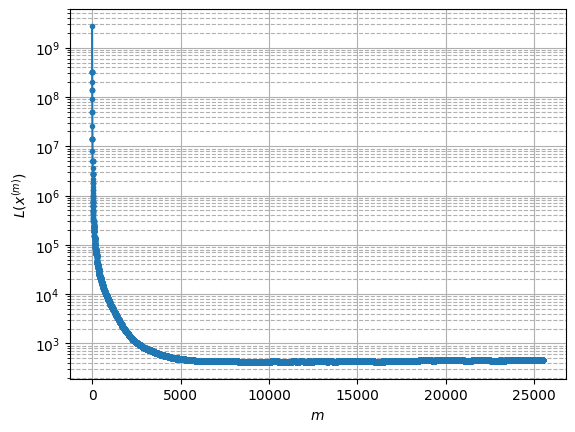

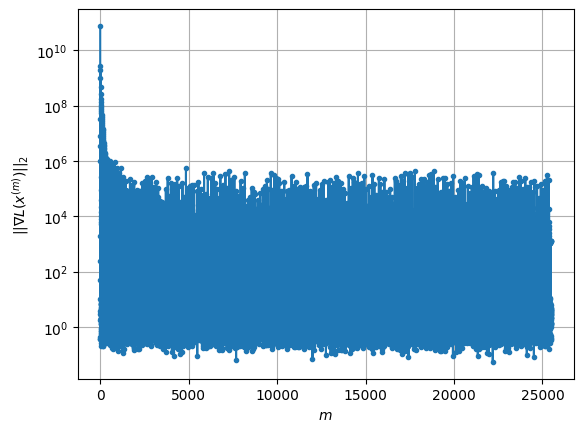

Windows:  77%|███████▋  | 228/296 [15:15:58<5:00:33, 265.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.77050902477595
Gradient norm: 95822.68742481341
Global relative error: 3.9247074989427024
Position relative errors: 0.016275762103141037 m, 1.4992039027897044 m, 0.567651919420263 m, 3.5823484833565207 m

Iteration 1
Cost function: 458.72716867983405 (-0.01%)
Gradient norm: 6.951555514619802 (-99.99%)
Global relative error = 3.926140756141819 (0.04%)
Position relative errors: 0.013723230649857608 m, 1.5030343312940233 m, 0.5694347810694883 m, 3.5820416478953248 m

Iteration 2
Cost function: 458.72716843948604 (-0.00%)
Gradient norm: 7.971706920342975 (14.68%)
Global relative error = 3.926140756179699 (0.00%)
Position relative errors: 0.013723230408815023 m, 1.5030343305901328 m, 0.5694347825823787 m, 3.5820416479926176 m

Iteration 3
Cost function: 458.72716892885535 (0.00%)
Gradient norm: 8.639013419865888 (8.37%)
Global relative error = 3.926140756096196 (-0.00%)
Position relative errors: 0.013723

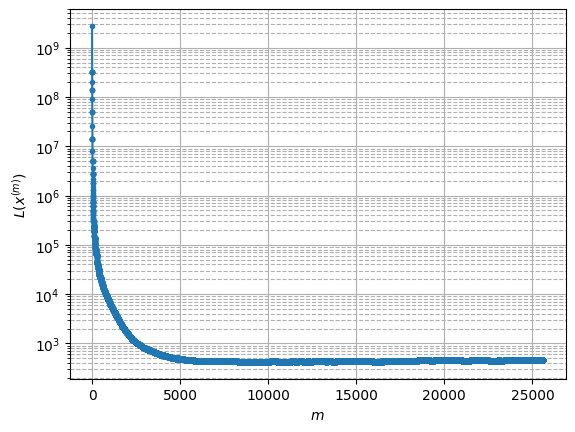

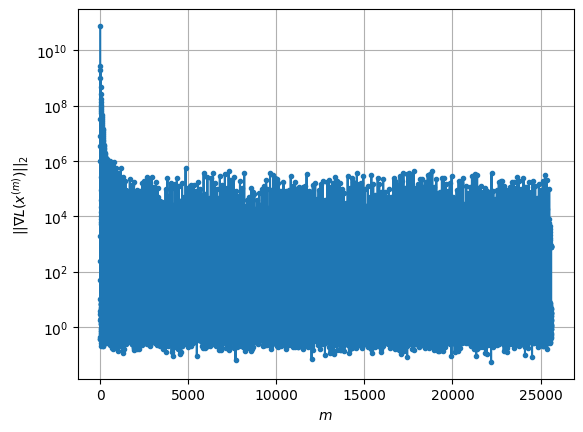

Windows:  77%|███████▋  | 229/296 [15:20:08<4:51:01, 260.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.3648381197842
Gradient norm: 202965.78218535814
Global relative error: 3.9093183944094916
Position relative errors: 0.014079435987922332 m, 1.5660444803279556 m, 0.5117522761146256 m, 3.545163410982392 m

STOP on Iteration 1
Cost function = 458.14103618632254 (-0.05%)
Gradient norm = 0.272738355887329 (-100.00%)
Global relative error = 3.9119822947491243 (0.07%)
Final position relative errors: 0.010578657988039926 m, 1.5742362515374826 m, 0.5140769911681369 m, 3.5441495230651126 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 458.0978555194586
Gradient norm: 18363.352213136444
Global relative error: 3.9119822947491243
Position relative errors: 0.010578657988039926 m, 1.5742362515374826 m, 0.5140769911681369 m, 3.5441495230651126 m

Iteration 1
Cost function: 458.07398591239655 (-0.01%)
Gradient norm: 1.151461741566732 (-99.99%)
Global relative error = 3.9130938

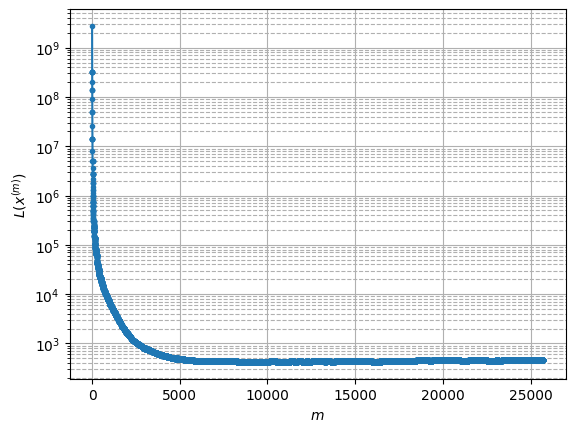

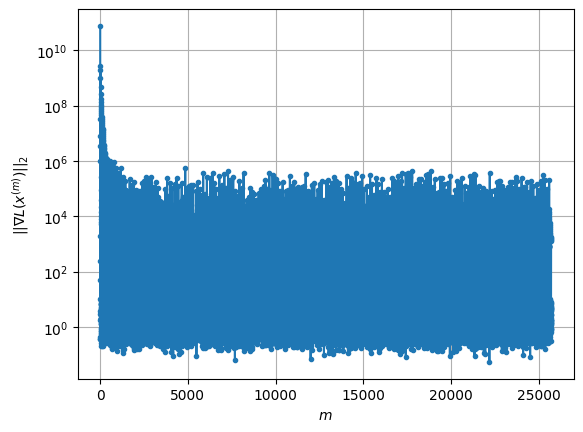

Windows:  78%|███████▊  | 230/296 [15:24:21<4:44:22, 258.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.2864896827389
Gradient norm: 300322.374471261
Global relative error: 3.870965415957096
Position relative errors: 0.01023509419703735 m, 1.6378899886074505 m, 0.4668082667029316 m, 3.4761575698385214 m

Iteration 1
Cost function: 455.87624150766896 (-0.09%)
Gradient norm: 4.150592462977228 (-100.00%)
Global relative error = 3.8684034595458328 (-0.07%)
Position relative errors: 0.020899859494585706 m, 1.629232740989447 m, 0.48756542123051366 m, 3.4744763182312575 m

Iteration 2
Cost function: 455.8762414879487 (-0.00%)
Gradient norm: 1.0649781176018995 (-74.34%)
Global relative error = 3.8684034566966785 (-0.00%)
Position relative errors: 0.02089986652523706 m, 1.6292327362089036 m, 0.487565413514671 m, 3.4744763183411993 m

Iteration 3
Cost function: 455.8762417424182 (0.00%)
Gradient norm: 1.1280931925968052 (5.93%)
Global relative error = 3.868403457772878 (0.00%)
Position relative errors: 0.020899

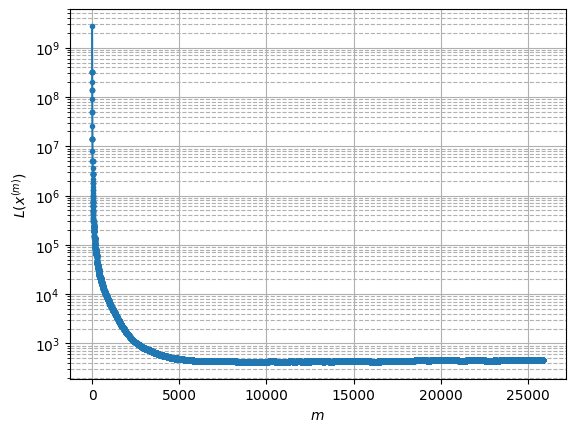

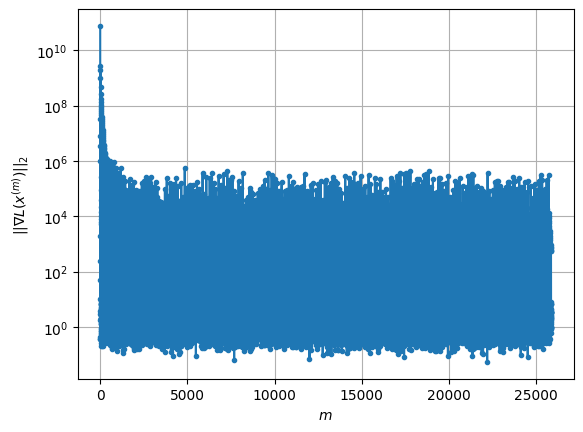

Windows:  78%|███████▊  | 231/296 [15:29:56<5:04:42, 281.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.4581589536255
Gradient norm: 136145.69998198777
Global relative error: 3.774422167298472
Position relative errors: 0.0199142920668325 m, 1.6389274108043717 m, 0.3787432697378512 m, 3.378806374451802 m

Iteration 1
Cost function: 456.32022453873134 (-0.03%)
Gradient norm: 1.887138858674737 (-100.00%)
Global relative error = 3.7740620467806942 (-0.01%)
Position relative errors: 0.015959079886234708 m, 1.6359519869554118 m, 0.39883926151978916 m, 3.3775544232457557 m

Iteration 2
Cost function: 456.32022382659204 (-0.00%)
Gradient norm: 2.7953814807573782 (48.13%)
Global relative error = 3.7740620483045033 (0.00%)
Position relative errors: 0.015959074766761012 m, 1.6359519869698678 m, 0.39883927234233296 m, 3.3775544236876573 m

Iteration 3
Cost function: 456.32022412020535 (0.00%)
Gradient norm: 4.743035805739129 (69.67%)
Global relative error = 3.7740620473087123 (-0.00%)
Position relative errors: 0.

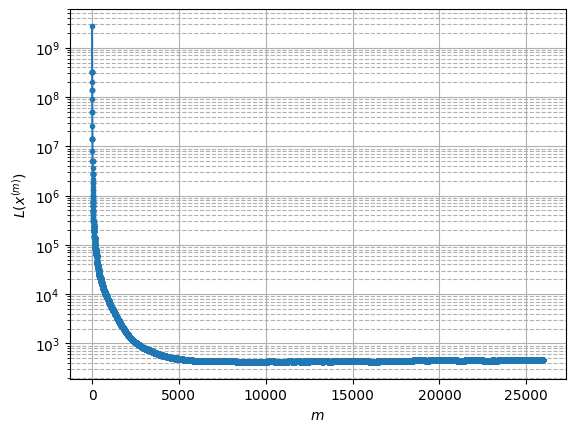

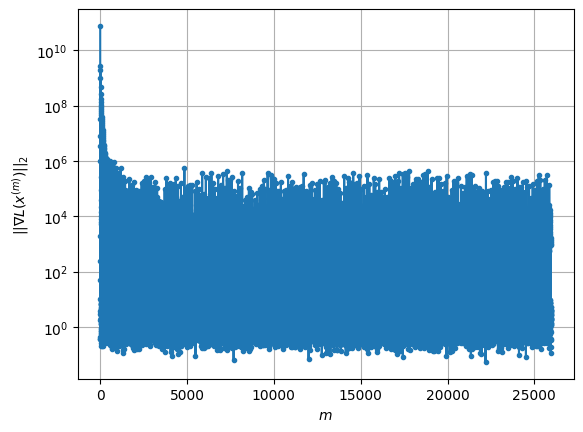

Windows:  78%|███████▊  | 232/296 [15:33:56<4:47:02, 269.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.84074880460014
Gradient norm: 177169.78801144173
Global relative error: 3.654329899548358
Position relative errors: 0.015920152289506988 m, 1.6353539601190556 m, 0.3417459885514281 m, 3.2500301338777233 m

Iteration 1
Cost function: 458.6192008150699 (-0.05%)
Gradient norm: 4.199323290755337 (-100.00%)
Global relative error = 3.6509563323655754 (-0.09%)
Position relative errors: 0.011719924405182137 m, 1.634723238683284 m, 0.32749865777575915 m, 3.248040108025636 m

STOP on Iteration 2
Cost function = 458.6192014313808 (0.00%)
Gradient norm = 0.26359694473083956 (-93.72%)
Global relative error = 3.650956332854529 (0.00%)
Final position relative errors: 0.011719925352979471 m, 1.634723238985048 m, 0.32749866287420015 m, 3.2480401079058736 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 458.5597253612748
Gradient norm: 23197.209338898087
Global relative error: 3.

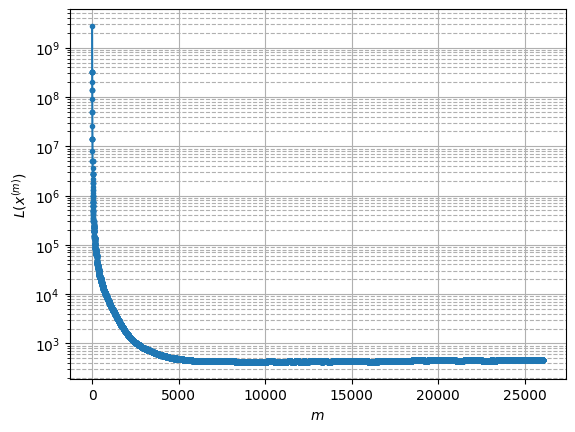

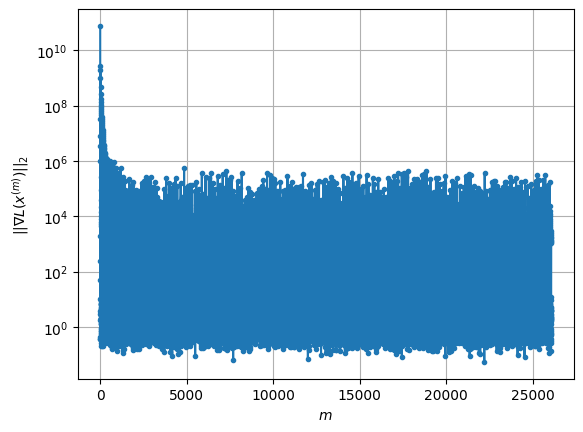

Windows:  79%|███████▊  | 233/296 [15:37:11<4:18:56, 246.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.5616671872998
Gradient norm: 178452.42284176988
Global relative error: 3.5069591978508963
Position relative errors: 0.011629917556674564 m, 1.6236888865070418 m, 0.2595704189107074 m, 3.0975602712153214 m

Iteration 1
Cost function: 453.113157774428 (-0.10%)
Gradient norm: 1.732303181343535 (-100.00%)
Global relative error = 3.5030045777987175 (-0.11%)
Position relative errors: 0.010384909226535828 m, 1.6212497802799384 m, 0.2436469490396006 m, 3.095660350861287 m

Iteration 2
Cost function: 453.1131578973167 (0.00%)
Gradient norm: 3.8904909043788694 (124.58%)
Global relative error = 3.5030045791307667 (0.00%)
Position relative errors: 0.010384916720142029 m, 1.6212497815135363 m, 0.24364694380146393 m, 3.095660352109691 m

Iteration 3
Cost function: 453.11315801506186 (0.00%)
Gradient norm: 1.6697169146289303 (-57.08%)
Global relative error = 3.50300457896943 (-0.00%)
Position relative errors: 0.01

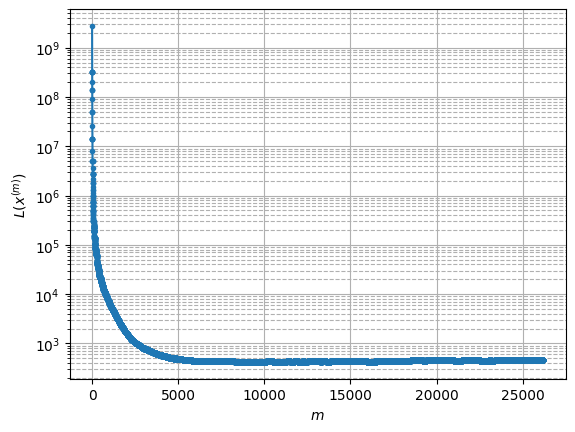

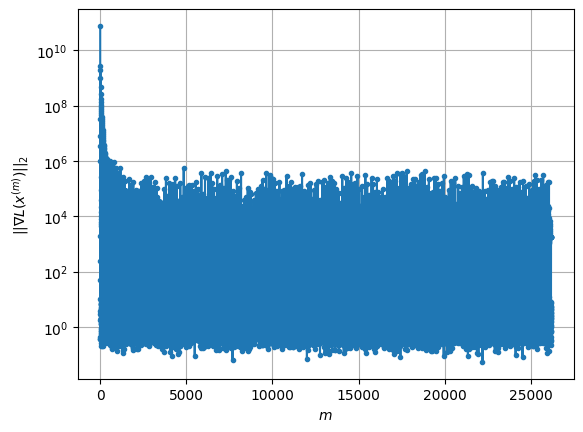

Windows:  79%|███████▉  | 234/296 [15:41:50<4:25:00, 256.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.66350304701655
Gradient norm: 48752.29666291952
Global relative error: 3.349675045848444
Position relative errors: 0.010931924594779298 m, 1.6085876903208547 m, 0.13958468430065607 m, 2.934818353875578 m

Iteration 1
Cost function: 454.4874991707998 (-0.04%)
Gradient norm: 1.6839986008134655 (-100.00%)
Global relative error = 3.347423538404151 (-0.07%)
Position relative errors: 0.0160361436518025 m, 1.6090611174792235 m, 0.13018199485787116 m, 2.9323976114589096 m

STOP on Iteration 2
Cost function = 454.4875012508728 (0.00%)
Gradient norm = 0.9463123068858483 (-43.81%)
Global relative error = 3.347423539497803 (0.00%)
Final position relative errors: 0.016036150853143194 m, 1.6090611178313057 m, 0.13018199415126774 m, 2.932397612506139 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.4363098948397
Gradient norm: 11846.020593206173
Global relative error: 3.34

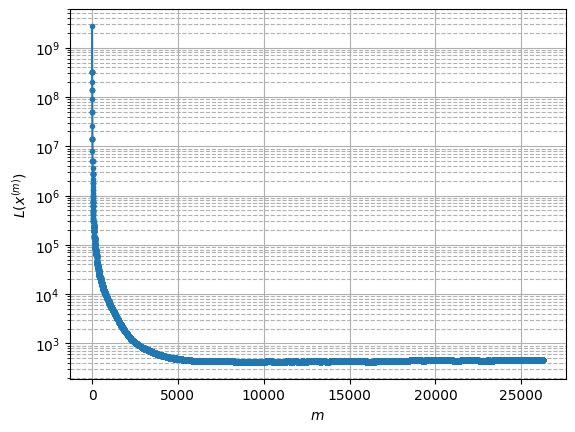

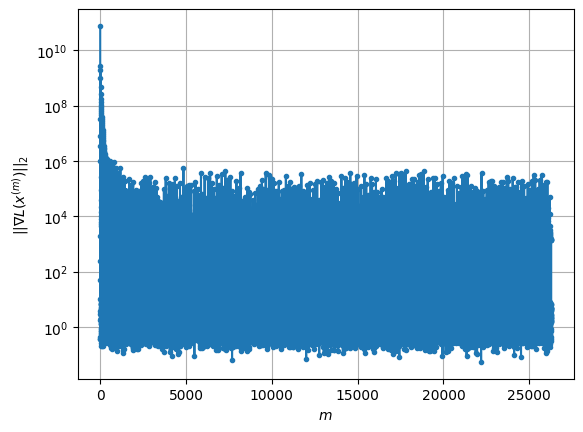

Windows:  79%|███████▉  | 235/296 [15:45:16<4:05:29, 241.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.59720749908627
Gradient norm: 131602.10617530844
Global relative error: 3.1834243689849697
Position relative errors: 0.01497085069950659 m, 1.6086633382973883 m, 0.10734584055141141 m, 2.744929590289881 m

Iteration 1
Cost function: 453.41211520336066 (-0.04%)
Gradient norm: 2.576331778879125 (-100.00%)
Global relative error = 3.183504053663491 (0.00%)
Position relative errors: 0.00981527816259161 m, 1.6118965511737644 m, 0.11472962478838689 m, 2.7428490773062166 m

STOP on Iteration 2
Cost function = 453.4121157367627 (0.00%)
Gradient norm = 0.651069061435158 (-74.73%)
Global relative error = 3.1835040533241936 (-0.00%)
Final position relative errors: 0.009815276660206033 m, 1.6118965515028822 m, 0.11472962315796853 m, 2.7428490767925706 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 453.36417546019953
Gradient norm: 11587.55289759191
Global relative error: 3

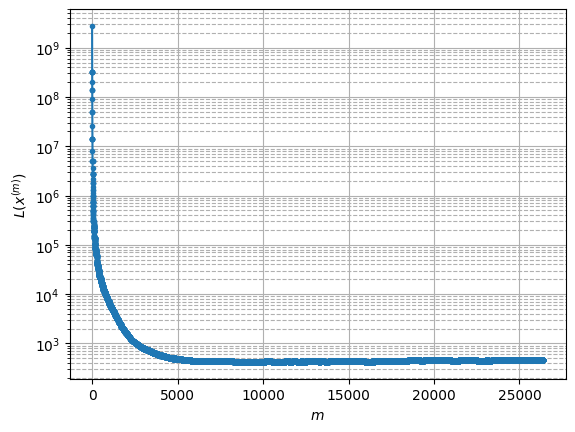

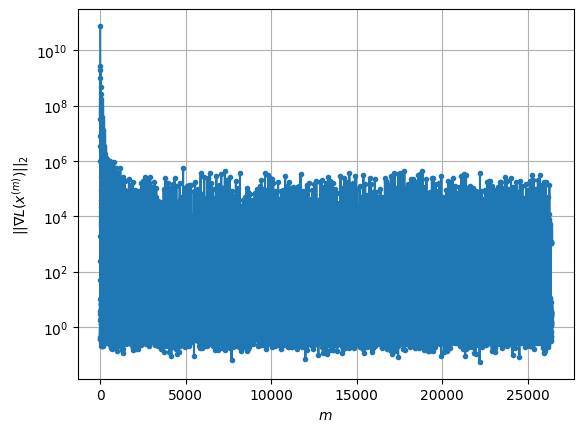

Windows:  80%|███████▉  | 236/296 [15:49:13<4:00:07, 240.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.1916734893713
Gradient norm: 160113.1280403258
Global relative error: 3.0132621511666073
Position relative errors: 0.009686673818016186 m, 1.6146245571395819 m, 0.28029394944998787 m, 2.5286497759199134 m

Iteration 1
Cost function: 455.82202568843843 (-0.08%)
Gradient norm: 1.137770984380354 (-100.00%)
Global relative error = 3.0200268189359014 (0.22%)
Position relative errors: 0.009662983030442602 m, 1.6256493495160584 m, 0.27429240230207264 m, 2.530313875796424 m

Iteration 2
Cost function: 455.82202656274984 (0.00%)
Gradient norm: 4.387148071067949 (285.59%)
Global relative error = 3.020026816322189 (-0.00%)
Position relative errors: 0.009662986608746002 m, 1.6256493469838522 m, 0.2742923949031105 m, 2.530313875092127 m

Iteration 3
Cost function: 455.8220261913875 (-0.00%)
Gradient norm: 2.686909545954575 (-38.75%)
Global relative error = 3.020026815902011 (-0.00%)
Position relative errors: 0.0

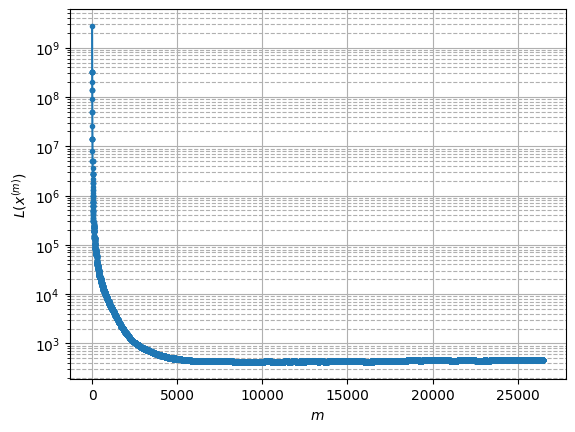

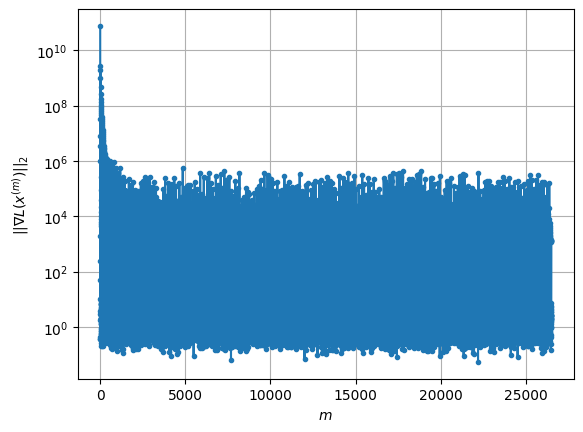

Windows:  80%|████████  | 237/296 [15:53:27<4:00:11, 244.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.64941126581033
Gradient norm: 339815.55113657855
Global relative error: 2.85695523316962
Position relative errors: 0.009399412550194821 m, 1.642898664138362 m, 0.40049137174545074 m, 2.3027345734722298 m

STOP on Iteration 1
Cost function = 454.15905473592676 (-0.11%)
Gradient norm = 0.6084348424993417 (-100.00%)
Global relative error = 2.8533462452495035 (-0.13%)
Final position relative errors: 0.020721222745925555 m, 1.641501255373441 m, 0.4122811534967708 m, 2.297094760474581 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.1286876297275
Gradient norm: 12776.962422618535
Global relative error: 2.8533462452495035
Position relative errors: 0.020721222745925555 m, 1.641501255373441 m, 0.4122811534967708 m, 2.297094760474581 m

Iteration 1
Cost function: 454.110576215034 (-0.00%)
Gradient norm: 4.72208069951488 (-99.96%)
Global relative error = 2.850229211670

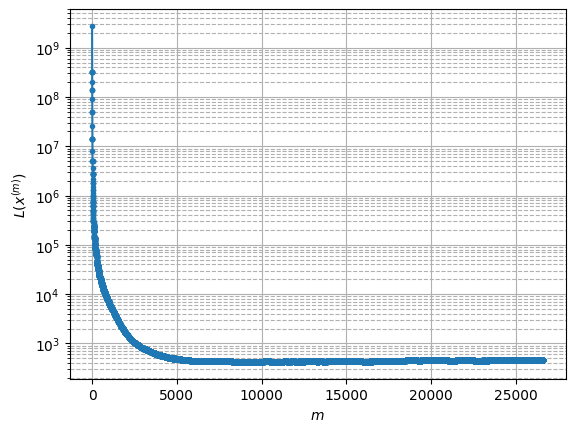

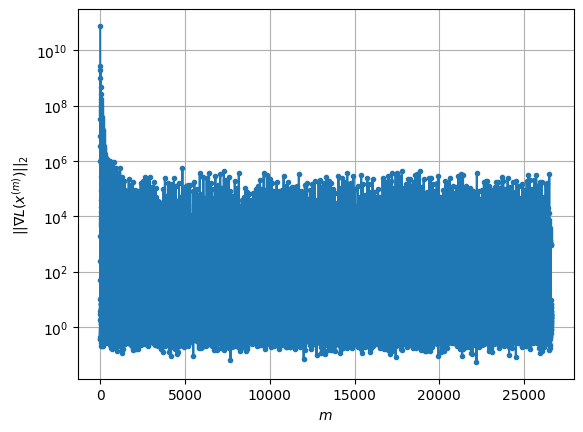

Windows:  80%|████████  | 238/296 [15:57:35<3:56:59, 245.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.7174566426036
Gradient norm: 138044.93556247893
Global relative error: 2.6728056700799905
Position relative errors: 0.020894142613650024 m, 1.6182002858228641 m, 0.5355324888839486 m, 2.0586589638606037 m

Iteration 1
Cost function: 462.56994215592545 (-0.03%)
Gradient norm: 1.7697896590282005 (-100.00%)
Global relative error = 2.6672826935815896 (-0.21%)
Position relative errors: 0.014048064888206785 m, 1.6219750694784483 m, 0.5276051235840269 m, 2.050614469258818 m

STOP on Iteration 2
Cost function = 462.56994242057436 (0.00%)
Gradient norm = 0.4821834812404672 (-72.75%)
Global relative error = 2.667282693278344 (-0.00%)
Final position relative errors: 0.014048060555218508 m, 1.62197506899286 m, 0.527605124106129 m, 2.050614469143819 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 462.55174796119564
Gradient norm: 9458.875383948778
Global relative error: 2.6

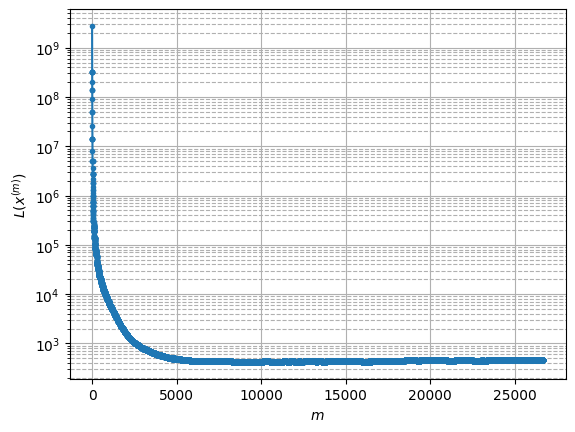

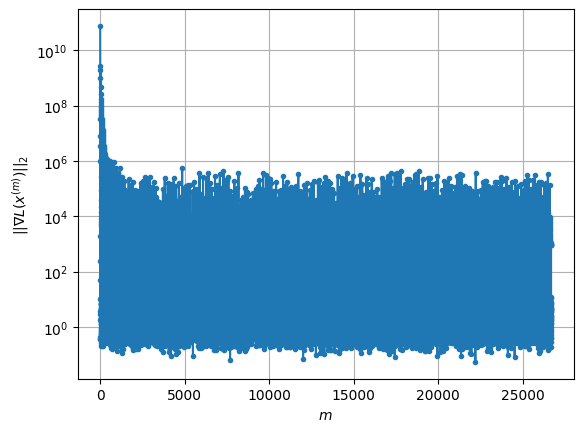

Windows:  81%|████████  | 239/296 [16:00:30<3:33:07, 224.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 460.8113497376165
Gradient norm: 44698.30251823299
Global relative error: 2.4986833501687054
Position relative errors: 0.014822191091717384 m, 1.590947424595339 m, 0.624987876775353 m, 1.822488674903125 m

STOP on Iteration 1
Cost function = 460.746975182013 (-0.01%)
Gradient norm = 0.5489329379480155 (-100.00%)
Global relative error = 2.4971698014110313 (-0.06%)
Final position relative errors: 0.01704363916372209 m, 1.5966734691748448 m, 0.6211240053917263 m, 1.8166989494230443 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 460.72113587559886
Gradient norm: 16472.255736669442
Global relative error: 2.4971698014110313
Position relative errors: 0.01704363916372209 m, 1.5966734691748448 m, 0.6211240053917263 m, 1.8166989494230443 m

Iteration 1
Cost function: 460.7029713314648 (-0.00%)
Gradient norm: 2.6660379931927105 (-99.98%)
Global relative error = 2.49634752534

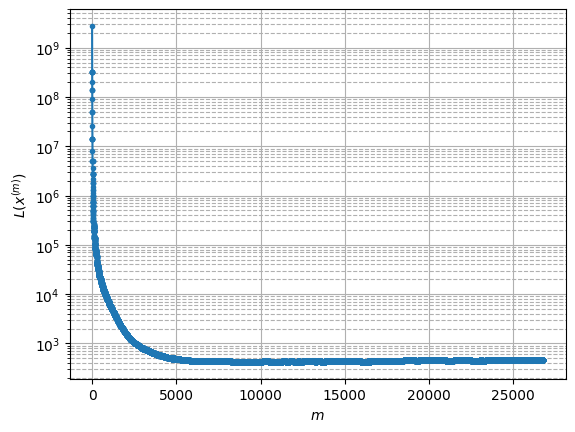

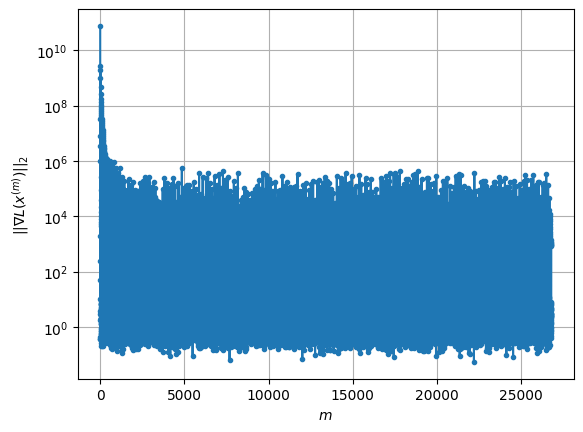

Windows:  81%|████████  | 240/296 [16:04:14<3:29:16, 224.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 460.5383165055331
Gradient norm: 54120.59137717524
Global relative error: 2.353691803229779
Position relative errors: 0.018027929948409186 m, 1.5674033668174105 m, 0.7296147238579785 m, 1.5970091656244898 m

Iteration 1
Cost function: 460.36374198970566 (-0.04%)
Gradient norm: 1.8577737135140928 (-100.00%)
Global relative error = 2.3605011024047986 (0.29%)
Position relative errors: 0.01015524178327701 m, 1.5745975880287792 m, 0.7390235359427859 m, 1.5957249415182329 m

Iteration 2
Cost function: 460.3637404639168 (-0.00%)
Gradient norm: 2.1532388313571964 (15.90%)
Global relative error = 2.3605011037664108 (0.00%)
Position relative errors: 0.010155243207346714 m, 1.5745975870234097 m, 0.7390235436056551 m, 1.595724940966529 m

Iteration 3
Cost function: 460.3637423417372 (0.00%)
Gradient norm: 2.3299735656525873 (8.21%)
Global relative error = 2.360501102895231 (-0.00%)
Position relative errors: 0.01015

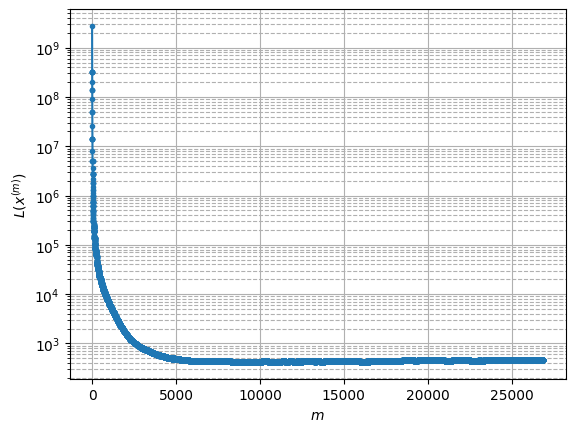

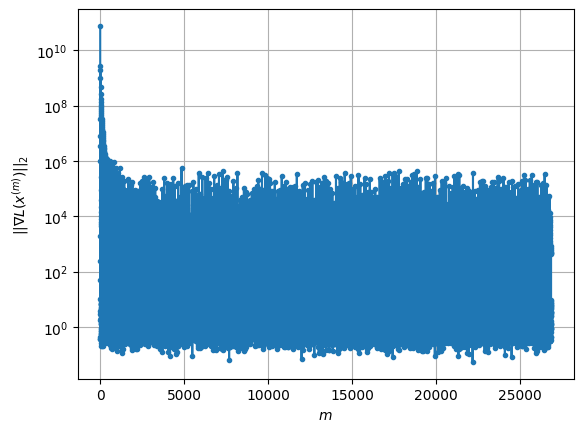

Windows:  81%|████████▏ | 241/296 [16:07:50<3:23:18, 221.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 463.2925021405719
Gradient norm: 306946.34341918945
Global relative error: 2.2435540190999714
Position relative errors: 0.011274298754861552 m, 1.5348796988486064 m, 0.8659109930171077 m, 1.388430228207715 m

Iteration 1
Cost function: 463.09873460498414 (-0.04%)
Gradient norm: 1.1203788030573392 (-100.00%)
Global relative error = 2.2426033845111846 (-0.04%)
Position relative errors: 0.016073077251506137 m, 1.536729578529847 m, 0.8666963345340924 m, 1.384304799703231 m

STOP on Iteration 2
Cost function = 463.09873663308065 (0.00%)
Gradient norm = 0.791299692206856 (-29.37%)
Global relative error = 2.242603380981244 (-0.00%)
Final position relative errors: 0.016073077363807028 m, 1.5367295770316434 m, 0.8666963276707385 m, 1.3843047999435887 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 463.0574498889033
Gradient norm: 23962.336353705126
Global relative error: 2.

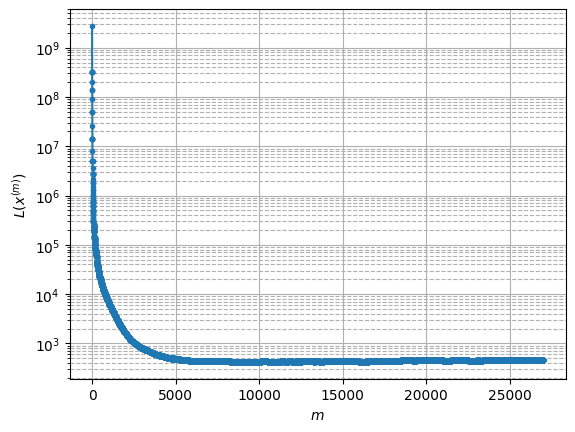

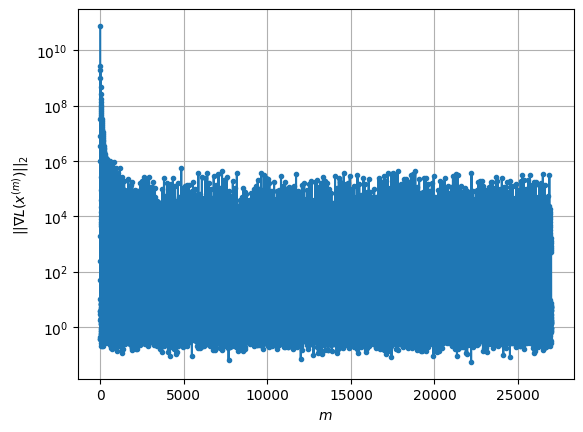

Windows:  82%|████████▏ | 242/296 [16:11:52<3:24:51, 227.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.8063340838345
Gradient norm: 112479.34918807556
Global relative error: 2.1308125142542838
Position relative errors: 0.017248514241179427 m, 1.473484183691382 m, 0.9695009030543413 m, 1.195393143821753 m

Iteration 1
Cost function: 462.73548446672044 (-0.02%)
Gradient norm: 3.2971201777511308 (-100.00%)
Global relative error = 2.1334695704711892 (0.12%)
Position relative errors: 0.020444211516528844 m, 1.4723524330372846 m, 0.9791992751119403 m, 1.193570055561548 m

Iteration 2
Cost function: 462.73548469497285 (0.00%)
Gradient norm: 1.3112649877872107 (-60.23%)
Global relative error = 2.1334695742736196 (0.00%)
Position relative errors: 0.020444213621716813 m, 1.4723524359835933 m, 0.9791992786307511 m, 1.1935700558009097 m

STOP on Iteration 3
Cost function = 462.7354846257975 (-0.00%)
Gradient norm = 0.46619949327603194 (-64.45%)
Global relative error = 2.1334695709486993 (-0.00%)
Final position r

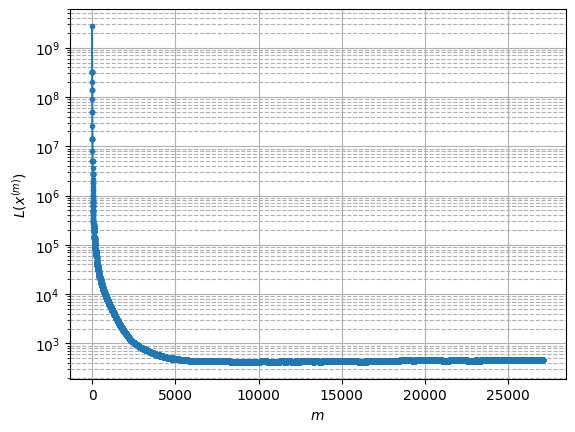

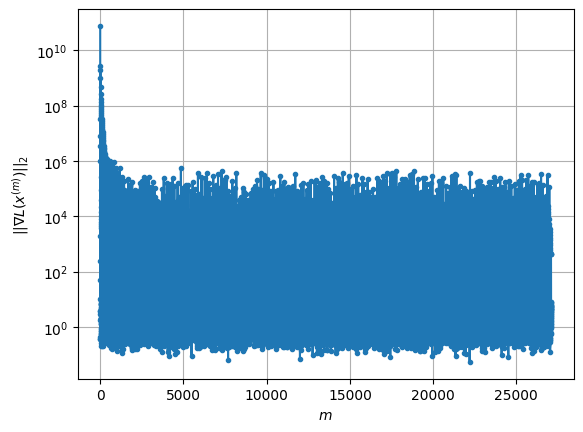

Windows:  82%|████████▏ | 243/296 [16:15:54<3:24:50, 231.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 467.7968114042024
Gradient norm: 212678.82064737228
Global relative error: 2.032295922564964
Position relative errors: 0.02147714129716221 m, 1.3982745658731073 m, 1.0771707268217006 m, 1.007116869453683 m

STOP on Iteration 1
Cost function = 467.63306856707743 (-0.04%)
Gradient norm = 0.5266932850464553 (-100.00%)
Global relative error = 2.025278351490898 (-0.35%)
Final position relative errors: 0.021564422927869833 m, 1.3927388025395249 m, 1.0718349363850306 m, 1.0063415871409436 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 467.5920998360317
Gradient norm: 24980.670073335583
Global relative error: 2.025278351490898
Position relative errors: 0.021564422927869833 m, 1.3927388025395249 m, 1.0718349363850306 m, 1.0063415871409436 m

STOP on Iteration 1
Cost function = 467.56965171557044 (-0.00%)
Gradient norm = 0.9038667671060626 (-100.00%)
Global relative error =

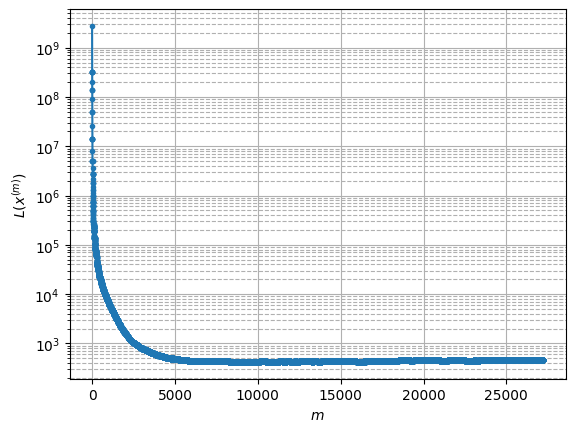

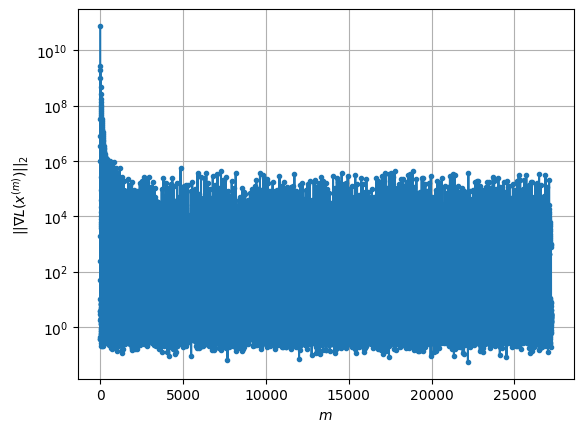

Windows:  82%|████████▏ | 244/296 [16:20:30<3:32:35, 245.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 465.3408100434345
Gradient norm: 138603.36593834183
Global relative error: 1.8844963431901671
Position relative errors: 0.021289651308953557 m, 1.2759229255757132 m, 1.109380631992509 m, 0.8319590622413227 m

Iteration 1
Cost function: 465.18167311339744 (-0.03%)
Gradient norm: 3.3503168671026735 (-100.00%)
Global relative error = 1.8916196882773193 (0.38%)
Position relative errors: 0.017597458034879054 m, 1.2712210815457121 m, 1.1274003310266862 m, 0.8311848075121283 m

STOP on Iteration 2
Cost function = 465.1816729024561 (-0.00%)
Gradient norm = 0.8451490264671798 (-74.77%)
Global relative error = 1.8916196908654557 (0.00%)
Final position relative errors: 0.017597457870450688 m, 1.2712210789338103 m, 1.1274003381776172 m, 0.8311848077010282 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 465.1273328453811
Gradient norm: 19429.870425377183
Global relative error: 

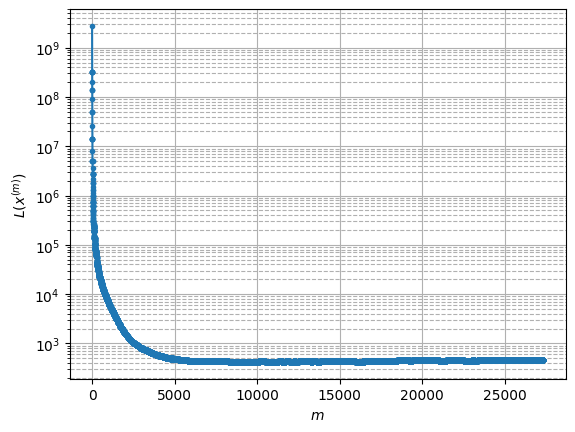

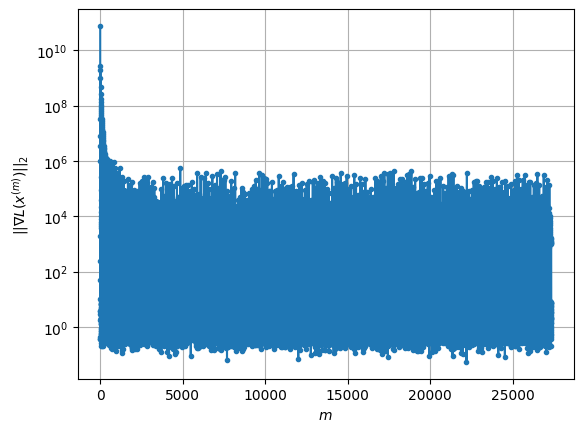

Windows:  83%|████████▎ | 245/296 [16:24:28<3:26:40, 243.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.0189769144972
Gradient norm: 236162.30156521176
Global relative error: 1.8220060352332752
Position relative errors: 0.018696649453836027 m, 1.1698636434831797 m, 1.2312689152486178 m, 0.6593477336748841 m

Iteration 1
Cost function: 461.7962113876657 (-0.05%)
Gradient norm: 1.4561693248831864 (-100.00%)
Global relative error = 1.8284551709919092 (0.35%)
Position relative errors: 0.024513347774724217 m, 1.1616869288014728 m, 1.2496939929472146 m, 0.6567974501664275 m

Iteration 2
Cost function: 461.7962116131407 (0.00%)
Gradient norm: 1.6949008896640294 (16.39%)
Global relative error = 1.8284551705229037 (-0.00%)
Position relative errors: 0.024513348297015104 m, 1.1616869282965903 m, 1.2496939927642512 m, 0.6567974500823864 m

STOP on Iteration 3
Cost function = 461.7962115703935 (-0.00%)
Gradient norm = 0.30836880287716595 (-81.81%)
Global relative error = 1.8284551688751247 (-0.00%)
Final position 

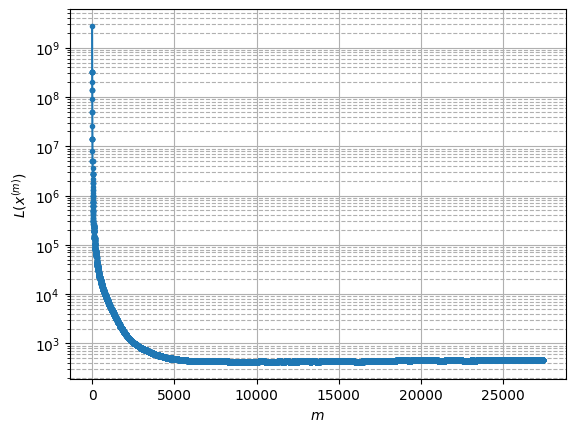

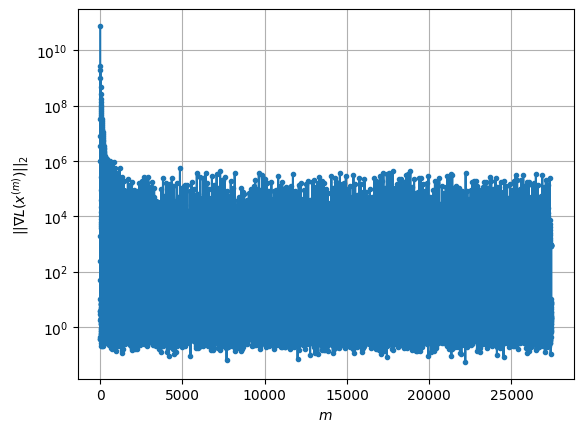

Windows:  83%|████████▎ | 246/296 [16:27:58<3:14:14, 233.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.19121631273117
Gradient norm: 83599.03765155864
Global relative error: 1.7161624257999863
Position relative errors: 0.023689879236345492 m, 1.0278588137403026 m, 1.2888181124669302 m, 0.47654307859622025 m

Iteration 1
Cost function: 458.9664813813162 (-0.05%)
Gradient norm: 1.4804635055926523 (-100.00%)
Global relative error = 1.6905916377065016 (-1.49%)
Position relative errors: 0.02791931132571641 m, 1.0303925460990262 m, 1.2527779962011873 m, 0.47554818433129414 m

Iteration 2
Cost function: 458.96648228912966 (0.00%)
Gradient norm: 1.696286921541042 (14.58%)
Global relative error = 1.6905916581553955 (0.00%)
Position relative errors: 0.027919310680179114 m, 1.0303925472708226 m, 1.2527780227767373 m, 0.47554818451643405 m

Iteration 3
Cost function: 458.9664818660121 (-0.00%)
Gradient norm: 1.3549793446802847 (-20.12%)
Global relative error = 1.690591654075521 (-0.00%)
Position relative errors:

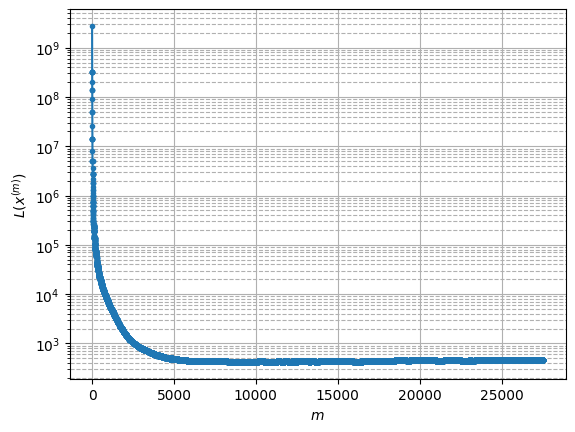

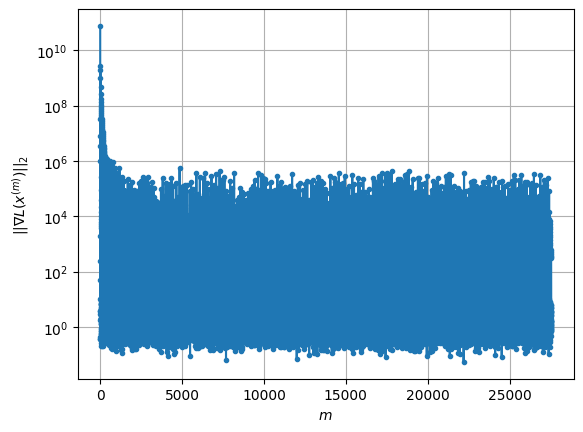

Windows:  83%|████████▎ | 247/296 [16:32:32<3:20:20, 245.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.1972818591125
Gradient norm: 246840.48905237162
Global relative error: 1.5348173780709569
Position relative errors: 0.02634895878892499 m, 0.8856188508494502 m, 1.2128578712725009 m, 0.31561393282856565 m

Iteration 1
Cost function: 458.8444494161896 (-0.08%)
Gradient norm: 1.9881936095666528 (-100.00%)
Global relative error = 1.5281245721269119 (-0.44%)
Position relative errors: 0.03282975509682477 m, 0.8630576695576084 m, 1.2195586697896423 m, 0.3191896757021858 m

Iteration 2
Cost function: 458.8444497058792 (0.00%)
Gradient norm: 2.837382256029491 (42.71%)
Global relative error = 1.5281245671899384 (-0.00%)
Position relative errors: 0.03282975356369976 m, 0.8630576598034855 m, 1.2195586700921182 m, 0.3191896774425896 m

Iteration 3
Cost function: 458.844449389532 (-0.00%)
Gradient norm: 1.297072649822498 (-54.29%)
Global relative error = 1.528124567618204 (0.00%)
Position relative errors: 0.0328

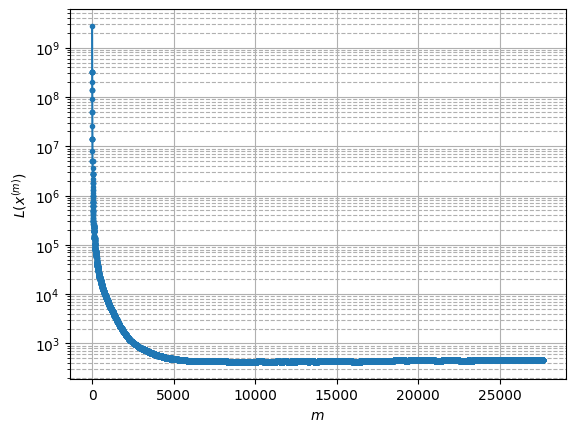

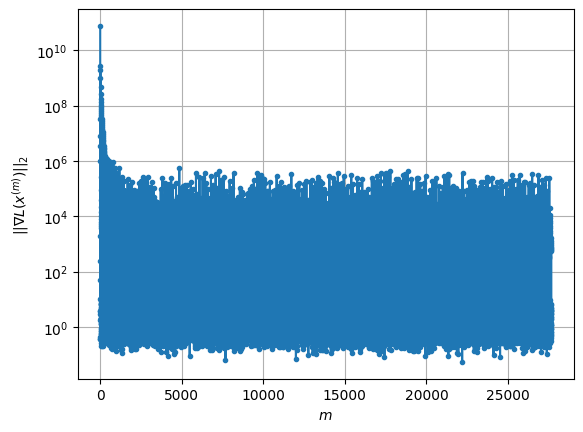

Windows:  84%|████████▍ | 248/296 [16:36:42<3:17:32, 246.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.69532455381034
Gradient norm: 319162.5901544662
Global relative error: 1.3981218835698435
Position relative errors: 0.030233727009603896 m, 0.6600831722713331 m, 1.211204337399146 m, 0.22603523182708823 m

STOP on Iteration 1
Cost function = 454.27933768109216 (-0.09%)
Gradient norm = 0.7553773351521454 (-100.00%)
Global relative error = 1.4038420299626908 (0.41%)
Final position relative errors: 0.016534191551546947 m, 0.6609193041375299 m, 1.2134865526054561 m, 0.24722872984989974 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.25954866335525
Gradient norm: 7543.243518294867
Global relative error: 1.4038420299626908
Position relative errors: 0.016534191551546947 m, 0.6609193041375299 m, 1.2134865526054561 m, 0.24722872984989974 m

STOP on Iteration 1
Cost function = 454.25023727752534 (-0.00%)
Gradient norm = 0.686524740882857 (-99.99%)
Global relative err

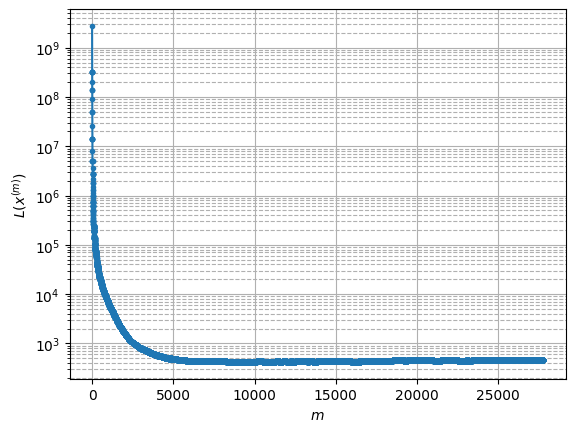

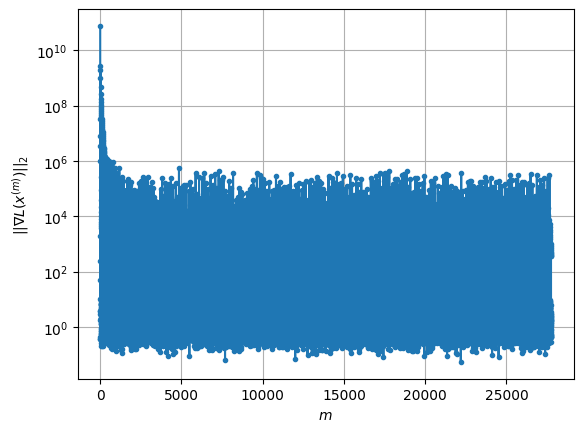

Windows:  84%|████████▍ | 249/296 [16:40:37<3:10:29, 243.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.9137395456715
Gradient norm: 220934.37530325082
Global relative error: 1.3724364906423039
Position relative errors: 0.016621937688400982 m, 0.4936585015156261 m, 1.2658650546694408 m, 0.19281952914733985 m

Iteration 1
Cost function: 453.57463899124093 (-0.07%)
Gradient norm: 7.177430795323415 (-100.00%)
Global relative error = 1.3808094640265667 (0.61%)
Position relative errors: 0.031191848619160432 m, 0.5004231730449918 m, 1.2725380337819123 m, 0.18939958613763663 m

Iteration 2
Cost function: 453.57463951451007 (0.00%)
Gradient norm: 7.403183263853757 (3.15%)
Global relative error = 1.3808094617496165 (-0.00%)
Position relative errors: 0.031191846404059982 m, 0.5004231764693573 m, 1.2725380313354613 m, 0.18939957729197512 m

Iteration 3
Cost function: 453.5746386736584 (-0.00%)
Gradient norm: 3.01161969828756 (-59.32%)
Global relative error = 1.3808094640443662 (0.00%)
Position relative errors: 0

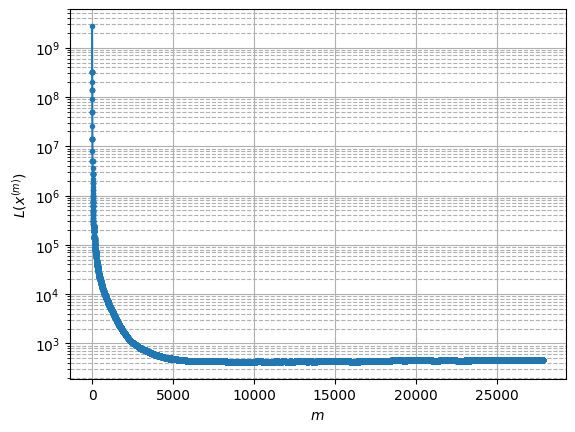

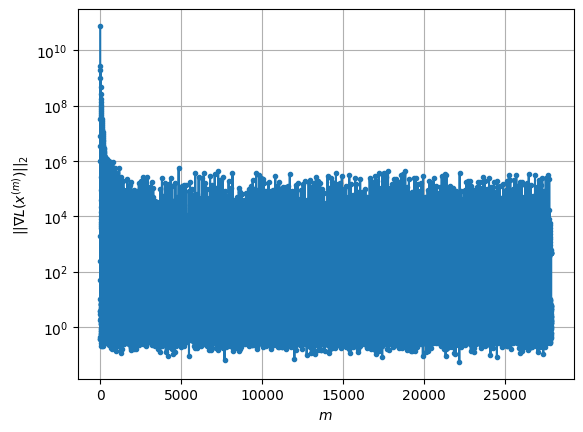

Windows:  84%|████████▍ | 250/296 [16:45:17<3:14:55, 254.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.9675774009341
Gradient norm: 71197.28571909129
Global relative error: 1.4376680755968478
Position relative errors: 0.03242528447756386 m, 0.41925808354335203 m, 1.3576613245181033 m, 0.21634037792632366 m

Iteration 1
Cost function: 454.7429595939165 (-0.05%)
Gradient norm: 6.808937164996168 (-99.99%)
Global relative error = 1.4357998755530452 (-0.13%)
Position relative errors: 0.044815905595570846 m, 0.41297436279662636 m, 1.3581393155509245 m, 0.21073509119796577 m

Iteration 2
Cost function: 454.7429609986485 (0.00%)
Gradient norm: 2.2683447465265667 (-66.69%)
Global relative error = 1.4357998775079877 (0.00%)
Position relative errors: 0.04481589778897611 m, 0.4129743568739746 m, 1.358139319873755 m, 0.21073508992460893 m

STOP on Iteration 3
Cost function = 454.7429597710923 (-0.00%)
Gradient norm = 0.9401832263060607 (-58.55%)
Global relative error = 1.4357998718853686 (-0.00%)
Final position r

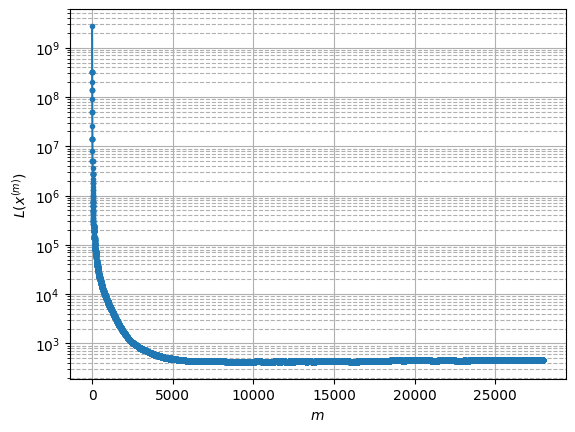

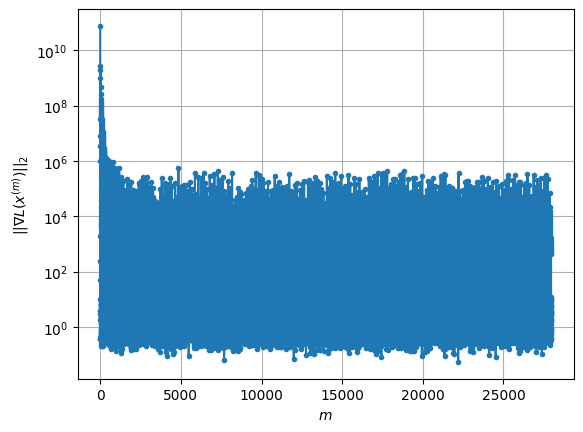

Windows:  85%|████████▍ | 251/296 [16:48:36<2:58:21, 237.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.3129421189268
Gradient norm: 348278.7785689149
Global relative error: 1.4925519276632748
Position relative errors: 0.04378423181269549 m, 0.309986874303421 m, 1.4079409619073529 m, 0.3839159548753667 m

Iteration 1
Cost function: 453.0396468411006 (-0.06%)
Gradient norm: 3.4002997545614764 (-100.00%)
Global relative error = 1.4953321121472627 (0.19%)
Position relative errors: 0.05807838410310244 m, 0.31946225763563124 m, 1.4075613771894397 m, 0.3864540470668774 m

Iteration 2
Cost function: 453.0396465444824 (-0.00%)
Gradient norm: 4.070930489829855 (19.72%)
Global relative error = 1.495332113134774 (0.00%)
Position relative errors: 0.05807838231802843 m, 0.3194622574890258 m, 1.407561378406308 m, 0.3864540468452402 m

Iteration 3
Cost function: 453.03964716830217 (0.00%)
Gradient norm: 5.867389589826121 (44.13%)
Global relative error = 1.4953321119155925 (-0.00%)
Position relative errors: 0.0580783

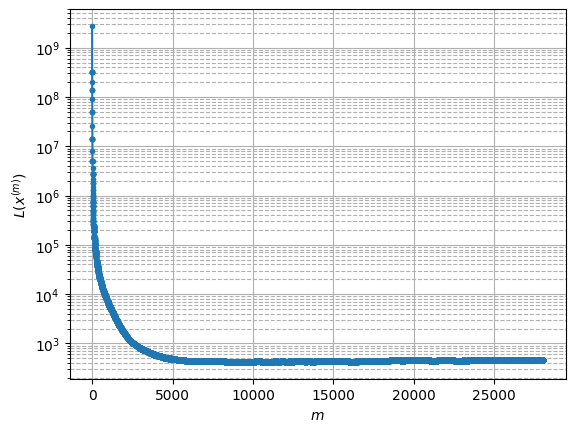

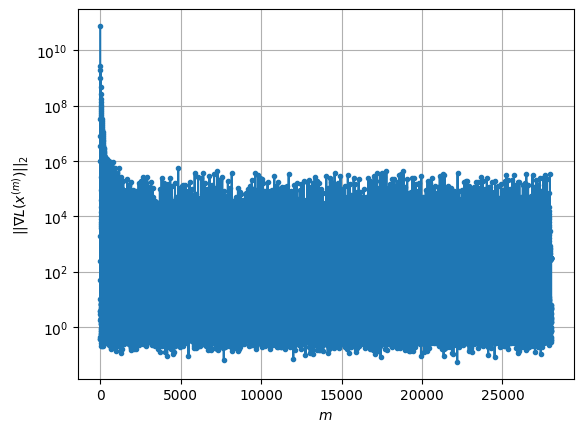

Windows:  85%|████████▌ | 252/296 [16:51:24<2:38:58, 216.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.9724185641629
Gradient norm: 525993.9367328723
Global relative error: 1.5756967552932497
Position relative errors: 0.05614710387016853 m, 0.26707941895786014 m, 1.4402675184524834 m, 0.5778866743422246 m

Iteration 1
Cost function: 454.4081770003218 (-0.12%)
Gradient norm: 1.4594362859026304 (-100.00%)
Global relative error = 1.5687668929383738 (-0.44%)
Position relative errors: 0.05995398542308695 m, 0.26909196948739034 m, 1.4328112012729042 m, 0.5762498366516963 m

Iteration 2
Cost function: 454.40817842089535 (0.00%)
Gradient norm: 2.726594509002944 (86.83%)
Global relative error = 1.568766891977223 (-0.00%)
Position relative errors: 0.059953981866264605 m, 0.26909196890641324 m, 1.4328112006199631 m, 0.5762498362999454 m

Iteration 3
Cost function: 454.4081772623527 (-0.00%)
Gradient norm: 1.754869409862142 (-35.64%)
Global relative error = 1.5687668934025616 (0.00%)
Position relative errors: 0.

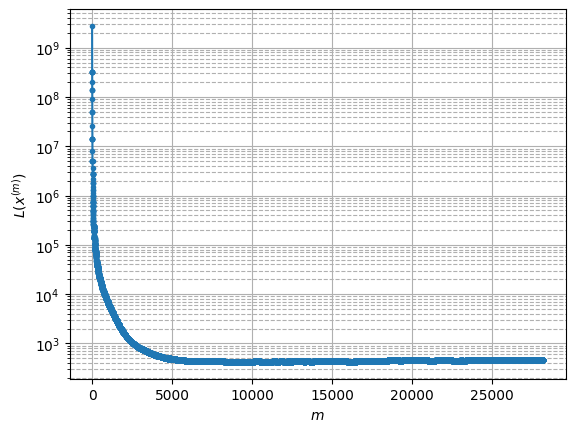

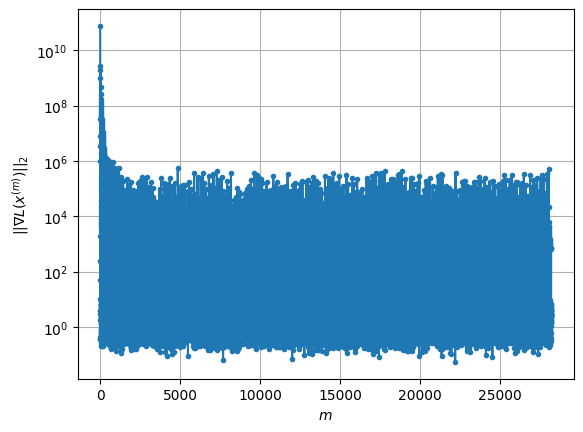

Windows:  85%|████████▌ | 253/296 [16:57:28<3:06:59, 260.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.5324733963059
Gradient norm: 104399.05374419718
Global relative error: 1.6718926539031511
Position relative errors: 0.056794768561081274 m, 0.2559423428244631 m, 1.4768766763841588 m, 0.7384550969048975 m

Iteration 1
Cost function: 457.1426196601533 (-0.09%)
Gradient norm: 3.374516314096272 (-100.00%)
Global relative error = 1.6653842377170511 (-0.39%)
Position relative errors: 0.058069929175093515 m, 0.25881512872406776 m, 1.4713118146607118 m, 0.7337414956457984 m

Iteration 2
Cost function: 457.1426192750906 (-0.00%)
Gradient norm: 3.2257470144587552 (-4.41%)
Global relative error = 1.665384239413713 (0.00%)
Position relative errors: 0.05806992197224639 m, 0.25881512728078965 m, 1.4713118172304527 m, 0.7337414954229835 m

STOP on Iteration 3
Cost function = 457.14261991202045 (0.00%)
Gradient norm = 0.896697998224859 (-72.20%)
Global relative error = 1.6653842388362285 (-0.00%)
Final position re

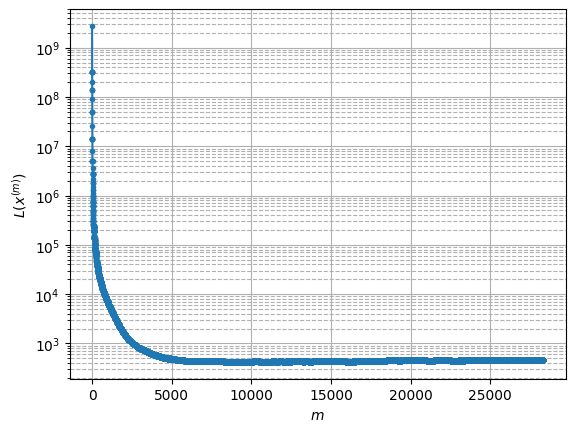

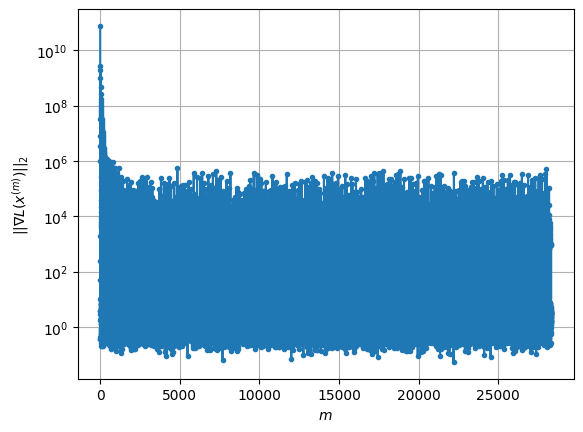

Windows:  86%|████████▌ | 254/296 [17:02:17<3:08:31, 269.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.4027529908663
Gradient norm: 146736.4326524215
Global relative error: 1.8011481952995028
Position relative errors: 0.05635591752009768 m, 0.3824626004898235 m, 1.5322169022616055 m, 0.8642806110102675 m

STOP on Iteration 1
Cost function = 457.2506238391381 (-0.03%)
Gradient norm = 0.31661148685478446 (-100.00%)
Global relative error = 1.804045440775841 (0.16%)
Final position relative errors: 0.052655603261962856 m, 0.3826368633634449 m, 1.5355961016693331 m, 0.8644821602750494 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.21066470646673
Gradient norm: 17064.44132320807
Global relative error: 1.804045440775841
Position relative errors: 0.052655603261962856 m, 0.3826368633634449 m, 1.5355961016693331 m, 0.8644821602750494 m

STOP on Iteration 1
Cost function = 457.19003966111484 (-0.00%)
Gradient norm = 0.4964349971507244 (-100.00%)
Global relative error =

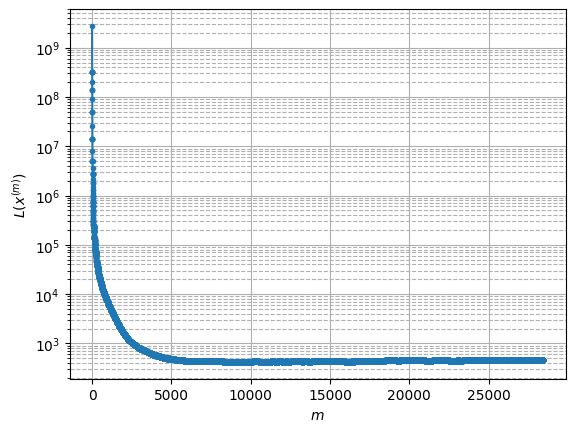

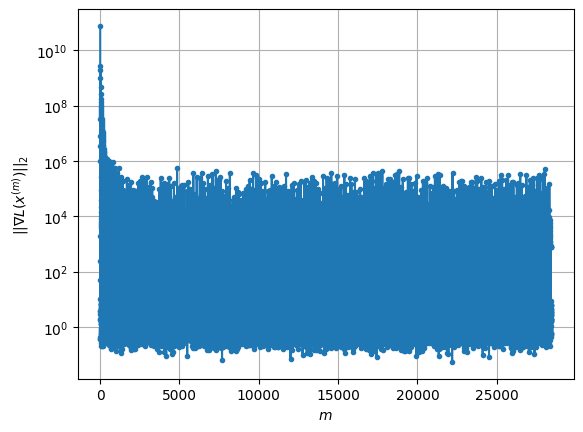

Windows:  86%|████████▌ | 255/296 [17:06:27<3:00:07, 263.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.4960869389652
Gradient norm: 84980.30466824335
Global relative error: 1.9478309416623145
Position relative errors: 0.051202396025848286 m, 0.5282693983690819 m, 1.590794769582855 m, 0.9908159473157082 m

STOP on Iteration 1
Cost function = 462.19134330272647 (-0.07%)
Gradient norm = 0.3161032050857879 (-100.00%)
Global relative error = 1.9509719379166641 (0.16%)
Final position relative errors: 0.054758030865047755 m, 0.5255956314332191 m, 1.5920958553859343 m, 0.9961235855470552 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 462.09448337078067
Gradient norm: 21071.7142394317
Global relative error: 1.9509719379166641
Position relative errors: 0.054758030865047755 m, 0.5255956314332191 m, 1.5920958553859343 m, 0.9961235855470552 m

Iteration 1
Cost function: 462.0460269747784 (-0.01%)
Gradient norm: 1.7417798077836075 (-99.99%)
Global relative error = 1.95457634

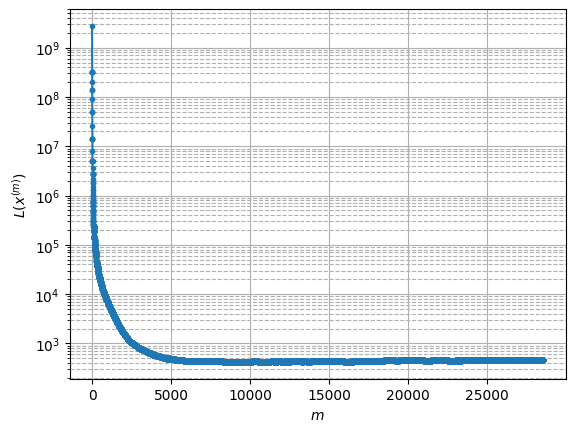

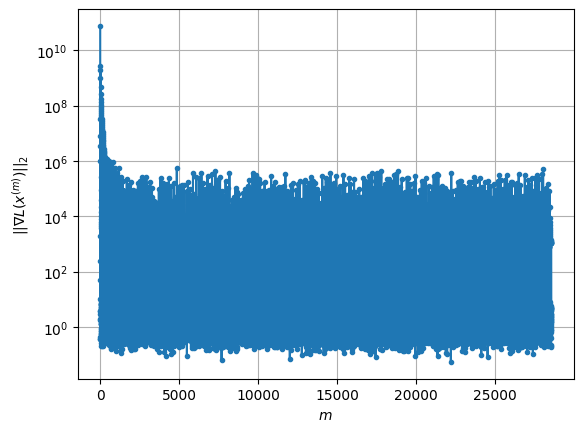

Windows:  86%|████████▋ | 256/296 [17:10:19<2:49:23, 254.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.7827887299544
Gradient norm: 296492.5688937091
Global relative error: 2.095008032851713
Position relative errors: 0.053218773116494394 m, 0.6640346854124981 m, 1.6507433462866268 m, 1.1046812705695725 m

STOP on Iteration 1
Cost function = 457.3922224512967 (-0.09%)
Gradient norm = 0.5074755398453112 (-100.00%)
Global relative error = 2.091959775820457 (-0.15%)
Final position relative errors: 0.06905063704560788 m, 0.6651828171507969 m, 1.6526854978580725 m, 1.0943857408643778 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 457.3565741873058
Gradient norm: 10411.567785234885
Global relative error: 2.091959775820457
Position relative errors: 0.06905063704560788 m, 0.6651828171507969 m, 1.6526854978580725 m, 1.0943857408643778 m

STOP on Iteration 1
Cost function = 457.3404313427855 (-0.00%)
Gradient norm = 0.9045035728469543 (-99.99%)
Global relative error = 2.0

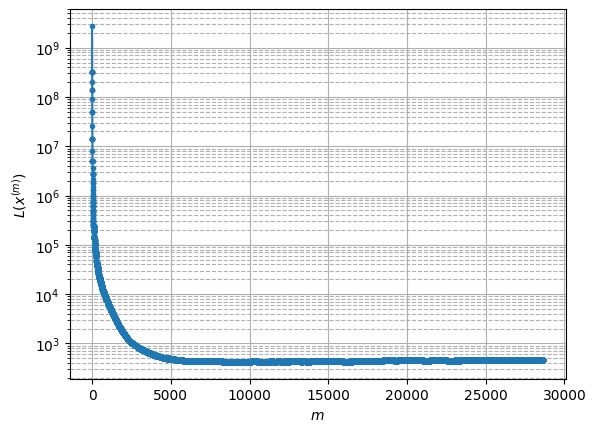

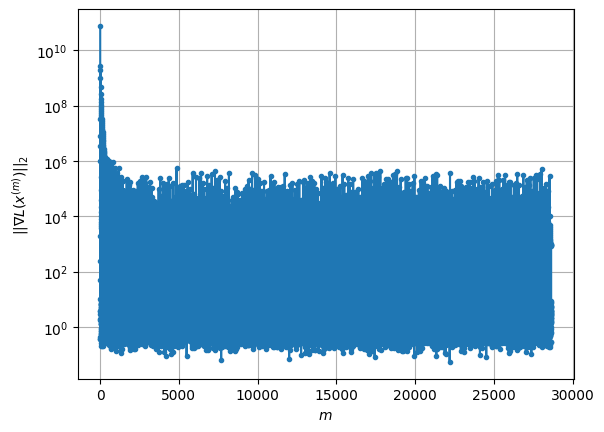

Windows:  87%|████████▋ | 257/296 [17:14:05<2:39:44, 245.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.4266894352344
Gradient norm: 130759.4933511926
Global relative error: 2.1712419073166584
Position relative errors: 0.06550203685916993 m, 0.7831703990775574 m, 1.6593541093752298 m, 1.1589563522972717 m

Iteration 1
Cost function: 454.06808192211514 (-0.08%)
Gradient norm: 3.5362761345224976 (-100.00%)
Global relative error = 2.169101397598187 (-0.10%)
Position relative errors: 0.051977383865635274 m, 0.77748822840659 m, 1.6570812230222487 m, 1.1627054564909765 m

Iteration 2
Cost function: 454.0680819837519 (0.00%)
Gradient norm: 2.917126408070613 (-17.51%)
Global relative error = 2.1691013971907407 (-0.00%)
Position relative errors: 0.051977381852118955 m, 0.7774882261153597 m, 1.6570812231030878 m, 1.1627054572377833 m

Iteration 3
Cost function: 454.0680810605776 (-0.00%)
Gradient norm: 3.249281389867596 (11.39%)
Global relative error = 2.16910140012192 (0.00%)
Position relative errors: 0.051977

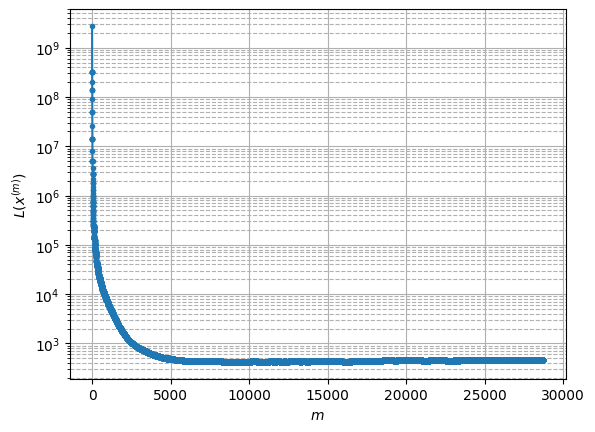

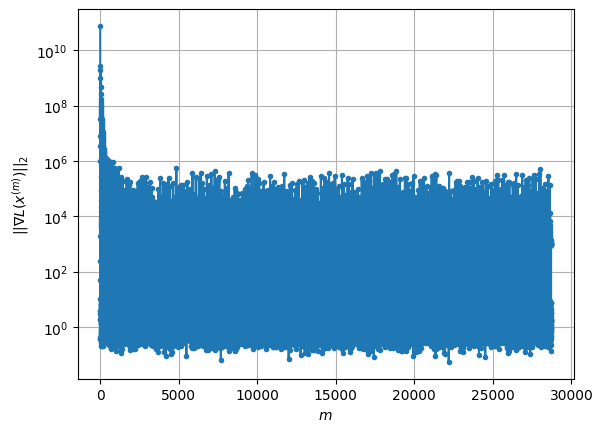

Windows:  87%|████████▋ | 258/296 [17:16:56<2:21:19, 223.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.8128109092028
Gradient norm: 114203.46059839967
Global relative error: 2.2489230402689944
Position relative errors: 0.049696835851107055 m, 0.8976156835186928 m, 1.652924674384885 m, 1.2317885124691057 m

STOP on Iteration 1
Cost function = 454.6193406332897 (-0.04%)
Gradient norm = 0.18678612741755302 (-100.00%)
Global relative error = 2.245579338741829 (-0.15%)
Final position relative errors: 0.04483885970585568 m, 0.8994877719276644 m, 1.6543346357352808 m, 1.2225818968768922 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.56405865891446
Gradient norm: 16766.380144900908
Global relative error: 2.245579338741829
Position relative errors: 0.04483885970585568 m, 0.8994877719276644 m, 1.6543346357352808 m, 1.2225818968768922 m

Iteration 1
Cost function: 454.5377182836963 (-0.01%)
Gradient norm: 3.3326285865812895 (-99.98%)
Global relative error = 2.24335503

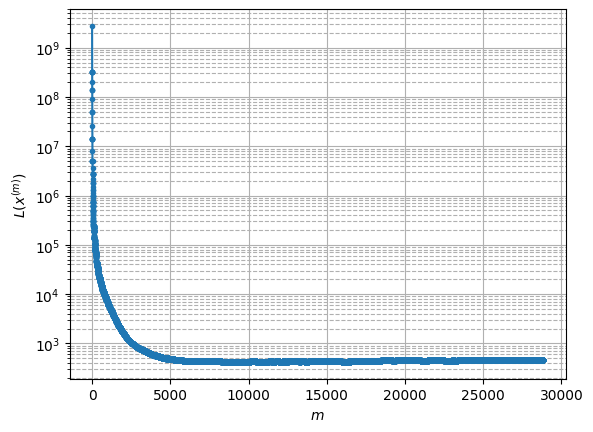

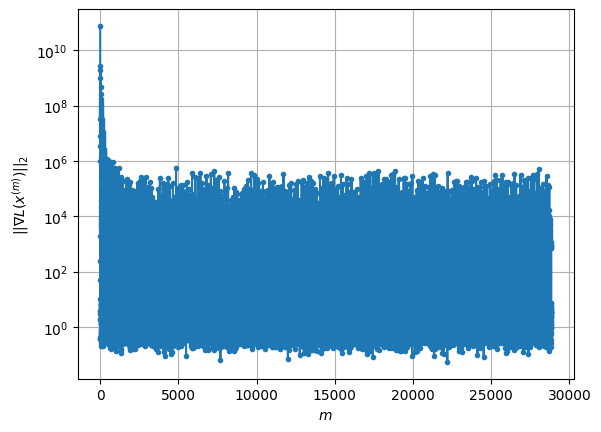

Windows:  88%|████████▊ | 259/296 [17:21:15<2:24:21, 234.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.16773480870506
Gradient norm: 240184.00925312168
Global relative error: 2.3241461434055024
Position relative errors: 0.042552249928091423 m, 1.0221782528132237 m, 1.6435967946317342 m, 1.2859153823122516 m

Iteration 1
Cost function: 451.82879911985344 (-0.07%)
Gradient norm: 3.8898228520116933 (-100.00%)
Global relative error = 2.3218642181739044 (-0.10%)
Position relative errors: 0.02855562945986524 m, 1.0244596935201018 m, 1.6416465957967223 m, 1.2828520541269162 m

Iteration 2
Cost function: 451.8288001664679 (0.00%)
Gradient norm: 2.178305705693228 (-44.00%)
Global relative error = 2.3218642183331384 (0.00%)
Position relative errors: 0.028555626482283 m, 1.0244596936837203 m, 1.6416465964855687 m, 1.2828520534692294 m

Iteration 3
Cost function: 451.82879972870944 (-0.00%)
Gradient norm: 2.5529270114908957 (17.20%)
Global relative error = 2.3218642190288463 (0.00%)
Position relative errors: 0.0

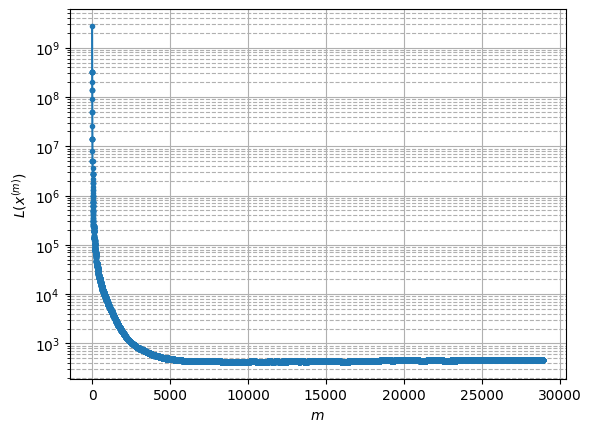

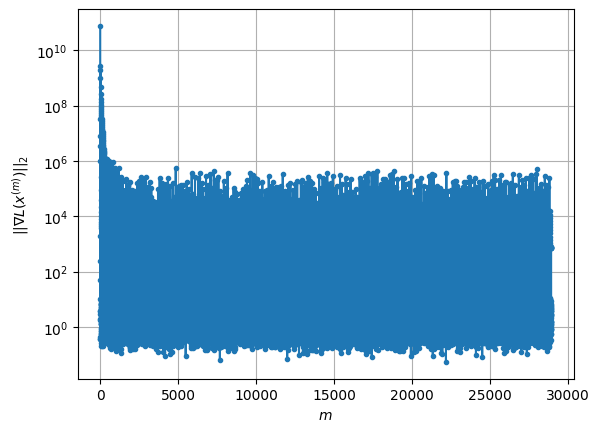

Windows:  88%|████████▊ | 260/296 [17:25:22<2:22:40, 237.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 456.1646225140817
Gradient norm: 106463.85944160109
Global relative error: 2.3800987340549002
Position relative errors: 0.02763999681893931 m, 1.1470907104516024 m, 1.6007799267555827 m, 1.3363329835419377 m

Iteration 1
Cost function: 455.7102784708 (-0.10%)
Gradient norm: 2.316736005988497 (-100.00%)
Global relative error = 2.3808654662801962 (0.03%)
Position relative errors: 0.024298609281177413 m, 1.1475502453338415 m, 1.5992106334707992 m, 1.3392449496568548 m

STOP on Iteration 2
Cost function = 455.7102783220328 (-0.00%)
Gradient norm = 0.6358559395964121 (-72.55%)
Global relative error = 2.380865465560572 (-0.00%)
Final position relative errors: 0.024298617060970393 m, 1.1475502459837688 m, 1.5992106319105241 m, 1.339244949542625 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 455.5507672550596
Gradient norm: 19623.69030480683
Global relative error: 2.38086

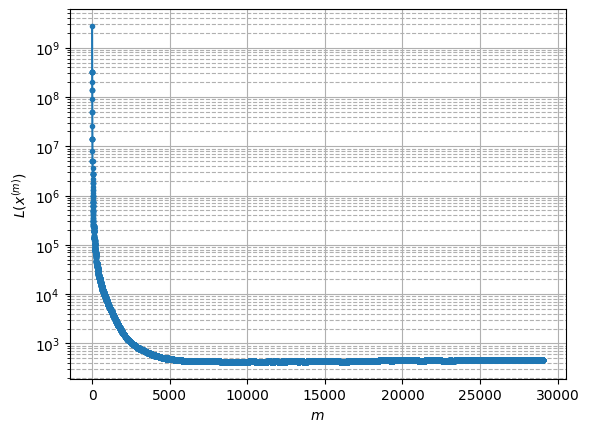

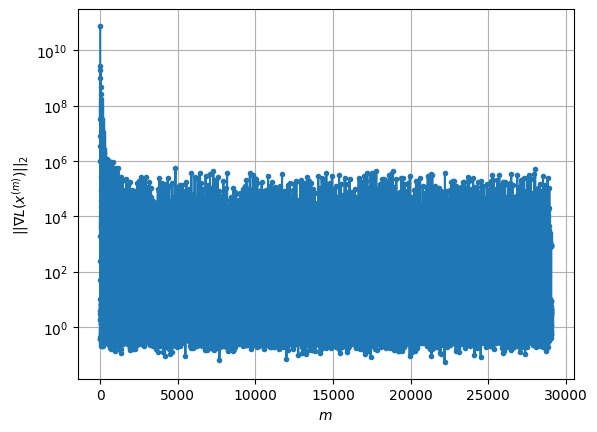

Windows:  88%|████████▊ | 261/296 [17:29:43<2:22:48, 244.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.2391130307307
Gradient norm: 81820.48976869011
Global relative error: 2.4499993269553535
Position relative errors: 0.023105351919757246 m, 1.2557967565378694 m, 1.5752314015095417 m, 1.3941225010431655 m

Iteration 1
Cost function: 457.1264224126859 (-0.02%)
Gradient norm: 2.332864451771457 (-100.00%)
Global relative error = 2.449998749857454 (-0.00%)
Position relative errors: 0.02342522234025683 m, 1.2522971632933448 m, 1.5761229255369917 m, 1.3962548653493303 m

Iteration 2
Cost function: 457.12642062631375 (-0.00%)
Gradient norm: 3.262247976020341 (39.84%)
Global relative error = 2.4499987491084485 (-0.00%)
Position relative errors: 0.02342522130237137 m, 1.2522971640666538 m, 1.5761229259365046 m, 1.3962548629079137 m

Iteration 3
Cost function: 457.1264218366811 (0.00%)
Gradient norm: 1.1924196060025807 (-63.45%)
Global relative error = 2.449998748883182 (-0.00%)
Position relative errors: 0.023

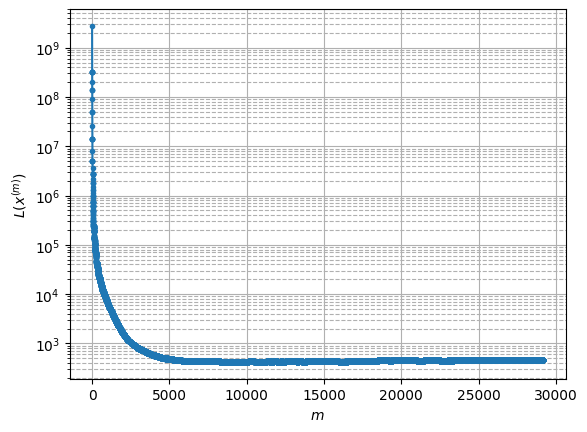

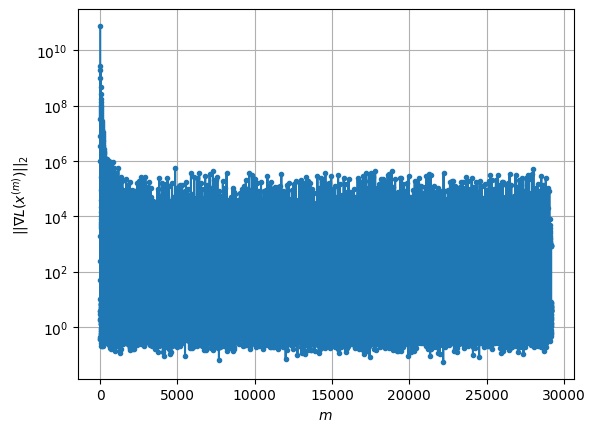

Windows:  89%|████████▊ | 262/296 [17:34:05<2:21:37, 249.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 452.4812256503555
Gradient norm: 65492.304109440396
Global relative error: 2.510058923092628
Position relative errors: 0.022445470148910743 m, 1.3345130416181505 m, 1.557684858118391 m, 1.4465752122236493 m

Iteration 1
Cost function: 452.32826785060087 (-0.03%)
Gradient norm: 6.060629560727495 (-99.99%)
Global relative error = 2.5096700218896584 (-0.02%)
Position relative errors: 0.02563043381409203 m, 1.3320886221944763 m, 1.5572363191108316 m, 1.448563661072933 m

Iteration 2
Cost function: 452.3282675398343 (-0.00%)
Gradient norm: 5.198330267937271 (-14.23%)
Global relative error = 2.5096700201041755 (-0.00%)
Position relative errors: 0.025630434667623103 m, 1.332088621852992 m, 1.5572363191250256 m, 1.4485636582632109 m

Iteration 3
Cost function: 452.3282682408662 (0.00%)
Gradient norm: 1.455960648349607 (-71.99%)
Global relative error = 2.5096700204889273 (0.00%)
Position relative errors: 0.02563

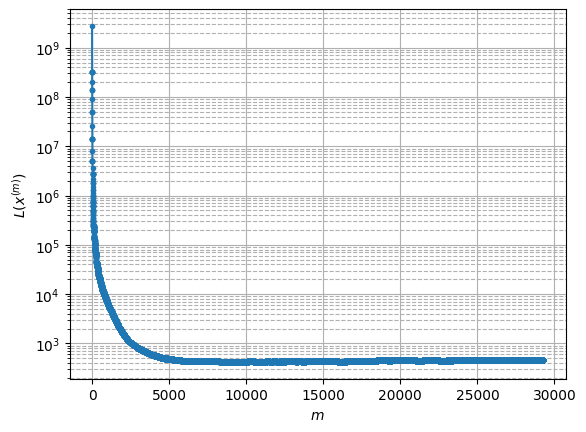

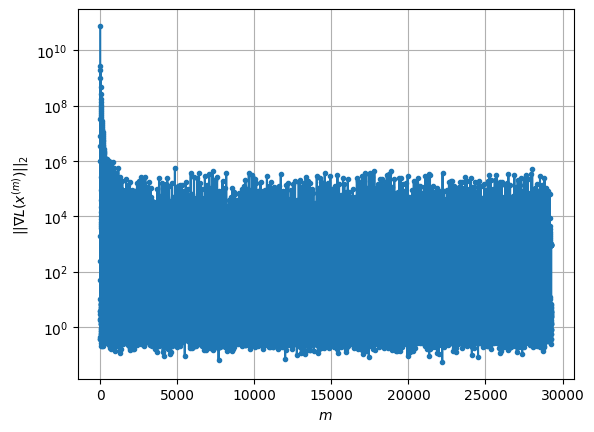

Windows:  89%|████████▉ | 263/296 [17:37:21<2:08:37, 233.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.2211905383209
Gradient norm: 346382.20554437017
Global relative error: 2.5691393855177886
Position relative errors: 0.024655299224160758 m, 1.3843680900786244 m, 1.5504381457604164 m, 1.5098117860196454 m

Iteration 1
Cost function: 454.52169788129424 (-0.15%)
Gradient norm: 3.9631629503634076 (-100.00%)
Global relative error = 2.564634564803423 (-0.18%)
Position relative errors: 0.016245356126963668 m, 1.3805049789422663 m, 1.551138060052092 m, 1.5050777638331314 m

Iteration 2
Cost function: 454.52169848963194 (0.00%)
Gradient norm: 2.6759104334992045 (-32.48%)
Global relative error = 2.5646345655965517 (0.00%)
Position relative errors: 0.016245355795873054 m, 1.3805049797677864 m, 1.5511380599063014 m, 1.5050777645812443 m

Iteration 3
Cost function: 454.5216985783605 (0.00%)
Gradient norm: 3.969922565557995 (48.36%)
Global relative error = 2.5646345662399406 (0.00%)
Position relative errors: 0.0

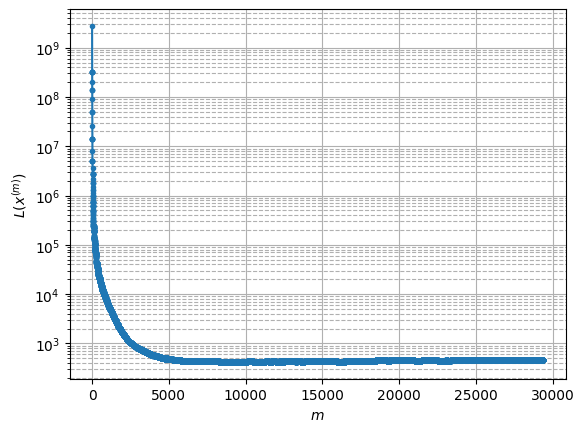

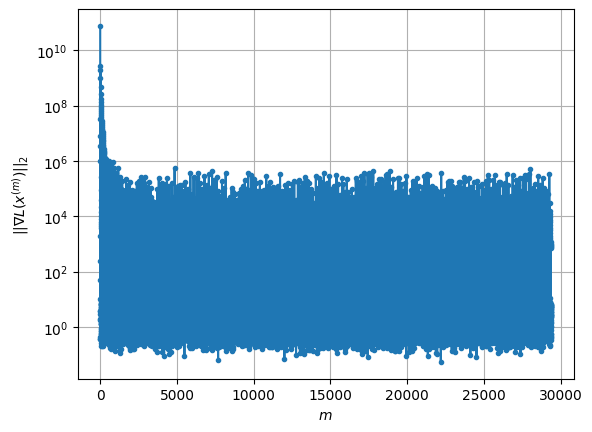

Windows:  89%|████████▉ | 264/296 [17:41:45<2:09:26, 242.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.68088877448054
Gradient norm: 162225.47658463774
Global relative error: 2.6025154889637467
Position relative errors: 0.015886313598072577 m, 1.4032923753391782 m, 1.53563225015414 m, 1.563788683894459 m

STOP on Iteration 1
Cost function = 455.45561662860746 (-0.05%)
Gradient norm = 0.552226869713921 (-100.00%)
Global relative error = 2.6019389477935424 (-0.02%)
Final position relative errors: 0.016100895486841564 m, 1.4001989932064776 m, 1.539012793880097 m, 1.5622758710483482 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 455.41458704867
Gradient norm: 11682.61477137032
Global relative error: 2.6019389477935424
Position relative errors: 0.016100895486841564 m, 1.4001989932064776 m, 1.539012793880097 m, 1.5622758710483482 m

Iteration 1
Cost function: 455.39524667755643 (-0.00%)
Gradient norm: 2.2638997365057243 (-99.98%)
Global relative error = 2.60088860741

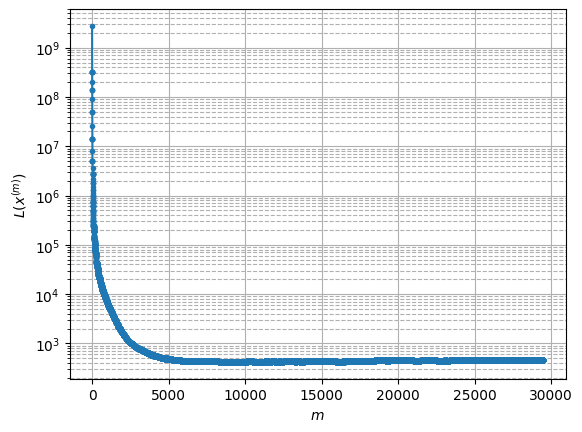

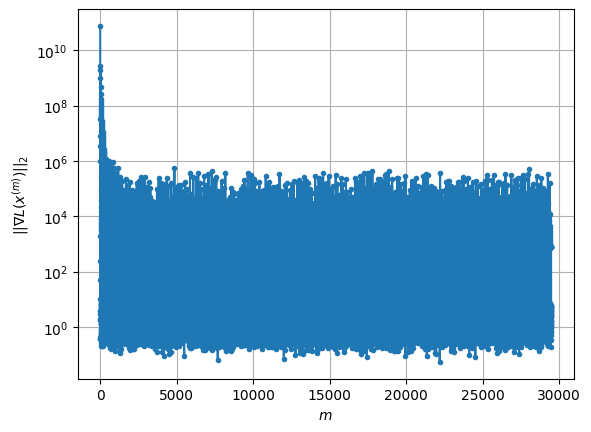

Windows:  90%|████████▉ | 265/296 [17:45:16<2:00:34, 233.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 455.63743187671065
Gradient norm: 178847.68864773164
Global relative error: 2.626883763267559
Position relative errors: 0.015459793354578122 m, 1.4182038988489905 m, 1.5160550165882418 m, 1.609518938148043 m

STOP on Iteration 1
Cost function = 455.13359050061365 (-0.11%)
Gradient norm = 0.9131798490038714 (-100.00%)
Global relative error = 2.620080729968834 (-0.26%)
Final position relative errors: 0.015798048906281788 m, 1.4142550551615989 m, 1.505084047241628 m, 1.6121957567727083 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 454.91238838042875
Gradient norm: 21270.27235005199
Global relative error: 2.620080729968834
Position relative errors: 0.015798048906281788 m, 1.4142550551615989 m, 1.505084047241628 m, 1.6121957567727083 m

Iteration 1
Cost function: 454.79200795016783 (-0.03%)
Gradient norm: 1.663443739954876 (-99.99%)
Global relative error = 2.617112815

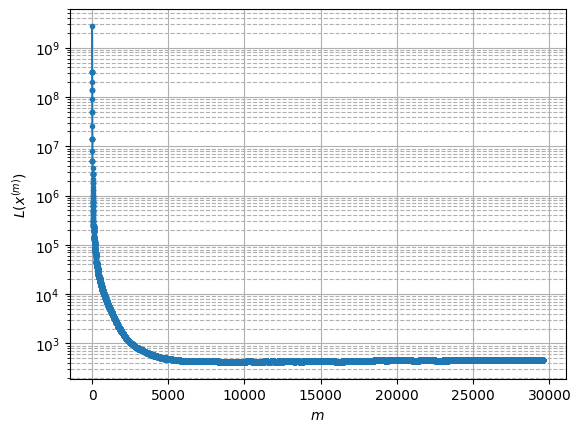

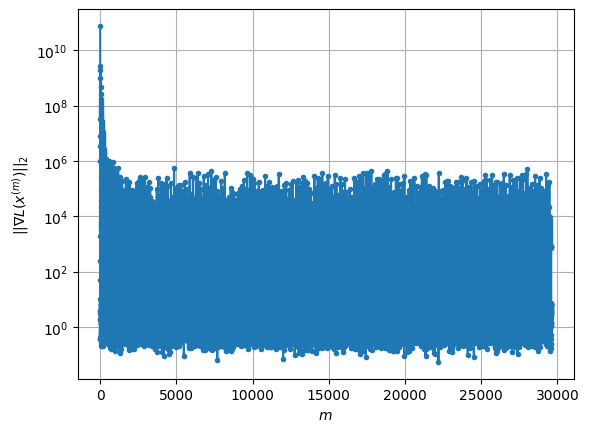

Windows:  90%|████████▉ | 266/296 [17:49:40<2:01:15, 242.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.04863124852164
Gradient norm: 28180.075398523786
Global relative error: 2.655543003034464
Position relative errors: 0.015273825298454736 m, 1.4294465470135065 m, 1.486848875449564 m, 1.6726134383340114 m

Iteration 1
Cost function: 453.8592824807694 (-0.04%)
Gradient norm: 3.500364441332616 (-99.99%)
Global relative error = 2.65633448415951 (0.03%)
Position relative errors: 0.02237060193109785 m, 1.4255144569772387 m, 1.4889264958955286 m, 1.6752958642909166 m

Iteration 2
Cost function: 453.8592826679698 (0.00%)
Gradient norm: 3.7941311098014423 (8.39%)
Global relative error = 2.6563344853637947 (0.00%)
Position relative errors: 0.022370604334559892 m, 1.4255144569656202 m, 1.488926496369484 m, 1.6752958657569799 m

STOP on Iteration 3
Cost function = 453.8592821801738 (-0.00%)
Gradient norm = 0.8352948581486361 (-77.98%)
Global relative error = 2.6563344841939482 (-0.00%)
Final position relative e

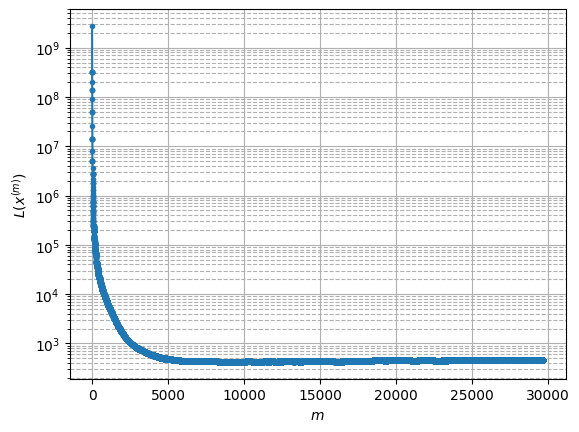

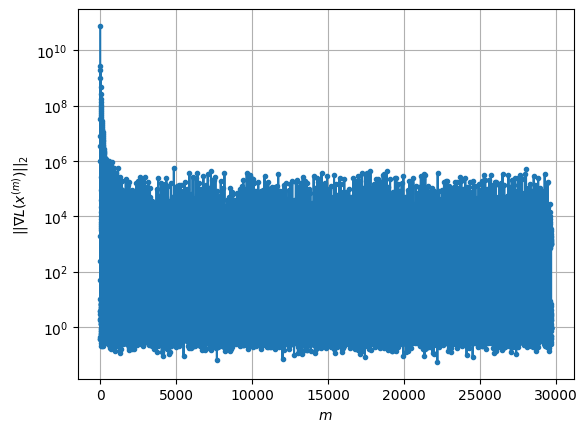

Windows:  90%|█████████ | 267/296 [17:53:16<1:53:18, 234.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.1183160916815
Gradient norm: 155503.75564694466
Global relative error: 2.683710123592364
Position relative errors: 0.021149054997319495 m, 1.444871881298494 m, 1.4832338173935384 m, 1.7071066289767152 m

Iteration 1
Cost function: 452.7698977307301 (-0.08%)
Gradient norm: 5.2189517032458745 (-100.00%)
Global relative error = 2.6818826555028106 (-0.07%)
Position relative errors: 0.012883219268844696 m, 1.442096344701599 m, 1.4844978627430079 m, 1.7055645554748189 m

Iteration 2
Cost function: 452.76989784041456 (0.00%)
Gradient norm: 2.757809642819038 (-47.16%)
Global relative error = 2.681882656311587 (0.00%)
Position relative errors: 0.012883218154629533 m, 1.4420963452269708 m, 1.4844978627656382 m, 1.7055645562910677 m

Iteration 3
Cost function: 452.7698992991815 (0.00%)
Gradient norm: 7.724147637890934 (180.08%)
Global relative error = 2.681882655411709 (-0.00%)
Position relative errors: 0.0128

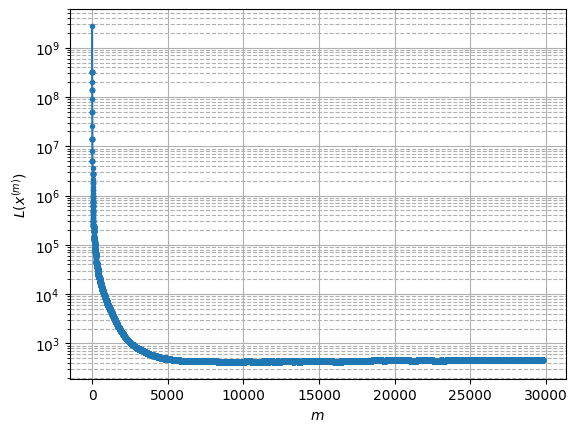

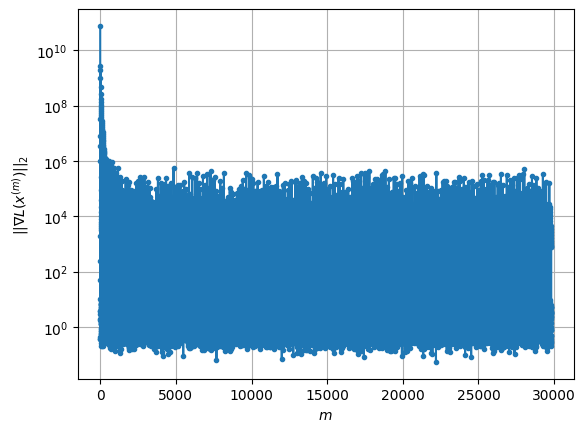

Windows:  91%|█████████ | 268/296 [17:57:46<1:54:26, 245.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 453.2779166230966
Gradient norm: 133739.31778667297
Global relative error: 2.690030521854425
Position relative errors: 0.01287391256743726 m, 1.4731255031489585 m, 1.4725425172269222 m, 1.7022385736955128 m

STOP on Iteration 1
Cost function = 452.8542697743303 (-0.09%)
Gradient norm = 0.24912236777997188 (-100.00%)
Global relative error = 2.688862185102948 (-0.04%)
Final position relative errors: 0.013149302216941914 m, 1.4664785253965995 m, 1.4768076358509856 m, 1.7024349615615753 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 452.74551109380786
Gradient norm: 27192.640216970307
Global relative error: 2.688862185102948
Position relative errors: 0.013149302216941914 m, 1.4664785253965995 m, 1.4768076358509856 m, 1.7024349615615753 m

Iteration 1
Cost function: 452.69243053985156 (-0.01%)
Gradient norm: 2.0483714318232717 (-99.99%)
Global relative error = 2.687931

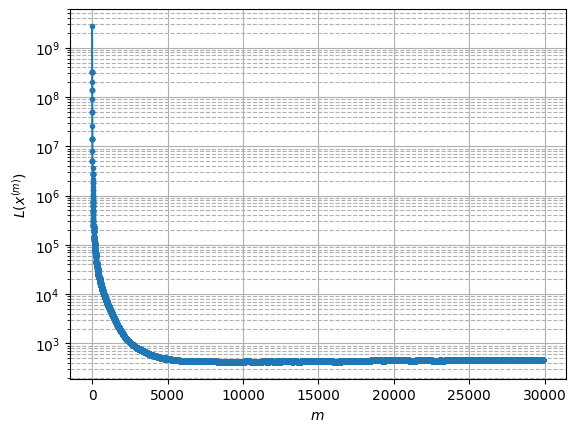

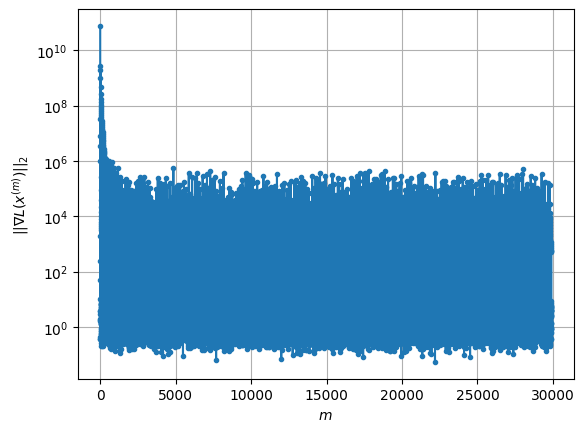

Windows:  91%|█████████ | 269/296 [18:01:01<1:43:31, 230.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.32442989776655
Gradient norm: 444326.59288772295
Global relative error: 2.692785797581681
Position relative errors: 0.011859221323313485 m, 1.4749592832992837 m, 1.4520779093263398 m, 1.7224742873247394 m

Iteration 1
Cost function: 457.09255584308664 (-0.05%)
Gradient norm: 1.6283893799946036 (-100.00%)
Global relative error = 2.694596598914136 (0.07%)
Position relative errors: 0.017452926953586533 m, 1.4738081196312136 m, 1.4563993940615223 m, 1.7225953528337319 m

Iteration 2
Cost function: 457.09255615190943 (0.00%)
Gradient norm: 1.7705319640024186 (8.73%)
Global relative error = 2.6945965984798534 (-0.00%)
Position relative errors: 0.01745291934711252 m, 1.473808119202689 m, 1.4563993929647485 m, 1.7225953535253868 m

Iteration 3
Cost function: 457.09255634585514 (0.00%)
Gradient norm: 3.1428995834668663 (77.51%)
Global relative error = 2.6945965979197095 (-0.00%)
Position relative errors: 0.0

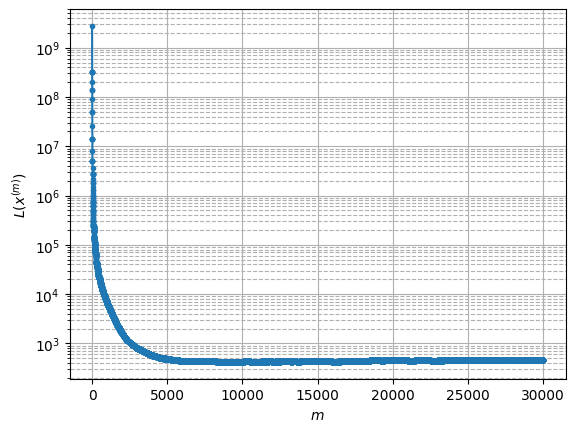

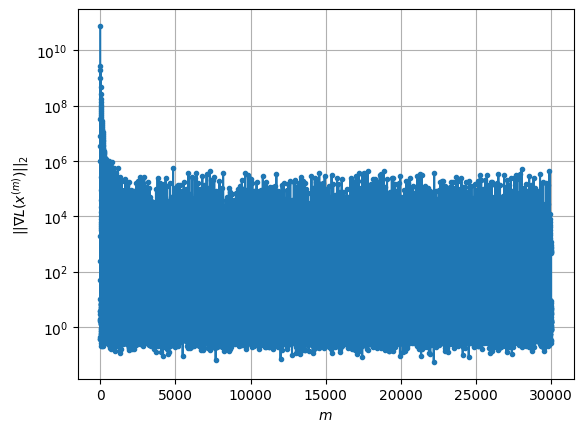

Windows:  91%|█████████ | 270/296 [18:05:02<1:41:06, 233.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 454.24156011577827
Gradient norm: 94420.9739208635
Global relative error: 2.692440671411323
Position relative errors: 0.015745809689173003 m, 1.5040887343576206 m, 1.4175864073947797 m, 1.7254428192569453 m

Iteration 1
Cost function: 454.0611479185412 (-0.04%)
Gradient norm: 1.867674631590817 (-100.00%)
Global relative error = 2.69693564138764 (0.17%)
Position relative errors: 0.011877461085232906 m, 1.5021220118774652 m, 1.4282318508111673 m, 1.725428129053192 m

Iteration 2
Cost function: 454.06114700229256 (-0.00%)
Gradient norm: 1.033550128326934 (-44.66%)
Global relative error = 2.6969356402551523 (-0.00%)
Position relative errors: 0.011877466031768282 m, 1.50212201189106 m, 1.4282318487570331 m, 1.7254281289374884 m

Iteration 3
Cost function: 454.06114739092783 (0.00%)
Gradient norm: 4.103089734703308 (296.99%)
Global relative error = 2.6969356397692104 (-0.00%)
Position relative errors: 0.01187

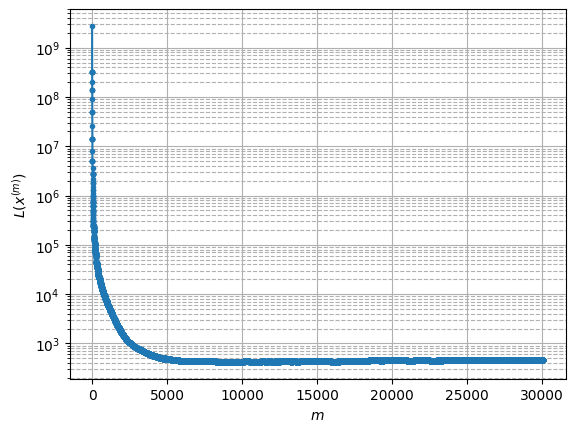

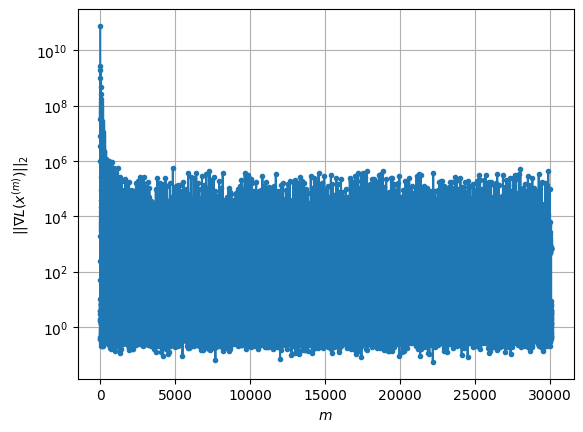

Windows:  92%|█████████▏| 271/296 [18:08:20<1:32:53, 222.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 461.5159619340872
Gradient norm: 114999.79020876874
Global relative error: 2.6872809595485934
Position relative errors: 0.010198044993834718 m, 1.535203380540031 m, 1.3792722138510145 m, 1.7210845413361786 m

Iteration 1
Cost function: 461.31594709368585 (-0.04%)
Gradient norm: 1.6622334764762368 (-100.00%)
Global relative error = 2.682671579130764 (-0.17%)
Position relative errors: 0.009853177743769679 m, 1.534870093350303 m, 1.3740004507140224 m, 1.7184075783010366 m

STOP on Iteration 2
Cost function = 461.3159466908478 (-0.00%)
Gradient norm = 0.417215190765576 (-74.90%)
Global relative error = 2.6826715790609996 (-0.00%)
Final position relative errors: 0.00985317779586544 m, 1.5348700933229429 m, 1.3740004491203073 m, 1.7184075794905656 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 461.23066145192615
Gradient norm: 32220.07352855518
Global relative error: 2.

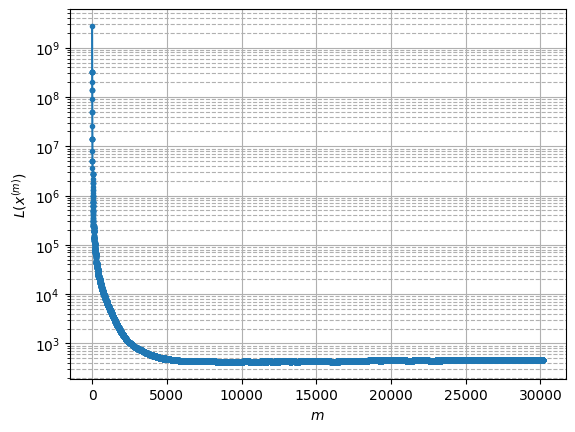

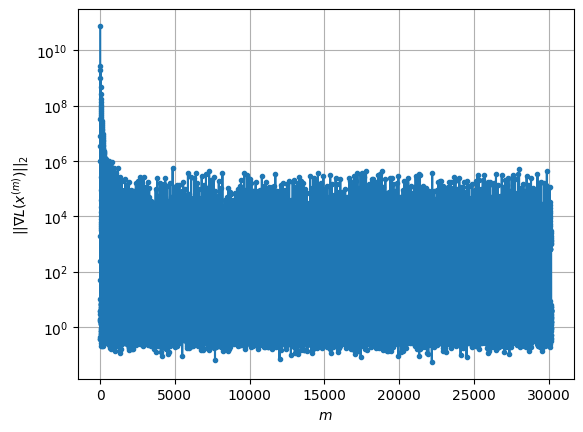

Windows:  92%|█████████▏| 272/296 [18:11:45<1:26:55, 217.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 461.10380311551535
Gradient norm: 156417.09334161872
Global relative error: 2.66736899953402
Position relative errors: 0.00792483009238005 m, 1.5640557017808996 m, 1.3332784963097273 m, 1.7002620846177476 m

Iteration 1
Cost function: 460.9329340680832 (-0.04%)
Gradient norm: 2.503806411125594 (-100.00%)
Global relative error = 2.6691576182799492 (0.07%)
Position relative errors: 0.008085352081516296 m, 1.5700276608711252 m, 1.3319660111227536 m, 1.698592083552928 m

Iteration 2
Cost function: 460.93293409664204 (0.00%)
Gradient norm: 2.2429169958897965 (-10.42%)
Global relative error = 2.6691576175725857 (-0.00%)
Position relative errors: 0.008085351676006072 m, 1.5700276619119542 m, 1.3319660088634202 m, 1.6985920832529406 m

Iteration 3
Cost function: 460.9329341532476 (0.00%)
Gradient norm: 3.7595805092580052 (67.62%)
Global relative error = 2.6691576182376404 (0.00%)
Position relative errors: 0.008

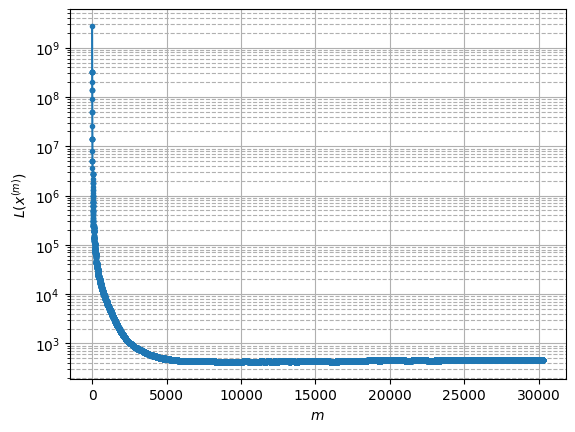

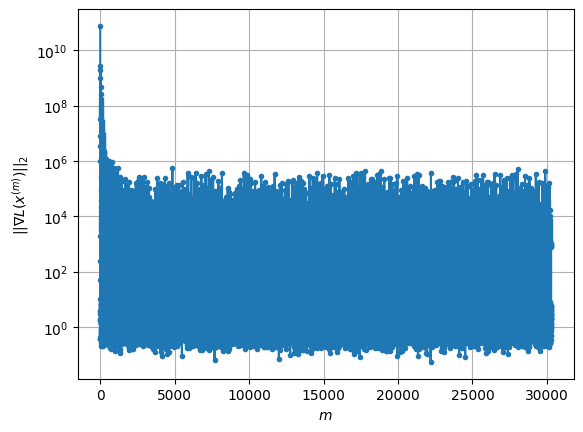

Windows:  92%|█████████▏| 273/296 [18:15:51<1:26:41, 226.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.06273433465964
Gradient norm: 349641.6181263297
Global relative error: 2.655876319011884
Position relative errors: 0.007257925960714198 m, 1.5978316920612663 m, 1.3019852152778302 m, 1.674930749102882 m

Iteration 1
Cost function: 457.56123437595 (-0.11%)
Gradient norm: 1.3963231488650865 (-100.00%)
Global relative error = 2.658831462833059 (0.11%)
Position relative errors: 0.017308211045672813 m, 1.5910283742497453 m, 1.3172962825462722 m, 1.6740497802929244 m

Iteration 2
Cost function: 457.5612346966154 (0.00%)
Gradient norm: 4.834932598026929 (246.26%)
Global relative error = 2.6588314630866487 (0.00%)
Position relative errors: 0.017308203422730106 m, 1.5910283757986583 m, 1.3172962803253878 m, 1.6740497810500083 m

Iteration 3
Cost function: 457.56123566589787 (0.00%)
Gradient norm: 1.3214698614461695 (-72.67%)
Global relative error = 2.658831464261653 (0.00%)
Position relative errors: 0.017308

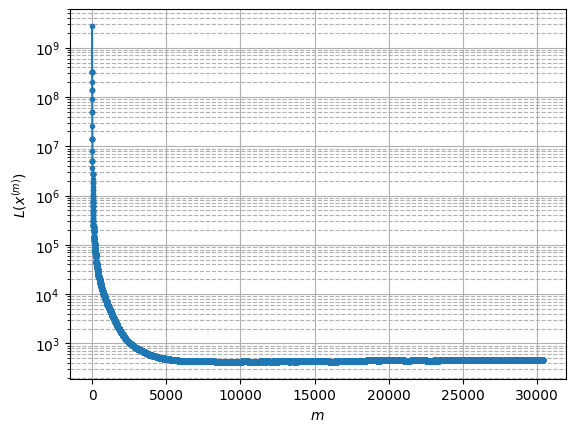

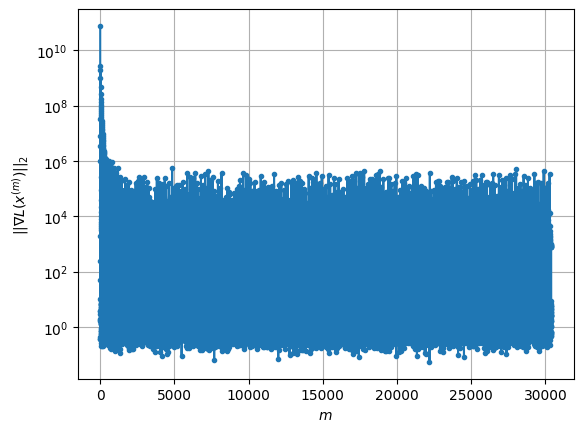

Windows:  93%|█████████▎| 274/296 [18:19:44<1:23:40, 228.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.9932918253242
Gradient norm: 97317.24095924085
Global relative error: 2.6143223586425828
Position relative errors: 0.017229661894153994 m, 1.5970368022450623 m, 1.2513926866012195 m, 1.6485971543764568 m

Iteration 1
Cost function: 457.8183503210687 (-0.04%)
Gradient norm: 3.576764910098287 (-100.00%)
Global relative error = 2.6044866327186558 (-0.38%)
Position relative errors: 0.013869368607705658 m, 1.5955274050828392 m, 1.2329734305314424 m, 1.6484008545429902 m

Iteration 2
Cost function: 457.81835142584436 (0.00%)
Gradient norm: 2.6259020653432463 (-26.58%)
Global relative error = 2.604486633825809 (0.00%)
Position relative errors: 0.013869362579209421 m, 1.5955274059478182 m, 1.232973430766619 m, 1.6484008553298792 m

Iteration 3
Cost function: 457.8183508605518 (-0.00%)
Gradient norm: 3.5895046177548733 (36.70%)
Global relative error = 2.6044866315023603 (-0.00%)
Position relative errors: 0.0

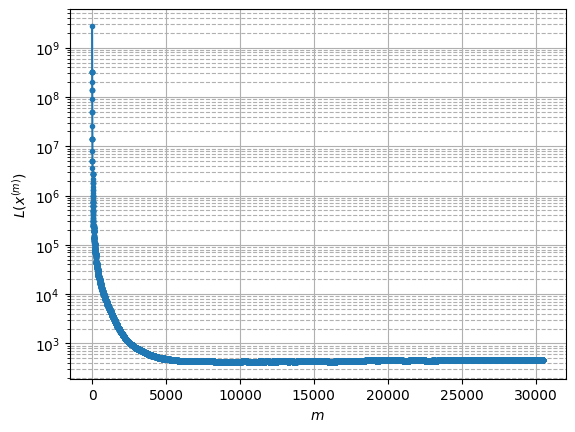

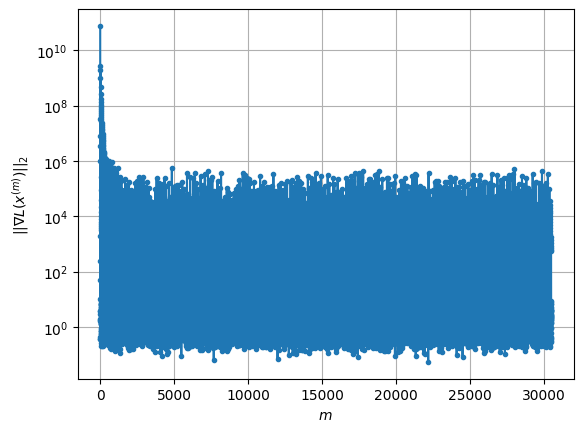

Windows:  93%|█████████▎| 275/296 [18:24:09<1:23:43, 239.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 458.4723507399144
Gradient norm: 172027.59437559746
Global relative error: 2.5275844652200097
Position relative errors: 0.012232307368714312 m, 1.5963987945646405 m, 1.1284273758493202 m, 1.602090669632583 m

Iteration 1
Cost function: 458.263921847314 (-0.05%)
Gradient norm: 6.515961118631616 (-100.00%)
Global relative error = 2.5253685094971705 (-0.09%)
Position relative errors: 0.008886187366187612 m, 1.593464324228603 m, 1.1314710289699235 m, 1.599390596557279 m

Iteration 2
Cost function: 458.2639212011002 (-0.00%)
Gradient norm: 3.341799287630795 (-48.71%)
Global relative error = 2.525368509528393 (0.00%)
Position relative errors: 0.00888618858953144 m, 1.5934643241497801 m, 1.1314710293024257 m, 1.5993905964430846 m

Iteration 3
Cost function: 458.2639217935519 (0.00%)
Gradient norm: 1.5869181937227546 (-52.51%)
Global relative error = 2.5253685090239473 (-0.00%)
Position relative errors: 0.00888

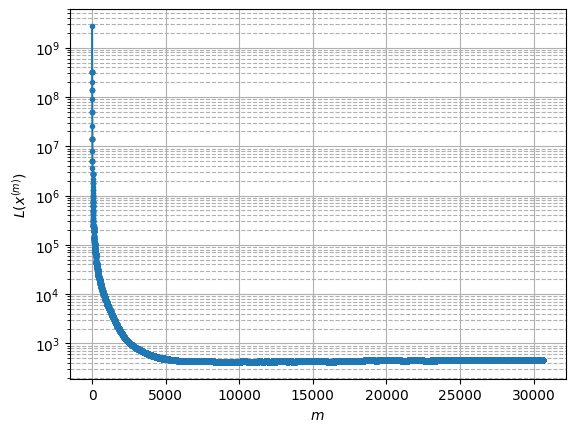

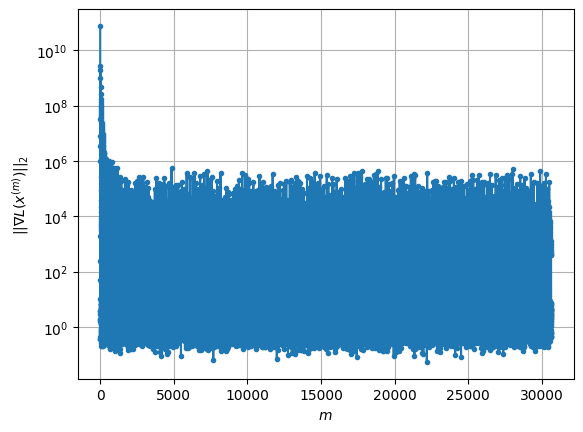

Windows:  93%|█████████▎| 276/296 [18:28:57<1:24:34, 253.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.8594090723232
Gradient norm: 122871.64317572236
Global relative error: 2.4651216878699906
Position relative errors: 0.008007275130260344 m, 1.614754658279462 m, 1.04648867113918 m, 1.540840015451431 m

STOP on Iteration 1
Cost function = 462.17690351406634 (-0.15%)
Gradient norm = 0.6129228979460997 (-100.00%)
Global relative error = 2.459531525725579 (-0.23%)
Final position relative errors: 0.009536173722605188 m, 1.6204381453656258 m, 1.026504540905635 m, 1.539373682920828 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 461.9317369888216
Gradient norm: 27136.72138036687
Global relative error: 2.459531525725579
Position relative errors: 0.009536173722605188 m, 1.6204381453656258 m, 1.026504540905635 m, 1.539373682920828 m

STOP on Iteration 1
Cost function = 461.8162975729263 (-0.02%)
Gradient norm = 0.36781598549417177 (-100.00%)
Global relative error = 2.458

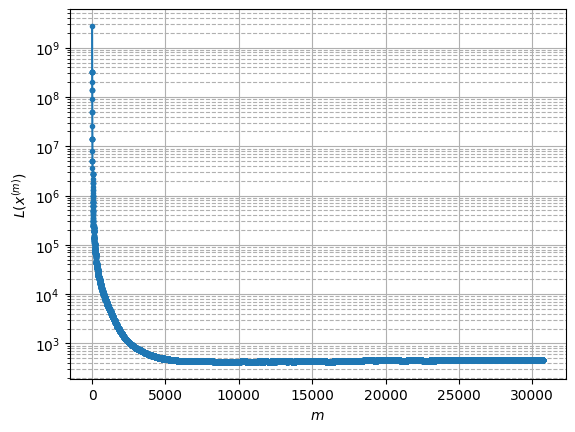

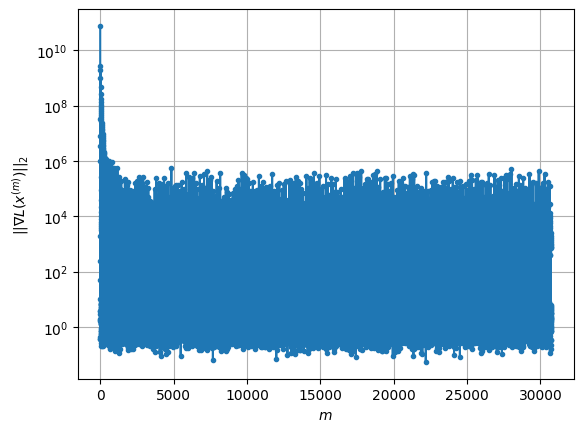

Windows:  94%|█████████▎| 277/296 [18:32:31<1:16:34, 241.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.33026970721045
Gradient norm: 23039.73229660887
Global relative error: 2.410884241909362
Position relative errors: 0.010890261571560093 m, 1.6382024366228882 m, 0.9769430328566512 m, 1.4744888428435572 m

Iteration 1
Cost function: 457.20137778993893 (-0.03%)
Gradient norm: 1.1657661778384807 (-99.99%)
Global relative error = 2.4075999709829006 (-0.14%)
Position relative errors: 0.011864187936445484 m, 1.636822908083037 m, 0.9757027162121138 m, 1.4714652152942864 m

Iteration 2
Cost function: 457.20137678977545 (-0.00%)
Gradient norm: 2.7460530693782172 (135.56%)
Global relative error = 2.407599970843645 (-0.00%)
Position relative errors: 0.011864191619867626 m, 1.6368229075243361 m, 0.9757027168286738 m, 1.471465215249394 m

Iteration 3
Cost function: 457.20137781826406 (0.00%)
Gradient norm: 1.4045269271450673 (-48.85%)
Global relative error = 2.4075999716679064 (0.00%)
Position relative errors: 0

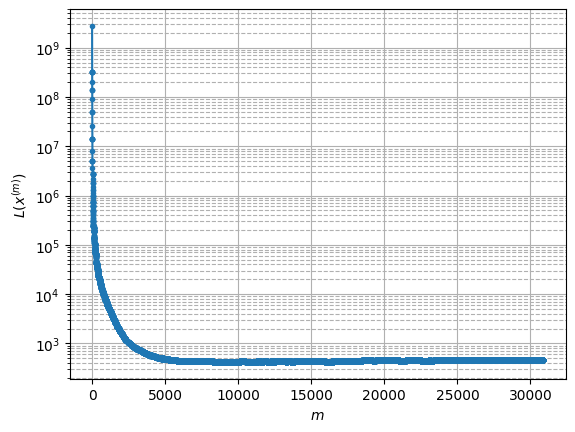

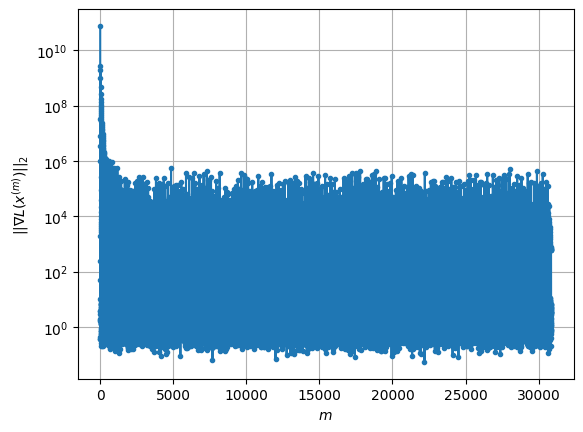

Windows:  94%|█████████▍| 278/296 [18:37:19<1:16:42, 255.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 457.77888823474825
Gradient norm: 149278.7515912959
Global relative error: 2.3401440626726036
Position relative errors: 0.013209260920985356 m, 1.6381443530991575 m, 0.9164674122370337 m, 1.397379022044104 m

Iteration 1
Cost function: 457.62791810593967 (-0.03%)
Gradient norm: 3.992618099605914 (-100.00%)
Global relative error = 2.3403499371936958 (0.01%)
Position relative errors: 0.020164477813069744 m, 1.6361499527322065 m, 0.9223652573205018 m, 1.3960962386086762 m

Iteration 2
Cost function: 457.6279177042043 (-0.00%)
Gradient norm: 1.112772477470756 (-72.13%)
Global relative error = 2.340349937670888 (0.00%)
Position relative errors: 0.020164475789560526 m, 1.636149953923128 m, 0.9223652569424691 m, 1.396096238291905 m

Iteration 3
Cost function: 457.6279183882131 (0.00%)
Gradient norm: 3.2490422480490375 (191.98%)
Global relative error = 2.3403499380994037 (0.00%)
Position relative errors: 0.0201

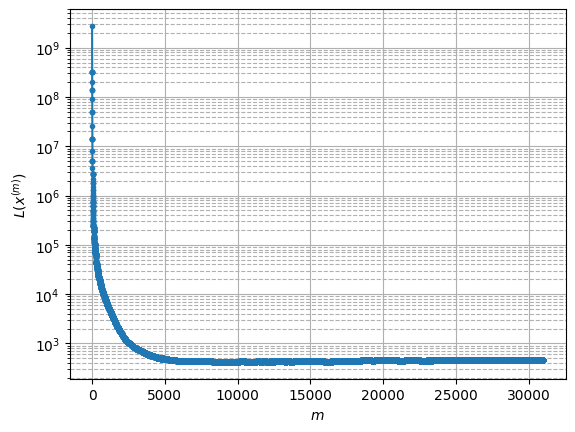

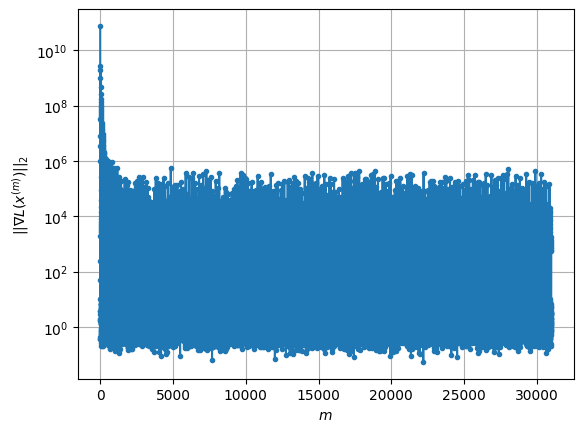

Windows:  94%|█████████▍| 279/296 [18:41:35<1:12:26, 255.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.7307027562762
Gradient norm: 212059.5198149698
Global relative error: 2.27464410365026
Position relative errors: 0.019517271027072337 m, 1.6235565541558141 m, 0.8727325124241158 m, 1.3326756720764759 m

Iteration 1
Cost function: 459.60459707984023 (-0.03%)
Gradient norm: 1.6327475225757713 (-100.00%)
Global relative error = 2.2758607737277345 (0.05%)
Position relative errors: 0.01920301562102575 m, 1.6229252378138512 m, 0.8797942738901438 m, 1.3308819269189032 m

Iteration 2
Cost function: 459.6045975779108 (0.00%)
Gradient norm: 2.967948321331805 (81.78%)
Global relative error = 2.2758607733643728 (-0.00%)
Position relative errors: 0.019203008896833674 m, 1.6229252379416297 m, 0.8797942720506987 m, 1.330881927454733 m

STOP on Iteration 3
Cost function = 459.60459613856807 (-0.00%)
Gradient norm = 0.36833029208370155 (-87.59%)
Global relative error = 2.2758607740116585 (0.00%)
Final position relat

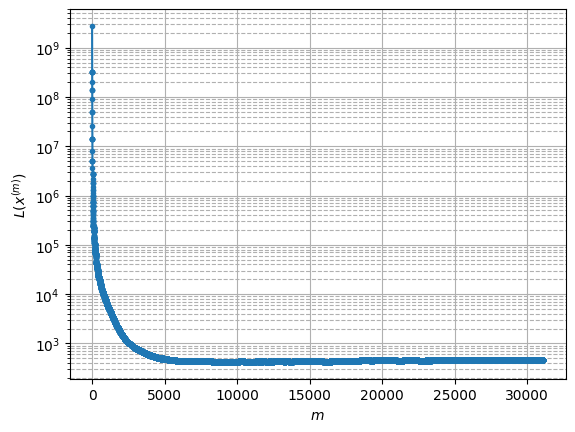

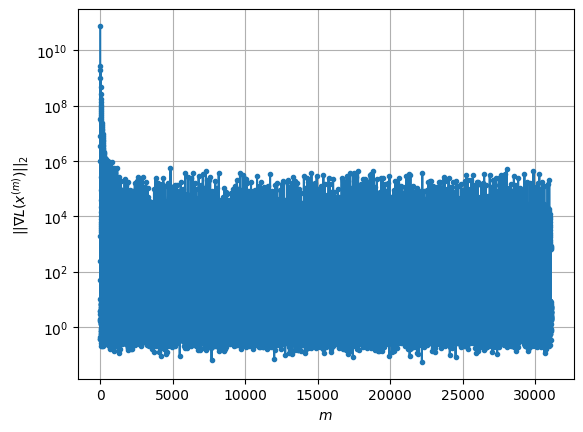

Windows:  95%|█████████▍| 280/296 [18:46:25<1:10:58, 266.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 459.851085885314
Gradient norm: 87732.34191802645
Global relative error: 2.2042971272782395
Position relative errors: 0.019391077477747407 m, 1.6087479255084502 m, 0.8147343375175844 m, 1.2675507791099019 m

Iteration 1
Cost function: 459.7674457711526 (-0.02%)
Gradient norm: 2.700315186915252 (-100.00%)
Global relative error = 2.206912841647804 (0.12%)
Position relative errors: 0.02120916540637495 m, 1.6079420062876713 m, 0.8240492881373255 m, 1.2670741177704208 m

Iteration 2
Cost function: 459.76744543836975 (-0.00%)
Gradient norm: 1.2224836796031464 (-54.73%)
Global relative error = 2.2069128407452583 (-0.00%)
Position relative errors: 0.021209170018813985 m, 1.6079420063941945 m, 0.8240492856653798 m, 1.2670741175936822 m

Iteration 3
Cost function: 459.76744571870097 (0.00%)
Gradient norm: 4.983900735758145 (307.69%)
Global relative error = 2.2069128420029362 (0.00%)
Position relative errors: 0.02

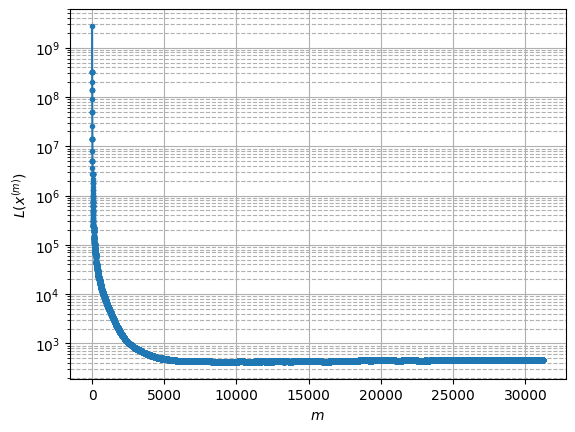

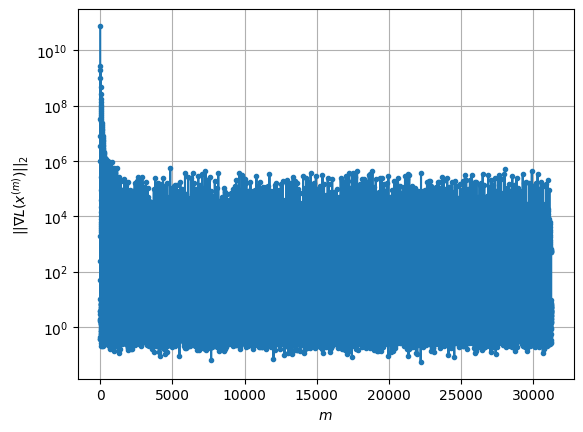

Windows:  95%|█████████▍| 281/296 [18:50:52<1:06:34, 266.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 463.13629473410253
Gradient norm: 375076.2937839866
Global relative error: 2.1358277792953833
Position relative errors: 0.02081617630879395 m, 1.6021681909580758 m, 0.7543603124734725 m, 1.1938681809537908 m

Iteration 1
Cost function: 462.59091769682937 (-0.12%)
Gradient norm: 3.846514195494422 (-100.00%)
Global relative error = 2.12930195516248 (-0.31%)
Position relative errors: 0.014060600226058458 m, 1.6019352051500217 m, 0.7306180251167717 m, 1.1973832581016688 m

Iteration 2
Cost function: 462.5909191582932 (0.00%)
Gradient norm: 2.9510659945395012 (-23.28%)
Global relative error = 2.129301954470042 (-0.00%)
Position relative errors: 0.014060601643358433 m, 1.6019352046336195 m, 0.7306180206926239 m, 1.197383260244063 m

Iteration 3
Cost function: 462.5909177530792 (-0.00%)
Gradient norm: 2.986738966539572 (1.21%)
Global relative error = 2.129301954966491 (0.00%)
Position relative errors: 0.014060

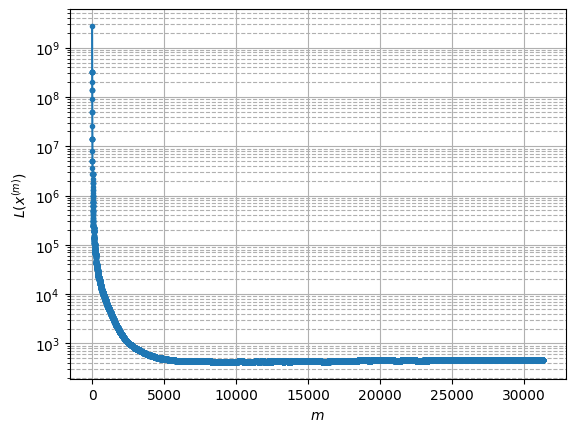

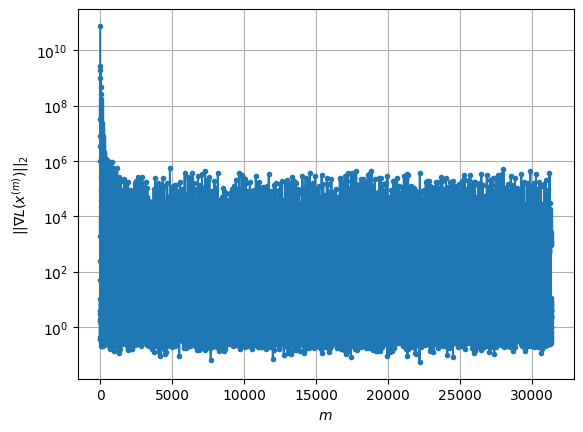

Windows:  95%|█████████▌| 282/296 [18:55:10<1:01:36, 264.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 462.24129668147907
Gradient norm: 44969.7729712397
Global relative error: 2.031547558547958
Position relative errors: 0.015565746112655744 m, 1.5876441065327875 m, 0.6353813587521208 m, 1.0966385904646465 m

Iteration 1
Cost function: 462.1348217783052 (-0.02%)
Gradient norm: 2.213882114775555 (-100.00%)
Global relative error = 2.031497428967596 (-0.00%)
Position relative errors: 0.018201575851337963 m, 1.5875810582299428 m, 0.6406696541194719 m, 1.0935152347848343 m

STOP on Iteration 2
Cost function = 462.1348213154357 (-0.00%)
Gradient norm = 0.8442698745704885 (-61.86%)
Global relative error = 2.031497429800205 (0.00%)
Final position relative errors: 0.01820157859504032 m, 1.5875810586360024 m, 0.6406696562651691 m, 1.0935152344393146 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 462.1237484488171
Gradient norm: 10672.667576021548
Global relative error: 2.031

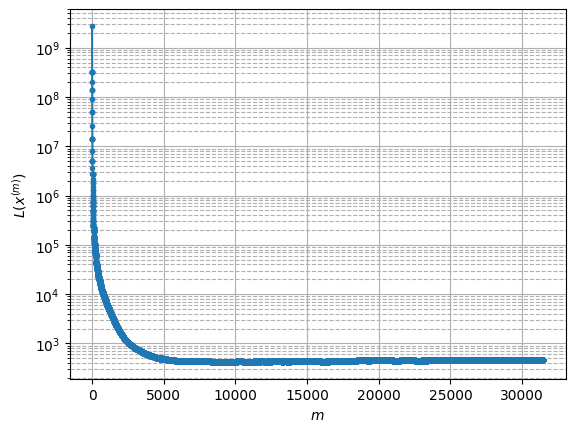

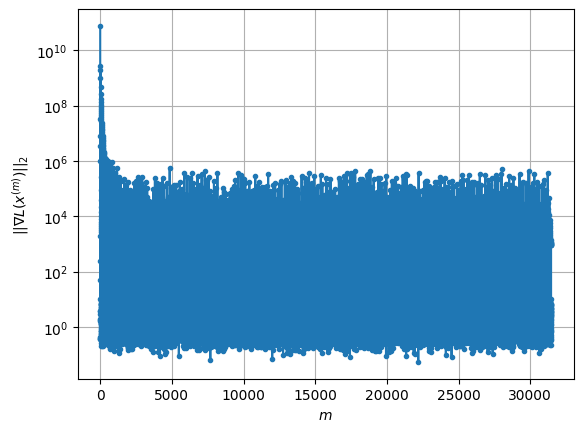

Windows:  96%|█████████▌| 283/296 [18:59:47<58:02, 267.87s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 466.2340812792322
Gradient norm: 30213.25734383276
Global relative error: 1.9403101894726917
Position relative errors: 0.018745654252257285 m, 1.5655225594052273 m, 0.5677981617992658 m, 0.9955865061159779 m

Iteration 1
Cost function: 466.17924003970484 (-0.01%)
Gradient norm: 1.0056256123220044 (-100.00%)
Global relative error = 1.9390850418278933 (-0.06%)
Position relative errors: 0.015501265472833583 m, 1.5657343421757295 m, 0.5622244944313962 m, 0.996085333198521 m

STOP on Iteration 2
Cost function = 466.1792387565123 (-0.00%)
Gradient norm = 0.4038326681069692 (-59.84%)
Global relative error = 1.939085041141051 (-0.00%)
Final position relative errors: 0.015501270033048345 m, 1.5657343428591592 m, 0.5622244929598892 m, 0.9960853315467698 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 466.1533235286819
Gradient norm: 23262.071881465105
Global relative error: 

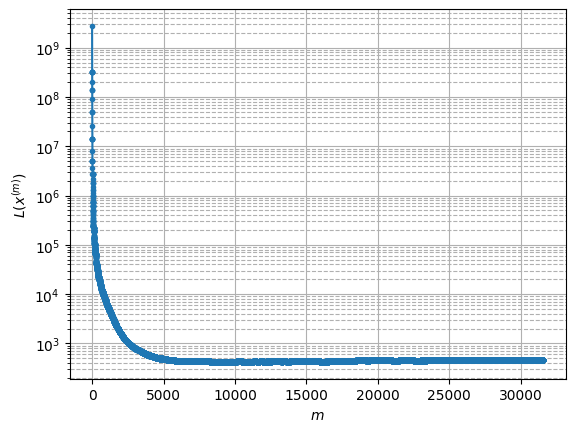

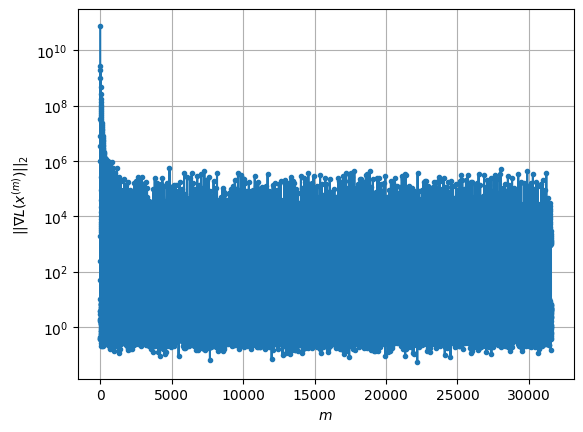

Windows:  96%|█████████▌| 284/296 [19:03:34<51:04, 255.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 466.033212744208
Gradient norm: 195737.776061275
Global relative error: 1.8463109756461586
Position relative errors: 0.016160360095546687 m, 1.5346052278067808 m, 0.4871974108816049 m, 0.903451206322501 m

STOP on Iteration 1
Cost function = 465.8483314849065 (-0.04%)
Gradient norm = 0.3361127092657517 (-100.00%)
Global relative error = 1.841953807289688 (-0.24%)
Final position relative errors: 0.015588597760784766 m, 1.5338429631408268 m, 0.4823466852219727 m, 0.8984507884844871 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 465.8164431489633
Gradient norm: 16653.509218285733
Global relative error: 1.841953807289688
Position relative errors: 0.015588597760784766 m, 1.5338429631408268 m, 0.4823466852219727 m, 0.8984507884844871 m

STOP on Iteration 1
Cost function = 465.793221246843 (-0.00%)
Gradient norm = 0.15949524461292425 (-100.00%)
Global relative error = 1.

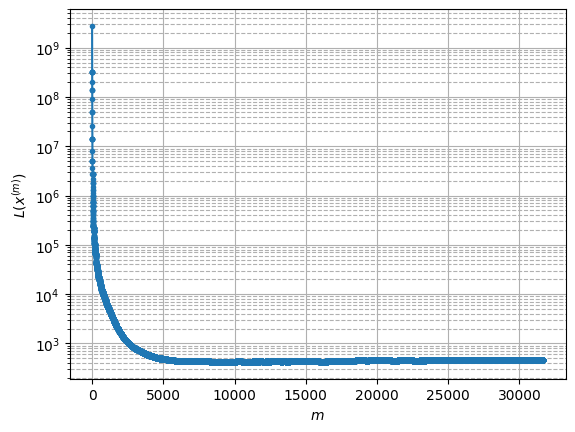

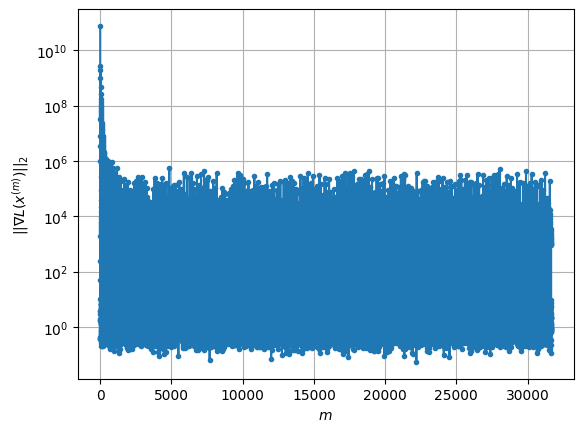

Windows:  96%|█████████▋| 285/296 [19:06:55<43:50, 239.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 470.1074284262897
Gradient norm: 260738.7724212
Global relative error: 1.7343428958151645
Position relative errors: 0.017258133541001957 m, 1.4976124225002514 m, 0.3732561828409433 m, 0.790872720918767 m

Iteration 1
Cost function: 469.72481484215905 (-0.08%)
Gradient norm: 2.1707770575821588 (-100.00%)
Global relative error = 1.7339526100911797 (-0.02%)
Position relative errors: 0.02241049359450564 m, 1.4971720701099065 m, 0.3734922162425435 m, 0.790609989465626 m

STOP on Iteration 2
Cost function = 469.72481546759576 (0.00%)
Gradient norm = 0.5290360185844162 (-75.63%)
Global relative error = 1.733952611425515 (0.00%)
Final position relative errors: 0.022410490684993265 m, 1.4971720701917681 m, 0.37349221708624 m, 0.7906099919209459 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 469.6834486743805
Gradient norm: 24943.048555843285
Global relative error: 1.733952

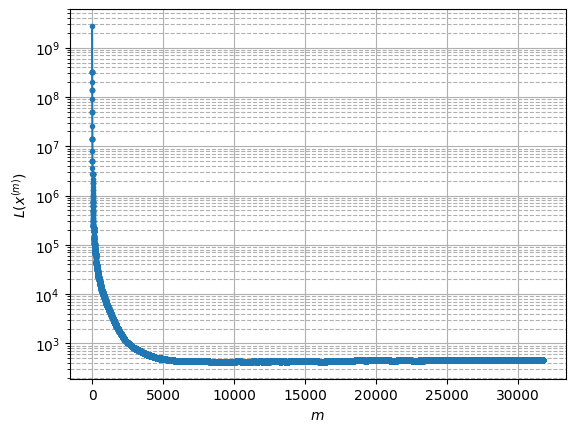

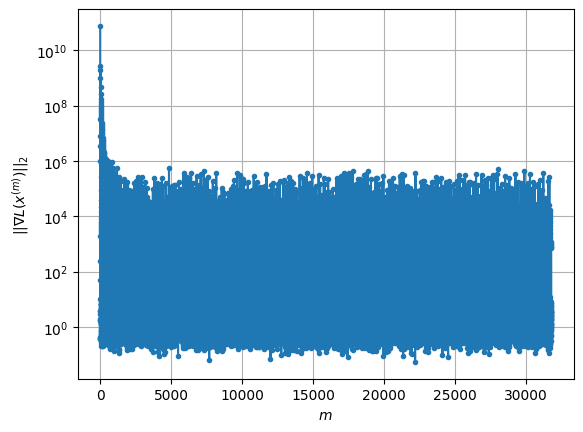

Windows:  97%|█████████▋| 286/296 [19:11:28<41:33, 249.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 468.53436956125057
Gradient norm: 25998.59303820709
Global relative error: 1.6468781647492428
Position relative errors: 0.022767393713300426 m, 1.4636060008148764 m, 0.2836118487365792 m, 0.6993613615640525 m

Iteration 1
Cost function: 468.465942572961 (-0.01%)
Gradient norm: 4.018963136807467 (-99.98%)
Global relative error = 1.6488920572121148 (0.12%)
Position relative errors: 0.023897718584394267 m, 1.4669407248020339 m, 0.28876129879035667 m, 0.6949610955849633 m

STOP on Iteration 2
Cost function = 468.46594268197487 (0.00%)
Gradient norm = 0.32921982292598034 (-91.81%)
Global relative error = 1.6488920575184338 (0.00%)
Final position relative errors: 0.023897720099163383 m, 1.4669407243555348 m, 0.2887613012104308 m, 0.6949610961965808 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 468.4327662300534
Gradient norm: 3904.707176256921
Global relative error: 1.

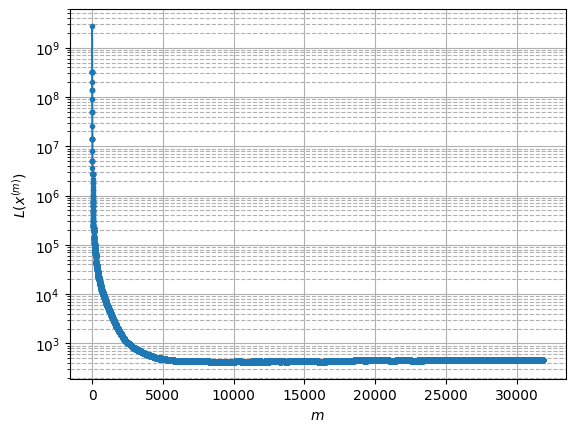

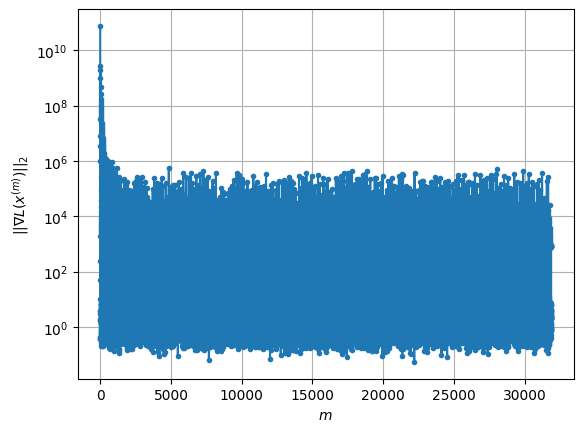

Windows:  97%|█████████▋| 287/296 [19:14:44<35:00, 233.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 469.48563275345407
Gradient norm: 300009.70677843597
Global relative error: 1.5735620603649643
Position relative errors: 0.024030778708415326 m, 1.4410100905012289 m, 0.17943537819812466 m, 0.6056467183419787 m

Iteration 1
Cost function: 469.06844746191626 (-0.09%)
Gradient norm: 4.077102650481143 (-100.00%)
Global relative error = 1.5839495576258924 (0.66%)
Position relative errors: 0.026944626937233977 m, 1.4494556896848954 m, 0.188716364173434 m, 0.6096142272515966 m

Iteration 2
Cost function: 469.0684470288655 (-0.00%)
Gradient norm: 5.298561707945485 (29.96%)
Global relative error = 1.5839495573696891 (-0.00%)
Position relative errors: 0.026944626089276266 m, 1.4494556883254097 m, 0.18871637022212726 m, 0.6096142279833134 m

STOP on Iteration 3
Cost function = 469.06844616483363 (-0.00%)
Gradient norm = 0.7557063315366418 (-85.74%)
Global relative error = 1.5839495572225752 (-0.00%)
Final positio

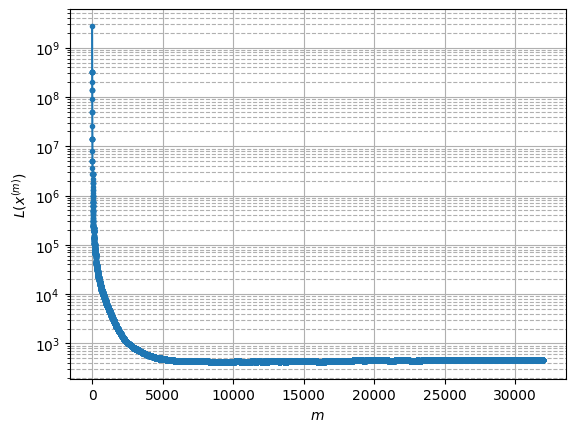

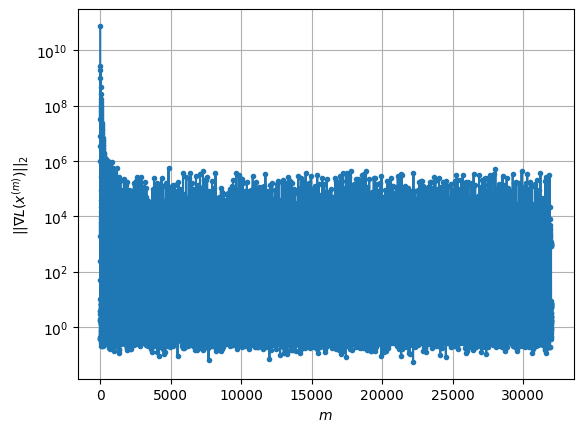

Windows:  97%|█████████▋| 288/296 [19:19:13<32:31, 243.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 469.6637644353322
Gradient norm: 97786.07065140444
Global relative error: 1.5350467689207445
Position relative errors: 0.027485314398492104 m, 1.4326110512003374 m, 0.15582579916581926 m, 0.5281588439421511 m

Iteration 1
Cost function: 469.4836275589382 (-0.04%)
Gradient norm: 1.063254553434066 (-100.00%)
Global relative error = 1.5349461490339453 (-0.01%)
Position relative errors: 0.026554401751541872 m, 1.435801342630976 m, 0.14817620767149886 m, 0.5214092384414849 m

Iteration 2
Cost function: 469.48362971796604 (0.00%)
Gradient norm: 1.899691714124371 (78.67%)
Global relative error = 1.534946149475297 (0.00%)
Position relative errors: 0.02655440142684828 m, 1.4358013416171187 m, 0.14817620955075178 m, 0.5214092420150881 m

Iteration 3
Cost function: 469.48362859658556 (-0.00%)
Gradient norm: 1.0411767846864526 (-45.19%)
Global relative error = 1.5349461499513082 (0.00%)
Position relative errors: 0.

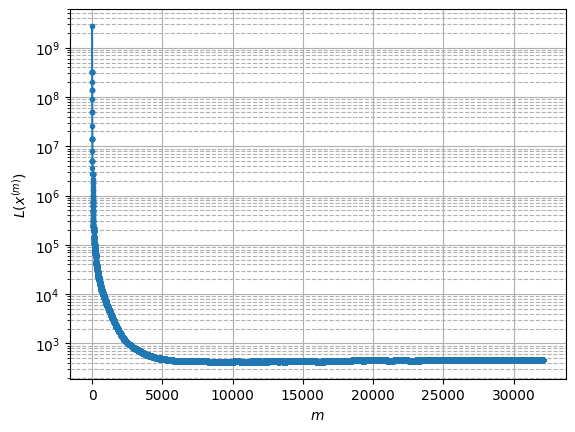

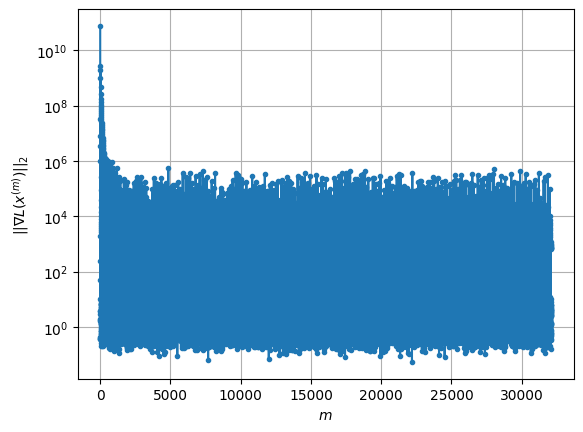

Windows:  98%|█████████▊| 289/296 [19:23:28<28:51, 247.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 471.47865597975306
Gradient norm: 284558.1707455186
Global relative error: 1.4830421350111465
Position relative errors: 0.027948735246520518 m, 1.4226576812158598 m, 0.07735036165510309 m, 0.41071822488053933 m

STOP on Iteration 1
Cost function = 471.1781629809741 (-0.06%)
Gradient norm = 0.5334478269999958 (-100.00%)
Global relative error = 1.4878238236739858 (0.32%)
Final position relative errors: 0.026804332331884794 m, 1.4245434893809066 m, 0.05787518079261231 m, 0.4245257759796462 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 471.0853467175368
Gradient norm: 19240.76393888168
Global relative error: 1.4878238236739858
Position relative errors: 0.026804332331884794 m, 1.4245434893809066 m, 0.05787518079261231 m, 0.4245257759796462 m

STOP on Iteration 1
Cost function = 471.0381450783937 (-0.01%)
Gradient norm = 0.9272949086775522 (-100.00%)
Global relative er

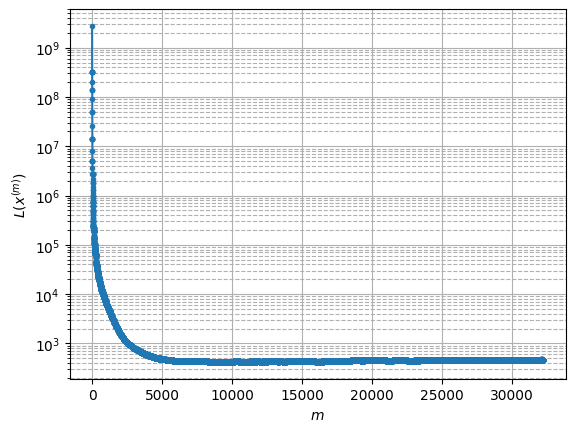

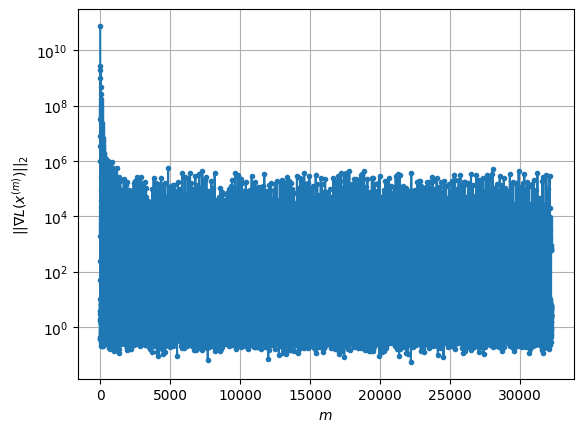

Windows:  98%|█████████▊| 290/296 [19:27:30<24:34, 245.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 473.77569999138893
Gradient norm: 191923.16889649886
Global relative error: 1.446727874514808
Position relative errors: 0.027100051742772076 m, 1.3906534397676766 m, 0.12654141294729018 m, 0.3772953619411835 m

Iteration 1
Cost function: 473.3640487157826 (-0.09%)
Gradient norm: 1.2246709614036286 (-100.00%)
Global relative error = 1.437493756363587 (-0.64%)
Position relative errors: 0.023171951999644103 m, 1.3833959583972606 m, 0.12485710355070084 m, 0.3694212963472462 m

STOP on Iteration 2
Cost function = 473.3640481161433 (-0.00%)
Gradient norm = 0.9554923701561842 (-21.98%)
Global relative error = 1.4374937549463687 (-0.00%)
Final position relative errors: 0.023171951817546502 m, 1.3833959578743638 m, 0.12485710629280683 m, 0.3694212918753383 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 473.2654409857946
Gradient norm: 22033.73603744228
Global relative erro

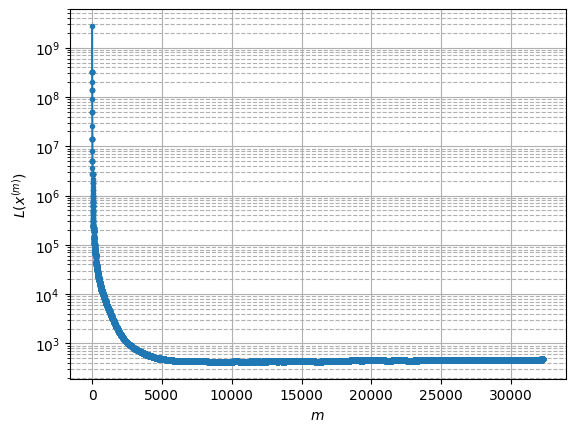

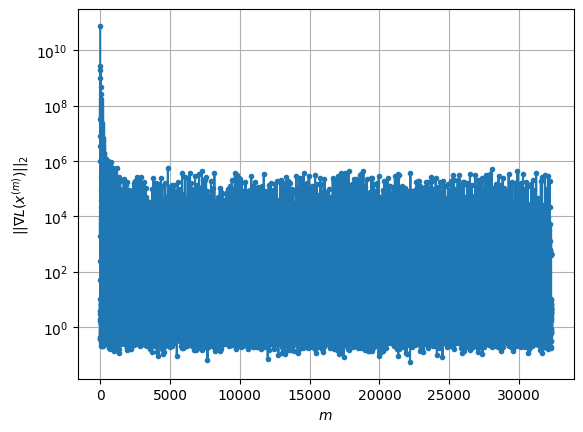

Windows:  98%|█████████▊| 291/296 [19:30:53<19:24, 232.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 475.2038316226252
Gradient norm: 184225.0220242268
Global relative error: 1.377195913128549
Position relative errors: 0.023440274820870747 m, 1.3156993540910609 m, 0.23343313756092732 m, 0.33250204378040693 m

STOP on Iteration 1
Cost function = 474.895290364953 (-0.06%)
Gradient norm = 0.6366763194709701 (-100.00%)
Global relative error = 1.368117307016723 (-0.66%)
Final position relative errors: 0.02810102247548922 m, 1.3132950299823427 m, 0.23238971777986783 m, 0.30364584479118584 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 474.8305633417091
Gradient norm: 13265.79011980056
Global relative error: 1.368117307016723
Position relative errors: 0.02810102247548922 m, 1.3132950299823427 m, 0.23238971777986783 m, 0.30364584479118584 m

Iteration 1
Cost function: 474.80435185953434 (-0.01%)
Gradient norm: 4.544752018174979 (-99.97%)
Global relative error = 1.3645355

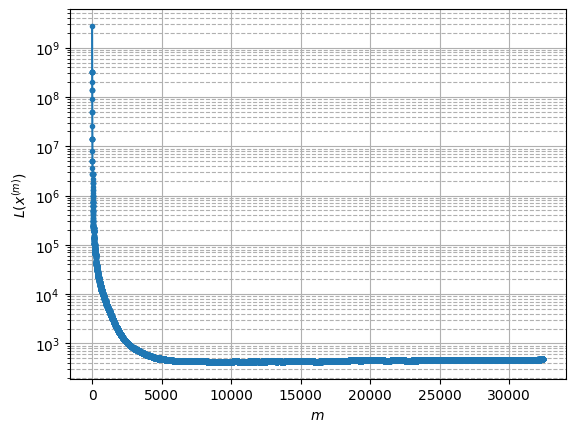

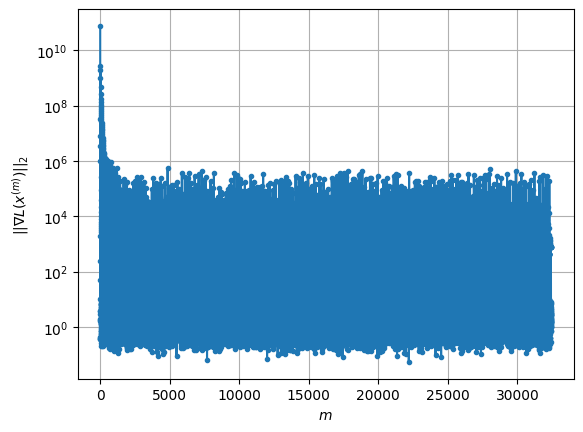

Windows:  99%|█████████▊| 292/296 [19:35:48<16:46, 251.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 470.9665884834009
Gradient norm: 91226.5103873228
Global relative error: 1.31295940632942
Position relative errors: 0.027472249525451055 m, 1.2560054523077544 m, 0.3127602907768702 m, 0.21847925546556246 m

Iteration 1
Cost function: 470.7873468896757 (-0.04%)
Gradient norm: 3.147080146834718 (-100.00%)
Global relative error = 1.3144508390039038 (0.11%)
Position relative errors: 0.029265361438026476 m, 1.2562161338661988 m, 0.3025325393758809 m, 0.23940307449099923 m

Iteration 2
Cost function: 470.78734687780684 (-0.00%)
Gradient norm: 3.5590214815871715 (13.09%)
Global relative error = 1.3144508396579573 (0.00%)
Position relative errors: 0.029265368558964017 m, 1.2562161339525701 m, 0.30253253858757834 m, 0.23940307775457814 m

Iteration 3
Cost function: 470.78734712840327 (0.00%)
Gradient norm: 3.2841100068177136 (-7.72%)
Global relative error = 1.3144508417285847 (0.00%)
Position relative errors: 0.

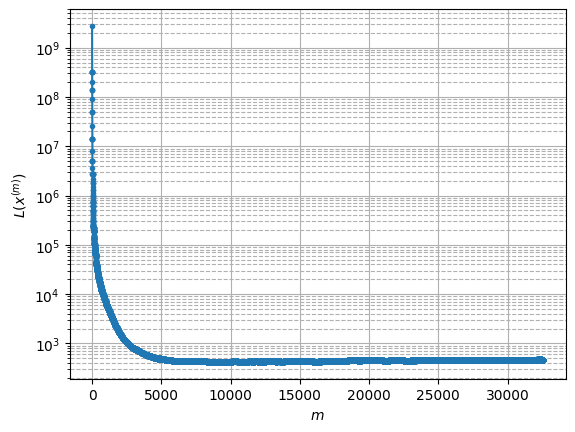

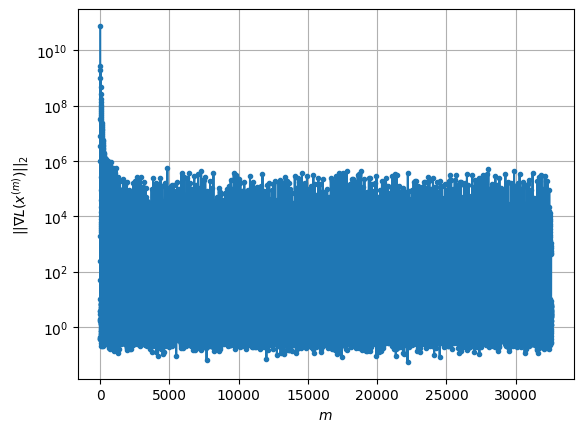

Windows:  99%|█████████▉| 293/296 [19:40:56<13:25, 268.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 472.1096505268437
Gradient norm: 121810.61068250825
Global relative error: 1.2621949082160582
Position relative errors: 0.02839018642133237 m, 1.1869972423853168 m, 0.381535058976143 m, 0.19440340463952982 m

STOP on Iteration 1
Cost function = 471.94990869543744 (-0.03%)
Gradient norm = 0.18799022695213005 (-100.00%)
Global relative error = 1.2579993851489417 (-0.33%)
Final position relative errors: 0.03309408016867375 m, 1.1864334957123384 m, 0.38005977519938333 m, 0.17143958493637504 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 471.9153538712044
Gradient norm: 8544.614732198143
Global relative error: 1.2579993851489417
Position relative errors: 0.03309408016867375 m, 1.1864334957123384 m, 0.38005977519938333 m, 0.17143958493637504 m

Iteration 1
Cost function: 471.9008495547613 (-0.00%)
Gradient norm: 4.058558793823586 (-99.95%)
Global relative error = 1.2563

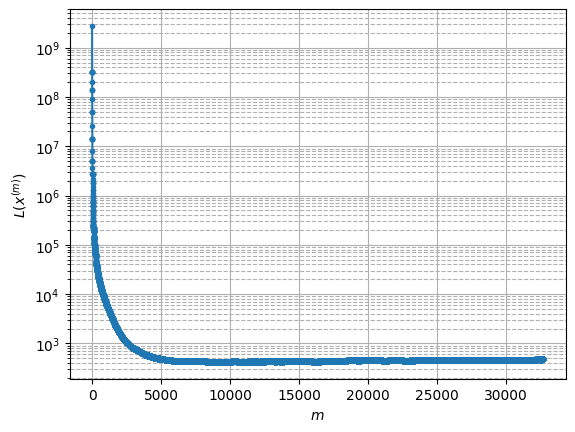

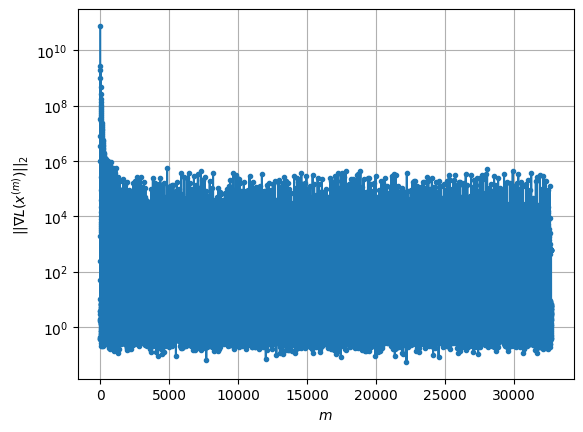

Windows:  99%|█████████▉| 294/296 [19:44:56<08:39, 259.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 472.0073066971992
Gradient norm: 244602.31296048468
Global relative error: 1.2174859267387395
Position relative errors: 0.0325960361429052 m, 1.113251223751881 m, 0.4738491041047265 m, 0.13169022746674602 m

Iteration 1
Cost function: 471.70869131547596 (-0.06%)
Gradient norm: 4.255328822101292 (-100.00%)
Global relative error = 1.216055811498761 (-0.12%)
Position relative errors: 0.03491993670976849 m, 1.1079952316749115 m, 0.47068585764574744 m, 0.16842747827335122 m

Iteration 2
Cost function: 471.708692031299 (0.00%)
Gradient norm: 5.760864975420963 (35.38%)
Global relative error = 1.2160558098069953 (-0.00%)
Position relative errors: 0.03491993217585739 m, 1.10799523124952 m, 0.47068585669762475 m, 0.16842747244677442 m

STOP on Iteration 3
Cost function = 471.7086926294184 (0.00%)
Gradient norm = 0.3591005479483931 (-93.77%)
Global relative error = 1.2160558116731115 (0.00%)
Final position relativ

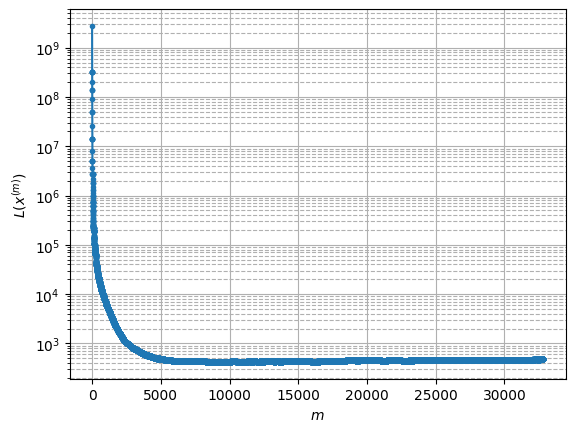

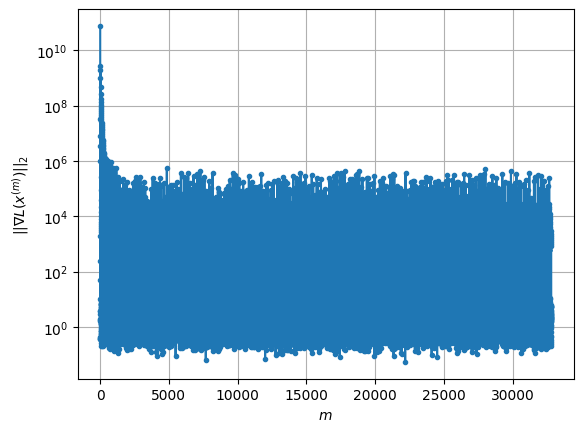

Windows: 100%|█████████▉| 295/296 [19:50:10<04:36, 276.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 471.18722890691396
Gradient norm: 376221.9949488291
Global relative error: 1.1962519230599051
Position relative errors: 0.03490508843990175 m, 1.0163744548202522 m, 0.5701035390257678 m, 0.2678791465340963 m

STOP on Iteration 1
Cost function = 470.86397446710725 (-0.07%)
Gradient norm = 0.2501377671138391 (-100.00%)
Global relative error = 1.1889155743486535 (-0.61%)
Final position relative errors: 0.026980232350236583 m, 1.0156158579696128 m, 0.5692628059464627 m, 0.2392710366643201 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 470.83525930363794
Gradient norm: 8376.439455155574
Global relative error: 1.1889155743486535
Position relative errors: 0.026980232350236583 m, 1.0156158579696128 m, 0.5692628059464627 m, 0.2392710366643201 m

Iteration 1
Cost function: 470.82156952146386 (-0.00%)
Gradient norm: 3.7605353868823364 (-99.96%)
Global relative error = 1.1844

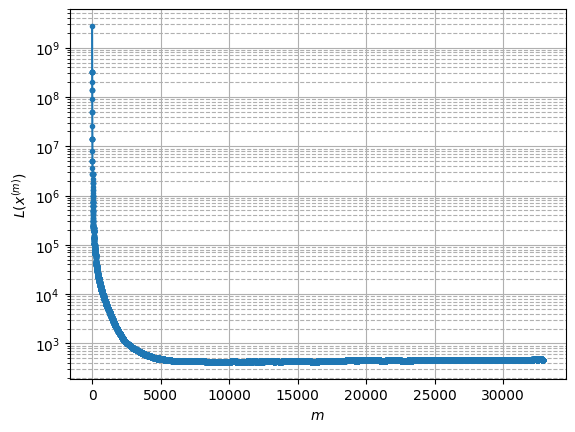

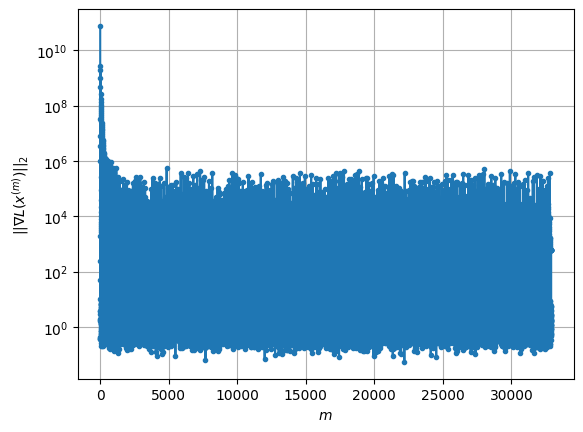

RMSE after convergence:
Chief: nan m
Deputy 1: nan m
Deputy 2: nan m
Deputy 3: nan m


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [11]:
# Main execution loop
def run_estimation():
    
    Y = np.zeros((9, 1, T))
    for t in range(T):
        Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
        
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = MM_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

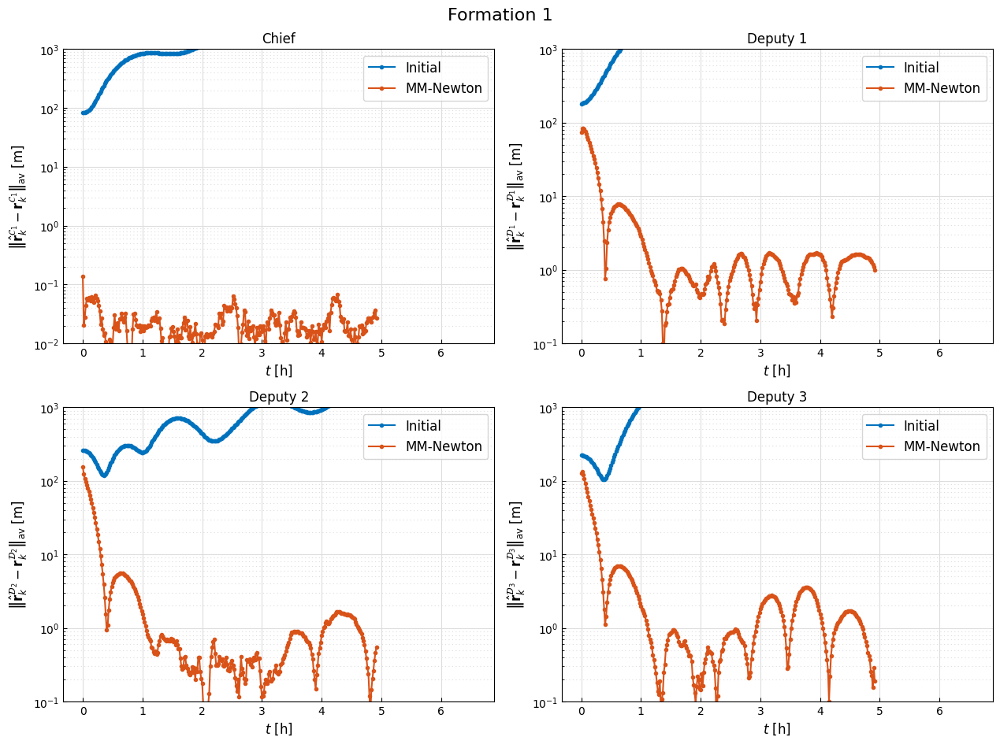

In [12]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "MM-Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [13]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm

# Save to pickle file
with open(
    f'mm_newton_updated_params_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)